In [3]:
# IMPORTANT: SOME KAGGLE DATA SOURCES ARE PRIVATE
# RUN THIS CELL IN ORDER TO IMPORT YOUR KAGGLE DATA SOURCES.
import kagglehub
kagglehub.login()


Kaggle credentials set.
Kaggle credentials successfully validated.


In [4]:
# IMPORTANT: RUN THIS CELL IN ORDER TO IMPORT YOUR KAGGLE DATA SOURCES,
# THEN FEEL FREE TO DELETE THIS CELL.
# NOTE: THIS NOTEBOOK ENVIRONMENT DIFFERS FROM KAGGLE'S PYTHON
# ENVIRONMENT SO THERE MAY BE MISSING LIBRARIES USED BY YOUR
# NOTEBOOK.

widsdatathon2025_path = kagglehub.competition_download('widsdatathon2025')

print('Data source import complete.')


100%|██████████| 458M/458M [00:16<00:00, 28.7MB/s]

Extracting files...


Data source import complete.


# Some Guiding questions

- What brain activity patterns are associated with ADHD?
- How do these patterns differ between males and females?

In [5]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O

# Input data files are available in the read-only "../input/" directory

import os
for dirname, _, filenames in os.walk(widsdatathon2025_path):
    for filename in filenames:
        print(os.path.join(dirname, filename))


/root/.cache/kagglehub/competitions/widsdatathon2025/SAMPLE_SUBMISSION.xlsx
/root/.cache/kagglehub/competitions/widsdatathon2025/Data Dictionary.xlsx
/root/.cache/kagglehub/competitions/widsdatathon2025/TEST/TEST_FUNCTIONAL_CONNECTOME_MATRICES.csv
/root/.cache/kagglehub/competitions/widsdatathon2025/TEST/TEST_QUANTITATIVE_METADATA.xlsx
/root/.cache/kagglehub/competitions/widsdatathon2025/TEST/TEST_CATEGORICAL.xlsx
/root/.cache/kagglehub/competitions/widsdatathon2025/TRAIN_OLD/TRAIN_FUNCTIONAL_CONNECTOME_MATRICES.csv
/root/.cache/kagglehub/competitions/widsdatathon2025/TRAIN_OLD/TRAINING_SOLUTIONS.xlsx
/root/.cache/kagglehub/competitions/widsdatathon2025/TRAIN_OLD/TRAIN_CATEGORICAL_METADATA.xlsx
/root/.cache/kagglehub/competitions/widsdatathon2025/TRAIN_OLD/TRAIN_QUANTITATIVE_METADATA.xlsx
/root/.cache/kagglehub/competitions/widsdatathon2025/TRAIN_NEW/TRAIN_CATEGORICAL_METADATA_new.xlsx
/root/.cache/kagglehub/competitions/widsdatathon2025/TRAIN_NEW/TRAINING_SOLUTIONS.xlsx
/root/.cache/k

In [6]:
!pip install -qU nilearn

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.5/10.5 MB 60.5 MB/s eta 0:00:00


# Import the libraries because we need them 📚

In [7]:
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier
from sklearn.base import clone
from sklearn.utils.class_weight import compute_sample_weight
from sklearn.preprocessing import LabelEncoder, StandardScaler, FunctionTransformer, MinMaxScaler, PolynomialFeatures, RobustScaler, OrdinalEncoder, OneHotEncoder
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.compose import ColumnTransformer
from sklearn.inspection import permutation_importance
from sklearn.impute import SimpleImputer, KNNImputer
from sklearn.metrics import f1_score, make_scorer, classification_report, precision_score, recall_score, confusion_matrix, silhouette_score, silhouette_samples
from sklearn.feature_selection import SelectKBest, f_classif, VarianceThreshold, SelectFromModel
from sklearn.model_selection import cross_validate, cross_val_score
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier, HistGradientBoostingClassifier
from sklearn.linear_model import LogisticRegression, RidgeClassifier,RidgeClassifierCV
from sklearn.multioutput import MultiOutputClassifier
from sklearn.model_selection import cross_val_score
from sklearn.metrics.pairwise import euclidean_distances
from xgboost import XGBClassifier
from matplotlib.ticker import MaxNLocator
from sklearn.decomposition import PCA
from sklearn.base import BaseEstimator, TransformerMixin
import matplotlib.pyplot as plt
from sklearn.model_selection import GridSearchCV, StratifiedKFold, cross_val_predict, RepeatedStratifiedKFold
import seaborn as sns
import scipy
import shap
import lightgbm as lgb
import networkx as nx
from nilearn import datasets
import functools
from functools import wraps
import time
import warnings
from sklearn.cluster import KMeans, AgglomerativeClustering, SpectralClustering, DBSCAN
from sklearn.mixture import GaussianMixture
from sklearn.metrics import silhouette_score, davies_bouldin_score, calinski_harabasz_score, silhouette_samples, adjusted_rand_score
from sklearn.utils import resample
import umap
import shap
from sklearn.ensemble import RandomForestClassifier
from sklearn.manifold import TSNE
from sklearn.cluster import KMeans
import scipy.stats as stats
from nilearn import datasets, plotting
from matplotlib.gridspec import GridSpec
import random
from tqdm import tqdm
from copy import deepcopy
warnings.filterwarnings('ignore')


In [8]:
plt.style.use('seaborn-v0_8-whitegrid')
sns.set_palette("Set2")
plt.rcParams['figure.figsize'] = (12, 8)
plt.rcParams['font.size'] = 12


In [9]:
def log_and_time(func):
    @functools.wraps(func)
    def wrapper(*args, **kwargs):
        func_name = func.__name__
        start_time = time.time()
        result = func(*args, **kwargs)
        end_time = time.time()
        duration = end_time - start_time
        print(f"'{func_name}' completed in {duration:.4f} seconds.\n")
        return result
    return wrapper

In [10]:
@log_and_time
def prepare_data(connectome_df, meta_df=None, n_pca=50):

    df = connectome_df.copy()
    if meta_df is not None:
        features = meta_df.drop(columns=['ADHD_Outcome', 'Sex_F', 'participant_id'], errors='ignore')
        df = df.join(features, how='inner')
    scaler = StandardScaler()
    X_scaled = scaler.fit_transform(df)
    pca = PCA(n_components=n_pca, random_state=42)
    X_pca = pca.fit_transform(X_scaled)
    print(f"PCA explained variance: {pca.explained_variance_ratio_.sum():.2%}")
    return X_scaled, X_pca

@log_and_time
def compute_umap(X, n_neighbors=15, min_dist=0.1, n_components=2):
    reducer = umap.UMAP(n_neighbors=n_neighbors, min_dist=min_dist, n_components=n_components, random_state=42)
    X_umap = reducer.fit_transform(X)
    return X_umap

@log_and_time
def fit_and_evaluate_clusters(X, model_type='kmeans', n_clusters=3):
    if model_type == 'kmeans':
        model = KMeans(n_clusters=n_clusters, random_state=42, n_init=10)
        labels = model.fit_predict(X)
    elif model_type == 'gmm':
        model = GaussianMixture(n_components=n_clusters, random_state=42)
        labels = model.fit_predict(X)
    elif model_type == 'hierarchical':
        model = AgglomerativeClustering(n_clusters=n_clusters)
        labels = model.fit_predict(X)
    else:
        raise ValueError("Unsupported model type")

    sil = silhouette_score(X, labels)
    db = davies_bouldin_score(X, labels)
    ch = calinski_harabasz_score(X, labels)
    print(f"Model: {model_type}, k={n_clusters} -> Silhouette: {sil:.3f}, Davies-Bouldin: {db:.3f}, Calinski-Harabasz: {ch:.1f}")
    return model, labels

@log_and_time
def shap_explain_clusters(X, labels):
    rf = RandomForestClassifier(n_estimators=100, random_state=42)
    rf.fit(X, labels)
    explainer = shap.TreeExplainer(rf)
    shap_values = explainer.shap_values(X)
    return rf, explainer, shap_values

@log_and_time
def impute_df_and_plot(
    df: pd.DataFrame,
    categorical_cols: list[str],
    quantitative_cols: list[str],
    group_name: str = "Group"
) -> pd.DataFrame:
    """
    Impute missing values in df and plot before/after distributions.

    Categorical columns → fillna with mode.
    Quantitative columns → fillna with median.

    Parameters
    ----------
    df : pd.DataFrame
        The input DataFrame to impute.
    categorical_cols : list[str]
        List of column names to treat as categorical.
    quantitative_cols : list[str]
        List of column names to treat as quantitative.
    group_name : str
        Label for titles (e.g. 'Female', 'Male').

    Returns
    -------
    pd.DataFrame
        A new DataFrame with imputed values.
    """
    df_before = deepcopy(df)
    df_after  = deepcopy(df)

    for col in categorical_cols:
        col_mode = df_before[col].mode().iloc[0]
        df_after[col] = df_after[col].fillna(col_mode)

    for col in quantitative_cols:
        col_median = df_before[col].median()
        df_after[col] = df_after[col].fillna(col_median)

    for col in categorical_cols:
        fig, axes = plt.subplots(1, 2, figsize=(10, 4), tight_layout=True)
        # Before
        df_before[col].value_counts(dropna=False).plot.bar(ax=axes[0])
        axes[0].set_title(f"{group_name}: '{col}' Before Imputation")
        axes[0].set_ylabel("Count")
        # After
        df_after[col].value_counts(dropna=False).plot.bar(ax=axes[1])
        axes[1].set_title(f"{group_name}: '{col}' After Imputation")
        plt.show()

    for col in quantitative_cols:
        fig, axes = plt.subplots(1, 2, figsize=(10, 4), tight_layout=True)
        # Before
        axes[0].hist(df_before[col].dropna(), bins=30)
        axes[0].set_title(f"{group_name}: '{col}' Before Imputation")
        axes[0].set_ylabel("Frequency")
        # After
        axes[1].hist(df_after[col], bins=30)
        axes[1].set_title(f"{group_name}: '{col}' After Imputation")
        plt.show()

    return df_after

def visualize_patient_connectome(patient_id, connectome_df, threshold=0.5, is_sex=False):
    """
    Visualizes the connectome network for a given patient ID.

    Parameters:
    - patient_id (str or int): The ID of the patient to visualize.
    - connectome_df (pd.DataFrame): DataFrame where rows correspond to patients and columns to connectivity values.
    - threshold (float): Minimum value to retain edges in the network (default is 0.5).
    """

    if patient_id not in connectome_df.index:
        print(f"Patient ID {patient_id} not found in dataset.")
        return

    upper_triangle_values = connectome_df.loc[patient_id].values
    n = 200
    adjacency_matrix = np.zeros((n, n))
    upper_indices = np.triu_indices(n, k=1)
    adjacency_matrix[upper_indices] = upper_triangle_values
    adjacency_matrix += adjacency_matrix.T
    np.fill_diagonal(adjacency_matrix, 1)

    # Apply threshold
    adjacency_matrix[adjacency_matrix < threshold] = 0

    # Create graph
    G = nx.from_numpy_array(adjacency_matrix)

    # Compute network metrics
    degree_centrality = nx.degree_centrality(G)
    clustering_coeff = nx.clustering(G)

    avg_degree_centrality = np.mean(list(degree_centrality.values()))
    avg_clustering_coeff = np.mean(list(clustering_coeff.values()))

    print(f"Average degree centrality for {patient_id}: {avg_degree_centrality}")
    print(f"Average clustering coefficient for {patient_id}: {avg_clustering_coeff}")
    patient_sex = "Male" if is_sex else "Female"
    # Visualize graph
    plt.figure(figsize=(10, 10))
    pos = nx.spring_layout(G, seed=42)
    nx.draw_networkx_nodes(G, pos, node_size=20, node_color="skyblue")
    nx.draw_networkx_edges(G, pos, width=0.1, alpha=0.7)
    plt.title(f"Connectome Network Visualization for {patient_sex} Patient {patient_id} (Threshold={threshold})")
    plt.axis("off")
    plt.show()


def compute_graph_features(connectome_df, threshold=0.5, n=200):
    """
    Compute graph-based features for each patient from the connectome data.

    For each patient, the function:
      1. Reconstructs the full n x n connectome matrix from the flattened upper triangle.
      2. Thresholds the matrix (connections below the threshold are set to 0).
      3. Builds a NetworkX graph from the thresholded matrix.
      4. Computes:
         - Average Node Degree (raw degree)
         - Global Efficiency of the network
         - Average Clustering Coefficient
         - Characteristic Path Length (using the largest connected component if necessary)

    Parameters:
        connectome_df (pd.DataFrame): DataFrame where each row contains the flattened
                                      upper triangle of a connectome matrix.
        threshold (float): Threshold below which connectivity values are set to 0.
        n (int): Dimension of the square connectome matrix (default is 200).

    Returns:
        pd.DataFrame: DataFrame with columns:
                      ['patient_id', 'avg_degree', 'global_efficiency', 'avg_clustering', 'char_path_length']
    """
    results = []
    for patient_id, row in connectome_df.iterrows():
        flat_data = row.values
        expected_length = (n * (n - 1)) // 2
        if len(flat_data) != expected_length:
            raise ValueError(f"Patient {patient_id} does not have the expected number of connectome features. Expected {expected_length}, got {len(flat_data)}.")

        matrix = np.zeros((n, n))
        upper_tri_indices = np.triu_indices(n, k=1)
        matrix[upper_tri_indices] = flat_data
        matrix = matrix + matrix.T
        np.fill_diagonal(matrix, 1)
        thresholded_matrix = matrix.copy()
        thresholded_matrix[thresholded_matrix < threshold] = 0
        G = nx.from_numpy_array(thresholded_matrix)
        degrees = [d for _, d in G.degree()]
        avg_degree = np.mean(degrees)

        # Compute global efficiency
        global_eff = nx.global_efficiency(G)

        # Compute average clustering coefficient
        avg_clustering = nx.average_clustering(G)

        # Compute characteristic path length
        # If the graph is disconnected, use the largest connected component
        if nx.is_connected(G):
            char_path_length = nx.average_shortest_path_length(G)
        else:
            largest_cc = max(nx.connected_components(G), key=len)
            subG = G.subgraph(largest_cc)
            char_path_length = nx.average_shortest_path_length(subG)

        results.append({
            "patient_id": patient_id,
            "avg_degree": avg_degree,
            "global_efficiency": global_eff,
            "avg_clustering": avg_clustering,
            "char_path_length": char_path_length
        })

    return pd.DataFrame(results)




In [11]:
# Enhanced network metrics computation
@log_and_time
def compute_graph_features(connectome_df, threshold=0.5, n=200):
    """
    Compute comprehensive graph-based features for each patient from the connectome data.
    """
    results = []

    for patient_id, row in connectome_df.iterrows():
        flat_data = row.values
        expected_length = (n * (n - 1)) // 2
        if len(flat_data) != expected_length:
            raise ValueError(f"Patient {patient_id} doesn't have the expected number of connectome features. Expected {expected_length}, got {len(flat_data)}.")

        # Reconstruct the full n x n matrix from the flattened upper triangle
        matrix = np.zeros((n, n))
        upper_tri_indices = np.triu_indices(n, k=1)
        matrix[upper_tri_indices] = flat_data
        matrix = matrix + matrix.T
        np.fill_diagonal(matrix, 1)

        # Apply threshold to keep only strong connections
        thresholded_matrix = matrix.copy()
        thresholded_matrix[thresholded_matrix < threshold] = 0

        # Create a graph from the thresholded matrix
        G = nx.from_numpy_array(thresholded_matrix)

        # Compute metrics
        degree_centrality = np.mean(list(nx.degree_centrality(G).values()))
        clustering_coefficient = nx.average_clustering(G)

        # Calculate additional metrics
        try:
            # These might fail if graph is disconnected
            if nx.is_connected(G):
                avg_path_length = nx.average_shortest_path_length(G)
                global_efficiency = nx.global_efficiency(G)
            else:
                # Use largest connected component
                largest_cc = max(nx.connected_components(G), key=len)
                subG = G.subgraph(largest_cc)
                avg_path_length = nx.average_shortest_path_length(subG)
                global_efficiency = nx.global_efficiency(G)

            betweenness = np.mean(list(nx.betweenness_centrality(G).values()))
            modularity = nx.algorithms.community.modularity(G, nx.algorithms.community.greedy_modularity_communities(G))
        except:
            avg_path_length = np.nan
            global_efficiency = np.nan
            betweenness = np.nan
            modularity = np.nan

        # Edge density
        num_possible_edges = n * (n - 1) / 2
        edge_density = G.number_of_edges() / num_possible_edges

        # Assortativity
        try:
            assortativity = nx.degree_assortativity_coefficient(G)
        except:
            assortativity = np.nan

        results.append({
            "participant_id": patient_id,
            "degree_centrality": degree_centrality,
            "clustering_coefficient": clustering_coefficient,
            "path_length": avg_path_length,
            "global_efficiency": global_efficiency,
            "betweenness": betweenness,
            "modularity": modularity,
            "edge_density": edge_density,
            "assortativity": assortativity
        })

    return pd.DataFrame(results)

### Compute Graph Features

#### Brain Network Metrics for ADHD Analysis

## 1. Degree Centrality
**What it is:**  
- For each brain region ("node"), count how many other regions it's directly talking to (i.e. connections above a set threshold).
Then we take the average across all regions to get a single number per person.

- A higher average degree means, on the whole, regions are more richly interconnected—think of it like a social network where each person has many friends.

- ADHD brains often show altered "hubness," with fewer or more scattered hub regions. This metric flags whether the network is generally highly connected or somewhat sparse.

## 2. Clustering Coefficient
**What it is:**  
- Measures how often a region's neighbors also talk to each other. Formally, for each node, look at the proportion of possible "triangles" (A–B, B–C, A–C) it participates in, then average across nodes.

- High clustering means local groups of regions form tight-knit modules—like close friend circles.

- Healthy brains often show a balance of local clustering plus long-range links. Too much or too little local clustering can hint at network organization differences in ADHD.

## 3. Characteristic Path Length
**What it is:**  
- The average shortest number of "hops" between every pair of regions. For disconnected graphs, we restrict to the biggest connected piece.

- Shorter path lengths imply efficient information transfer (few steps needed). Long path lengths mean signals have to traverse many intermediate regions.

- ADHD networks sometimes show either very short (over-integration) or very long (poor integration) path lengths, reflecting atypical global wiring.

## 4. Global Efficiency
**What it is:**  
- A mathematically equivalent alternative to inverse path length: it averages the inverse of the shortest‐path length between every pair, so high efficiency = short paths.

- Directly captures how easily information can flow across the entire brain network.

- Lower global efficiency has been repeatedly linked to ADHD—brains that are less "economical" in routing signals.

## 5. Betweenness Centrality
**What it is:**  
- For each region, count how many of all shortest‐paths between other region pairs pass through it. Then average.

- Highlights "bridge" regions that serve as traffic junctions in the network.

- Differences in these bridge nodes can reveal how information bottlenecks differ in ADHD subtypes (some subtypes may rely on alternate routing).

## 6. Modularity
**What it is:**  
- Measures how cleanly the network splits into distinct "communities" or modules—groups of regions that are more connected to each other than to the rest of the brain.

- High modularity means clear separation into subnetworks (attention, default-mode, sensory).

- ADHD may involve weaker or overly rigid modular organization—some subtypes might show blurred community boundaries.

## 7. Edge Density
**What it is:**  
- The fraction of possible connections that are actually present (above threshold).

- Overall network sparsity vs. richness.

- Quickly tells you if someone's brain network is generally lean (few strong links) or dense (many strong links), which can differ by ADHD status or subtype.

## 8. Assortativity
**What it is:**  
- A measure of whether regions tend to connect to others with a similar number of connections. Positive assortativity means high‐degree regions connect with other high‐degree regions.

- Reveals whether "hubs" preferentially talk to other hubs (rich‐club organization) or mainly connect to low‐degree nodes.

- Altered hub-hub vs. hub-spoke wiring has been implicated in ADHD and may differ across subtypes.

## How it is useful
By reducing each 19,900-element connectome to these 8–9 concise metrics, we:

- Capture key aspects of how the brain is wired—local cliquishness, global efficiency, hub roles, community structure, overall sparsity, and hub wiring patterns.
- Greatly simplify the feature set for clustering or visualization, making the analysis faster and the results easier for non-technical stakeholders to grasp.
- Enable biologically meaningful interpretation—each metric has a clear story ("These kids have fewer big hubs and more fragmented communities"), which can be communicated directly to clinicians or educators.


In [13]:
def compute_network_metrics(connectome_df, threshold=0.5, n=200):
    """
    Compute average degree centrality and clustering coefficient for each patient.

    Parameters:
        connectome_df (pd.DataFrame): DataFrame where each row is the flattened upper triangle
                                      of a n x n connectome matrix.
        threshold (float): Value below which connectivity values are set to 0.
        n (int): Dimension of the square connectome matrix (default is 200).

    Returns:
        pd.DataFrame: DataFrame with columns ['patient_id', 'avg_degree_centrality', 'avg_clustering_coefficient'].
    """
    results = []

    for patient_id, row in connectome_df.iterrows():
        flat_data = row.values
        if len(flat_data) != (n*(n-1))//2:
            raise ValueError(f"Patient {patient_id} does not have expected number of connectome features.")

        matrix = np.zeros((n, n))
        upper_tri_indices = np.triu_indices(n, k=1)
        matrix[upper_tri_indices] = flat_data
        matrix = matrix + matrix.T
        np.fill_diagonal(matrix, 1)

        thresholded_matrix = matrix.copy()
        thresholded_matrix[thresholded_matrix < threshold] = 0

        G = nx.from_numpy_array(thresholded_matrix)

        degree_centrality = nx.degree_centrality(G)
        clustering_coeff = nx.clustering(G)

        avg_degree = np.mean(list(degree_centrality.values()))
        avg_clustering = np.mean(list(clustering_coeff.values()))

        results.append({
            "patient_id": patient_id,
            "avg_degree_centrality": avg_degree,
            "avg_clustering_coefficient": avg_clustering
        })
    return pd.DataFrame(results)



## Description of the features
---

| DataType              | Instrument                                      | Field                            | Description                                                                                          | Type            | Labels                                                                                                                                                             |
|:----------------------|:------------------------------------------------|:---------------------------------|:-----------------------------------------------------------------------------------------------------|:----------------|:-------------------------------------------------------------------------------------------------------------------------------------------------------------------|
| QUANTITATIVE METADATA | nan                                             | nan                              | nan                                                                                                  | nan             | nan                                                                                                                                                                |
| nan                   | Identifier                                      | participant_id                   | Participant ID                                                                                       | str             | nan                                                                                                                                                                |
| Quantitative          | Edinburgh Handedness Questionnaire              | EHQ_EHQ_Total                    | Laterality Index (Score)                                                                             | float           | -100 = 10th left                                                                                                                                                   |
|                       |                                                 |                                  |                                                                                                      |                 | −28 ≤ LI < 48 = middle                                                                                                                                             |
|                       |                                                 |                                  |                                                                                                      |                 | 100 = 10th right                                                                                                                                                   |
| Quantitative          | Ishihara Color Vision Test                      | ColorVision_CV_Score             | Color vision test score                                                                              | int             | nan                                                                                                                                                                |
| Quantitative          | Alabama Parenting Questionnaire - Parent Report | APQ_P_APQ_P_CP                   | Corporal Punishment Score                                                                            | int             | nan                                                                                                                                                                |
| Quantitative          | Alabama Parenting Questionnaire - Parent Report | APQ_P_APQ_P_ID                   | Inconsistent Discipline Score                                                                        | int             | nan                                                                                                                                                                |
| Quantitative          | Alabama Parenting Questionnaire - Parent Report | APQ_P_APQ_P_INV                  | Involvement Score                                                                                    | int             | nan                                                                                                                                                                |
| Quantitative          | Alabama Parenting Questionnaire - Parent Report | APQ_P_APQ_P_OPD                  | Other Discipline Practices Score (Not factored into total score but provides item level information) | int             | nan                                                                                                                                                                |
| Quantitative          | Alabama Parenting Questionnaire - Parent Report | APQ_P_APQ_P_PM                   | Poor Monitoring/Supervision Score                                                                    | int             | nan                                                                                                                                                                |
| Quantitative          | Alabama Parenting Questionnaire - Parent Report | APQ_P_APQ_P_PP                   | Positive Parenting Score                                                                             | int             | nan                                                                                                                                                                |
| Quantitative          | Strength and Difficulties Questionnaire         | SDQ_SDQ_Conduct_Problems         | Conduct problems scale                                                                               | int             | nan                                                                                                                                                                |
| Quantitative          | Strength and Difficulties Questionnaire         | SDQ_SDQ_Difficulties_Total       | Total Difficulties Score                                                                             | int             | nan                                                                                                                                                                |
| Quantitative          | Strength and Difficulties Questionnaire         | SDQ_SDQ_Emotional_Problems       | Emotional Problems Scale                                                                             | int             | nan                                                                                                                                                                |
| Quantitative          | Strength and Difficulties Questionnaire         | SDQ_SDQ_Externalizing            | Externalizing Score                                                                                  | int             | nan                                                                                                                                                                |
| Quantitative          | Strength and Difficulties Questionnaire         | SDQ_SDQ_Generating_Impact        | Generating Impact Scores                                                                             | int             | nan                                                                                                                                                                |
| Quantitative          | Strength and Difficulties Questionnaire         | SDQ_SDQ_Hyperactivity            | Hyperactivity Scale                                                                                  | int             | nan                                                                                                                                                                |
| Quantitative          | Strength and Difficulties Questionnaire         | SDQ_SDQ_Internalizing            | Internalizing Score                                                                                  | int             | nan                                                                                                                                                                |
| Quantitative          | Strength and Difficulties Questionnaire         | SDQ_SDQ_Peer_Problems            | Peer Problems Scale                                                                                  | int             | nan                                                                                                                                                                |
| Quantitative          | Strength and Difficulties Questionnaire         | SDQ_SDQ_Prosocial                | Prosocial Scale                                                                                      | int             | nan                                                                                                                                                                |
| Quantitative          | MRI Information                                 | MRI_Track,Age_at_Scan            | Age at time of MRI scan                                                                              | float           | nan                                                                                                                                                                |
| nan                   | nan                                             | nan                              | nan                                                                                                  | nan             | nan                                                                                                                                                                |
| CATEGORICAL METADATA  | nan                                             | nan                              | nan                                                                                                  | nan             | nan                                                                                                                                                                |
| nan                   | Identifier                                      | participant_id                   | Participant ID                                                                                       | str             | nan                                                                                                                                                                |
| Categorical           | Demographics                                    | Basic_Demos_Enroll_Year          | Year of enrollment                                                                                   | int             | nan                                                                                                                                                                |
| Categorical           | Demographics                                    | Basic_Demos_Study_Site           | Site of phenotypic testing                                                                           | categorical int | 1=Staten Island                                                                                                                                                    |
|                       |                                                 |                                  |                                                                                                      |                 | 2=MRV                                                                                                                                                              |
|                       |                                                 |                                  |                                                                                                      |                 | 3=Midtown                                                                                                                                                          |
|                       |                                                 |                                  |                                                                                                      |                 | 4=Harlem                                                                                                                                                           |
|                       |                                                 |                                  |                                                                                                      |                 | 5=SI RUMC                                                                                                                                                          |
| Categorical           | Pre-Interview- Demographics/Family              | PreInt_Demos_Fam_Child_Ethnicity | Ethnicity of child                                                                                   | categorical int | 0= Not Hispanic or Latino                                                                                                                                          |
|                       |                                                 |                                  |                                                                                                      |                 | 1= Hispanic or Latino                                                                                                                                              |
|                       |                                                 |                                  |                                                                                                      |                 | 2= Decline to specify                                                                                                                                              |
|                       |                                                 |                                  |                                                                                                      |                 | 3= Unknown                                                                                                                                                         |
| Categorical           | Pre-Interview- Demographics/Family              | PreInt_Demos_Fam_Child_Race      | Race of child                                                                                        | categorical int | 0= White/Caucasian                                                                                                                                                 |
|                       |                                                 |                                  |                                                                                                      |                 | 1= Black/African American                                                                                                                                          |
|                       |                                                 |                                  |                                                                                                      |                 | 2= Hispanic                                                                                                                                                        |
|                       |                                                 |                                  |                                                                                                      |                 | 3= Asian                                                                                                                                                           |
|                       |                                                 |                                  |                                                                                                      |                 | 4= Indian                                                                                                                                                          |
|                       |                                                 |                                  |                                                                                                      |                 | 5= Native American Indian                                                                                                                                          |
|                       |                                                 |                                  |                                                                                                      |                 | 6= American Indian/Alaskan Native                                                                                                                                  |
|                       |                                                 |                                  |                                                                                                      |                 | 7= Native Hawaiian/Other Pacific Islander                                                                                                                          |
|                       |                                                 |                                  |                                                                                                      |                 | 8= Two or more races                                                                                                                                               |
|                       |                                                 |                                  |                                                                                                      |                 | 9= Other race                                                                                                                                                      |
|                       |                                                 |                                  |                                                                                                      |                 | 10= Unknown                                                                                                                                                        |
|                       |                                                 |                                  |                                                                                                      |                 | 11=Choose not to specify                                                                                                                                           |
| Categorical           | MRI Information                                 | MRI_Track_Scan_Location          | Scan location                                                                                        | categorical int | 1=Staten Island                                                                                                                                                    |
|                       |                                                 |                                  |                                                                                                      |                 | 2=RUBIC                                                                                                                                                            |
|                       |                                                 |                                  |                                                                                                      |                 | 3=CBIC                                                                                                                                                             |
|                       |                                                 |                                  |                                                                                                      |                 | 4=CUNY                                                                                                                                                             |
| Categorical           | Barratt Simplified Measure of Social Status     | Barratt_Barratt_P1_Edu           | Parent 1 level of education                                                                          | categorical int | 3=Less than 7th grade                                                                                                                                              |
|                       |                                                 |                                  |                                                                                                      |                 | 6=Junior high/Middle school (9th grade)                                                                                                                            |
|                       |                                                 |                                  |                                                                                                      |                 | 9=Partial high school (10th or 11th grade)                                                                                                                         |
|                       |                                                 |                                  |                                                                                                      |                 | 12=High school graduate                                                                                                                                            |
|                       |                                                 |                                  |                                                                                                      |                 | 15=Partial college (at least one year)                                                                                                                             |
|                       |                                                 |                                  |                                                                                                      |                 | 18=College education                                                                                                                                               |
|                       |                                                 |                                  |                                                                                                      |                 | 21=Graduate degree                                                                                                                                                 |
| Categorical           | Barratt Simplified Measure of Social Status     | Barratt_Barratt_P1_Occ           | Parent 1 occupation                                                                                  | categorical int | 0=Homemaker, stay at home parent.                                                                                                                                  |
|                       |                                                 |                                  |                                                                                                      |                 | 5=Day laborer, janitor, house cleaner, farm worker, food counter sales, food preparation worker, busboy.                                                           |
|                       |                                                 |                                  |                                                                                                      |                 | 10=Garbage collector, short-order cook, cab driver, shoe sales, assembly line workers, masons, baggage porter.                                                     |
|                       |                                                 |                                  |                                                                                                      |                 | 15=Painter, skilled construction trade, sales clerk, truck driver, cook, sales counter or general office clerk.                                                    |
|                       |                                                 |                                  |                                                                                                      |                 | 20=Automobile mechanic, typist, locksmith, farmer, carpenter, receptionist, construction laborer, hairdresser.                                                     |
|                       |                                                 |                                  |                                                                                                      |                 | 25=Machinist, musician, bookkeeper, secretary, insurance sales, cabinet maker, personnel specialist, welder.                                                       |
|                       |                                                 |                                  |                                                                                                      |                 | 30=Supervisor, librarian, aircraft mechanic, artist and artisan, electrician, administrator, military enlisted personnel, buyer.                                   |
|                       |                                                 |                                  |                                                                                                      |                 | 35=Nurse, skilled technician, medical technician, counselor, manager, police and fire personnel, financial manager, physical, occupational, speech therapist.      |
|                       |                                                 |                                  |                                                                                                      |                 | 40=Mechanical, nuclear, and electrical engineer, educational administrator, veterinarian, military officer, elementary, high school and special education teacher. |
|                       |                                                 |                                  |                                                                                                      |                 | 45=Physician, attorney, professor, chemical and aerospace engineer, judge, CEO, senior manager, public official, psychologist, pharmacist, accountant.             |
| Categorical           | Barratt Simplified Measure of Social Status     | Barratt_Barratt_P2_Edu           | Parent 2 level of education                                                                          | categorical int | 3=Less than 7th grade                                                                                                                                              |
|                       |                                                 |                                  |                                                                                                      |                 | 6=Junior high/Middle school (9th grade)                                                                                                                            |
|                       |                                                 |                                  |                                                                                                      |                 | 9=Partial high school (10th or 11th grade)                                                                                                                         |
|                       |                                                 |                                  |                                                                                                      |                 | 12=High school graduate                                                                                                                                            |
|                       |                                                 |                                  |                                                                                                      |                 | 15=Partial college (at least one year)                                                                                                                             |
|                       |                                                 |                                  |                                                                                                      |                 | 18=College education                                                                                                                                               |
|                       |                                                 |                                  |                                                                                                      |                 | 21=Graduate degree                                                                                                                                                 |
| Categorical           | Barratt Simplified Measure of Social Status     | Barratt_Barratt_P2_Occ           | Parent 2 occupation                                                                                  | categorical int | 0=Homemaker, stay at home parent.                                                                                                                                  |
|                       |                                                 |                                  |                                                                                                      |                 | 5=Day laborer, janitor, house cleaner, farm worker, food counter sales, food preparation worker, busboy.                                                           |
|                       |                                                 |                                  |                                                                                                      |                 | 10=Garbage collector, short-order cook, cab driver, shoe sales, assembly line workers, masons, baggage porter.                                                     |
|                       |                                                 |                                  |                                                                                                      |                 | 15=Painter, skilled construction trade, sales clerk, truck driver, cook, sales counter or general office clerk.                                                    |
|                       |                                                 |                                  |                                                                                                      |                 | 20=Automobile mechanic, typist, locksmith, farmer, carpenter, receptionist, construction laborer, hairdresser.                                                     |
|                       |                                                 |                                  |                                                                                                      |                 | 25=Machinist, musician, bookkeeper, secretary, insurance sales, cabinet maker, personnel specialist, welder.                                                       |
|                       |                                                 |                                  |                                                                                                      |                 | 30=Supervisor, librarian, aircraft mechanic, artist and artisan, electrician, administrator, military enlisted personnel, buyer.                                   |
|                       |                                                 |                                  |                                                                                                      |                 | 35=Nurse, skilled technician, medical technician, counselor, manager, police and fire personnel, financial manager, physical, occupational, speech therapist.      |
|                       |                                                 |                                  |                                                                                                      |                 | 40=Mechanical, nuclear, and electrical engineer, educational administrator, veterinarian, military officer, elementary, high school and special education teacher. |
|                       |                                                 |                                  |                                                                                                      |                 | 45=Physician, attorney, professor, chemical and aerospace engineer, judge, CEO, senior manager, public official, psychologist, pharmacist, accountant.             |
| nan                   | nan                                             | nan                              | nan                                                                                                  | nan             | nan                                                                                                                                                                |
| nan                   | nan                                             | nan                              | nan                                                                                                  | nan             | nan                                                                                                                                                                |
| TARGETS               | nan                                             | nan                              | nan                                                                                                  | nan             | nan                                                                                                                                                                |
| Target                | Diagnosis:ADHD_type                             | ADHD_Outcome                     | Type of Diagnosis                                                                                    | str             | 0= Other/None, 1=ADHD                                                                                                                                              |
| Target                | Demographics:Basic_Demos,Sex                    | Sex_F                            | Sex of participant                                                                                   | categorical int | 0=Male                                                                                                                                                             |
|                       |                                                 |                                  |                                                                                                      |                 | 1=Female                                                                                                                                                           |

In [14]:
atlas = datasets.fetch_atlas_schaefer_2018(n_rois=200, resolution_mm=2, yeo_networks=17)
atlas_file = atlas.maps
print(f"Atlas file location: {atlas_file}")


[_add_readme_to_default_data_locations] Added README.md to /root/nilearn_data

[get_dataset_dir] Dataset created in /root/nilearn_data/schaefer_2018

[fetch_single_file] Downloading data from 
https://raw.githubusercontent.com/ThomasYeoLab/CBIG/v0.14.3-Update_Yeo2011_Schaefer2018_labelname/stable_projects/b
rain_parcellation/Schaefer2018_LocalGlobal/Parcellations/MNI/Schaefer2018_200Parcels_17Networks_order.txt ...

[fetch_single_file]  ...done. (1 seconds, 0 min)

[fetch_single_file] Downloading data from 
https://raw.githubusercontent.com/ThomasYeoLab/CBIG/v0.14.3-Update_Yeo2011_Schaefer2018_labelname/stable_projects/b
rain_parcellation/Schaefer2018_LocalGlobal/Parcellations/MNI/Schaefer2018_200Parcels_17Networks_order_FSLMNI152_2mm
.nii.gz ...

[fetch_single_file]  ...done. (1 seconds, 0 min)

Atlas file location: /root/nilearn_data/schaefer_2018/Schaefer2018_200Parcels_17Networks_order_FSLMNI152_2mm.nii.gz


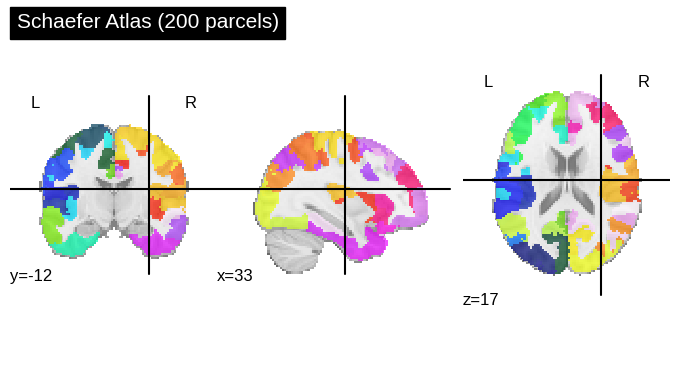

In [15]:
from nilearn import plotting
plotting.plot_roi(atlas_file, title="Schaefer Atlas (200 parcels)")
plt.show()

## Function to use

In [16]:
func_path = "/root/.cache/kagglehub/competitions/widsdatathon2025/TRAIN_NEW/TRAIN_FUNCTIONAL_CONNECTOME_MATRICES_new_36P_Pearson.csv"
cat_path = "/root/.cache/kagglehub/competitions/widsdatathon2025/TRAIN_NEW/TRAIN_CATEGORICAL_METADATA_new.xlsx"
quant_path = "/root/.cache/kagglehub/competitions/widsdatathon2025/TRAIN_NEW/TRAIN_QUANTITATIVE_METADATA_new.xlsx"
target_path = "/root/.cache/kagglehub/competitions/widsdatathon2025/TRAIN_NEW/TRAINING_SOLUTIONS.xlsx"

In [17]:
train_func_path = "/root/.cache/kagglehub/competitions/widsdatathon2025/TRAIN_NEW/TRAIN_FUNCTIONAL_CONNECTOME_MATRICES_new_36P_Pearson.csv"
train_cat_path = "/root/.cache/kagglehub/competitions/widsdatathon2025/TRAIN_NEW/TRAIN_CATEGORICAL_METADATA_new.xlsx"
train_quant_path = "/root/.cache/kagglehub/competitions/widsdatathon2025/TRAIN_NEW/TRAIN_QUANTITATIVE_METADATA_new.xlsx"
train_target_path = "/root/.cache/kagglehub/competitions/widsdatathon2025/TRAIN_NEW/TRAINING_SOLUTIONS.xlsx"

test_func_path = "/root/.cache/kagglehub/competitions/widsdatathon2025/TEST/TEST_FUNCTIONAL_CONNECTOME_MATRICES.csv"
test_cat_path = "/root/.cache/kagglehub/competitions/widsdatathon2025/TEST/TEST_CATEGORICAL.xlsx"
test_quant_path = "/root/.cache/kagglehub/competitions/widsdatathon2025/TEST/TEST_QUANTITATIVE_METADATA.xlsx"
sample_sub_path = "/root/.cache/kagglehub/competitions/widsdatathon2025/SAMPLE_SUBMISSION.xlsx"

In [18]:
train_data_functional_connectome = pd.read_csv(train_func_path, index_col="participant_id")
train_data_categorical_metadata = pd.read_excel(train_cat_path)
train_data_quantitative_metadata = pd.read_excel(train_quant_path)
train_data_target_variable = pd.read_excel(train_target_path)

test_data_functional_connectome = pd.read_csv(test_func_path, index_col="participant_id")
test_data_categorical_metadata = pd.read_excel(test_cat_path)
test_data_quantitative_metadata = pd.read_excel(test_quant_path)
sample_submission_file = pd.read_excel(sample_sub_path)

In [19]:
train_full_df = pd.merge(train_data_functional_connectome, train_data_categorical_metadata, on='participant_id')
train_full_df = pd.merge(train_full_df, train_data_quantitative_metadata, on='participant_id')
train_full_df = pd.merge(train_full_df, train_data_target_variable, on='participant_id')

test_full_df = pd.merge(test_data_functional_connectome, test_data_categorical_metadata, on='participant_id')
test_full_df = pd.merge(test_full_df, test_data_quantitative_metadata, on='participant_id')


In [20]:
target_columns = ['ADHD_Outcome', 'Sex_F']

In [21]:
if all(col in train_full_df.columns for col in target_columns):
    train_features_df = train_full_df.drop(columns=target_columns)
    print(f"Target columns {target_columns} dropped for unsupervised analysis.")
else:
    print("Warning: One or more specified target columns not found in the dataframe.")
    train_features_df = train_full_df.copy()

Target columns ['ADHD_Outcome', 'Sex_F'] dropped for unsupervised analysis.


In [22]:
print("Remaining columns for analysis:", train_features_df.columns.tolist())

Remaining columns for analysis: ['participant_id', '0throw_1thcolumn', '0throw_2thcolumn', '0throw_3thcolumn', '0throw_4thcolumn', '0throw_5thcolumn', '0throw_6thcolumn', '0throw_7thcolumn', '0throw_8thcolumn', '0throw_9thcolumn', '0throw_10thcolumn', '0throw_11thcolumn', '0throw_12thcolumn', '0throw_13thcolumn', '0throw_14thcolumn', '0throw_15thcolumn', '0throw_16thcolumn', '0throw_17thcolumn', '0throw_18thcolumn', '0throw_19thcolumn', '0throw_20thcolumn', '0throw_21thcolumn', '0throw_22thcolumn', '0throw_23thcolumn', '0throw_24thcolumn', '0throw_25thcolumn', '0throw_26thcolumn', '0throw_27thcolumn', '0throw_28thcolumn', '0throw_29thcolumn', '0throw_30thcolumn', '0throw_31thcolumn', '0throw_32thcolumn', '0throw_33thcolumn', '0throw_34thcolumn', '0throw_35thcolumn', '0throw_36thcolumn', '0throw_37thcolumn', '0throw_38thcolumn', '0throw_39thcolumn', '0throw_40thcolumn', '0throw_41thcolumn', '0throw_42thcolumn', '0throw_43thcolumn', '0throw_44thcolumn', '0throw_45thcolumn', '0throw_46thc

## Separating the dataset into two groups male and females based on the column Sex_F

In [23]:
female_df_train = train_full_df[train_full_df['Sex_F'] == 1].copy()
male_df_train   = train_full_df[train_full_df['Sex_F'] == 0].copy()

In [24]:
female_df_train

,participant_id,0throw_1thcolumn,0throw_2thcolumn,0throw_3thcolumn,0throw_4thcolumn,0throw_5thcolumn,0throw_6thcolumn,0throw_7thcolumn,0throw_8thcolumn,0throw_9thcolumn,...,SDQ_SDQ_Emotional_Problems,SDQ_SDQ_Externalizing,SDQ_SDQ_Generating_Impact,SDQ_SDQ_Hyperactivity,SDQ_SDQ_Internalizing,SDQ_SDQ_Peer_Problems,SDQ_SDQ_Prosocial,MRI_Track_Age_at_Scan,ADHD_Outcome,Sex_F
1,WHWymJu6zNZi,0.614765,0.577255,0.496127,0.496606,0.404686,0.439724,0.122590,-0.085452,0.120673,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7.670088,1,1
2,4PAQp1M6EyAo,-0.116833,0.458408,0.260703,0.639031,0.769337,0.442528,0.637110,0.192010,0.520379,...,4.0,17.0,8.0,9.0,9.0,5.0,8.0,7.743896,1,1
3,obEacy4Of68I,0.199688,0.752714,0.658283,0.575096,0.692867,0.645789,0.522750,0.412188,0.530843,...,2.0,4.0,1.0,4.0,3.0,1.0,10.0,NaN,1,1
4,s7WzzDcmDOhF,0.227321,0.613268,0.621447,0.562673,0.736709,0.589813,0.266676,0.359668,0.300771,...,3.0,6.0,3.0,3.0,8.0,5.0,6.0,NaN,1,1
5,s55ZRHrJtnlL,0.337316,0.823123,0.733585,0.418883,0.771445,0.653699,0.693189,0.345408,0.729822,...,4.0,13.0,4.0,9.0,4.0,0.0,7.0,NaN,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1206,vm2P1hmAY1hl,0.462948,0.851463,0.638908,0.542838,0.790042,0.599957,0.519429,0.197866,0.622234,...,0.0,0.0,0.0,0.0,2.0,2.0,8.0,15.869952,0,1
1207,OFxvN8lnw21w,0.082061,0.515127,0.401326,-0.016466,0.257117,0.645803,0.495707,0.345426,0.344817,...,0.0,6.0,0.0,5.0,0.0,0.0,6.0,11.933493,1,1
1208,9gpepMI9sj5q,0.265284,0.551726,0.628318,0.647700,0.710757,0.132334,0.326207,0.354319,0.531170,...,3.0,2.0,0.0,2.0,3.0,0.0,8.0,NaN,0,1
1211,syeyZjEx8FUx,0.189849,0.752876,0.842463,0.817037,0.820196,0.792950,0.650929,0.488504,0.580207,...,0.0,1.0,0.0,1.0,0.0,0.0,9.0,8.264772,0,1


In [25]:
male_df_train

,participant_id,0throw_1thcolumn,0throw_2thcolumn,0throw_3thcolumn,0throw_4thcolumn,0throw_5thcolumn,0throw_6thcolumn,0throw_7thcolumn,0throw_8thcolumn,0throw_9thcolumn,...,SDQ_SDQ_Emotional_Problems,SDQ_SDQ_Externalizing,SDQ_SDQ_Generating_Impact,SDQ_SDQ_Hyperactivity,SDQ_SDQ_Internalizing,SDQ_SDQ_Peer_Problems,SDQ_SDQ_Prosocial,MRI_Track_Age_at_Scan,ADHD_Outcome,Sex_F
0,70z8Q2xdTXM3,0.222930,0.527903,0.429966,0.060457,0.566489,0.315342,0.508408,-0.078290,0.525692,...,1.0,4.0,5.0,4.0,4.0,3.0,9.0,11.889002,1,0
6,sId1cQF5F22m,0.205613,0.514554,0.580002,0.356749,0.355509,0.402521,0.503667,-0.090709,0.442115,...,4.0,8.0,2.0,4.0,9.0,5.0,10.0,13.115674,0,0
7,T4CaImRntWnB,-0.190693,0.311654,0.309758,0.466017,0.461799,0.348240,0.258351,0.267011,0.204740,...,1.0,9.0,5.0,9.0,3.0,2.0,9.0,8.702258,1,0
8,a5JFxSZjVg5i,0.243401,0.274912,0.364787,0.252179,0.645695,0.677565,0.480189,0.400882,0.407494,...,2.0,11.0,3.0,7.0,4.0,2.0,7.0,NaN,1,0
9,VZnIq2hRErI5,0.182886,0.734523,0.286137,0.300662,0.542568,0.707586,0.646182,0.263905,0.554053,...,6.0,8.0,4.0,7.0,7.0,1.0,8.0,NaN,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1200,a8puDozNuOdh,0.511881,0.671085,0.608612,0.580200,0.608822,0.425833,0.568982,0.386477,0.473539,...,1.0,11.0,3.0,10.0,1.0,0.0,9.0,10.646132,1,0
1203,HNjDLTaifDI2,0.022649,0.324982,0.451550,0.600290,0.692237,0.629771,0.565231,0.440082,0.428669,...,1.0,3.0,0.0,3.0,2.0,1.0,7.0,8.568560,1,0
1205,FCRyMz9O6yCq,0.071400,0.697010,0.673969,0.689061,0.823189,0.679552,0.530139,0.289084,0.407226,...,4.0,11.0,6.0,9.0,7.0,3.0,6.0,11.571640,1,0
1209,FIDen5rdMc0v,-0.018377,0.576689,0.527451,0.327463,0.586868,0.573689,0.300544,0.301103,0.659840,...,1.0,12.0,5.0,9.0,4.0,3.0,8.0,15.462012,1,0


In [26]:
train_data_categorical_metadata.columns

Index(['participant_id', 'Basic_Demos_Enroll_Year', 'Basic_Demos_Study_Site',
       'PreInt_Demos_Fam_Child_Ethnicity', 'PreInt_Demos_Fam_Child_Race',
       'MRI_Track_Scan_Location', 'Barratt_Barratt_P1_Edu',
       'Barratt_Barratt_P1_Occ', 'Barratt_Barratt_P2_Edu',
       'Barratt_Barratt_P2_Occ'],
      dtype='object')

In [27]:
train_data_quantitative_metadata.columns

Index(['participant_id', 'EHQ_EHQ_Total', 'ColorVision_CV_Score',
       'APQ_P_APQ_P_CP', 'APQ_P_APQ_P_ID', 'APQ_P_APQ_P_INV',
       'APQ_P_APQ_P_OPD', 'APQ_P_APQ_P_PM', 'APQ_P_APQ_P_PP',
       'SDQ_SDQ_Conduct_Problems', 'SDQ_SDQ_Difficulties_Total',
       'SDQ_SDQ_Emotional_Problems', 'SDQ_SDQ_Externalizing',
       'SDQ_SDQ_Generating_Impact', 'SDQ_SDQ_Hyperactivity',
       'SDQ_SDQ_Internalizing', 'SDQ_SDQ_Peer_Problems', 'SDQ_SDQ_Prosocial',
       'MRI_Track_Age_at_Scan'],
      dtype='object')

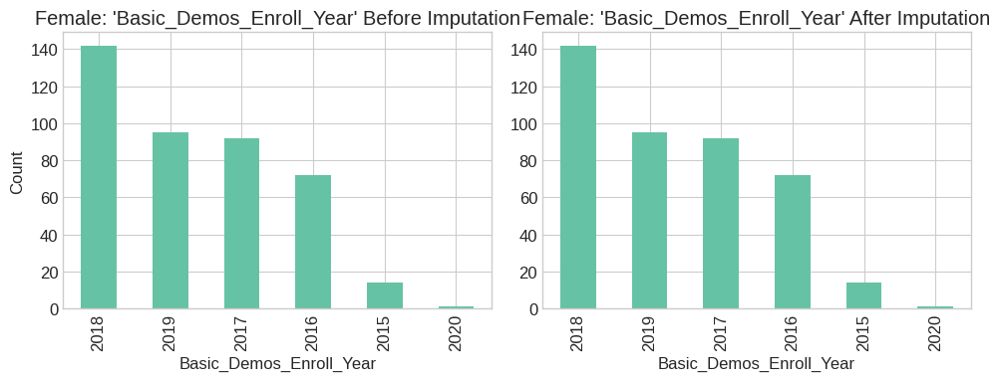

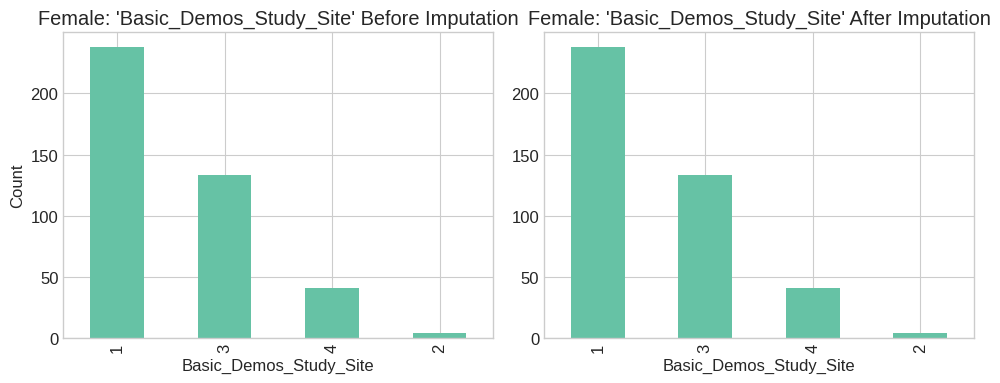

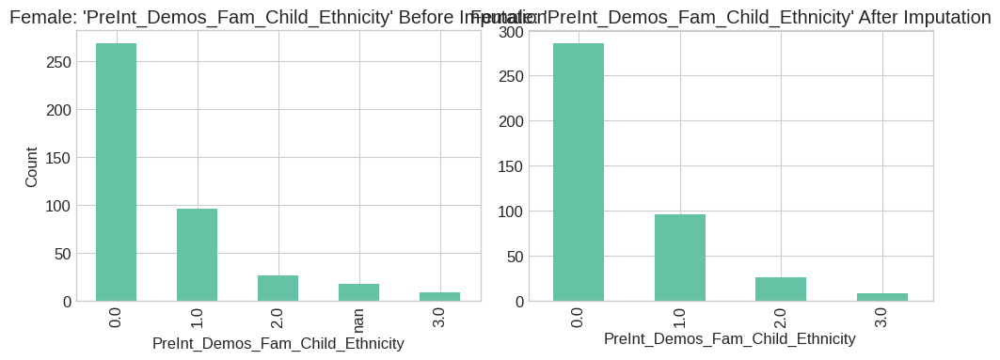

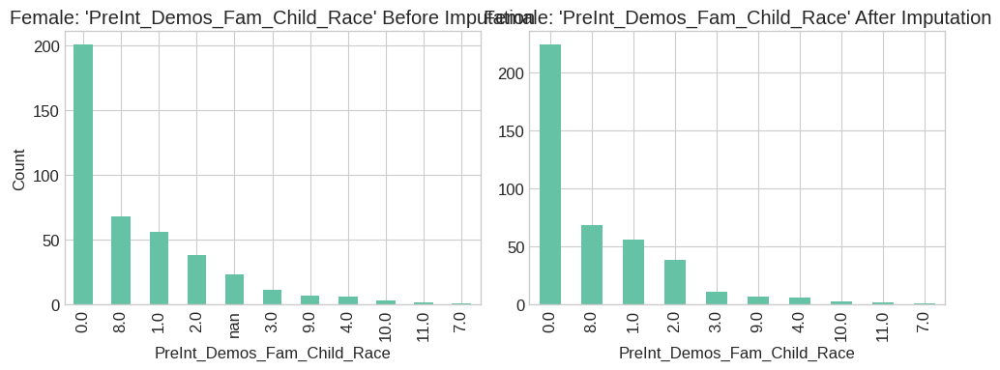

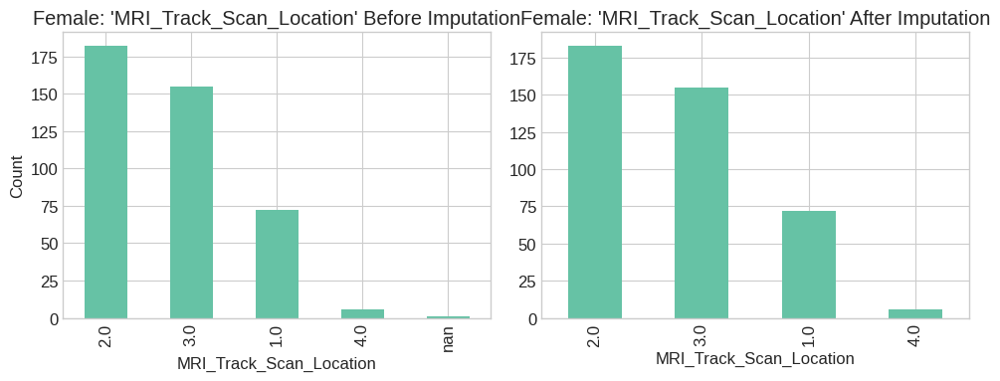

...

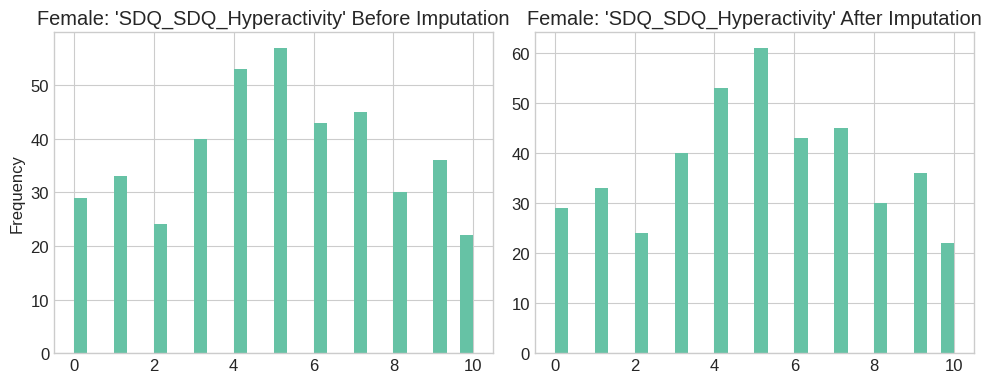

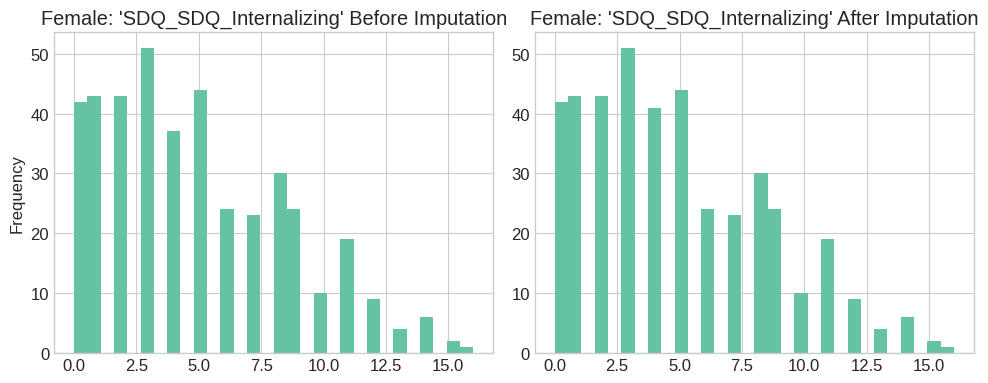

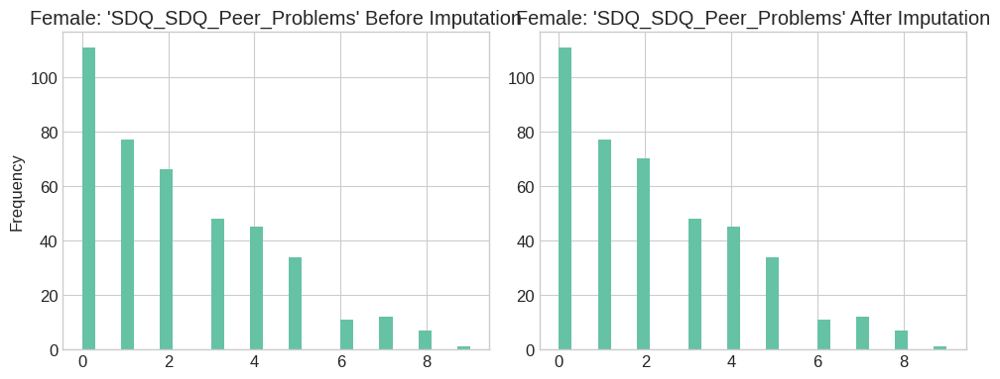

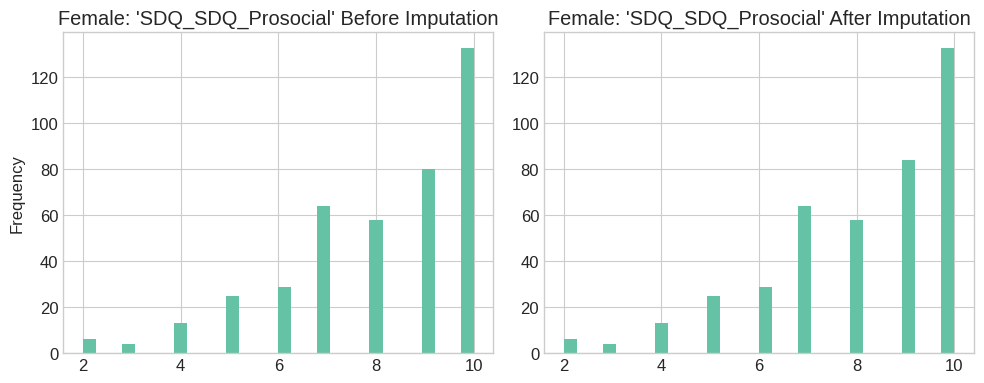

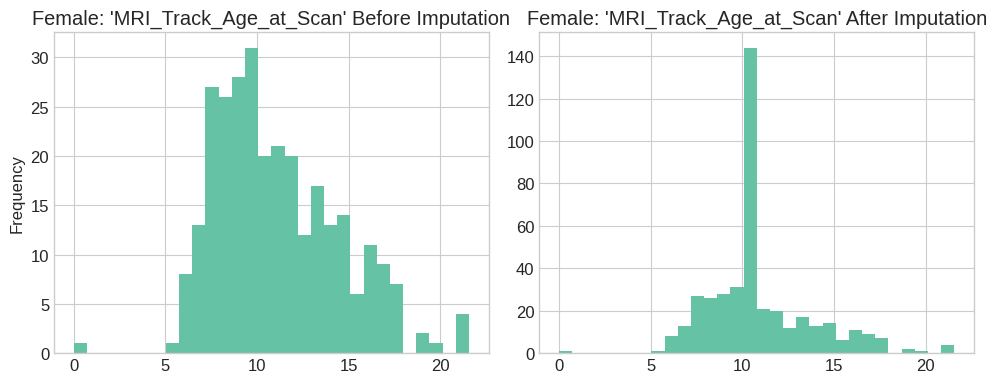

'impute_df_and_plot' completed in 12.7675 seconds.



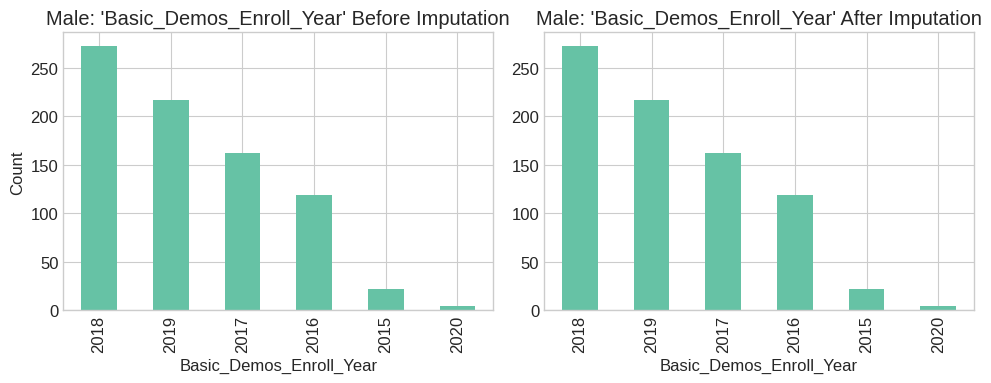

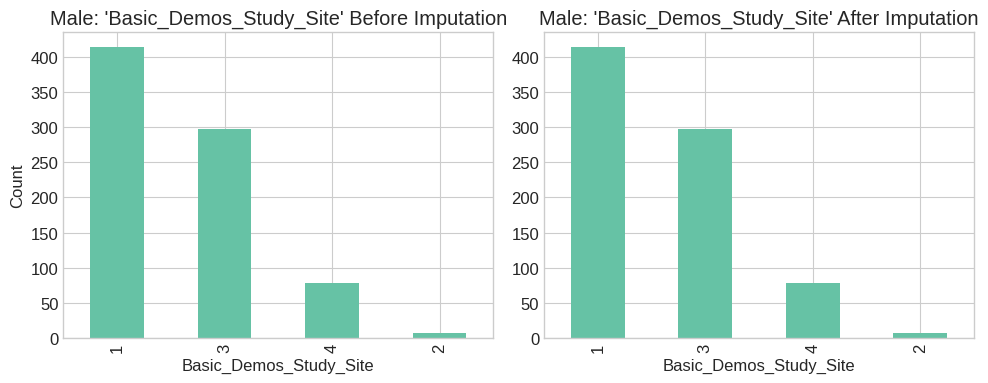

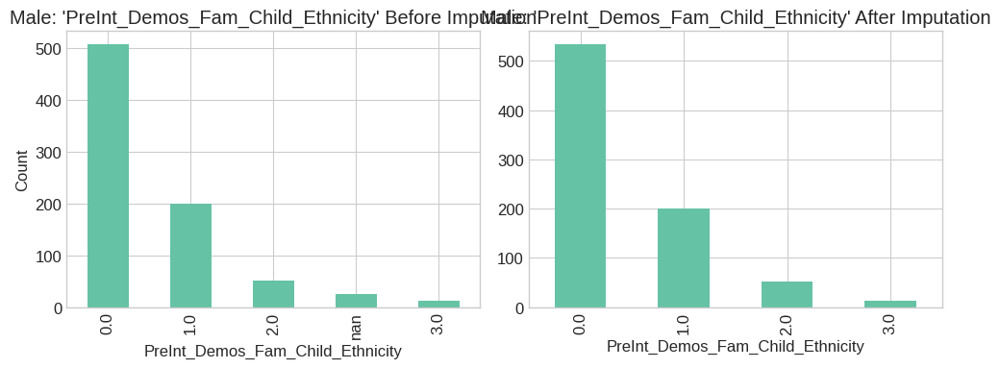

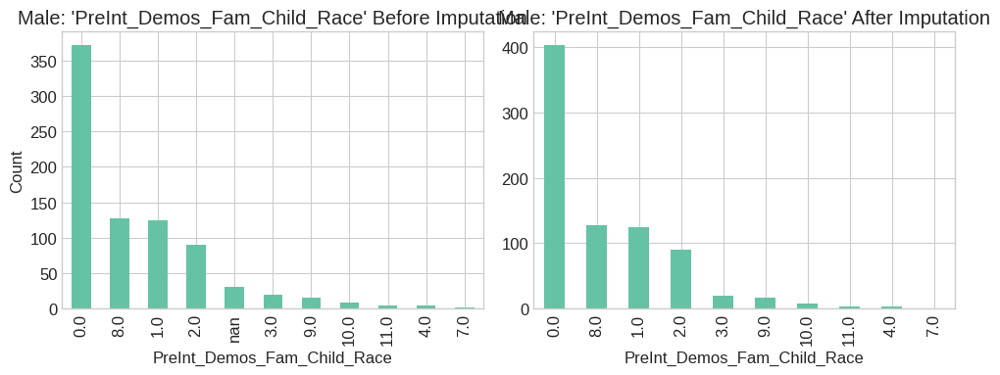

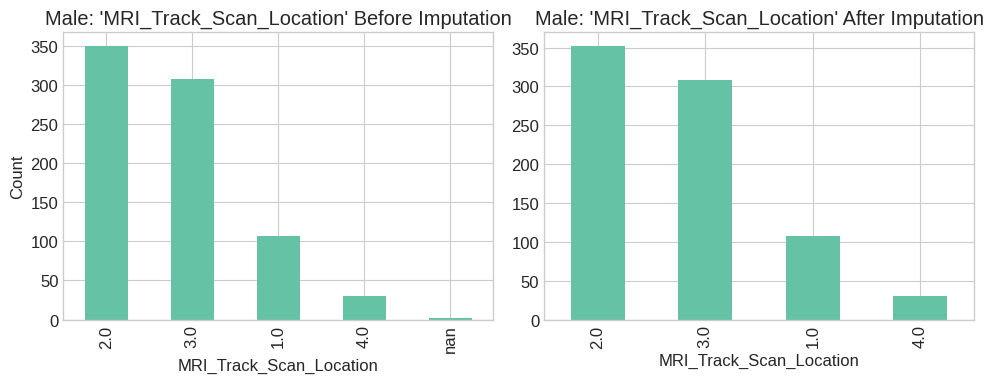

...

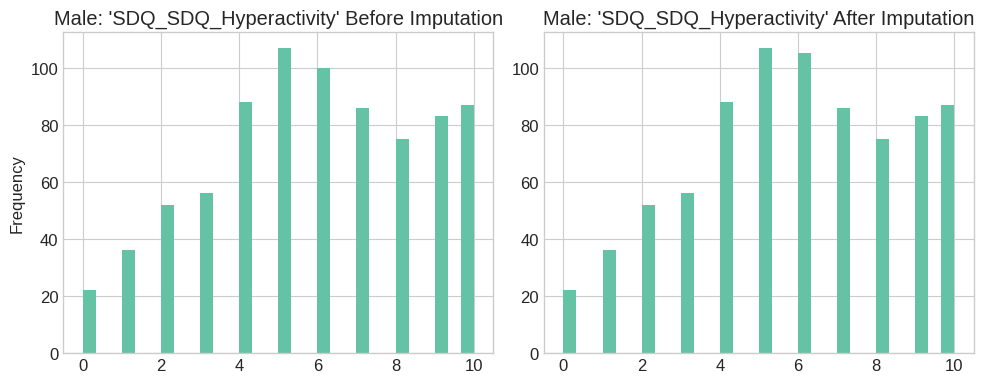

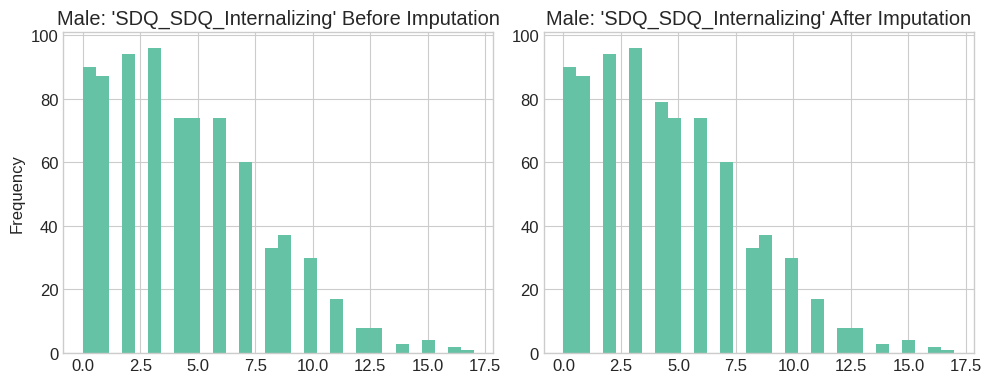

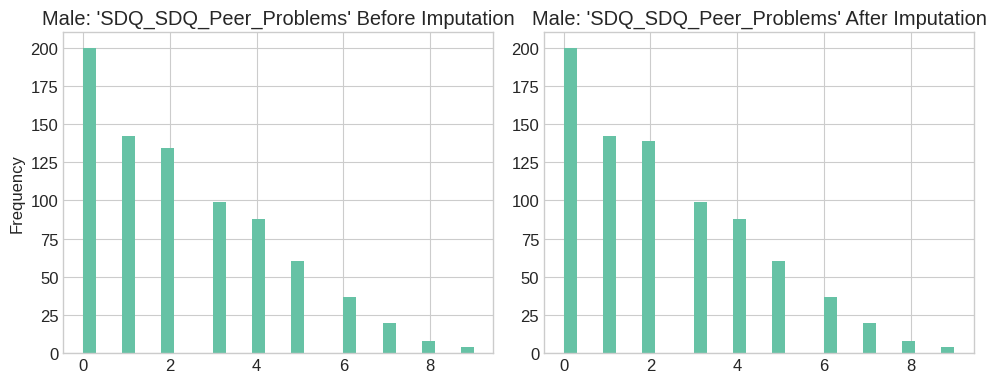

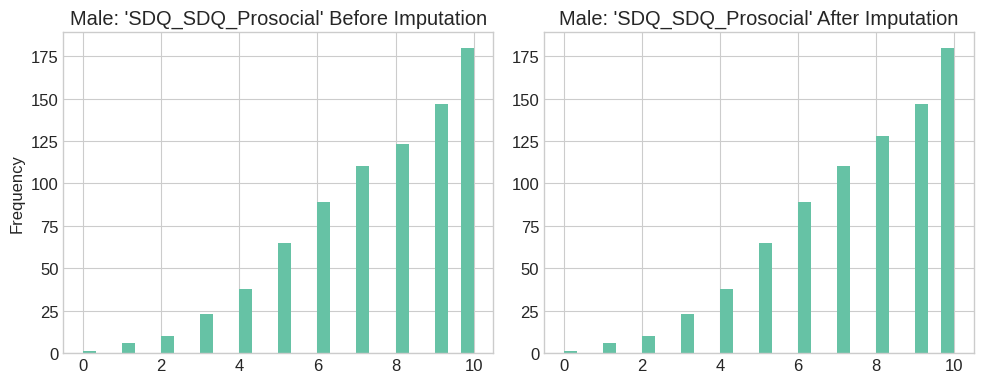

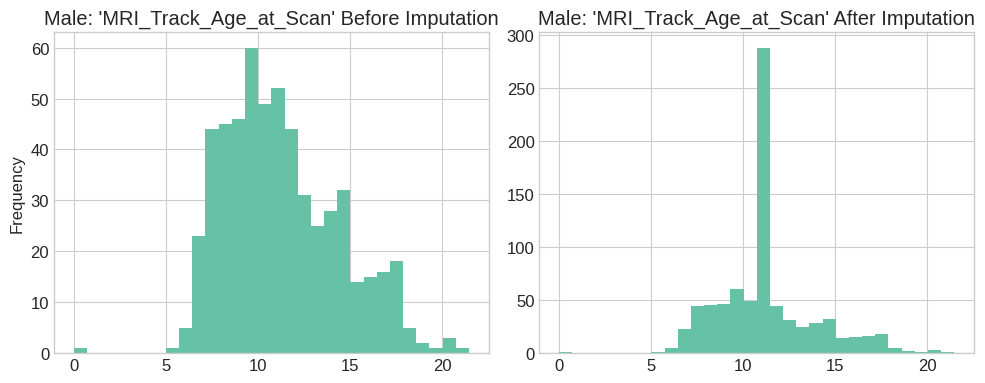

'impute_df_and_plot' completed in 11.8694 seconds.



In [28]:
categorical_cols = [c for c in train_data_categorical_metadata.columns if c != 'participant_id']
quantitative_cols = [c for c in train_data_quantitative_metadata.columns if c != 'participant_id']

female_df_imputed = impute_df_and_plot(
    female_df_train,
    categorical_cols,
    quantitative_cols,
    group_name="Female"
)

male_df_imputed   = impute_df_and_plot(
    male_df_train,
    categorical_cols,
    quantitative_cols,
    group_name="Male"
)

In [29]:
missing_female = female_df_imputed.isna().sum()
missing_male   = male_df_imputed.isna().sum()

print("Missing values per column in female_df_imputed:")
print(missing_female)

print("\nMissing values per column in male_df_imputed:")
print(missing_male)

print("\nAny missing in female_df_imputed?", missing_female.any())
print("Any missing in male_df_imputed?",   missing_male.any())

assert not missing_female.any(), "female_df_imputed still has missing values!"
assert not missing_male.any(),   "male_df_imputed still has missing values!"
print("\nAll missing values have been successfully imputed.")


Missing values per column in female_df_imputed:
participant_id           0
0throw_1thcolumn         0
0throw_2thcolumn         0
0throw_3thcolumn         0
0throw_4thcolumn         0
                        ..
SDQ_SDQ_Peer_Problems    0
SDQ_SDQ_Prosocial        0
MRI_Track_Age_at_Scan    0
ADHD_Outcome             0
Sex_F                    0
Length: 19930, dtype: int64

Missing values per column in male_df_imputed:
participant_id           0
0throw_1thcolumn         0
0throw_2thcolumn         0
0throw_3thcolumn         0
0throw_4thcolumn         0
                        ..
SDQ_SDQ_Peer_Problems    0
SDQ_SDQ_Prosocial        0
MRI_Track_Age_at_Scan    0
ADHD_Outcome             0
Sex_F                    0
Length: 19930, dtype: int64

Any missing in female_df_imputed? False
Any missing in male_df_imputed? False

All missing values have been successfully imputed.


In [30]:
female_df_train_experiment = female_df_imputed.drop(columns=['participant_id'])
male_df_train_experiment   = male_df_imputed.drop(columns=['participant_id'])

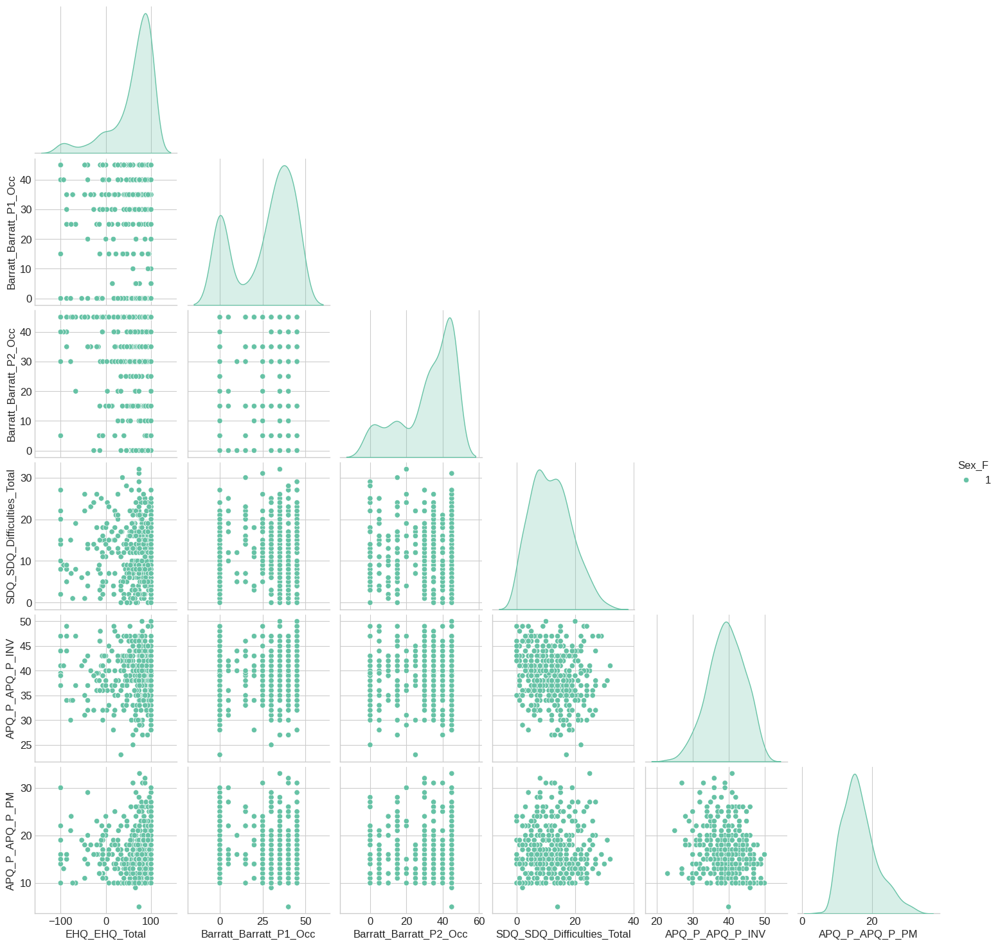

In [31]:
variances = female_df_train_experiment.var().sort_values(ascending=False)
topN = 6
top_feats = variances.iloc[:topN].index.tolist()

sns.pairplot(
    data = female_df_train_experiment[top_feats + ['Sex_F']],
    hue  = "Sex_F",
    palette = "Set2",
    corner = True,
    diag_kind = "kde"
)
plt.show()


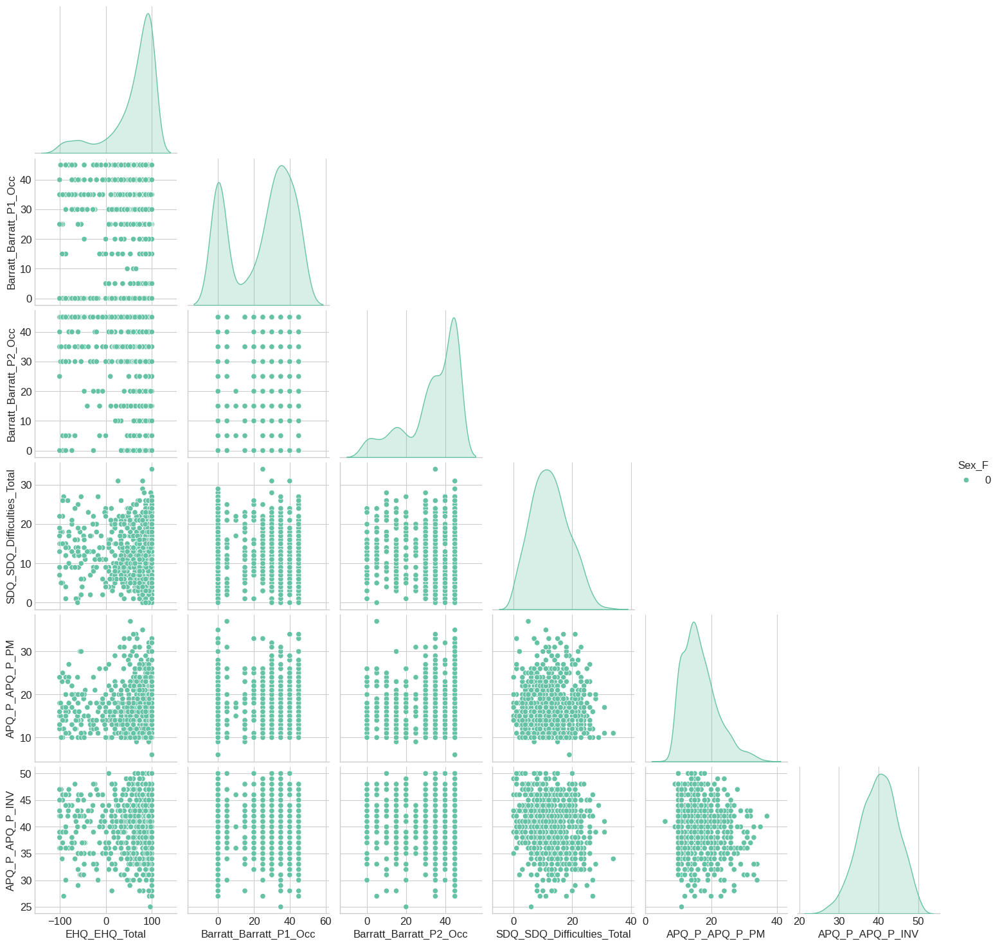

In [32]:
variances = male_df_train_experiment.var().sort_values(ascending=False)
topN = 6
top_feats = variances.iloc[:topN].index.tolist()

sns.pairplot(
    data = male_df_train_experiment[top_feats + ['Sex_F']],
    hue  = "Sex_F",
    palette = "Set2",
    corner = True,
    diag_kind = "kde"
)
plt.show()

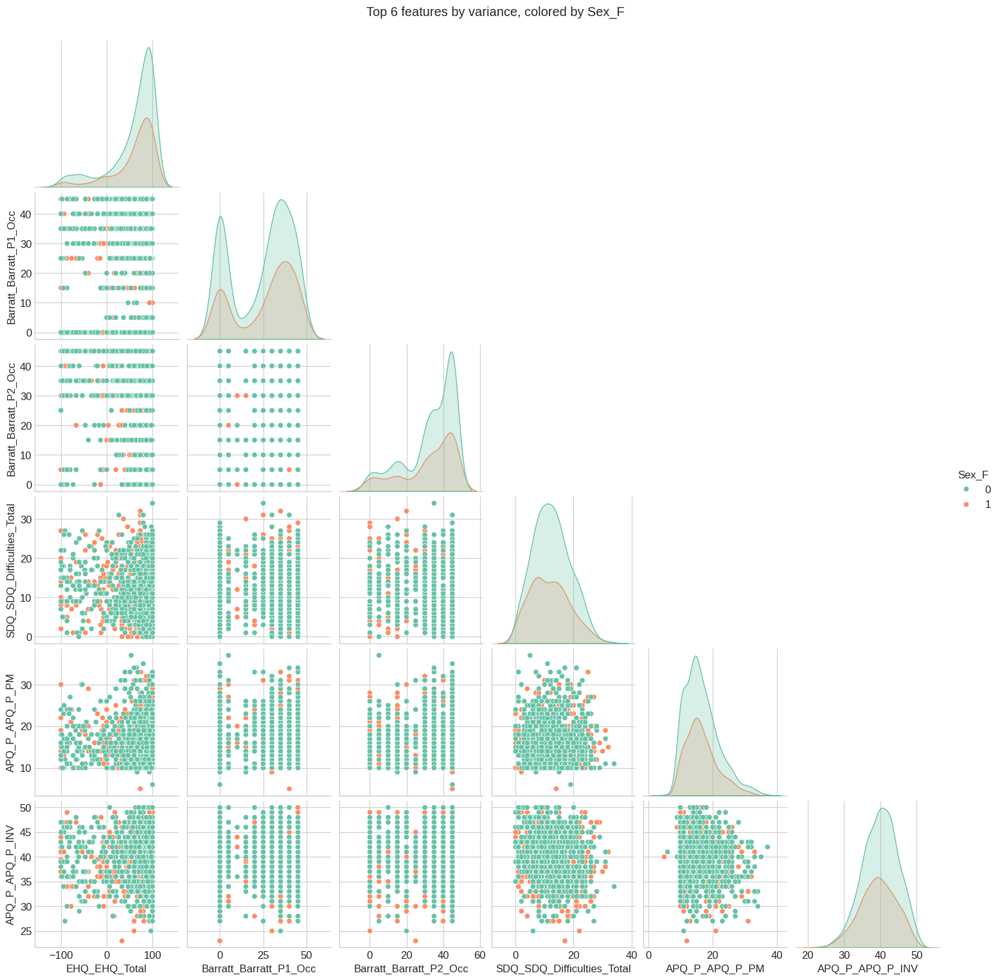

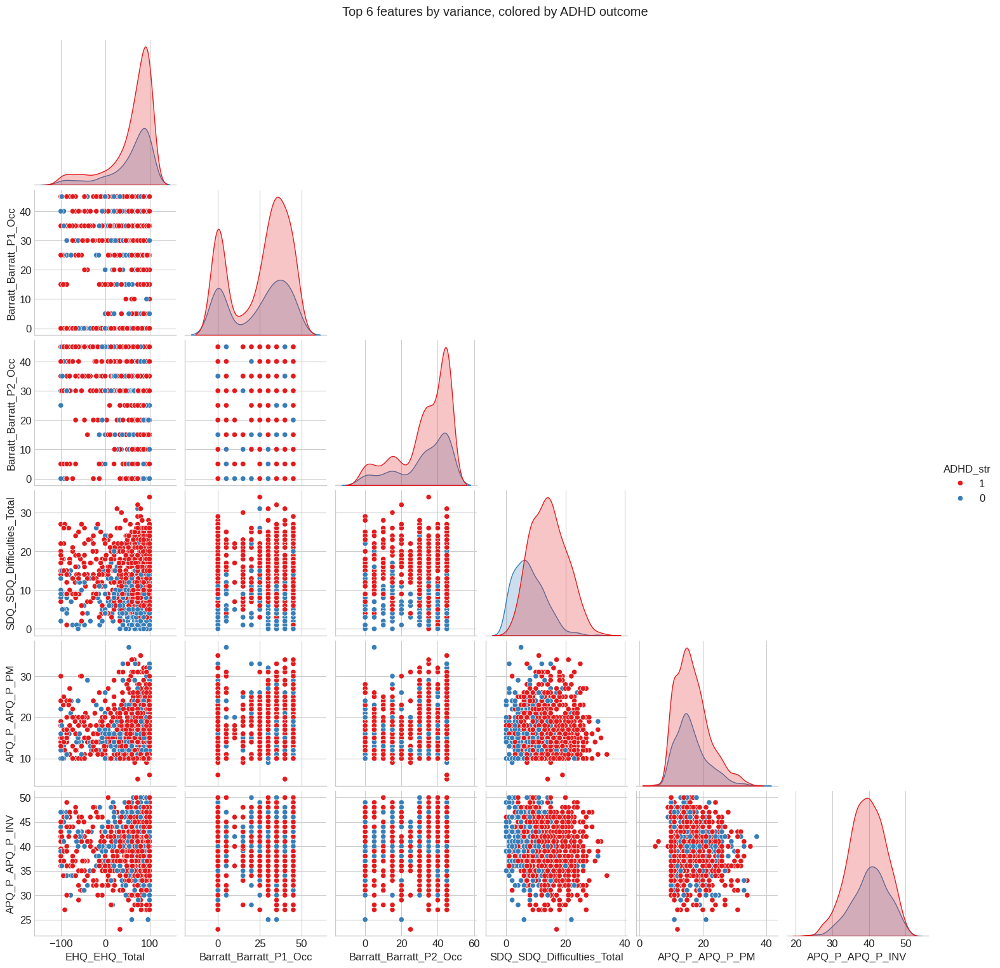

In [33]:
full_train = pd.concat([female_df_train_experiment, male_df_train_experiment], axis=0).reset_index(drop=True)

exclude = {'participant_id', 'Sex_F', 'ADHD_Outcome'}
feature_cols = [c for c in full_train.columns if c not in exclude]

variances   = full_train[feature_cols].var()
top_n       = 6
top_features = variances.sort_values(ascending=False).head(top_n).index.tolist()

sns.pairplot(
    data      = full_train[top_features + ['Sex_F']],
    hue       = 'Sex_F',
    palette   = "Set2",
    corner    = True,
    diag_kind = "kde"
)
plt.suptitle(f"Top {top_n} features by variance, colored by Sex_F", y=1.02)
plt.show()


full_train['ADHD_str'] = full_train['ADHD_Outcome'].astype(str)
sns.pairplot(
    data      = full_train[top_features + ['ADHD_str']],
    hue       = 'ADHD_str',
    palette   = "Set1",
    corner    = True,
    diag_kind = "kde"
)
plt.suptitle(f"Top {top_n} features by variance, colored by ADHD outcome", y=1.02)
plt.show()


In [34]:
file_path = "/root/.cache/kagglehub/competitions/widsdatathon2025/Data Dictionary.xlsx"

excel_data = pd.ExcelFile(file_path)

print("Sheet names:", excel_data.sheet_names)

df_dictionary = excel_data.parse(excel_data.sheet_names[0])
df_instrument_desc = excel_data.parse(excel_data.sheet_names[1])
df_EHQ = excel_data.parse(excel_data.sheet_names[2])
df_APQ = excel_data.parse(excel_data.sheet_names[3])
df_SDQ = excel_data.parse(excel_data.sheet_names[4])

df_dictionary

Sheet names: ['Dictionary', 'Instrument_Description', 'EHQ', 'APQ', 'SDQ']


,DataType,Instrument,Field,Description,Type,Labels
0,QUANTITATIVE METADATA,NaN,NaN,NaN,NaN,NaN
1,NaN,Identifier,participant_id,Participant ID,str,NaN
2,Quantitative,Edinburgh Handedness Questionnaire,EHQ_EHQ_Total,Laterality Index (Score),float,-100 = 10th left\n−28 ≤ LI < 48 = middle\n100 ...
3,Quantitative,Ishihara Color Vision Test,ColorVision_CV_Score,Color vision test score,int,NaN
4,Quantitative,Alabama Parenting Questionnaire - Parent Report,APQ_P_APQ_P_CP,Corporal Punishment Score,int,NaN
5,Quantitative,Alabama Parenting Questionnaire - Parent Report,APQ_P_APQ_P_ID,Inconsistent Discipline Score,int,NaN
6,Quantitative,Alabama Parenting Questionnaire - Parent Report,APQ_P_APQ_P_INV,Involvement Score,int,NaN
7,Quantitative,Alabama Parenting Questionnaire - Parent Report,APQ_P_APQ_P_OPD,Other Discipline Practices Score (Not factored...,int,NaN
8,Quantitative,Alabama Parenting Questionnaire - Parent Report,APQ_P_APQ_P_PM,Poor Monitoring/Supervision Score,int,NaN
9,Quantitative,Alabama Parenting Questionnaire - Parent Report,APQ_P_APQ_P_PP,Positive Parenting Score,int,NaN


In [35]:
train_data_target_variable

,participant_id,ADHD_Outcome,Sex_F
0,UmrK0vMLopoR,1,1
1,CPaeQkhcjg7d,1,0
2,Nb4EetVPm3gs,1,0
3,p4vPhVu91o4b,1,1
4,M09PXs7arQ5E,1,1
...,...,...,...
1208,Atx7oub96GXS,0,0
1209,groSbUfkQngM,0,1
1210,zmxGvIrOD0bt,0,1
1211,rOmWFuJCud5G,0,0


In [36]:

sample_connectome_row = train_data_functional_connectome.iloc[0].values
assert len(sample_connectome_row) == 19900, "Unexpected number of connectome features"

n = 200

matrix = np.zeros((n, n))

upper_tri_indices = np.triu_indices(n, k=1)
matrix[upper_tri_indices] = sample_connectome_row

matrix = matrix + matrix.T

np.fill_diagonal(matrix, 1)

matrix_df = pd.DataFrame(matrix)
print("Reconstructed Connectome Matrix (first 5 rows):")
print(matrix_df.head())


train_metadata = train_data_categorical_metadata.merge(train_data_quantitative_metadata, on="participant_id", how="left")
train_full = train_metadata.merge(train_data_target_variable, on="participant_id", how="left")

print("Combined Train Metadata (first 5 rows):")
print(train_full.head())


train_df, val_df = train_test_split(train_full, test_size=0.2, random_state=42, stratify=train_full["ADHD_Outcome"])
print("Train/Validation split shapes:")
print("Train:", train_df.shape, "Validation:", val_df.shape)


Reconstructed Connectome Matrix (first 5 rows):
        0         1         2         3         4         5         6    \
0  1.000000  0.222930  0.527903  0.429966  0.060457  0.566489  0.315342   
1  0.222930  1.000000 -0.108840  0.636812  0.378361  0.036181 -0.316175   
2  0.527903 -0.108840  1.000000  0.107023 -0.299101  0.224529  0.207511   
3  0.429966  0.636812  0.107023  1.000000  0.385892  0.499531 -0.032531   
4  0.060457  0.378361 -0.299101  0.385892  1.000000  0.242966  0.007723   

        7         8         9    ...       190       191       192       193  \
0  0.508408 -0.078290  0.525692  ... -0.168477 -0.030828  0.110376 -0.046884   
1 -0.398533 -0.422995 -0.292488  ...  0.028873 -0.141050 -0.127055 -0.136021   
2  0.484571  0.086201  0.505407  ... -0.107371  0.138462 -0.074459  0.091020   
3  0.005849 -0.297071  0.045815  ... -0.271935 -0.112785 -0.216166  0.002142   
4 -0.198613 -0.211661 -0.229576  ... -0.186299 -0.304618  0.060292  0.242239   

        194       19

> Degree centrality and clustering coefficient are network metrics that help quantify the topology of the brain connectivity graph derived from the connectome data. Here’s why they are used:

**Degree Centrality:**

- This metric measures the number of connections (or edges) each node (brain region) has in the network.
- In the context of a connectome, a node with high degree centrality is highly connected to other brain regions, which might indicate its importance in facilitating communication across the brain.
- Analyzing degree centrality can help identify key regions that could be central to brain function or implicated in ADHD subtypes.

**Clustering Coefficient:**

- This metric quantifies how connected a node’s neighbors are to each other.
- In other words, it measures the local cohesiveness or "cliquishness" of the network around a node.
- In brain networks, a high clustering coefficient may indicate specialized local processing or functional modules.
- By examining clustering coefficients, we gain insights into how brain regions group together, which may differ between ADHD subtypes or between genders.

Average degree centrality: 0.03427135678391959
Average clustering coefficient: 0.3568620962370963


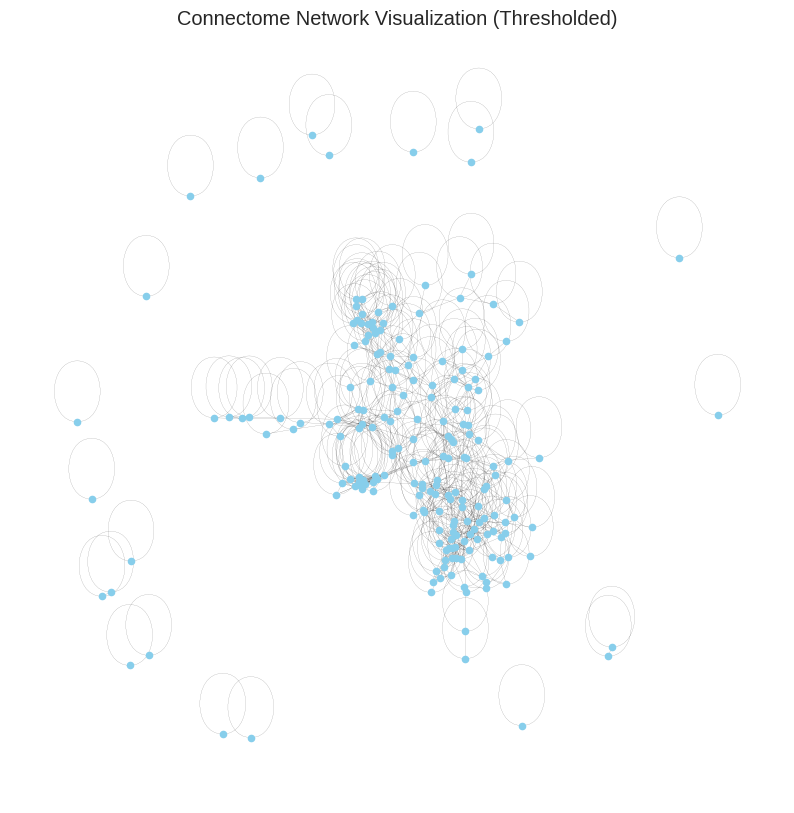

In [37]:
# For visualization, we use the connectome matrix from one participant.
# Here, we threshold the connectivity values to keep only strong connections.
threshold = 0.5
adjacency_matrix = matrix.copy()
adjacency_matrix[adjacency_matrix < threshold] = 0

G = nx.from_numpy_array(adjacency_matrix)

# Compute basic network measures: degree centrality, clustering coefficient
degree_centrality = nx.degree_centrality(G)
clustering_coeff = nx.clustering(G)

print("Average degree centrality:", np.mean(list(degree_centrality.values())))
print("Average clustering coefficient:", np.mean(list(clustering_coeff.values())))

plt.figure(figsize=(10, 10))
pos = nx.spring_layout(G, seed=42)
nx.draw_networkx_nodes(G, pos, node_size=20, node_color="skyblue")
nx.draw_networkx_edges(G, pos, width=0.1, alpha=0.7)
plt.title("Connectome Network Visualization (Thresholded)")
plt.axis("off")
plt.show()

In [38]:
train_data_functional_connectome

,0throw_1thcolumn,0throw_2thcolumn,0throw_3thcolumn,0throw_4thcolumn,0throw_5thcolumn,0throw_6thcolumn,0throw_7thcolumn,0throw_8thcolumn,0throw_9thcolumn,0throw_10thcolumn,...,195throw_196thcolumn,195throw_197thcolumn,195throw_198thcolumn,195throw_199thcolumn,196throw_197thcolumn,196throw_198thcolumn,196throw_199thcolumn,197throw_198thcolumn,197throw_199thcolumn,198throw_199thcolumn
participant_id,,,,,,,,,,,,,,,,,,,,,
70z8Q2xdTXM3,0.222930,0.527903,0.429966,0.060457,0.566489,0.315342,0.508408,-0.078290,0.525692,0.470063,...,0.224985,0.397448,0.422966,0.184642,0.305549,0.420349,0.016328,0.561864,0.471170,0.365221
WHWymJu6zNZi,0.614765,0.577255,0.496127,0.496606,0.404686,0.439724,0.122590,-0.085452,0.120673,0.276350,...,0.217546,-0.014549,0.000440,-0.096451,0.454501,0.343916,0.167313,0.607656,0.550623,0.503176
4PAQp1M6EyAo,-0.116833,0.458408,0.260703,0.639031,0.769337,0.442528,0.637110,0.192010,0.520379,0.378557,...,0.342487,-0.021141,-0.037836,0.075069,0.412712,0.292708,0.391005,0.461544,0.508912,0.624232
obEacy4Of68I,0.199688,0.752714,0.658283,0.575096,0.692867,0.645789,0.522750,0.412188,0.530843,0.259596,...,0.103562,-0.178313,0.210983,-0.018666,0.436313,0.592982,0.216205,0.341272,0.440313,0.558193
s7WzzDcmDOhF,0.227321,0.613268,0.621447,0.562673,0.736709,0.589813,0.266676,0.359668,0.300771,0.331445,...,-0.164956,0.007064,-0.120904,-0.488095,0.493575,-0.215361,0.210685,0.055850,0.119065,0.108273
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9gpepMI9sj5q,0.265284,0.551726,0.628318,0.647700,0.710757,0.132334,0.326207,0.354319,0.531170,0.340388,...,0.127097,0.129787,0.298987,0.114577,0.534109,0.118893,0.181292,0.181055,0.238357,0.577009
FIDen5rdMc0v,-0.018377,0.576689,0.527451,0.327463,0.586868,0.573689,0.300544,0.301103,0.659840,0.434427,...,0.482214,-0.159587,-0.162498,-0.093249,0.309914,0.143818,0.218337,0.389331,0.328741,0.238443
dlsMC4TXL4e8,0.227028,0.405659,0.023545,-0.093085,-0.068960,0.647574,0.762552,0.465109,0.199337,-0.357953,...,-0.379304,0.126976,0.193695,0.214483,0.429836,0.302141,0.104774,0.856375,0.303248,0.363639


In [39]:
male_df = train_full[train_full["Sex_F"] == 0]
female_df = train_full[train_full["Sex_F"] == 1]
male_ids = male_df["participant_id"].values
female_ids = female_df["participant_id"].values

male_connectome = train_data_functional_connectome.loc[male_ids]
female_connectome = train_data_functional_connectome.loc[female_ids]

In [40]:
male_connectome

,0throw_1thcolumn,0throw_2thcolumn,0throw_3thcolumn,0throw_4thcolumn,0throw_5thcolumn,0throw_6thcolumn,0throw_7thcolumn,0throw_8thcolumn,0throw_9thcolumn,0throw_10thcolumn,...,195throw_196thcolumn,195throw_197thcolumn,195throw_198thcolumn,195throw_199thcolumn,196throw_197thcolumn,196throw_198thcolumn,196throw_199thcolumn,197throw_198thcolumn,197throw_199thcolumn,198throw_199thcolumn
participant_id,,,,,,,,,,,,,,,,,,,,,
00aIpNTbG5uh,0.361339,0.791402,0.530706,0.623133,0.845830,0.680234,0.537144,0.387455,0.498571,0.049068,...,-0.047477,-0.096450,-0.280312,0.037560,0.423037,0.242453,0.336213,0.402338,0.327915,0.539032
00fV0OyyoLfw,0.051430,0.613198,0.635255,0.391237,0.451225,0.600475,0.420935,0.234825,0.322048,0.181864,...,-0.143218,-0.276464,-0.332783,-0.332711,0.556939,0.475578,0.429196,0.457970,0.312571,0.595978
06YUNBA9ZRLq,0.415220,0.585700,0.355835,0.664142,0.683491,0.380201,0.375091,0.212314,0.445294,0.226854,...,-0.158995,-0.274017,-0.141012,-0.002865,0.515169,0.336139,0.316430,0.442230,0.177079,0.378278
0cduHhwrQN4r,-0.107526,0.705884,0.353501,0.355610,0.601175,0.421674,0.641731,0.314264,0.482630,0.489581,...,0.323087,0.285929,0.315651,0.460030,0.744986,0.659421,0.540429,0.832320,0.610659,0.703517
0FUWCjn9YMN1,0.308091,0.736951,0.653909,0.696388,0.872904,0.708792,0.640850,0.433711,0.650284,0.441075,...,0.044432,-0.166308,-0.144400,0.191009,0.460177,0.479879,0.567664,0.689123,0.589488,0.546599
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ZugkgQoYcfZP,0.120359,0.744312,0.765631,0.405145,0.657554,0.634995,0.542515,0.087621,0.710948,0.314592,...,0.182928,-0.150197,-0.030591,0.023801,0.014645,0.165579,0.133284,0.582474,0.685005,0.514620
zW62ObiZfmKJ,0.406548,0.737522,0.652281,0.615226,0.664160,0.589723,0.189801,0.229550,0.209910,0.242011,...,-0.222126,-0.247010,-0.211985,0.110818,0.460089,0.478527,0.203150,0.548552,0.367971,0.336219
zwBG0rZ05Mcb,0.251472,0.692684,0.544077,0.622913,0.658320,0.481675,0.476222,0.293739,0.368002,0.236086,...,-0.126600,-0.393645,-0.074682,-0.204213,0.370247,0.238742,0.131456,0.472743,0.588147,0.418452


> The threshold of 0.5 acts as a filtering step for your connectome data. When it is applied, any connection (or edge weight) in the reconstructed matrix that is below 0.5 is set to zero. This means:

- **Noise Reduction:** It helps to remove weak connections that might be due to noise or not biologically significant.

- **Sparsification:** By zeroing out values below 0.5, we create a sparser matrix, which often makes the resulting graph (and its network metrics) more interpretable.

- **Focusing on Stronger Connections:** Only the stronger, more meaningful connections (with values 0.5 or above) are retained. This can be useful for highlighting key patterns in brain connectivity.

In [41]:
network_metrics_df = compute_network_metrics(train_data_functional_connectome, threshold=0.5, n=200)

In [42]:
network_metrics_df

,patient_id,avg_degree_centrality,avg_clustering_coefficient
0,70z8Q2xdTXM3,0.034271,0.356862
1,WHWymJu6zNZi,0.031809,0.401375
2,4PAQp1M6EyAo,0.058844,0.493571
3,obEacy4Of68I,0.051558,0.477462
4,s7WzzDcmDOhF,0.041307,0.409811
...,...,...,...
1208,9gpepMI9sj5q,0.072060,0.468035
1209,FIDen5rdMc0v,0.041156,0.401679
1210,dlsMC4TXL4e8,0.062663,0.474076
1211,syeyZjEx8FUx,0.041457,0.405173


In [43]:
network_metrics_males = compute_network_metrics(male_connectome, threshold=0.5, n=200)
network_metrics_females = compute_network_metrics(female_connectome, threshold=0.5, n=200)

In [44]:
network_metrics_males

,patient_id,avg_degree_centrality,avg_clustering_coefficient
0,00aIpNTbG5uh,0.064523,0.496581
1,00fV0OyyoLfw,0.046533,0.441737
2,06YUNBA9ZRLq,0.031910,0.287702
3,0cduHhwrQN4r,0.058945,0.446252
4,0FUWCjn9YMN1,0.070854,0.517800
...,...,...,...
792,ZugkgQoYcfZP,0.051910,0.474164
793,zW62ObiZfmKJ,0.043769,0.429290
794,zwBG0rZ05Mcb,0.042714,0.455931
795,zwXD5v17Rx01,0.041457,0.397972


In [45]:
network_metrics_df_sorted = network_metrics_df.sort_values(by='avg_degree_centrality', ascending=False)

network_metrics_df_sorted


,patient_id,avg_degree_centrality,avg_clustering_coefficient
42,fRHYMh3Q8jk6,0.242060,0.692009
703,Wd82KohzG2Lf,0.151910,0.601733
134,8Ro2MJOI8nC1,0.148492,0.585673
650,Wg8uWfarMR8q,0.126382,0.598386
835,MkC90gNpKWfP,0.118141,0.609925
...,...,...,...
842,3yjwwRWX7KUY,0.021859,0.146490
167,4VEPJjJTP0Oz,0.021558,0.246719
572,XhBHRzIcHLLX,0.020151,0.208165
294,N72fbPUgTKvq,0.018844,0.147060


In [46]:

network_metrics_df_sorted_avg_clustering_coefficient = network_metrics_df.sort_values(by='avg_clustering_coefficient', ascending=False)

network_metrics_df_sorted_avg_clustering_coefficient

,patient_id,avg_degree_centrality,avg_clustering_coefficient
42,fRHYMh3Q8jk6,0.242060,0.692009
263,glkmphTnHpNB,0.105025,0.618161
807,2bmtDhItZVT0,0.101759,0.610700
835,MkC90gNpKWfP,0.118141,0.609925
703,Wd82KohzG2Lf,0.151910,0.601733
...,...,...,...
572,XhBHRzIcHLLX,0.020151,0.208165
1098,OeH9RFBOOktQ,0.022663,0.202654
294,N72fbPUgTKvq,0.018844,0.147060
842,3yjwwRWX7KUY,0.021859,0.146490


In [47]:
network_metrics_females

,patient_id,avg_degree_centrality,avg_clustering_coefficient
0,04X1eiS79T4B,0.058794,0.485215
1,05ocQutkURd6,0.052814,0.456997
2,0Hthz5IFXhpw,0.045879,0.391823
3,0i2Tz2XUL4vm,0.039648,0.358435
4,0mNF7tXTbYj3,0.059849,0.478169
...,...,...,...
411,ZT7TWIC4mM6M,0.053065,0.468591
412,Zusa1n9tQ3Yb,0.049347,0.451718
413,zwjJWCRzKhDz,0.048593,0.432408
414,zWzLCi3NTBTd,0.044271,0.438835


Average degree centrality for 04X1eiS79T4B: 0.05879396984924624
Average clustering coefficient for 04X1eiS79T4B: 0.48521469512699156


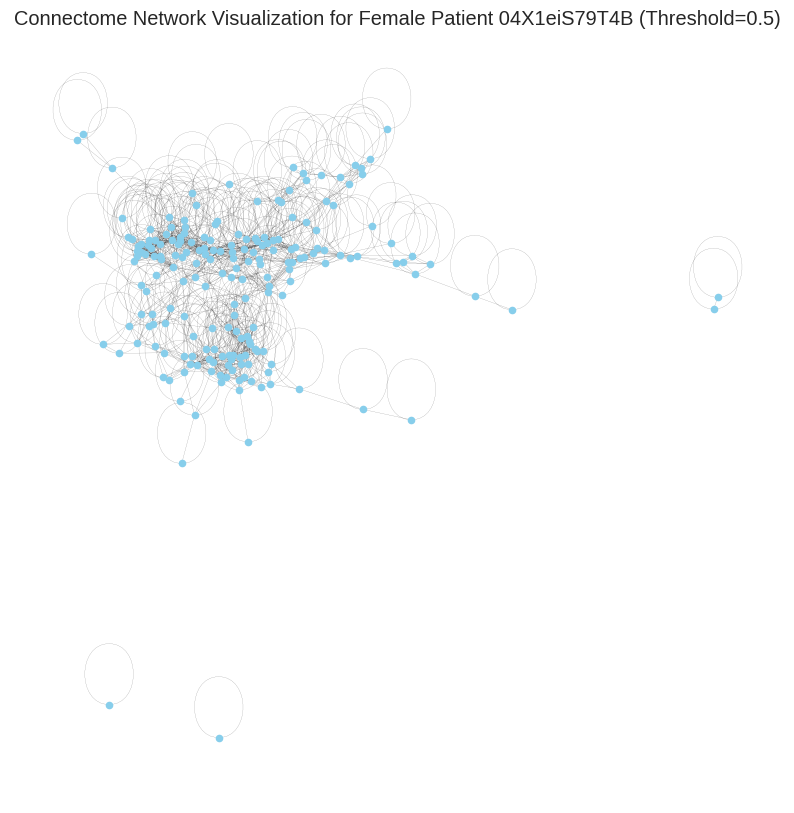

In [48]:
visualize_patient_connectome(patient_id='04X1eiS79T4B', connectome_df=train_data_functional_connectome, threshold=0.5, is_sex=False)

Average degree centrality for 05ocQutkURd6: 0.052814070351758786
Average clustering coefficient for 05ocQutkURd6: 0.4569974634013031


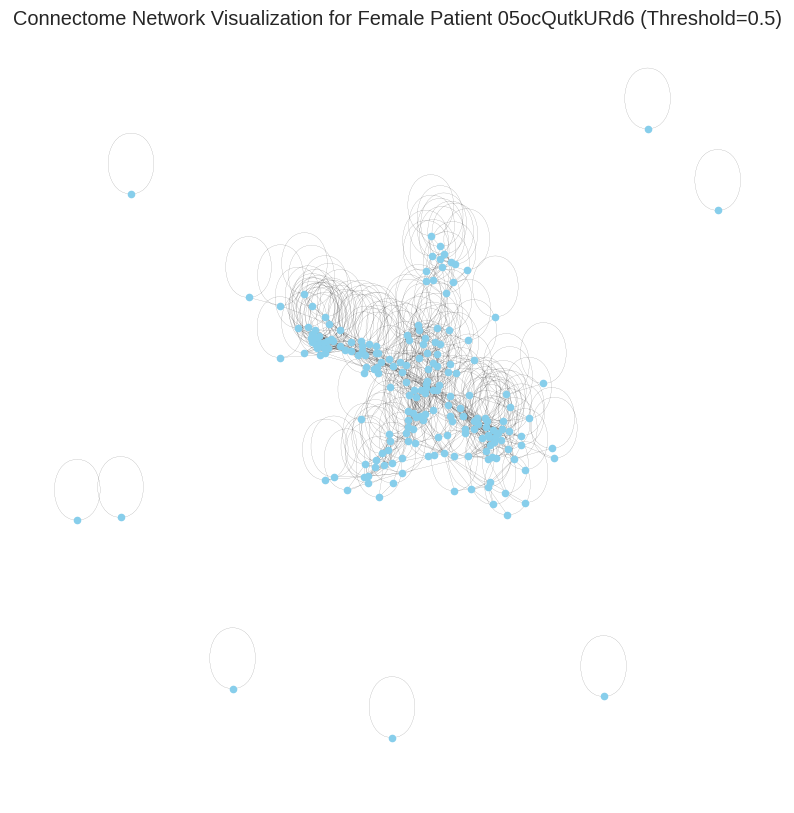

In [49]:
visualize_patient_connectome(patient_id='05ocQutkURd6', connectome_df=train_data_functional_connectome, threshold=0.5, is_sex=False)

Average degree centrality for 0Hthz5IFXhpw: 0.045879396984924624
Average clustering coefficient for 0Hthz5IFXhpw: 0.39182348984806503


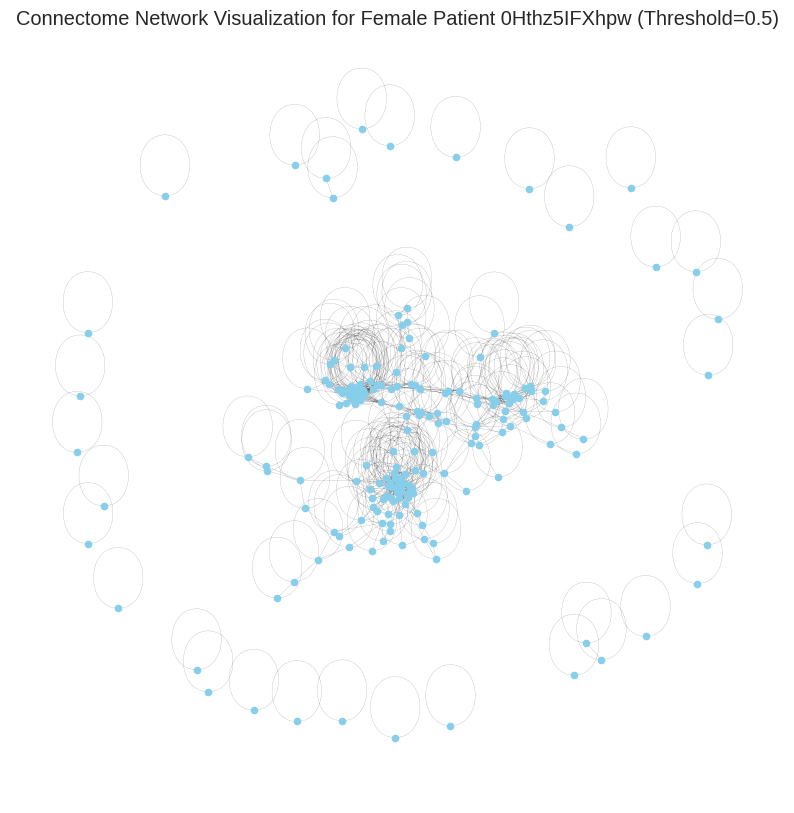

In [50]:
visualize_patient_connectome(patient_id='0Hthz5IFXhpw', connectome_df=train_data_functional_connectome, threshold=0.5, is_sex=False)

In [51]:
graph_features_df = compute_graph_features(train_data_functional_connectome, threshold=0.5, n=200)
print(graph_features_df.head())

'compute_graph_features' completed in 801.0663 seconds.

  participant_id  degree_centrality  clustering_coefficient  path_length  \
0   70z8Q2xdTXM3           0.034271                0.356862     5.113439   
1   WHWymJu6zNZi           0.031809                0.401375     6.078997   
2   4PAQp1M6EyAo           0.058844                0.493571     4.615871   
3   obEacy4Of68I           0.051558                0.477462     4.308340   
4   s7WzzDcmDOhF           0.041307                0.409811     4.794877   

   global_efficiency  betweenness  modularity  edge_density  assortativity  
0           0.195168     0.016446    0.773414      0.034271       0.527495  
1           0.147398     0.017025    0.857089      0.031809       0.519378  
2           0.275178     0.017717    0.639188      0.058844       0.638082  
3           0.257983     0.014759    0.706648      0.051558       0.513787  
4           0.210272     0.015002    0.737462      0.041307       0.403794  


Explained variance ratio (male): 0.4333603525304927


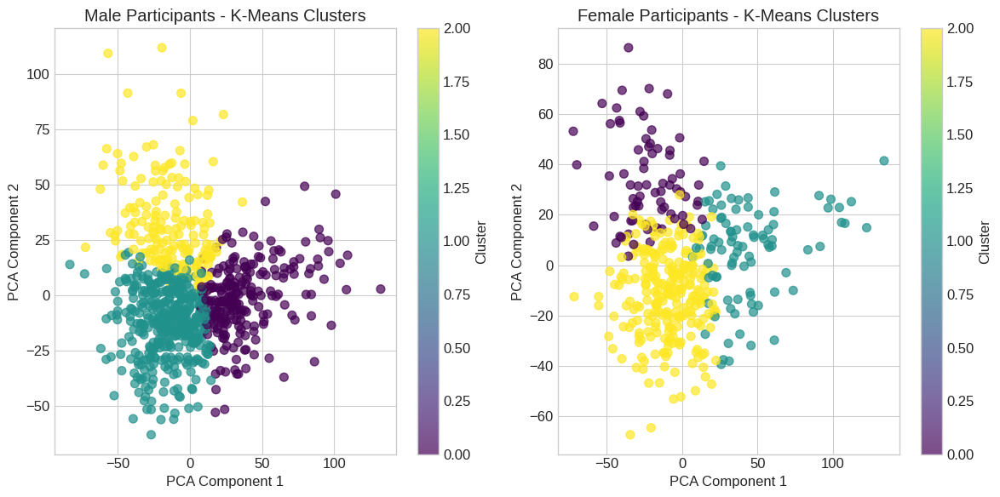

In [52]:
from sklearn.cluster import KMeans
male_df = train_full[train_full["Sex_F"] == 0]
female_df = train_full[train_full["Sex_F"] == 1]

male_ids = male_df["participant_id"].values
female_ids = female_df["participant_id"].values

male_connectome = train_data_functional_connectome.loc[male_ids]
female_connectome = train_data_functional_connectome.loc[female_ids]


scaler = StandardScaler()

male_scaled = scaler.fit_transform(male_connectome)
female_scaled = scaler.fit_transform(female_connectome)

n_components = 50
pca = PCA(n_components=n_components)

male_pca = pca.fit_transform(male_scaled)
female_pca = pca.fit_transform(female_scaled)

print("Explained variance ratio (male):", np.sum(pca.explained_variance_ratio_))

k = 3

kmeans_male = KMeans(n_clusters=k, random_state=42)
male_clusters = kmeans_male.fit_predict(male_pca)

kmeans_female = KMeans(n_clusters=k, random_state=42)
female_clusters = kmeans_female.fit_predict(female_pca)

male_df = male_df.copy()
male_df["cluster"] = male_clusters

female_df = female_df.copy()
female_df["cluster"] = female_clusters

plt.figure(figsize=(12, 6))

plt.subplot(1, 2, 1)
plt.scatter(male_pca[:, 0], male_pca[:, 1], c=male_clusters, cmap="viridis", s=50, alpha=0.7)
plt.title("Male Participants - K-Means Clusters")
plt.xlabel("PCA Component 1")
plt.ylabel("PCA Component 2")
plt.colorbar(label="Cluster")

plt.subplot(1, 2, 2)
plt.scatter(female_pca[:, 0], female_pca[:, 1], c=female_clusters, cmap="viridis", s=50, alpha=0.7)
plt.title("Female Participants - K-Means Clusters")
plt.xlabel("PCA Component 1")
plt.ylabel("PCA Component 2")
plt.colorbar(label="Cluster")

plt.tight_layout()
plt.show()

---

## For the analysis below

**1. Key Observations**

**Data Overview**

- Participants: 1,213 total (797 males, 416 females).

- Functional Connectomes: High-dimensional data (19,900 features), reduced to 50 PCA components (explaining ~36–43% variance).

**ADHD Distribution:**

- Males: Higher ADHD rates in clusters (74.6% in M0, 71.9% in M1).

- Females: Lower ADHD rates (58.0% in F0, 61.2% in F1).

**Clustering Results**

**Optimal Clusters:**

- Males: 2 clusters (silhouette score: 0.078).

- Females: 2 clusters (silhouette score: 0.072).

- Combined: 2 clusters (silhouette score: 0.082).

- Silhouette Scores: All scores are low (≤0.08), indicating weak cluster separation.

**Cluster Analysis**

- **Male Clusters:** Both clusters show high ADHD rates (>70%), suggesting limited differentiation between ADHD/non-ADHD males.

- **Female Clusters:** Lower ADHD rates (~58–61%), with slightly better differentiation than males.

- **Combined Data:** Clusters are gender-segregated (M0/M1 for males, F0/F1 for females), highlighting gender-specific connectivity patterns.

**2. Interpretation**

**Gender Differences:**

- Males exhibit higher ADHD rates overall, potentially reflecting biological differences, sampling bias (more males in the dataset), or gender-specific network characteristics.

- Females show milder ADHD associations, possibly due to smaller sample size or distinct neural mechanisms.

**Clustering Limitations:**

- Low silhouette scores suggest poor cluster separation, implying ADHD may not map cleanly to functional connectivity patterns with this approach.

- PCA’s modest variance explanation (~38%) indicates significant information loss; alternative methods (e.g., t-SNE, UMAP) or supervised models might improve results.

**3. Recommendations**

**Address Data Limitations:**

- Balance gender representation or stratify analyses further.

- Explore non-linear dimensionality reduction (UMAP) or feature engineering.

**Improve Clustering:**

- Experiment with hierarchical clustering or DBSCAN for better separation.

- Incorporate clinical metadata (age, comorbidities) into clustering.

**Shift to Supervised Learning:**

- Train classifiers (SVM, Random Forest) to predict ADHD status directly, using network metrics as features.

**4. Conclusion**

> The results suggest gender-specific patterns in functional connectivity, with males showing stronger ADHD associations. However, the clustering approach used here lacks robustness due to low silhouette scores and PCA limitations. Future work should prioritize supervised methods or enhanced feature extraction to better capture ADHD-related neural signatures.

Loading data...


[get_dataset_dir] Dataset found in /root/nilearn_data/schaefer_2018

Atlas file loaded: /root/nilearn_data/schaefer_2018/Schaefer2018_200Parcels_17Networks_order_FSLMNI152_2mm.nii.gz


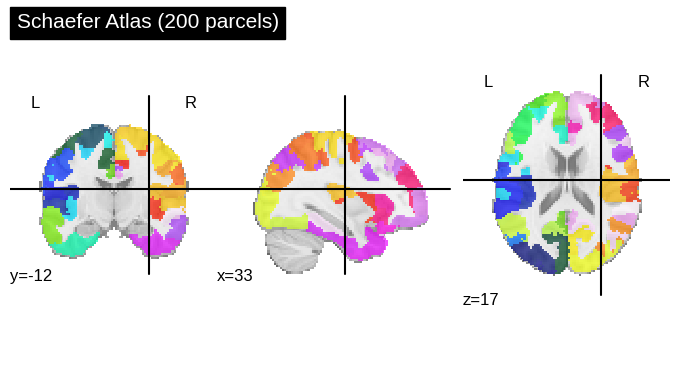

Dataset shapes:
Functional connectome: (1213, 19900)
Merged metadata with target: (1213, 30)
Male participants: 797
Female participants: 416


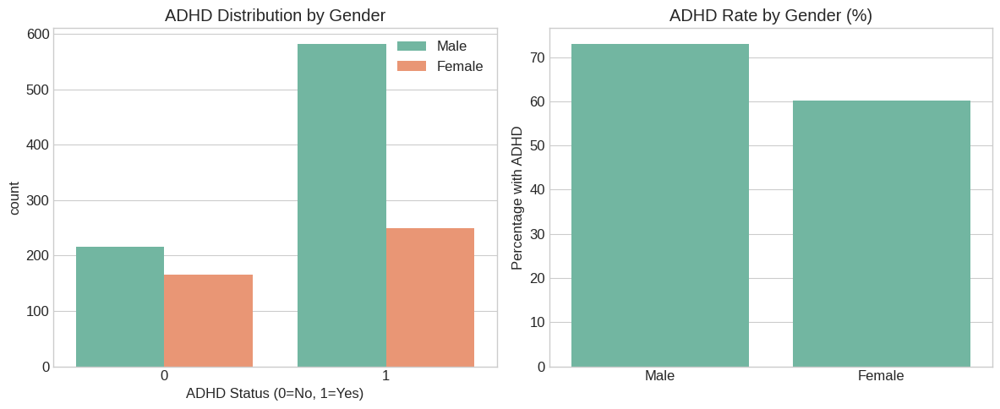

Computing network metrics...
'compute_graph_features' completed in 621.1020 seconds.

Network metrics computed for 1213 participants
Visualizing representative connectomes...


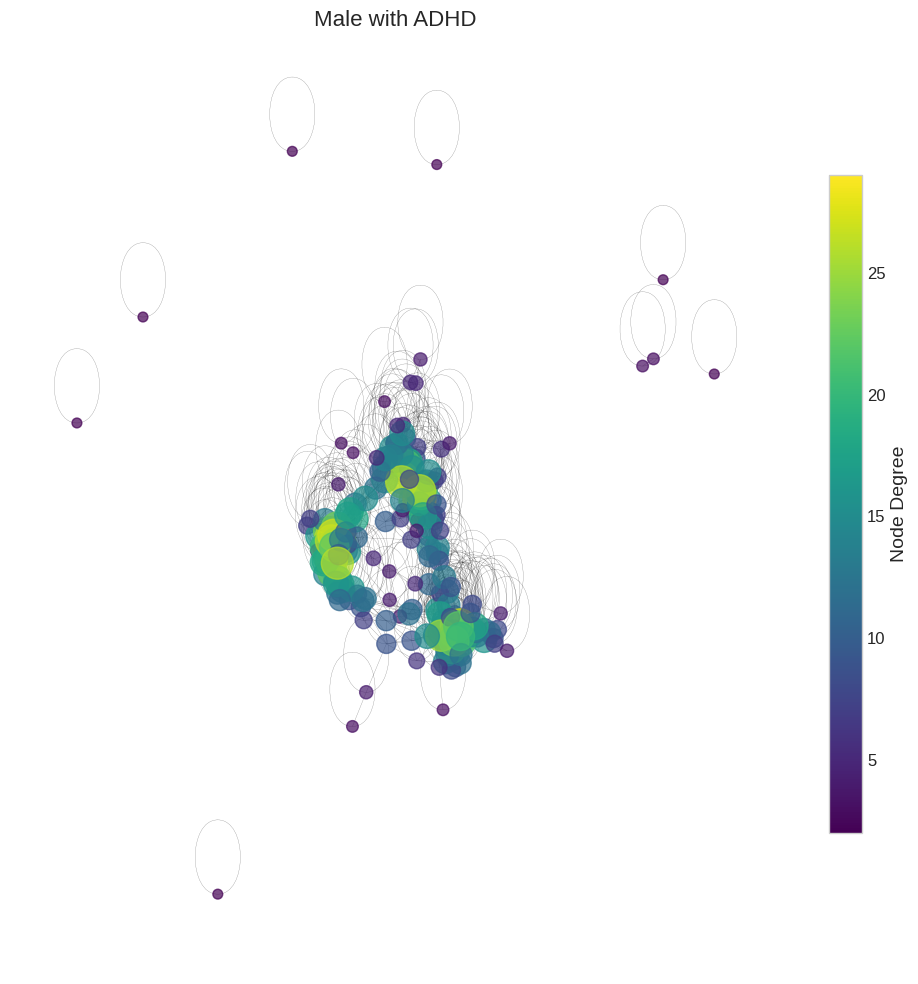

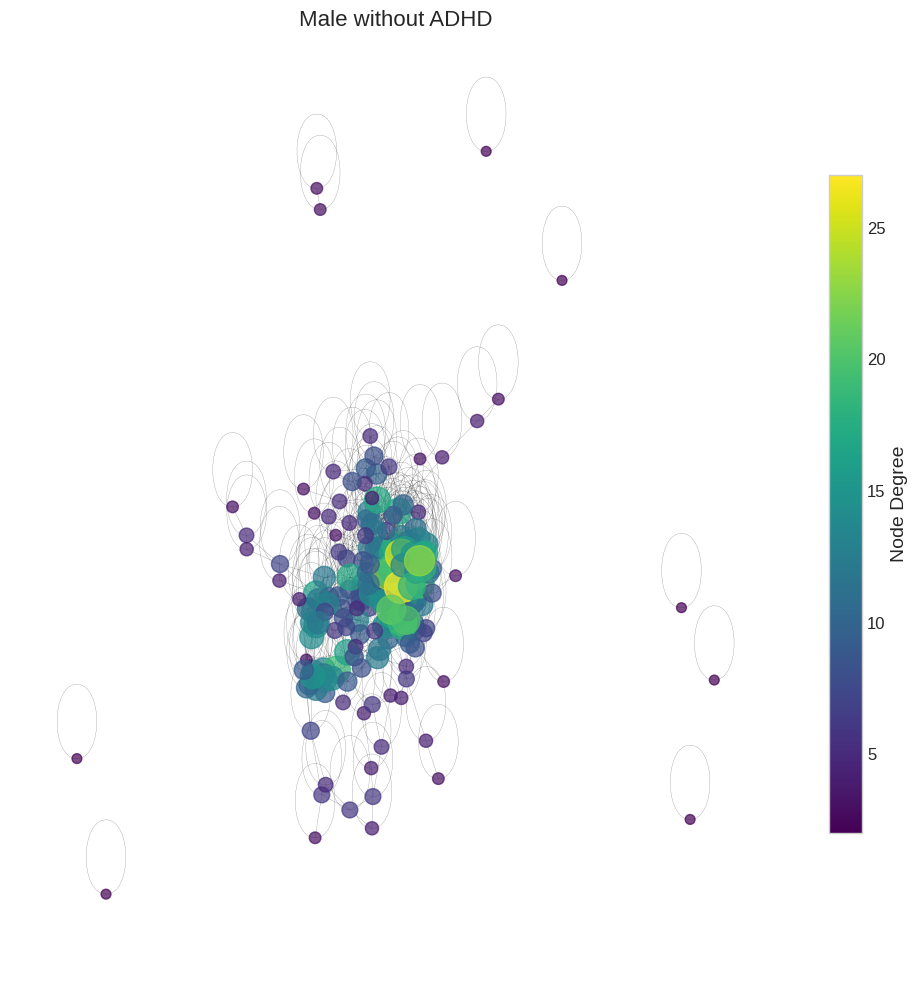

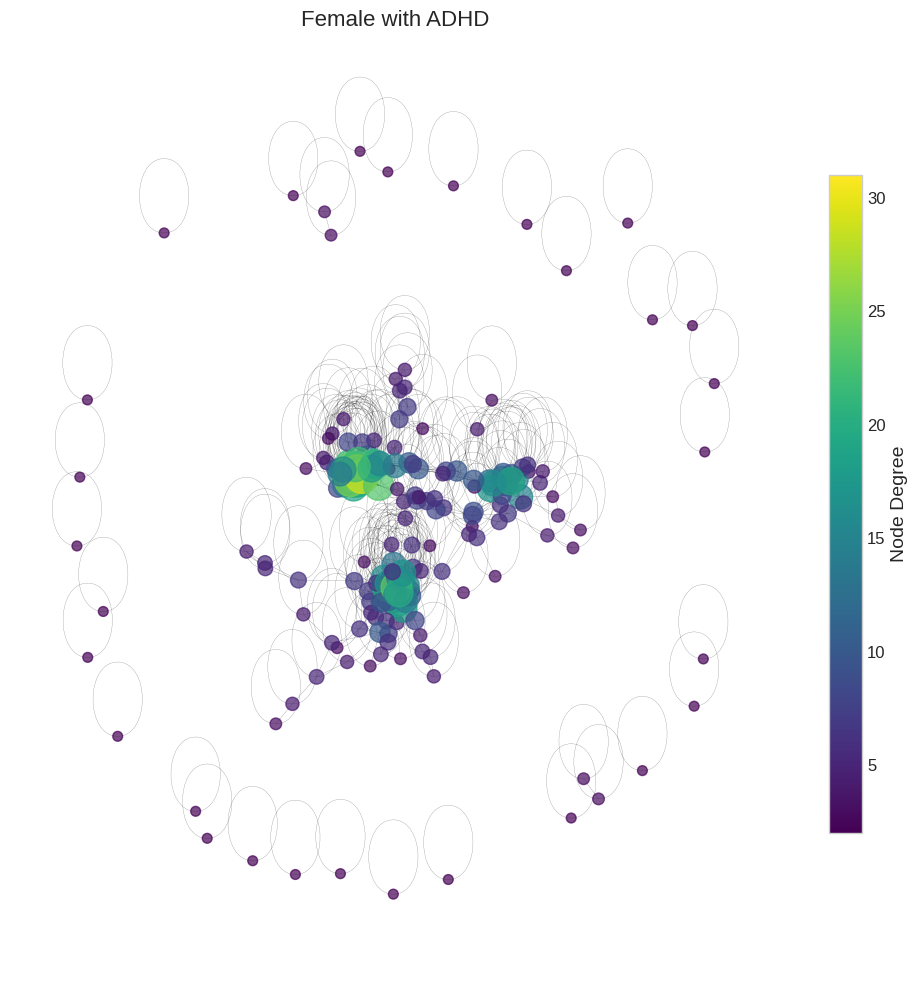

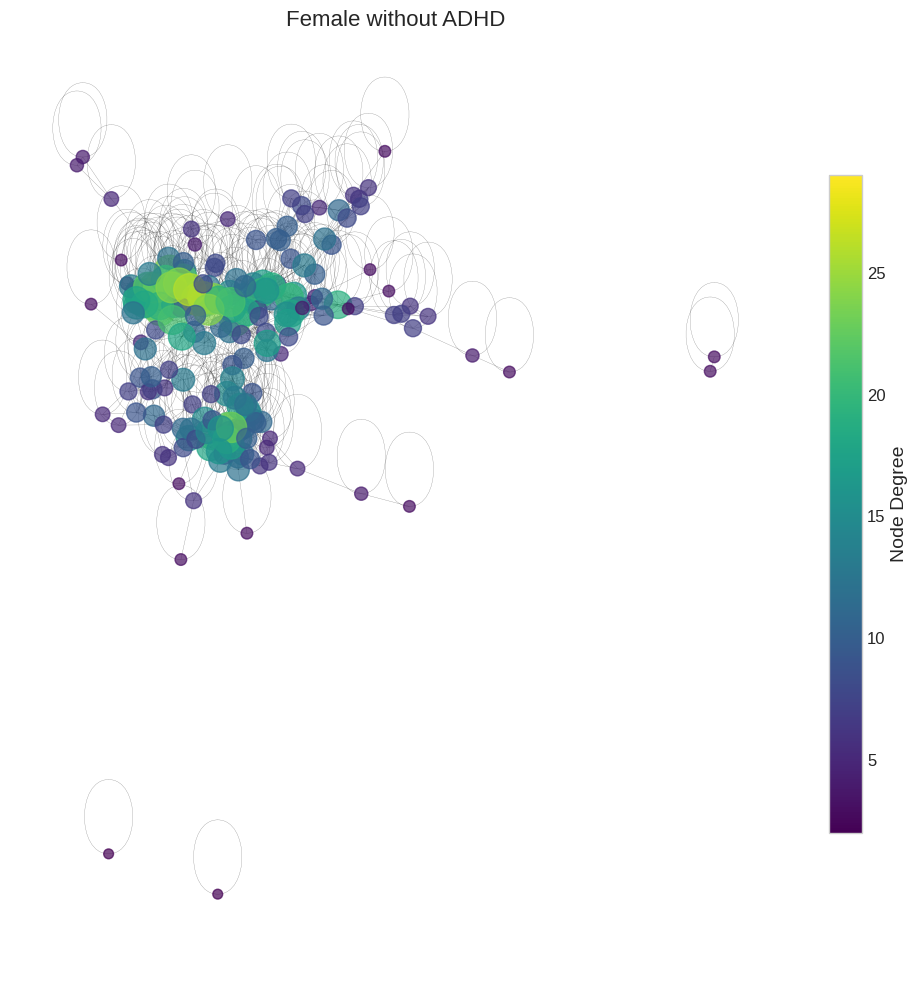

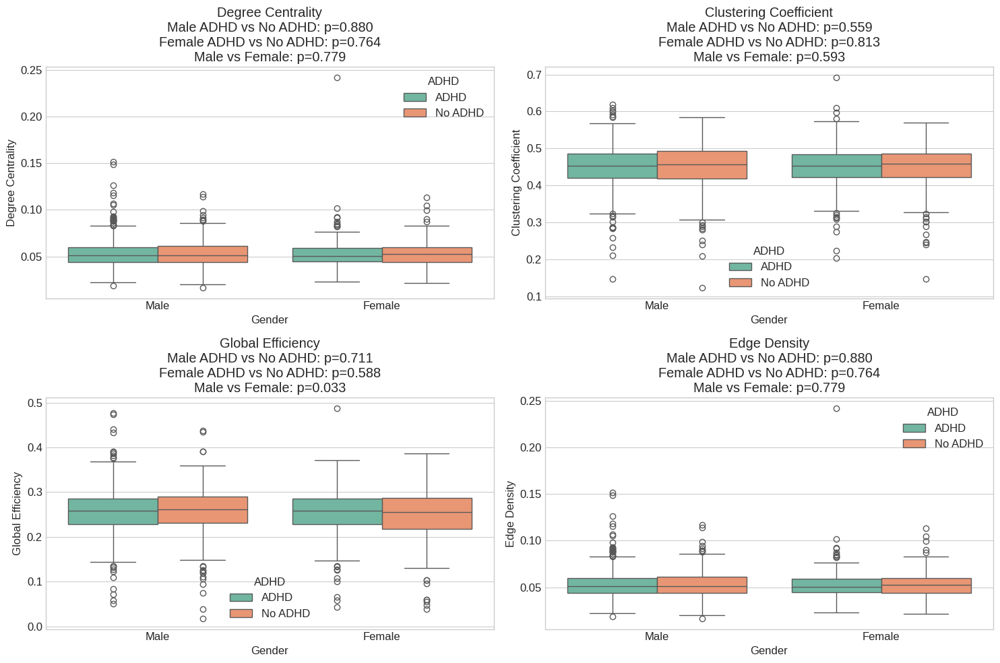

Preparing data for clustering analysis...
PCA with 50 components explains 38.81% of variance
PCA with 50 components explains 43.30% of variance
PCA with 50 components explains 37.01% of variance
Performing t-SNE dimensionality reduction...


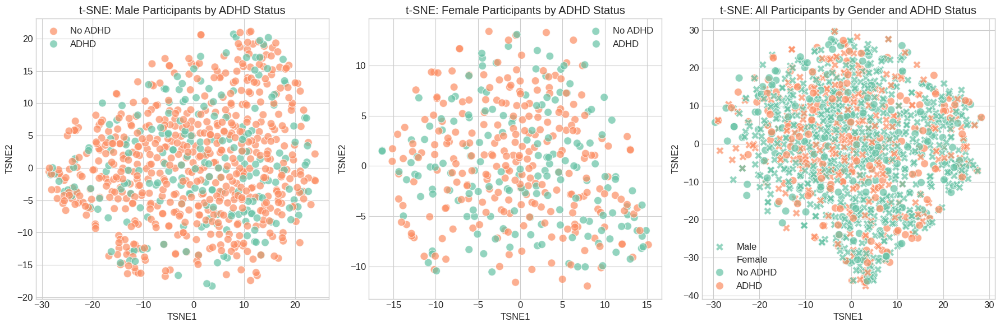

Determining optimal number of clusters...
For k=2: Inertia=5663971.26, Silhouette Score=0.078
For k=3: Inertia=5421564.12, Silhouette Score=0.062
For k=4: Inertia=5196442.18, Silhouette Score=0.056
For k=5: Inertia=5063158.01, Silhouette Score=0.051
For k=6: Inertia=4929594.85, Silhouette Score=0.052
For k=7: Inertia=4827393.91, Silhouette Score=0.042
For k=8: Inertia=4753359.58, Silhouette Score=0.040
For k=9: Inertia=4691232.06, Silhouette Score=0.042
For k=10: Inertia=4642366.55, Silhouette Score=0.035
For k=2: Inertia=3337276.32, Silhouette Score=0.070
For k=3: Inertia=3188858.62, Silhouette Score=0.065
For k=4: Inertia=3081804.03, Silhouette Score=0.045
For k=5: Inertia=2993619.04, Silhouette Score=0.038
For k=6: Inertia=2913388.52, Silhouette Score=0.040
For k=7: Inertia=2852150.94, Silhouette Score=0.033
For k=8: Inertia=2802258.51, Silhouette Score=0.038
For k=9: Inertia=2763776.34, Silhouette Score=0.033
For k=10: Inertia=2705208.99, Silhouette Score=0.030
For k=2: Inertia=820

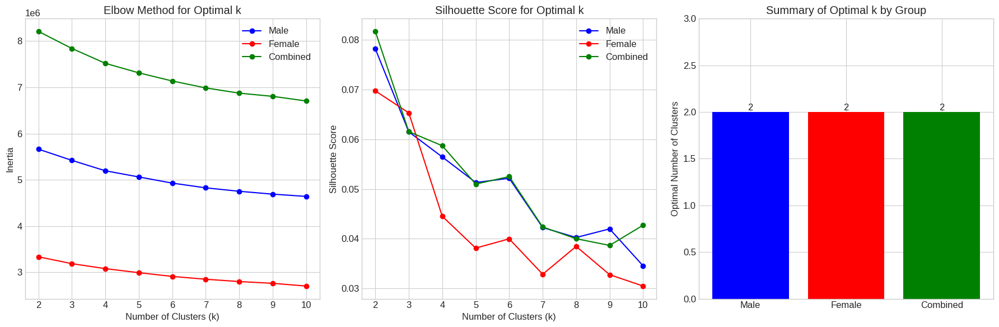

Optimal number of clusters - Male: 2, Female: 2, Combined: 2
Performing silhouette analysis for optimal clusters...
For n_clusters = 2, the average silhouette_score is : 0.078


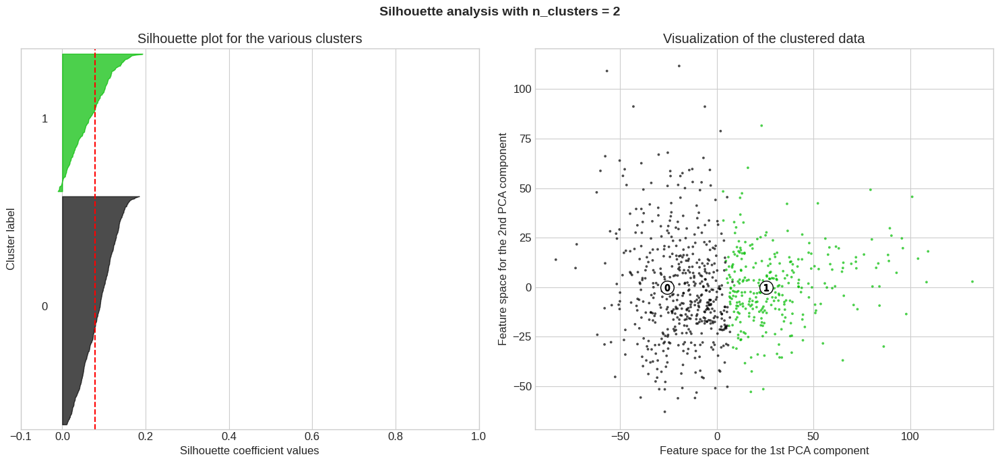

For n_clusters = 2, the average silhouette_score is : 0.070


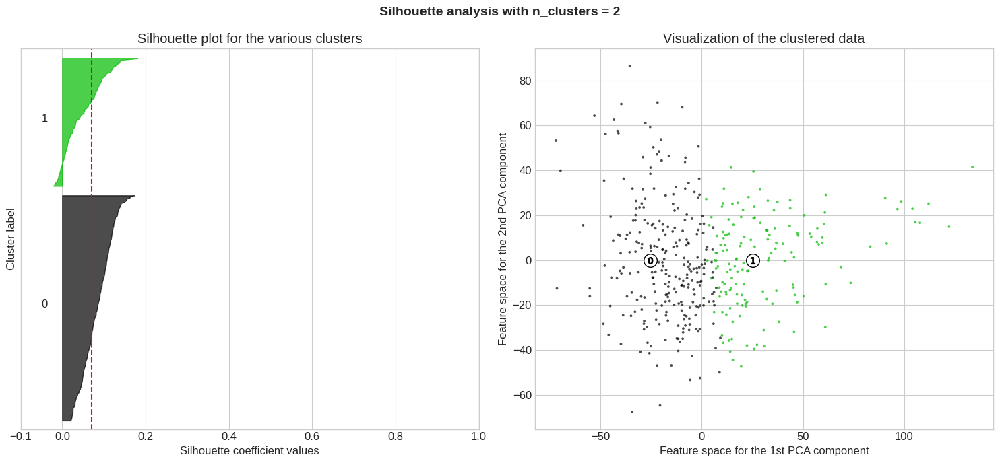

For n_clusters = 2, the average silhouette_score is : 0.082


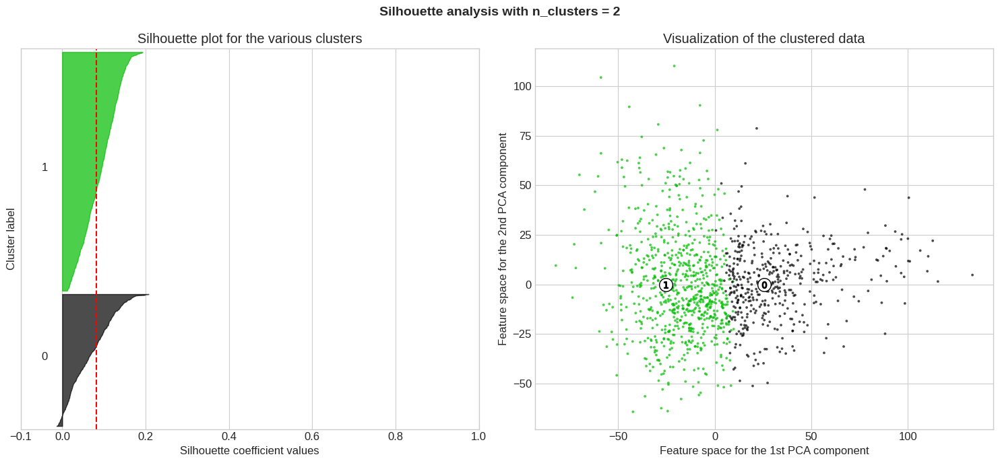

Analyzing clusters...

Cluster analysis for Combined Participants:
ADHD_Outcome  No ADHD  ADHD  Total  ADHD_Rate (%)
cluster                                          
F0                103   162    265      61.132075
F1                 63    88    151      58.278146
M0                139   358    497      72.032193
M1                 77   223    300      74.333333


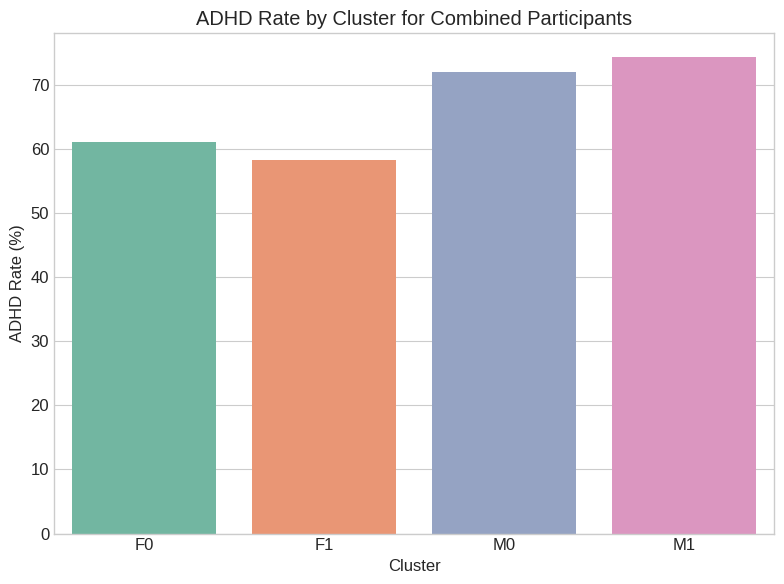

'analyze_clusters' completed in 0.2033 seconds.


Cluster analysis for Male Participants:
ADHD_Outcome  No ADHD  ADHD  Total  ADHD_Rate (%)
cluster                                          
0                 139   358    497      72.032193
1                  77   223    300      74.333333


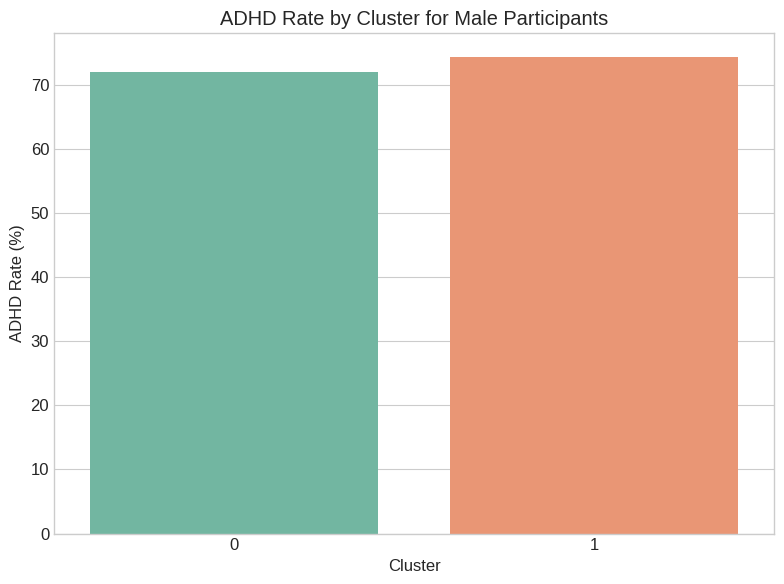

'analyze_clusters' completed in 0.1968 seconds.


Cluster analysis for Female Participants:
ADHD_Outcome  No ADHD  ADHD  Total  ADHD_Rate (%)
cluster                                          
0                 103   162    265      61.132075
1                  63    88    151      58.278146


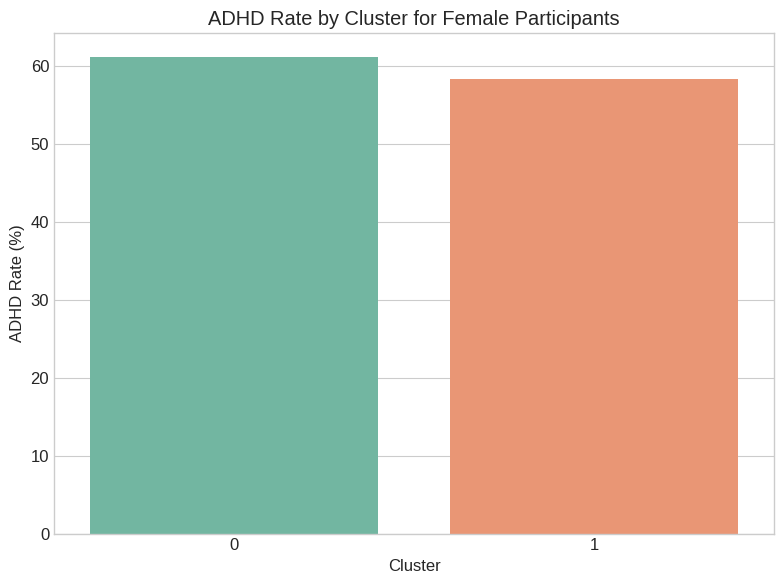

'analyze_clusters' completed in 0.2041 seconds.

CPU times: user 11min 2s, sys: 3.31 s, total: 11min 5s
Wall time: 11min 35s


In [53]:
%%time
print("Loading data...")
train_data_functional_connectome = pd.read_csv(train_func_path, index_col="participant_id")
train_data_categorical_metadata = pd.read_excel(train_cat_path)
train_data_quantitative_metadata = pd.read_excel(train_quant_path)
train_data_target_variable = pd.read_excel(train_target_path)

atlas = datasets.fetch_atlas_schaefer_2018(n_rois=200, resolution_mm=2, yeo_networks=17)
atlas_file = atlas.maps
print(f"Atlas file loaded: {atlas_file}")

plotting.plot_roi(atlas_file, title="Schaefer Atlas (200 parcels)")
plt.show()

train_metadata = train_data_categorical_metadata.merge(train_data_quantitative_metadata, on="participant_id", how="left")
train_full = train_metadata.merge(train_data_target_variable, on="participant_id", how="left")

print("Dataset shapes:")
print(f"Functional connectome: {train_data_functional_connectome.shape}")
print(f"Merged metadata with target: {train_full.shape}")

male_df = train_full[train_full["Sex_F"] == 0]
female_df = train_full[train_full["Sex_F"] == 1]
male_ids = male_df["participant_id"].values
female_ids = female_df["participant_id"].values

male_connectome = train_data_functional_connectome.loc[male_ids]
female_connectome = train_data_functional_connectome.loc[female_ids]

print(f"Male participants: {len(male_df)}")
print(f"Female participants: {len(female_df)}")

plt.figure(figsize=(12, 5))

plt.subplot(1, 2, 1)
sns.countplot(x='ADHD_Outcome', data=train_full, hue='Sex_F')
plt.title('ADHD Distribution by Gender')
plt.xlabel('ADHD Status (0=No, 1=Yes)')
plt.legend(['Male', 'Female'])

plt.subplot(1, 2, 2)
male_adhd_rate = male_df['ADHD_Outcome'].mean() * 100
female_adhd_rate = female_df['ADHD_Outcome'].mean() * 100
sns.barplot(x=['Male', 'Female'], y=[male_adhd_rate, female_adhd_rate])
plt.title('ADHD Rate by Gender (%)')
plt.ylabel('Percentage with ADHD')

plt.tight_layout()
plt.show()

print("Computing network metrics...")
network_metrics_df = compute_graph_features(train_data_functional_connectome, threshold=0.5)
print(f"Network metrics computed for {len(network_metrics_df)} participants")

network_with_metadata = network_metrics_df.merge(train_full, on="participant_id", how="inner")

def visualize_connectome(patient_id, connectome_df, threshold=0.5, n=200, title=None):
    """Visualize the brain connectome as a network graph"""
    if patient_id not in connectome_df.index:
        print(f"Patient ID {patient_id} not found.")
        return

    flat_data = connectome_df.loc[patient_id].values

    matrix = np.zeros((n, n))
    upper_tri_indices = np.triu_indices(n, k=1)
    matrix[upper_tri_indices] = flat_data
    matrix = matrix + matrix.T
    np.fill_diagonal(matrix, 1)

    thresholded_matrix = matrix.copy()
    thresholded_matrix[thresholded_matrix < threshold] = 0

    G = nx.from_numpy_array(thresholded_matrix)

    fig, ax = plt.subplots(figsize=(10, 10))
    pos = nx.spring_layout(G, seed=42)

    degrees = dict(G.degree())
    node_sizes = [v * 20 + 10 for v in degrees.values()]

    nodes = nx.draw_networkx_nodes(G, pos, node_size=node_sizes, alpha=0.7,
                                   node_color=list(degrees.values()),
                                   cmap=plt.cm.viridis, ax=ax)
    nx.draw_networkx_edges(G, pos, width=0.2, alpha=0.5, ax=ax)

    if title:
        ax.set_title(title, fontsize=16)
    else:
        ax.set_title(f"Connectome Network for Patient {patient_id}", fontsize=16)
    ax.axis("off")

    # Add a colorbar for node degrees
    sm = plt.cm.ScalarMappable(cmap=plt.cm.viridis,
                               norm=plt.Normalize(vmin=min(degrees.values()), vmax=max(degrees.values())))
    sm.set_array([])
    cbar = plt.colorbar(sm, ax=ax, shrink=0.7)
    cbar.set_label('Node Degree', fontsize=14)

    plt.tight_layout()
    return G


# Visualize connectomes for representative subjects from each gender group
# Sample one ADHD and one non-ADHD subject from each gender
male_adhd = male_df[male_df['ADHD_Outcome'] == 1].iloc[0]['participant_id']
male_no_adhd = male_df[male_df['ADHD_Outcome'] == 0].iloc[0]['participant_id']
female_adhd = female_df[female_df['ADHD_Outcome'] == 1].iloc[0]['participant_id']
female_no_adhd = female_df[female_df['ADHD_Outcome'] == 0].iloc[0]['participant_id']

print("Visualizing representative connectomes...")
G1 = visualize_connectome(male_adhd, train_data_functional_connectome, title="Male with ADHD")
plt.show()

G2 = visualize_connectome(male_no_adhd, train_data_functional_connectome, title="Male without ADHD")
plt.show()

G3 = visualize_connectome(female_adhd, train_data_functional_connectome, title="Female with ADHD")
plt.show()

G4 = visualize_connectome(female_no_adhd, train_data_functional_connectome, title="Female without ADHD")
plt.show()
plt.figure(figsize=(15, 10))

# The metrics to compare
metrics = ['degree_centrality', 'clustering_coefficient', 'global_efficiency', 'edge_density']
titles = ['Degree Centrality', 'Clustering Coefficient', 'Global Efficiency', 'Edge Density']

for i, (metric, title) in enumerate(zip(metrics, titles)):
    plt.subplot(2, 2, i+1)
    plot_df = pd.DataFrame({
        'Value': network_with_metadata[metric],
        'ADHD': network_with_metadata['ADHD_Outcome'].map({0: 'No ADHD', 1: 'ADHD'}),
        'Gender': network_with_metadata['Sex_F'].map({0: 'Male', 1: 'Female'})
    })

    sns.boxplot(x='Gender', y='Value', hue='ADHD', data=plot_df)

    # Run statistical tests
    male_adhd_values = plot_df[(plot_df['Gender'] == 'Male') & (plot_df['ADHD'] == 'ADHD')]['Value']
    male_no_adhd_values = plot_df[(plot_df['Gender'] == 'Male') & (plot_df['ADHD'] == 'No ADHD')]['Value']
    female_adhd_values = plot_df[(plot_df['Gender'] == 'Female') & (plot_df['ADHD'] == 'ADHD')]['Value']
    female_no_adhd_values = plot_df[(plot_df['Gender'] == 'Female') & (plot_df['ADHD'] == 'No ADHD')]['Value']

    # T-tests
    male_test = stats.ttest_ind(male_adhd_values, male_no_adhd_values, nan_policy='omit')
    female_test = stats.ttest_ind(female_adhd_values, female_no_adhd_values, nan_policy='omit')
    gender_test = stats.ttest_ind(
        pd.concat([male_adhd_values, male_no_adhd_values]),
        pd.concat([female_adhd_values, female_no_adhd_values]),
        nan_policy='omit'
    )

    plt.title(f"{title}\nMale ADHD vs No ADHD: p={male_test.pvalue:.3f}\nFemale ADHD vs No ADHD: p={female_test.pvalue:.3f}\nMale vs Female: p={gender_test.pvalue:.3f}")
    plt.ylabel(title)

plt.tight_layout()
plt.show()

print("Preparing data for clustering analysis...")

def prepare_for_clustering(connectome_df, n_components_pca=50):
    scaler = StandardScaler()
    scaled_data = scaler.fit_transform(connectome_df)
    pca = PCA(n_components=n_components_pca)
    pca_result = pca.fit_transform(scaled_data)

    explained_var = np.sum(pca.explained_variance_ratio_)
    print(f"PCA with {n_components_pca} components explains {explained_var:.2%} of variance")

    return scaled_data, pca_result, pca

male_scaled, male_pca, male_pca_model = prepare_for_clustering(male_connectome)
female_scaled, female_pca, female_pca_model = prepare_for_clustering(female_connectome)

combined_scaled, combined_pca, combined_pca_model = prepare_for_clustering(train_data_functional_connectome)

print("Performing t-SNE dimensionality reduction...")

def apply_tsne(data, perplexity=30, n_components=2):
    tsne = TSNE(n_components=n_components, perplexity=perplexity,
                n_iter=1000, random_state=42)
    return tsne.fit_transform(data)

male_tsne = apply_tsne(male_pca)
female_tsne = apply_tsne(female_pca)
combined_tsne = apply_tsne(combined_pca)

male_tsne_df = pd.DataFrame(male_tsne, columns=['TSNE1', 'TSNE2'])
male_tsne_df['participant_id'] = male_ids
male_tsne_df = male_tsne_df.merge(male_df[['participant_id', 'ADHD_Outcome']], on='participant_id')

female_tsne_df = pd.DataFrame(female_tsne, columns=['TSNE1', 'TSNE2'])
female_tsne_df['participant_id'] = female_ids
female_tsne_df = female_tsne_df.merge(female_df[['participant_id', 'ADHD_Outcome']], on='participant_id')

combined_tsne_df = pd.DataFrame(combined_tsne, columns=['TSNE1', 'TSNE2'])
combined_tsne_df['participant_id'] = train_data_functional_connectome.index
combined_tsne_df = combined_tsne_df.merge(train_full[['participant_id', 'ADHD_Outcome', 'Sex_F']], on='participant_id')

plt.figure(figsize=(18, 6))

plt.subplot(1, 3, 1)
sns.scatterplot(x='TSNE1', y='TSNE2', hue='ADHD_Outcome', data=male_tsne_df, s=100, alpha=0.7)
plt.title('t-SNE: Male Participants by ADHD Status')
plt.legend(['No ADHD', 'ADHD'])

plt.subplot(1, 3, 2)
sns.scatterplot(x='TSNE1', y='TSNE2', hue='ADHD_Outcome', data=female_tsne_df, s=100, alpha=0.7)
plt.title('t-SNE: Female Participants by ADHD Status')
plt.legend(['No ADHD', 'ADHD'])

plt.subplot(1, 3, 3)
sns.scatterplot(x='TSNE1', y='TSNE2', hue='Sex_F', style='ADHD_Outcome', data=combined_tsne_df, s=100, alpha=0.7)
plt.title('t-SNE: All Participants by Gender and ADHD Status')
plt.legend(['Male', 'Female', 'No ADHD', 'ADHD'])

plt.tight_layout()
plt.show()

print("Determining optimal number of clusters...")

def find_optimal_clusters(data, max_k=10):
    """Find optimal number of clusters using both elbow method and silhouette score"""
    inertia_values = []
    silhouette_scores = []
    k_values = range(2, max_k + 1)

    for k in k_values:
        kmeans = KMeans(n_clusters=k, random_state=42, n_init=10)
        cluster_labels = kmeans.fit_predict(data)

        inertia_values.append(kmeans.inertia_)

        silhouette_avg = silhouette_score(data, cluster_labels)
        silhouette_scores.append(silhouette_avg)

        print(f"For k={k}: Inertia={kmeans.inertia_:.2f}, Silhouette Score={silhouette_avg:.3f}")

    return k_values, inertia_values, silhouette_scores

k_range, male_inertia, male_silhouette = find_optimal_clusters(male_pca)
_, female_inertia, female_silhouette = find_optimal_clusters(female_pca)
_, combined_inertia, combined_silhouette = find_optimal_clusters(combined_pca)

plt.figure(figsize=(18, 6))

plt.subplot(1, 3, 1)
plt.plot(k_range, male_inertia, 'o-', color='blue', label='Male')
plt.plot(k_range, female_inertia, 'o-', color='red', label='Female')
plt.plot(k_range, combined_inertia, 'o-', color='green', label='Combined')
plt.xlabel('Number of Clusters (k)')
plt.ylabel('Inertia')
plt.title('Elbow Method for Optimal k')
plt.legend()
plt.grid(True)

plt.subplot(1, 3, 2)
plt.plot(k_range, male_silhouette, 'o-', color='blue', label='Male')
plt.plot(k_range, female_silhouette, 'o-', color='red', label='Female')
plt.plot(k_range, combined_silhouette, 'o-', color='green', label='Combined')
plt.xlabel('Number of Clusters (k)')
plt.ylabel('Silhouette Score')
plt.title('Silhouette Score for Optimal k')
plt.legend()
plt.grid(True)

optimal_k_male = k_range[np.argmax(male_silhouette)]
optimal_k_female = k_range[np.argmax(female_silhouette)]
optimal_k_combined = k_range[np.argmax(combined_silhouette)]

plt.subplot(1, 3, 3)
labels = ['Male', 'Female', 'Combined']
optimal_k_values = [optimal_k_male, optimal_k_female, optimal_k_combined]
bars = plt.bar(labels, optimal_k_values, color=['blue', 'red', 'green'])
plt.ylabel('Optimal Number of Clusters')
plt.title('Summary of Optimal k by Group')
plt.ylim(0, max(optimal_k_values) + 1)

for bar in bars:
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2., height,
             f'{int(height)}',
             ha='center', va='bottom')

plt.tight_layout()
plt.show()

print(f"Optimal number of clusters - Male: {optimal_k_male}, Female: {optimal_k_female}, Combined: {optimal_k_combined}")

# Silhouette plot for the optimal k
def plot_silhouette_analysis(data, n_clusters):
    """Create silhouette plot for a given clustering"""
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 7))

    ax1.set_xlim([-0.1, 1])
    ax1.set_ylim([0, len(data) + (n_clusters + 1) * 10])

    clusterer = KMeans(n_clusters=n_clusters, random_state=42, n_init=10)
    cluster_labels = clusterer.fit_predict(data)

    silhouette_avg = silhouette_score(data, cluster_labels)
    print(f"For n_clusters = {n_clusters}, the average silhouette_score is : {silhouette_avg:.3f}")

    sample_silhouette_values = silhouette_samples(data, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == i]
        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = plt.cm.nipy_spectral(float(i) / n_clusters)
        ax1.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        y_lower = y_upper + 10

    ax1.set_title("Silhouette plot for the various clusters")
    ax1.set_xlabel("Silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

    colors = plt.cm.nipy_spectral(cluster_labels.astype(float) / n_clusters)

    if data.shape[1] > 2:
        reduced_data = PCA(n_components=2).fit_transform(data)
        ax2.scatter(reduced_data[:, 0], reduced_data[:, 1], marker='.', s=30, lw=0, alpha=0.7,
                    c=colors, edgecolor='k')
    else:
        ax2.scatter(data[:, 0], data[:, 1], marker='.', s=30, lw=0, alpha=0.7,
                    c=colors, edgecolor='k')

    # Label cluster centers
    centers = clusterer.cluster_centers_
    if data.shape[1] > 2:
        centers_2d = PCA(n_components=2).fit_transform(centers)
        ax2.scatter(centers_2d[:, 0], centers_2d[:, 1], marker='o',
                    c="white", alpha=1, s=200, edgecolor='k')
        for i, c in enumerate(centers_2d):
            ax2.scatter(c[0], c[1], marker='$%d$' % i, alpha=1,
                        s=50, edgecolor='k')
    else:
        ax2.scatter(centers[:, 0], centers[:, 1], marker='o',
                    c="white", alpha=1, s=200, edgecolor='k')
        for i, c in enumerate(centers):
            ax2.scatter(c[0], c[1], marker='$%d$' % i, alpha=1,
                        s=50, edgecolor='k')

    ax2.set_title("Visualization of the clustered data")
    ax2.set_xlabel("Feature space for the 1st PCA component")
    ax2.set_ylabel("Feature space for the 2nd PCA component")

    plt.suptitle(f"Silhouette analysis with n_clusters = {n_clusters}",
                 fontsize=14, fontweight='bold')

    plt.tight_layout()
    plt.show()

    return cluster_labels

print("Performing silhouette analysis for optimal clusters...")
male_labels = plot_silhouette_analysis(male_pca, optimal_k_male)
female_labels = plot_silhouette_analysis(female_pca, optimal_k_female)
combined_labels = plot_silhouette_analysis(combined_pca, optimal_k_combined)

male_df = male_df.copy()
male_df['cluster'] = male_labels

female_df = female_df.copy()
female_df['cluster'] = female_labels

combined_df = train_full.copy()
combined_df_with_clusters = combined_df.copy()
combined_df_with_clusters['cluster'] = np.nan

for i, pid in enumerate(male_ids):
    idx = combined_df_with_clusters[combined_df_with_clusters['participant_id'] == pid].index
    combined_df_with_clusters.loc[idx, 'cluster'] = f"M{male_labels[i]}"

for i, pid in enumerate(female_ids):
    idx = combined_df_with_clusters[combined_df_with_clusters['participant_id'] == pid].index
    combined_df_with_clusters.loc[idx, 'cluster'] = f"F{female_labels[i]}"

print("Analyzing clusters...")

@log_and_time
def analyze_clusters(df, group_name=""):
    """Analyze the distribution of ADHD within each cluster"""

    # Count ADHD cases by cluster (using 0 as 'No ADHD' and 1 as 'ADHD')
    cluster_adhd = df.groupby('cluster')['ADHD_Outcome'].value_counts().unstack().fillna(0)

    if 0 in cluster_adhd.columns and 1 in cluster_adhd.columns:
        cluster_adhd = cluster_adhd.rename(columns={0: 'No ADHD', 1: 'ADHD'})
    else:
        cluster_adhd.columns = ['No ADHD', 'ADHD']

    cluster_adhd['Total'] = cluster_adhd['No ADHD'] + cluster_adhd['ADHD']
    cluster_adhd['ADHD_Rate (%)'] = (cluster_adhd['ADHD'] / cluster_adhd['Total']) * 100

    print(f"\nCluster analysis for {group_name}:")
    print(cluster_adhd)

    plt.figure(figsize=(8, 6))
    sns.barplot(x=cluster_adhd.index, y='ADHD_Rate (%)', data=cluster_adhd.reset_index(), palette="Set2")
    plt.title(f"ADHD Rate by Cluster for {group_name}")
    plt.xlabel("Cluster")
    plt.ylabel("ADHD Rate (%)")
    plt.tight_layout()
    plt.show()

analyze_clusters(combined_df_with_clusters, group_name="Combined Participants")

analyze_clusters(male_df, group_name="Male Participants")
analyze_clusters(female_df, group_name="Female Participants")


## Updated Analysis


Loading data...
PCA retains 37.01% variance.
'preprocess_and_pca' completed in 5.0026 seconds.

k=2: silhouette=0.082
k=3: silhouette=0.061
k=4: silhouette=0.059
k=5: silhouette=0.051
k=6: silhouette=0.052
k=7: silhouette=0.043
k=8: silhouette=0.044
k=9: silhouette=0.041
k=10: silhouette=0.033
Optimal k=2 (silhouette=0.082)
'find_optimal_k' completed in 1.1657 seconds.

'bagged_consensus_clusters' completed in 118.4794 seconds.

         No ADHD  ADHD  Total  ADHD_Rate (%)
cluster                                     
0            146   322    468      68.803419
1            236   509    745      68.322148


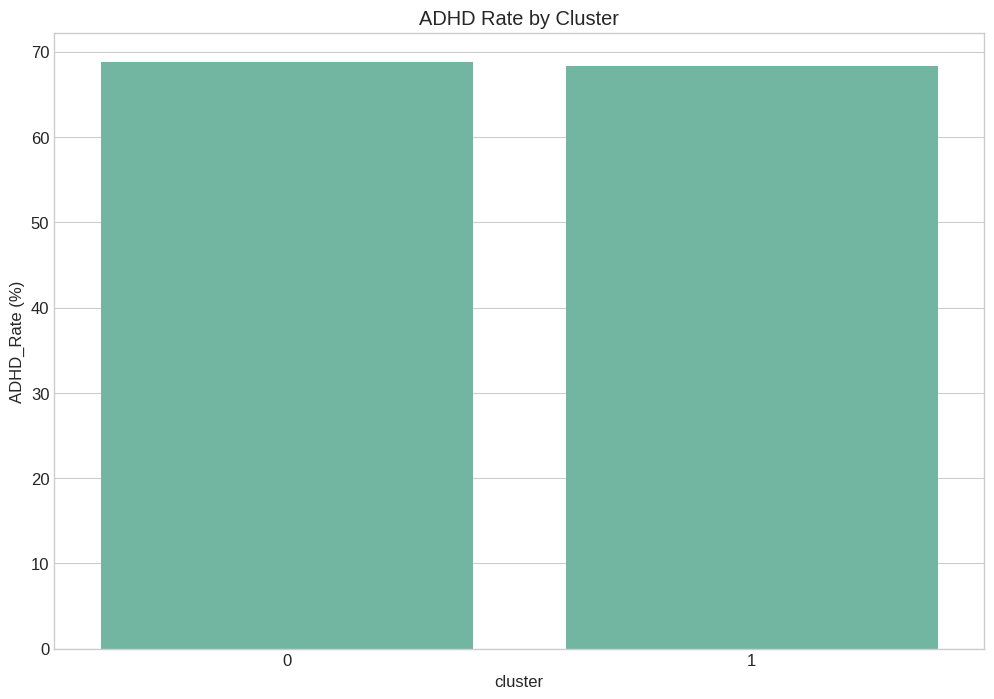

'analyze_clusters' completed in 0.2360 seconds.



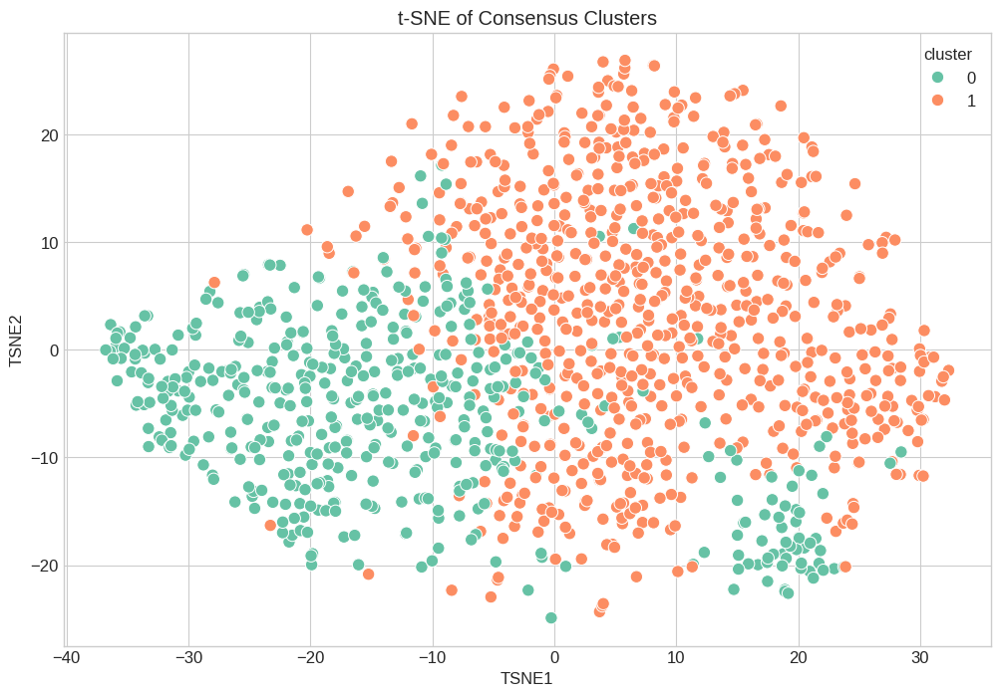

'plot_tsne' completed in 12.7245 seconds.



In [54]:
print("Loading data...")

func_df = pd.read_csv(func_path, index_col="participant_id")
cat_df = pd.read_excel(cat_path)
quant_df = pd.read_excel(quant_path)
target_df = pd.read_excel(target_path)

meta = cat_df.merge(quant_df, on="participant_id", how="left")
full = meta.merge(target_df, on="participant_id", how="left")

features_df = full.drop(columns=["ADHD_Outcome", "Sex_F"])

ids = func_df.index.values
X = func_df.values

@log_and_time
def bagged_consensus_clusters(X, n_clusters, B=50, sample_frac=0.8):
    N = X.shape[0]
    coassoc = np.zeros((N, N))
    counts = np.zeros((N, N))
    for b in range(B):
        idx = resample(np.arange(N), replace=True, n_samples=int(sample_frac*N), random_state=b)
        labels_b = KMeans(n_clusters=n_clusters, random_state=b, n_init=10).fit_predict(X[idx])
        for i_loc, i in enumerate(idx):
            for j_loc, j in enumerate(idx):
                counts[i, j] += 1
                if labels_b[i_loc] == labels_b[j_loc]:
                    coassoc[i, j] += 1
    with np.errstate(divide='ignore', invalid='ignore'):
        M = np.divide(coassoc, counts, out=np.zeros_like(coassoc), where=counts>0)
    consensus = AgglomerativeClustering(n_clusters=n_clusters)
    labels = consensus.fit_predict(1 - M)
    return labels, M

@log_and_time
def preprocess_and_pca(X, n_components=50):
    scaler = StandardScaler()
    X_scaled = scaler.fit_transform(X)
    pca = PCA(n_components=n_components, random_state=42)
    X_pca = pca.fit_transform(X_scaled)
    print(f"PCA retains {pca.explained_variance_ratio_.sum():.2%} variance.")
    return X_scaled, X_pca

@log_and_time
def plot_tsne(data, labels, perplexity=30):
    tsne = TSNE(n_components=2, perplexity=perplexity, n_iter=1000, random_state=42)
    rez = tsne.fit_transform(data)
    df = pd.DataFrame(rez, columns=['TSNE1','TSNE2'])
    df['cluster'] = labels
    sns.scatterplot(x='TSNE1', y='TSNE2', hue='cluster', data=df, palette="Set2", s=80)
    plt.title('t-SNE of Consensus Clusters')
    plt.show()

@log_and_time
def analyze_clusters(df):
    summary = df.groupby('cluster')['ADHD_Outcome'].value_counts().unstack(fill_value=0)
    summary.columns = ['No ADHD', 'ADHD']
    summary['Total'] = summary.sum(axis=1)
    summary['ADHD_Rate (%)'] = summary['ADHD']/summary['Total']*100
    print(summary)
    sns.barplot(x=summary.index, y='ADHD_Rate (%)', data=summary.reset_index())
    plt.title('ADHD Rate by Cluster')
    plt.show()
    return summary

@log_and_time
def find_optimal_k(data, max_k=10):
    best_k, best_score = 2, -1
    for k in range(2, max_k+1):
        labels = KMeans(n_clusters=k, random_state=42, n_init=10).fit_predict(data)
        score = silhouette_score(data, labels)
        print(f"k={k}: silhouette={score:.3f}")
        if score > best_score:
            best_k, best_score = k, score
    print(f"Optimal k={best_k} (silhouette={best_score:.3f})")
    return best_k

scaled, pca_data = preprocess_and_pca(X)

optimal_k = find_optimal_k(pca_data, max_k=10)

# Consensus clustering
labels_consensus, coassoc_matrix = bagged_consensus_clusters(pca_data, n_clusters=optimal_k, B=100)
full_results = full.copy()
full_results['cluster'] = labels_consensus

cluster_summary = analyze_clusters(full_results)



plot_tsne(pca_data, labels_consensus)

In [55]:
def load_and_merge(func_path, cat_path, quant_path, target_path):
    X_conn, X_meta, labels, full, _ = load_and_merge_extended(func_path, cat_path, quant_path, target_path)
    return X_conn, X_meta, labels, full

def load_and_merge_extended(func_path, cat_path, quant_path, target_path):
    """
    Extended version of load_and_merge that also returns preprocessing information

    Parameters:
    -----------
    func_path : str
        Path to functional connectivity data CSV
    cat_path : str
        Path to categorical metadata Excel
    quant_path : str
        Path to quantitative metadata Excel
    target_path : str
        Path to target variables Excel

    Returns:
    --------
    X_conn : numpy array
        Connectivity features
    X_meta : numpy array
        Preprocessed metadata features
    labels : pandas DataFrame
        Target labels (Sex_F, ADHD_Outcome)
    full : pandas DataFrame
        Full merged dataframe
    preprocessing_info : dict
        Dictionary containing preprocessing objects and column information
    """
    func_df = pd.read_csv(func_path, index_col='participant_id')
    cat_df = pd.read_excel(cat_path)
    quant_df = pd.read_excel(quant_path)
    target_df = pd.read_excel(target_path)

    meta = cat_df.merge(quant_df, on='participant_id', how='left')
    full = meta.merge(target_df, on='participant_id', how='left')

    X_conn = func_df.values

    meta_features = full.drop(columns=['participant_id', 'ADHD_Outcome', 'Sex_F'])

    cont_cols = [i for i in quant_df.columns if i not in ['participant_id']]
    cat_cols = [c for c in cat_df.columns if c not in ['participant_id']]

    imp_cont = SimpleImputer(strategy='median')
    X_cont = imp_cont.fit_transform(meta_features[cont_cols])

    imp_cat = SimpleImputer(strategy='most_frequent')
    X_cat = imp_cat.fit_transform(meta_features[cat_cols])

    enc = OneHotEncoder(sparse_output=False, handle_unknown='ignore')
    X_cat_enc = enc.fit_transform(X_cat)

    X_meta = np.hstack([X_cont, X_cat_enc])
    labels = full[['Sex_F', 'ADHD_Outcome']].copy()

    preprocessing_info = {
        'cont_cols': cont_cols,
        'cat_cols': cat_cols,
        'encoder': enc,
        'cont_imputer': imp_cont,
        'cat_imputer': imp_cat
    }

    return X_conn, X_meta, labels, full, preprocessing_info

def fuse_and_scale(X_conn, X_meta):
    Xc = StandardScaler().fit_transform(X_conn)
    Xm = StandardScaler().fit_transform(X_meta)
    X_fused = np.hstack([Xc, Xm])
    return X_fused, Xc, Xm

def get_reductions(X, n_pca=50):
    pca = PCA(n_components=n_pca, random_state=42)
    X_pca = pca.fit_transform(X)
    print(f"-> PCA variance retained: {pca.explained_variance_ratio_.sum():.2%}")
    X_umap = umap.UMAP(n_components=2, random_state=42).fit_transform(X)
    X_tsne = TSNE(n_components=2, perplexity=30, n_iter=1000, random_state=42).fit_transform(X)
    return X_pca, X_umap, X_tsne

CLUSTERING_ALGOS = {
    'KMeans': lambda k, seed: KMeans(n_clusters=k, random_state=seed, n_init=10),
    'GMM': lambda k, seed: GaussianMixture(n_components=k, random_state=seed),
    'Agglomerative': lambda k, seed: AgglomerativeClustering(n_clusters=k),
    'Spectral': lambda k, seed: SpectralClustering(n_clusters=k, random_state=seed, affinity='nearest_neighbors'),
    'DBSCAN': lambda k, seed: DBSCAN()
}

def evaluate_stability(X, algo_name, k, B=10):
    silhouettes, labels_list = [], []
    for seed in range(B):
        model = CLUSTERING_ALGOS[algo_name](k, seed)
        if algo_name == 'GMM':
            labels = model.fit_predict(X)
        else:
            labels = model.fit(X).labels_
        labels_list.append(labels)
        unique = np.unique(labels)
        if len(unique[unique!=-1]) > 1:
            mask = labels != -1
            try:
                sil = silhouette_score(X[mask], labels[mask])
                silhouettes.append(sil)
            except Exception:
                pass
    avg_sil = np.mean(silhouettes) if silhouettes else np.nan
    aris = [adjusted_rand_score(labels_list[i], labels_list[j])
            for i in range(len(labels_list)) for j in range(i+1, len(labels_list))]
    avg_ari = np.mean(aris) if aris else np.nan
    return avg_sil, avg_ari, labels_list[0]

def plot_clusters(emb, labels, title):
    plt.figure(figsize=(8,6))
    sns.scatterplot(x=emb[:,0], y=emb[:,1], hue=labels, palette='Set2', s=60, legend='full')
    plt.title(title); plt.tight_layout(); plt.show()

def explain_clusters(X, labels, feature_names, raw_df=None):
    """
    Provides comprehensive explanation of cluster characteristics

    Parameters:
    -----------
    X : numpy array
        Feature matrix used for clustering
    labels : numpy array
        Cluster assignments
    feature_names : list
        Names of features corresponding to columns in X
    raw_df : pandas DataFrame, optional
        Original dataframe with additional metadata for analysis

    Returns:
    --------
    dict
        Dictionary containing cluster profiles and distinguishing features
    """
    data = pd.DataFrame(X, columns=feature_names)
    data['cluster'] = labels

    # Get unique clusters
    unique_clusters = np.unique(labels)
    if -1 in unique_clusters:  # Handle noise points in DBSCAN
        unique_clusters = unique_clusters[unique_clusters != -1]
    cluster_profiles = {}

    # Statistical profile of each cluster
    print("=== Statistical Profiles of Clusters ===")
    for cluster in unique_clusters:
        cluster_data = data[data['cluster'] == cluster]
        cluster_size = len(cluster_data)
        cluster_pct = cluster_size / len(data) * 100

        print(f"\nCluster {cluster}: {cluster_size} samples ({cluster_pct:.1f}%)")

        cluster_profiles[cluster] = {
            'size': cluster_size,
            'percentage': cluster_pct,
            'key_features': {},
            'statistics': {}
        }

        # Calculate statistics for each feature
        for feature in feature_names:
            feature_values = cluster_data[feature].values
            all_values = data[feature].values
            mean_val = np.mean(feature_values)
            mean_all = np.mean(all_values)
            std_val = np.std(feature_values)
            cluster_profiles[cluster]['statistics'][feature] = {
                'mean': mean_val,
                'std': std_val,
                'diff_from_overall': mean_val - mean_all
            }

            # Determine if significantly different from overall population
            t_stat, p_value = stats.ttest_ind(feature_values, all_values, equal_var=False)

            if p_value < 0.05:
                direction = "higher" if mean_val > mean_all else "lower"
                cluster_profiles[cluster]['key_features'][feature] = {
                    'direction': direction,
                    'mean_diff': mean_val - mean_all,
                    'p_value': p_value,
                    'significance': '*' if p_value < 0.05 else '**' if p_value < 0.01 else '***' if p_value < 0.001 else ''
                }

    # SHAP-based explanation (if number of clusters > 1)
    if len(unique_clusters) > 1:
        print("\n=== SHAP-based Feature Importance ===")
        # Train surrogate classifier to identify important features
        clf = RandomForestClassifier(n_estimators=100, random_state=42)
        clf.fit(X, labels)

        # Calculate SHAP values
        explainer = shap.TreeExplainer(clf)
        shap_values = explainer.shap_values(X)

        # Summary plot
        shap.summary_plot(shap_values, pd.DataFrame(X, columns=feature_names))

        # For each cluster, identify top discriminating features
        for i, cluster in enumerate(unique_clusters):
            if i < len(shap_values):  # Ensure we have SHAP values for this cluster
                cluster_shap = np.abs(shap_values[i]).mean(axis=0)
                top_features_idx = np.argsort(cluster_shap)[-10:]

                print(f"\nTop discriminating features for Cluster {cluster}:")
                for idx in reversed(top_features_idx):
                    feature = feature_names[idx]
                    importance = cluster_shap[idx]
                    print(f"  - {feature}: {importance:.4f}")
                    if feature not in cluster_profiles[cluster]['key_features']:
                        cluster_profiles[cluster]['key_features'][feature] = {}

                    cluster_profiles[cluster]['key_features'][feature]['shap_importance'] = importance

    if raw_df is not None:
        raw_df = raw_df.copy()
        raw_df['cluster'] = labels

        if 'ADHD_Outcome' in raw_df.columns:
            print("\n=== ADHD Outcome Distribution by Cluster ===")
            adhd_by_cluster = raw_df.groupby('cluster')['ADHD_Outcome'].value_counts(normalize=True).unstack(fill_value=0)*100
            print(adhd_by_cluster)

            # Chi-square test for independence
            from scipy.stats import chi2_contingency
            contingency_table = pd.crosstab(raw_df['cluster'], raw_df['ADHD_Outcome'])
            chi2, p, dof, expected = chi2_contingency(contingency_table)
            print(f"\nChi-square test for ADHD distribution: chi2={chi2:.2f}, p={p:.4f}")

            # Store in cluster profiles
            for cluster in unique_clusters:
                if cluster in adhd_by_cluster.index:
                    cluster_profiles[cluster]['adhd_distribution'] = adhd_by_cluster.loc[cluster].to_dict()
                    cluster_profiles[cluster]['adhd_chi2_pvalue'] = p

        # Sex distribution if available
        if 'Sex_F' in raw_df.columns:
            print("\n=== Sex Distribution by Cluster ===")
            sex_by_cluster = raw_df.groupby('cluster')['Sex_F'].mean() * 100
            print(f"Percentage female by cluster:\n{sex_by_cluster}")

            # Store in cluster profiles
            for cluster in unique_clusters:
                if cluster in sex_by_cluster.index:
                    cluster_profiles[cluster]['percent_female'] = sex_by_cluster.loc[cluster]

    plt.figure(figsize=(12, 6))
    all_key_features = set()
    for cluster_info in cluster_profiles.values():
        all_key_features.update(cluster_info['key_features'].keys())

    top_features = list(all_key_features)[:min(5, len(all_key_features))]

    if top_features:
        print("\n=== Key Feature Distributions by Cluster ===")
        for feature in top_features:
            plt.figure(figsize=(10, 6))
            sns.boxplot(x='cluster', y=feature, data=data)
            plt.title(f'Distribution of {feature} by Cluster')
            plt.tight_layout()
            plt.show()

    # Generate text summary for each cluster
    print("\n=== Cluster Narrative Summaries ===")
    for cluster in unique_clusters:
        profile = cluster_profiles[cluster]

        # Create summary text
        summary = [f"Cluster {cluster} ({profile['size']} samples, {profile['percentage']:.1f}% of data):"]

        # Add distinguishing features
        if profile['key_features']:
            top_features = sorted(profile['key_features'].items(),
                                 key=lambda x: x[1].get('shap_importance', 0)
                                 if isinstance(x[1], dict) and 'shap_importance' in x[1]
                                 else 0,
                                 reverse=True)[:5]

            feature_descriptions = []
            for feature, details in top_features:
                if isinstance(details, dict):
                    if 'direction' in details:
                        direction = details['direction']
                        feature_descriptions.append(f"{feature} ({direction})")
                    elif 'shap_importance' in details:
                        feature_descriptions.append(f"{feature}")

            if feature_descriptions:
                summary.append("Distinguished by: " + ", ".join(feature_descriptions))

        if 'adhd_distribution' in profile:
            adhd_dist = profile['adhd_distribution']
            adhd_text = []
            for outcome, percentage in adhd_dist.items():
                adhd_text.append(f"{outcome}: {percentage:.1f}%")
            summary.append("ADHD distribution: " + ", ".join(adhd_text))

        if 'percent_female' in profile:
            summary.append(f"Sex distribution: {profile['percent_female']:.1f}% female")

        print("\n" + "\n".join(summary))

    return cluster_profiles

def plot_adhd_rates(df, group_label, title):
    summary = df.groupby(group_label)['ADHD_Outcome'].value_counts(normalize=True).unstack(fill_value=0)*100
    ax = summary.plot(kind='bar', stacked=True, figsize=(6,4))
    ax.set_title(title); ax.set_ylabel('Percentage'); plt.legend(title='ADHD'); plt.tight_layout(); plt.show()

def summarize_clusters(labels):
    unique, counts = np.unique(labels, return_counts=True)
    return dict(zip(unique, counts))

# Main Pipeline
def run_pipeline(func_path, cat_path, quant_path, target_path, k=3, B=10):
    """
    Run the full analysis pipeline with enhanced cluster explanations

    Parameters:
    -----------
    func_path : str
        Path to functional connectivity data CSV
    cat_path : str
        Path to categorical metadata Excel
    quant_path : str
        Path to quantitative metadata Excel
    target_path : str
        Path to target variables Excel
    k : int
        Number of clusters (default=3)
    B : int
        Number of bootstrap iterations for stability (default=10)

    Returns:
    --------
    pandas.DataFrame
        Summary of clustering performance
    dict
        Dictionary containing cluster explanations for each cohort and algorithm
    """
    X_conn, X_meta, labels, full, preprocessing_info = load_and_merge_extended(func_path, cat_path, quant_path, target_path)
    X_fused, Xc, Xm = fuse_and_scale(X_conn, X_meta)

    # Extract preprocessing information
    cont_cols = preprocessing_info['cont_cols']
    cat_cols = preprocessing_info['cat_cols']
    enc = preprocessing_info['encoder']

    def create_pca_feature_names(n_components):
        return [f"PC{i+1}" for i in range(n_components)]

    cluster_explanations = {}
    results = []

    for cohort, mask in [('Combined', full.index.notnull()),
                        ('Male', full['Sex_F']==0),
                        ('Female', full['Sex_F']==1)]:
        idx = full.index[mask]
        X_sub = X_fused[mask]
        full_sub = full.loc[idx]
        print(f"\n=== Cohort: {cohort} (n={len(idx)}) ===")
        X_pca, X_umap, X_tsne = get_reductions(X_sub)
        pca_feature_names = create_pca_feature_names(X_pca.shape[1])

        cluster_explanations[cohort] = {}

        for algo in CLUSTERING_ALGOS:
            print(f"\n--- Algorithm: {algo} ---")
            sil, ari, labels_run = evaluate_stability(X_pca, algo, k, B)
            print(f"{algo}: silhouette={sil:.3f}, ARI={ari:.3f}, clusters={list(summarize_clusters(labels_run).items())}")

            results.append({
                'Group': cohort,
                'Algorithm': algo,
                'Avg_Silhouette': sil,
                'Avg_ARI': ari
            })

            plot_clusters(X_pca, labels_run, f"{algo} on PCA ({cohort})")
            plot_clusters(X_umap, labels_run, f"{algo} on UMAP ({cohort})")
            plot_clusters(X_tsne, labels_run, f"{algo} on t-SNE ({cohort})")

            df_temp = full_sub.copy()
            df_temp['cluster'] = labels_run
            plot_adhd_rates(df_temp, 'cluster', f"ADHD % by Cluster ({algo}, {cohort})")

            print(f"\n=== Detailed Cluster Analysis for {algo} ({cohort}) ===")
            cluster_profiles = explain_clusters(
                X_pca,
                labels_run,
                pca_feature_names,
                raw_df=full_sub
            )

            # Store cluster explanations
            cluster_explanations[cohort][algo] = cluster_profiles

            # Additional interpretation: back-project the clusters to original features
            if len(np.unique(labels_run)) > 1 and -1 not in labels_run:  # Skip if there are not valid clusters
                print("\n=== Interpretation in Original Feature Space ===")
                cat_feature_names = []
                if enc is not None and hasattr(enc, 'categories_'):
                    for i, col in enumerate(cat_cols):
                        cat_values = enc.categories_[i]
                        for val in cat_values:
                            cat_feature_names.append(f"{col}_{val}")
                else:
                    print("Warning: Encoder information not available. Using generic feature names.")
                    for col in cat_cols:
                        cat_feature_names.append(f"{col}_encoded")

                orig_feature_names = cont_cols + cat_feature_names

                # For each cluster, find the most representative samples
                for cluster_id in np.unique(labels_run):
                    cluster_mask = labels_run == cluster_id
                    if sum(cluster_mask) == 0:
                        continue

                    # Find center of the cluster in PCA space
                    cluster_center = np.mean(X_pca[cluster_mask], axis=0)

                    # Find 5 samples closest to center
                    distances = euclidean_distances([cluster_center], X_pca[cluster_mask])[0]
                    closest_indices = np.argsort(distances)[:5]
                    orig_indices = np.where(cluster_mask)[0][closest_indices]

                    print(f"\nRepresentative samples for Cluster {cluster_id}:")
                    representative_subjects = full_sub.iloc[orig_indices]['participant_id'].values
                    print(f"Subject IDs: {representative_subjects}")
                    print("\nMean values for key continuous features:")
                    for feature in cont_cols[:5]:
                        cluster_mean = full_sub.iloc[orig_indices][feature].mean()
                        overall_mean = full_sub[feature].mean()
                        print(f"  {feature}: {cluster_mean:.2f} (overall: {overall_mean:.2f})")

    summary_df = pd.DataFrame(results)
    print("\n=== Summary Performance ===")
    print(summary_df.sort_values(['Group','Avg_Silhouette'], ascending=False))

    return summary_df, cluster_explanations

def summarize_best_clustering(summary_df, cluster_explanations, metric='Avg_Silhouette'):
    """
    Identifies the best clustering algorithm for each cohort and summarizes findings

    Parameters:
    -----------
    summary_df : pandas DataFrame
        DataFrame containing clustering performance metrics
    cluster_explanations : dict
        Dictionary of cluster explanations from run_pipeline
    metric : str
        Metric to use for determining best algorithm (default='Avg_Silhouette')

    Returns:
    --------
    dict
        Summary of best clustering results for each cohort
    """
    best_clustering = {}

    for cohort in summary_df['Group'].unique():
        cohort_df = summary_df[summary_df['Group'] == cohort]
        best_algo_row = cohort_df.loc[cohort_df[metric].idxmax()]
        best_algo = best_algo_row['Algorithm']

        print(f"\n=== Best Clustering for {cohort}: {best_algo} ===")
        print(f"Performance: {metric}={best_algo_row[metric]:.3f}, Avg_ARI={best_algo_row['Avg_ARI']:.3f}")

        best_clustering[cohort] = {
            'algorithm': best_algo,
            'performance': {
                'silhouette': best_algo_row['Avg_Silhouette'],
                'stability': best_algo_row['Avg_ARI']
            },
            'clusters': cluster_explanations[cohort][best_algo]
        }

        # Print a summary of the best clustering
        print("\nCluster Summary:")
        for cluster_id, profile in cluster_explanations[cohort][best_algo].items():
            print(f"\nCluster {cluster_id} ({profile['size']} samples, {profile['percentage']:.1f}%):")

            # Key distinguishing features
            if 'key_features' in profile and profile['key_features']:
                top_features = sorted(
                    [(k, v) for k, v in profile['key_features'].items() if isinstance(v, dict) and 'shap_importance' in v],
                    key=lambda x: x[1]['shap_importance'],
                    reverse=True
                )[:3]

                if top_features:
                    print("  Key features:")
                    for feature, details in top_features:
                        print(f"    - {feature} (importance: {details['shap_importance']:.4f})")

            # ADHD distribution
            if 'adhd_distribution' in profile:
                print("  ADHD distribution:")
                for outcome, percentage in profile['adhd_distribution'].items():
                    print(f"    - {outcome}: {percentage:.1f}%")

            # Sex distribution
            if 'percent_female' in profile:
                print(f"  Sex distribution: {profile['percent_female']:.1f}% female")

    return best_clustering


=== Cohort: Combined (n=1213) ===
-> PCA variance retained: 36.88%

--- Algorithm: KMeans ---
KMeans: silhouette=0.059, ARI=0.959, clusters=[(np.int32(0), np.int64(493)), (np.int32(1), np.int64(457)), (np.int32(2), np.int64(170)), (np.int32(3), np.int64(93))]


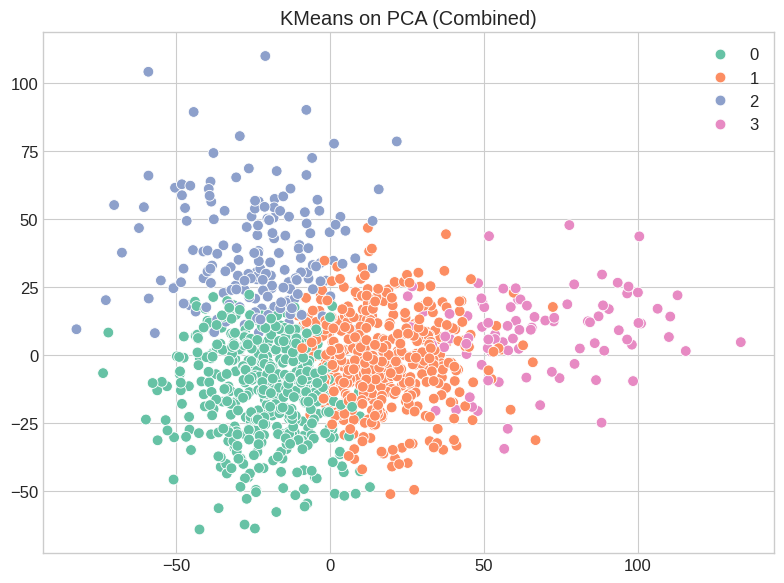

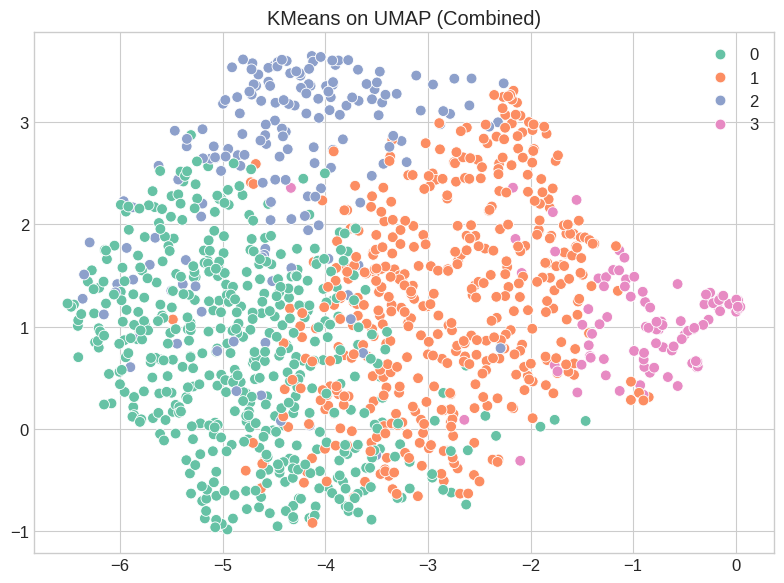

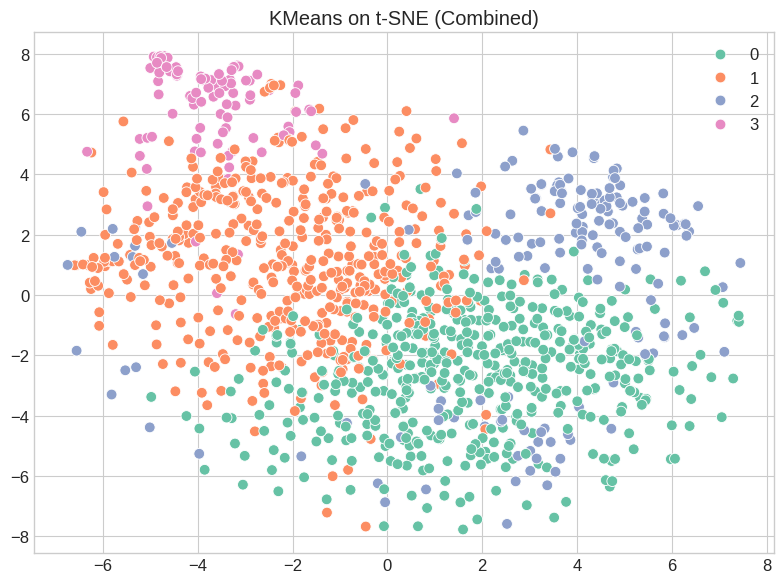

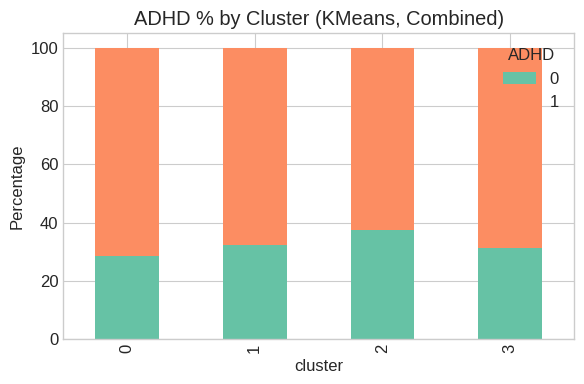


=== Detailed Cluster Analysis for KMeans (Combined) ===
=== Statistical Profiles of Clusters ===

Cluster 0: 493 samples (40.6%)

Cluster 1: 457 samples (37.7%)

Cluster 2: 170 samples (14.0%)

Cluster 3: 93 samples (7.7%)

=== SHAP-based Feature Importance ===


<Figure size 1200x800 with 0 Axes>

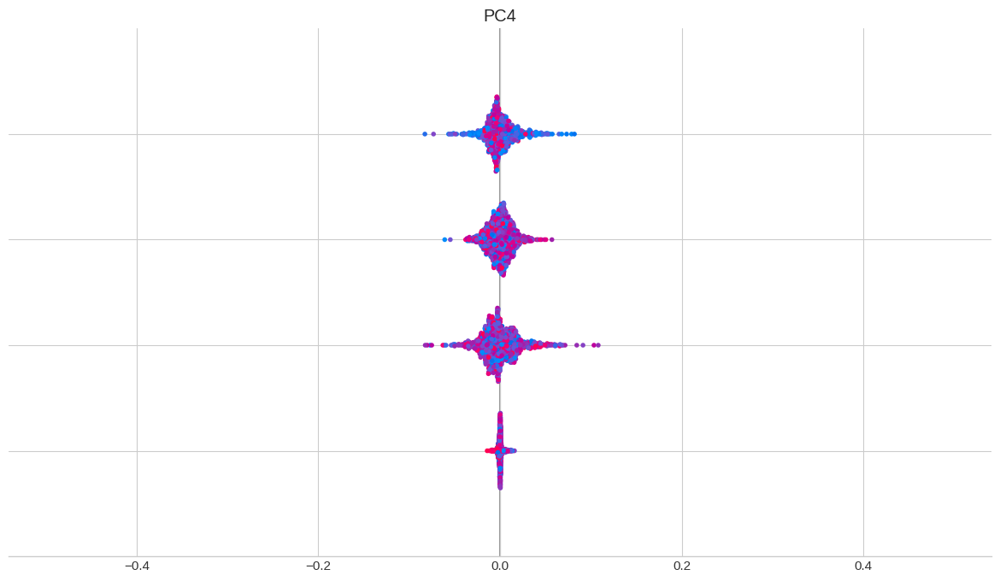


Top discriminating features for Cluster 0:
  - PC2: 0.0134
  - PC1: 0.0103
  - PC4: 0.0034
  - PC3: 0.0031

Top discriminating features for Cluster 1:
  - PC2: 0.0137
  - PC1: 0.0116
  - PC3: 0.0032
  - PC4: 0.0025

Top discriminating features for Cluster 2:
  - PC2: 0.0128
  - PC1: 0.0101
  - PC3: 0.0037
  - PC4: 0.0023

Top discriminating features for Cluster 3:
  - PC1: 0.0119
  - PC2: 0.0081
  - PC3: 0.0044
  - PC4: 0.0021

=== ADHD Outcome Distribution by Cluster ===
ADHD_Outcome          0          1
cluster                           
0             28.600406  71.399594
1             32.385120  67.614880
2             37.647059  62.352941
3             31.182796  68.817204

Chi-square test for ADHD distribution: chi2=5.07, p=0.1668

=== Sex Distribution by Cluster ===
Percentage female by cluster:
cluster
0    35.294118
1    32.603939
2    35.294118
3    35.483871
Name: Sex_F, dtype: float64

=== Key Feature Distributions by Cluster ===


<Figure size 1200x600 with 0 Axes>

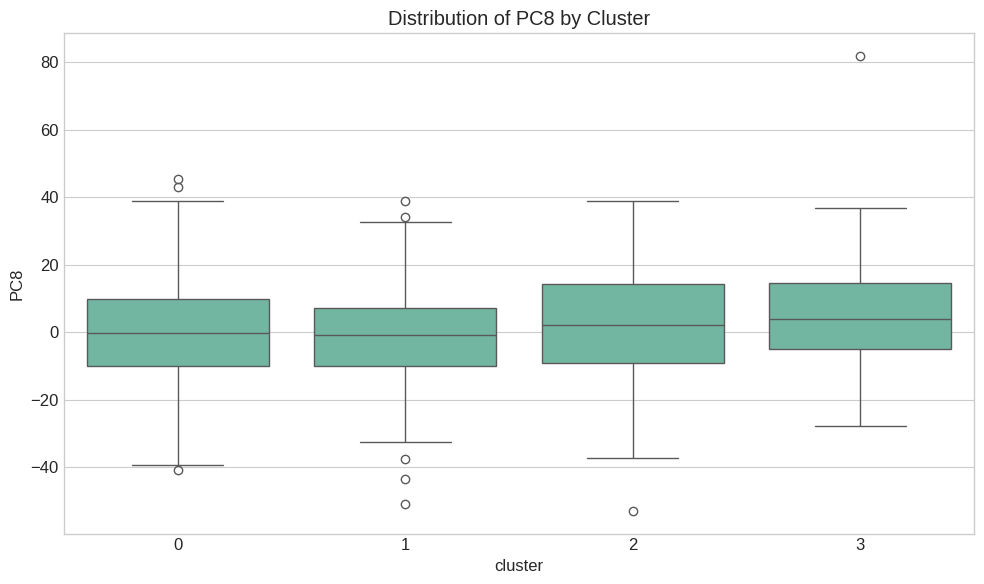

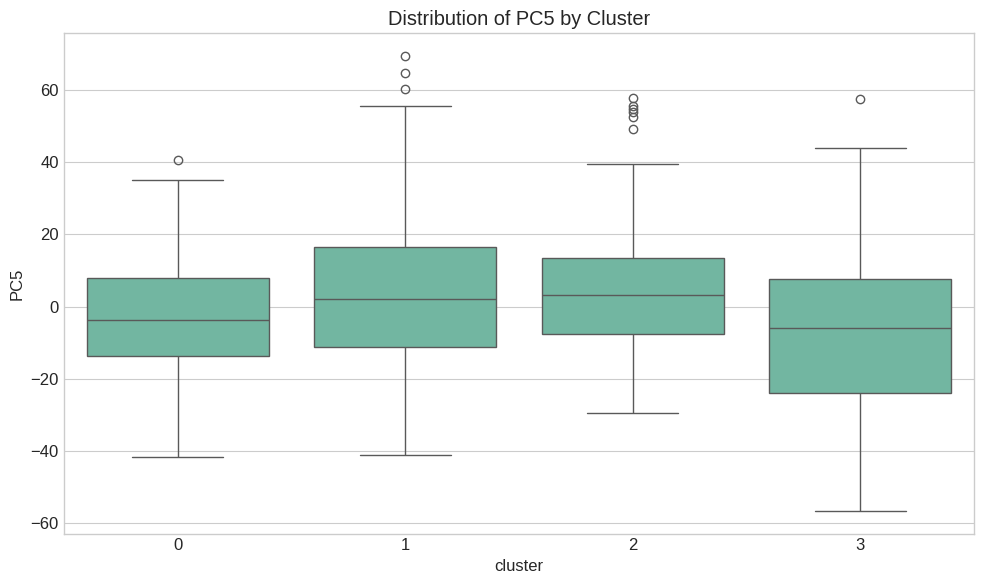

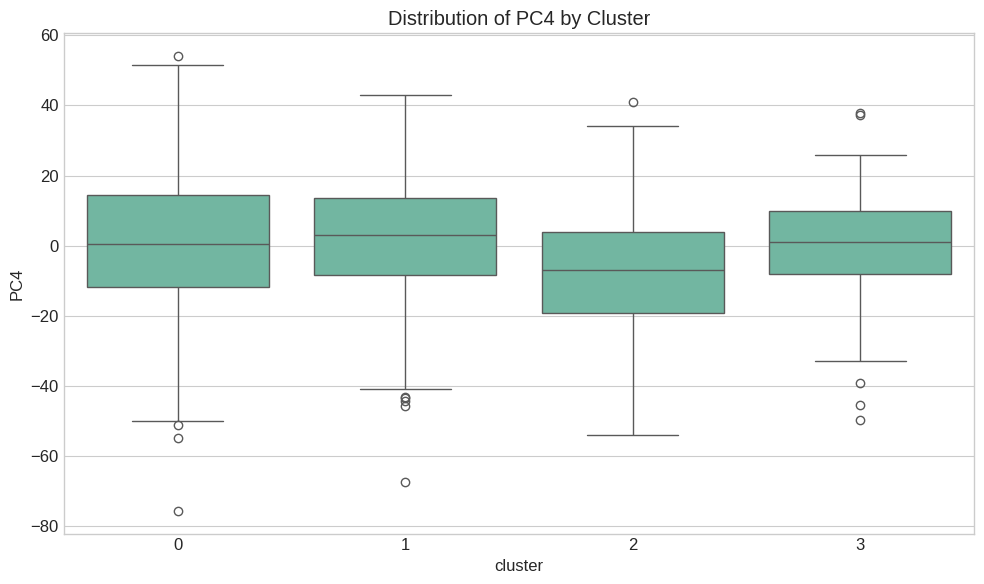

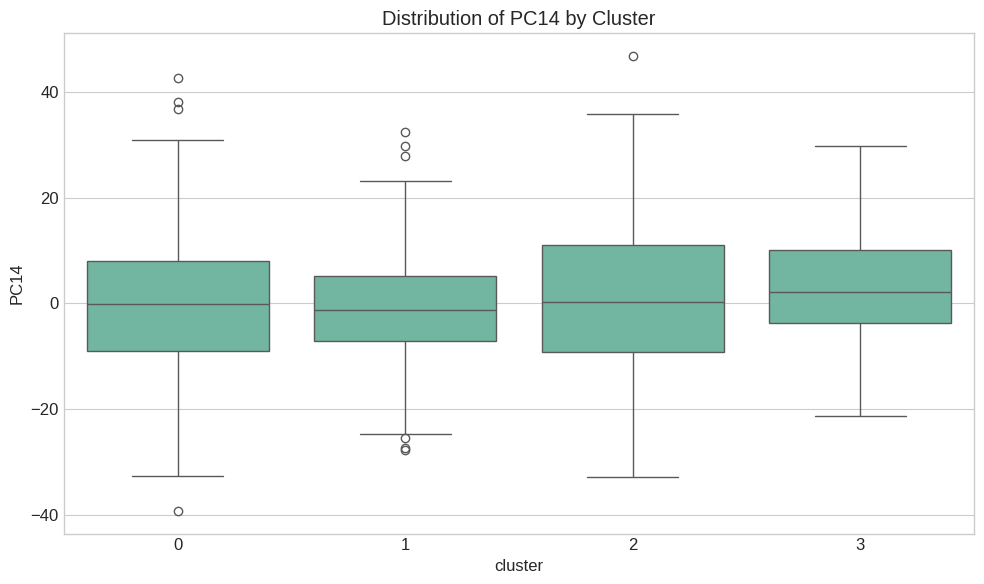

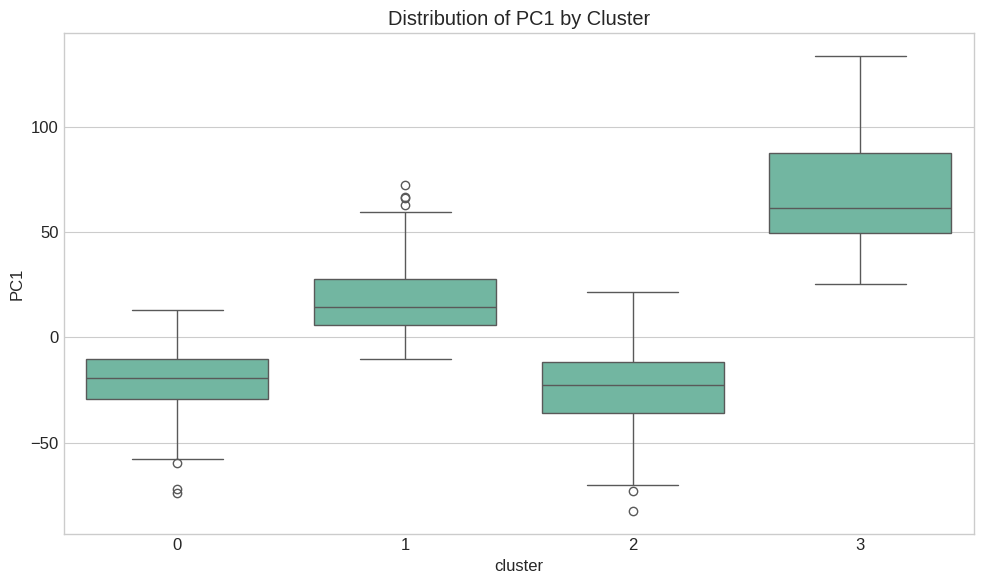


=== Cluster Narrative Summaries ===

Cluster 0 (493 samples, 40.6% of data):
Distinguished by: PC2 (lower), PC1 (lower), PC4, PC3 (higher), PC5 (lower)
ADHD distribution: 0: 28.6%, 1: 71.4%
Sex distribution: 35.3% female

Cluster 1 (457 samples, 37.7% of data):
Distinguished by: PC2, PC1 (higher), PC3 (lower), PC4, PC5 (higher)
ADHD distribution: 0: 32.4%, 1: 67.6%
Sex distribution: 32.6% female

Cluster 2 (170 samples, 14.0% of data):
Distinguished by: PC2 (higher), PC1 (lower), PC3 (higher), PC4 (lower), PC5 (higher)
ADHD distribution: 0: 37.6%, 1: 62.4%
Sex distribution: 35.3% female

Cluster 3 (93 samples, 7.7% of data):
Distinguished by: PC1 (higher), PC2 (higher), PC3 (higher), PC4, PC5 (lower)
ADHD distribution: 0: 31.2%, 1: 68.8%
Sex distribution: 35.5% female

=== Interpretation in Original Feature Space ===

Representative samples for Cluster 0:
Subject IDs: ['52s1ZW91cuyZ' '80UMdzMprwL2' 'cYRQEhrfDAtH' 'TExdbXbj29qJ'
 '3zDD5TmAAjsW']

Mean values for key continuous features

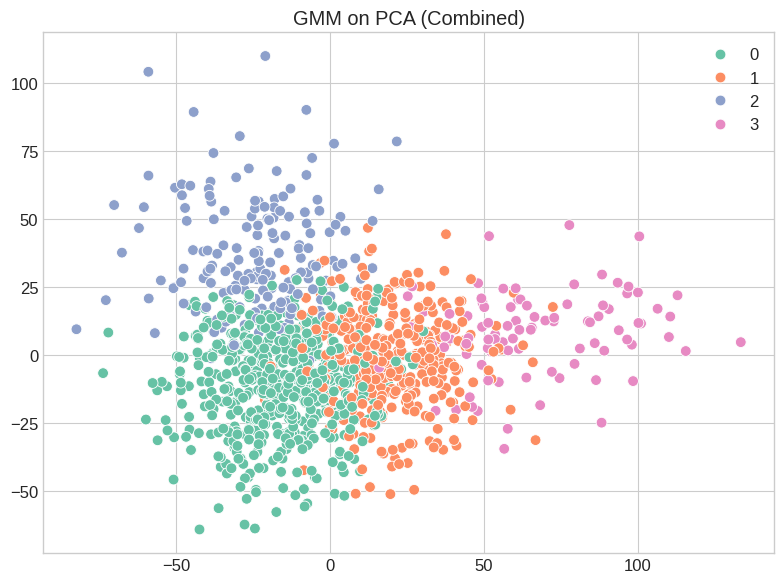

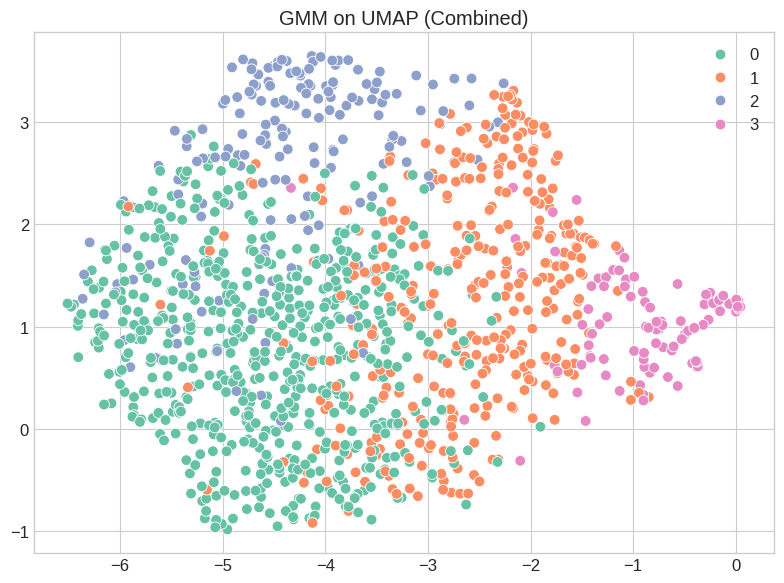

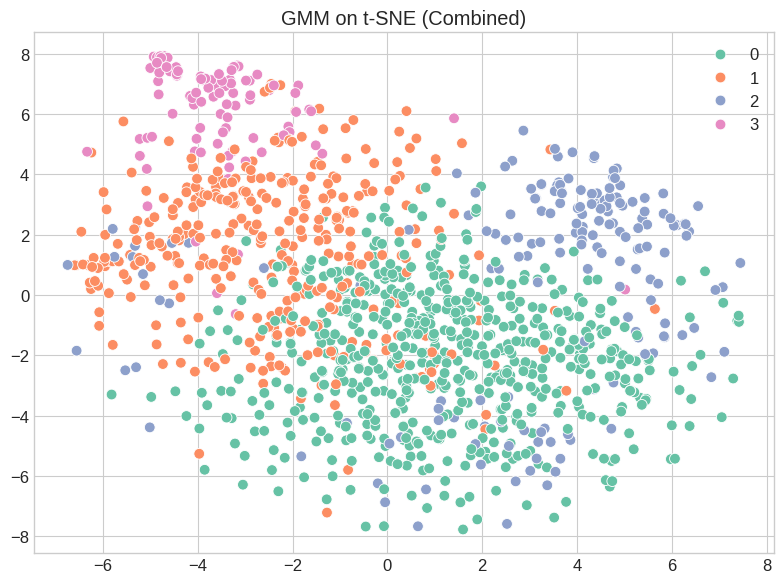

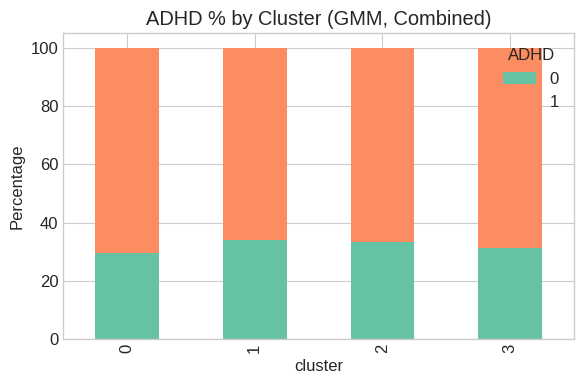


=== Detailed Cluster Analysis for GMM (Combined) ===
=== Statistical Profiles of Clusters ===

Cluster 0: 598 samples (49.3%)

Cluster 1: 345 samples (28.4%)

Cluster 2: 174 samples (14.3%)

Cluster 3: 96 samples (7.9%)

=== SHAP-based Feature Importance ===


<Figure size 1200x800 with 0 Axes>

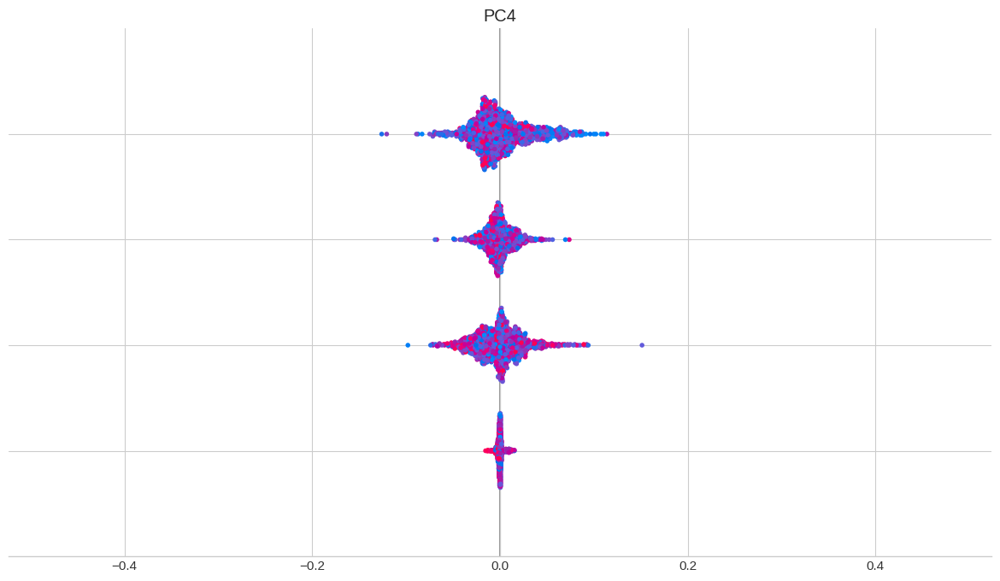


Top discriminating features for Cluster 0:
  - PC2: 0.0147
  - PC1: 0.0124
  - PC4: 0.0040
  - PC3: 0.0034

Top discriminating features for Cluster 1:
  - PC2: 0.0132
  - PC1: 0.0125
  - PC3: 0.0034
  - PC4: 0.0032

Top discriminating features for Cluster 2:
  - PC1: 0.0092
  - PC2: 0.0080
  - PC3: 0.0040
  - PC4: 0.0023

Top discriminating features for Cluster 3:
  - PC1: 0.0102
  - PC2: 0.0062
  - PC3: 0.0041
  - PC4: 0.0023

=== ADHD Outcome Distribution by Cluster ===
ADHD_Outcome          0          1
cluster                           
0             29.598662  70.401338
1             33.913043  66.086957
2             33.333333  66.666667
3             31.250000  68.750000

Chi-square test for ADHD distribution: chi2=2.21, p=0.5306

=== Sex Distribution by Cluster ===
Percentage female by cluster:
cluster
0    33.946488
1    34.492754
2    34.482759
3    35.416667
Name: Sex_F, dtype: float64

=== Key Feature Distributions by Cluster ===


<Figure size 1200x600 with 0 Axes>

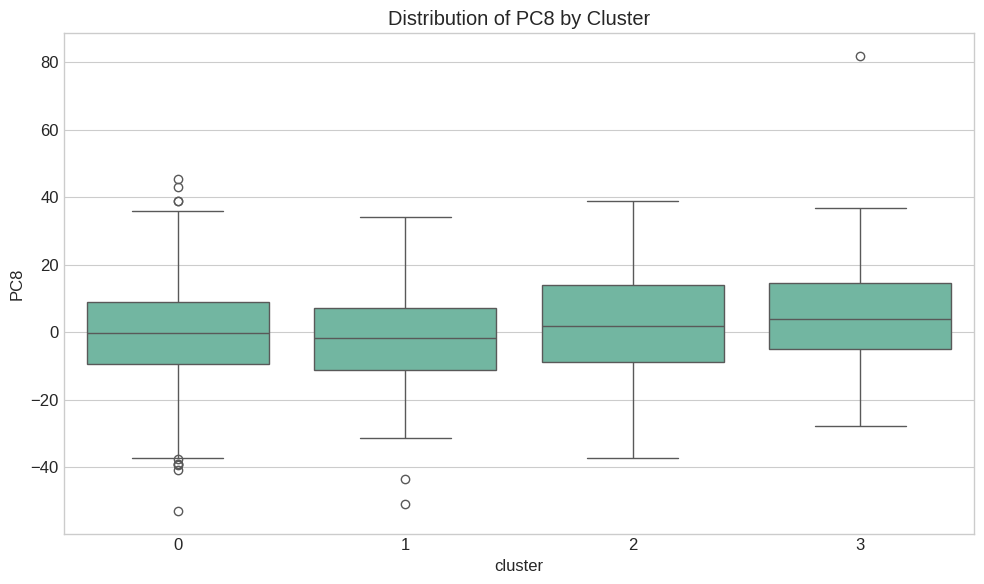

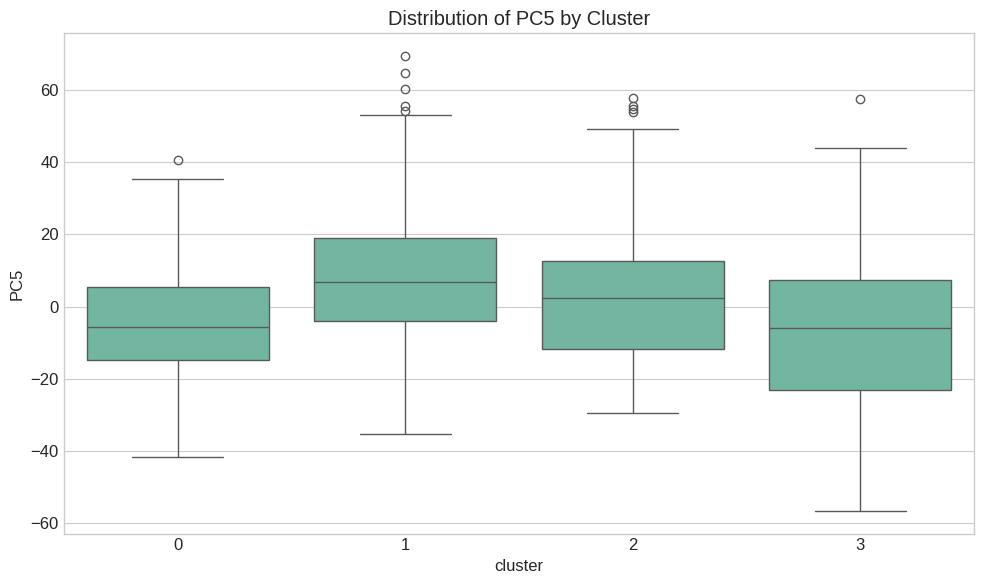

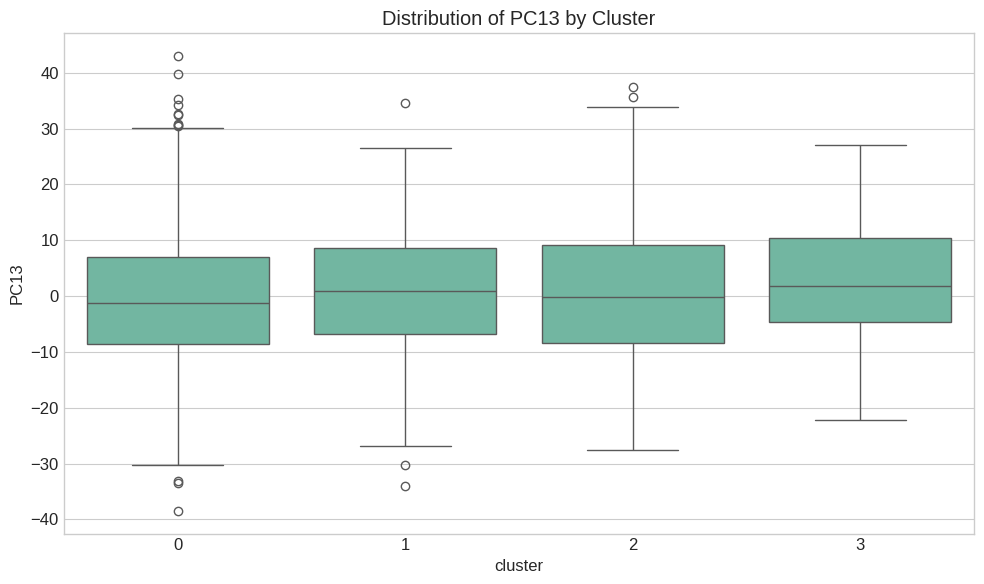

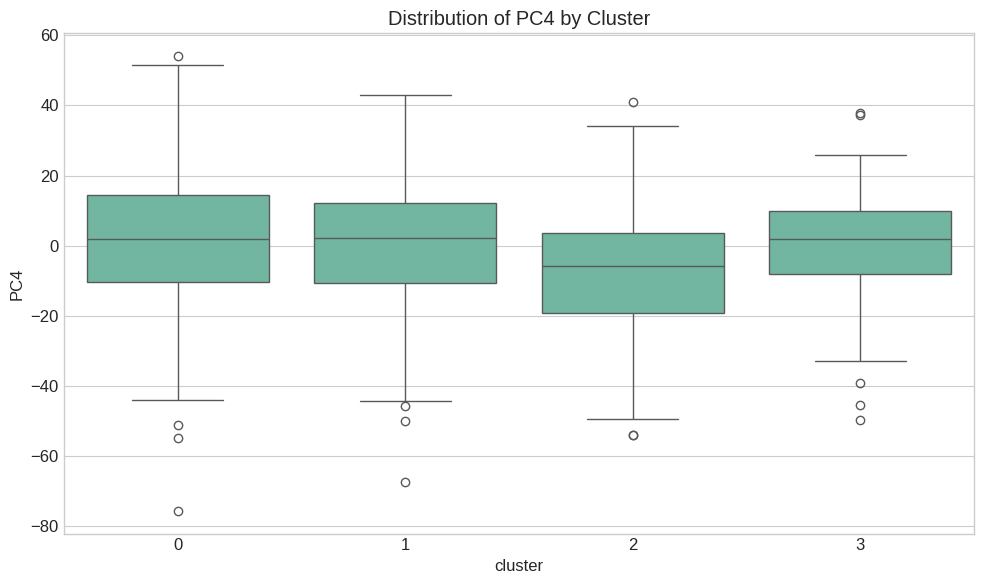

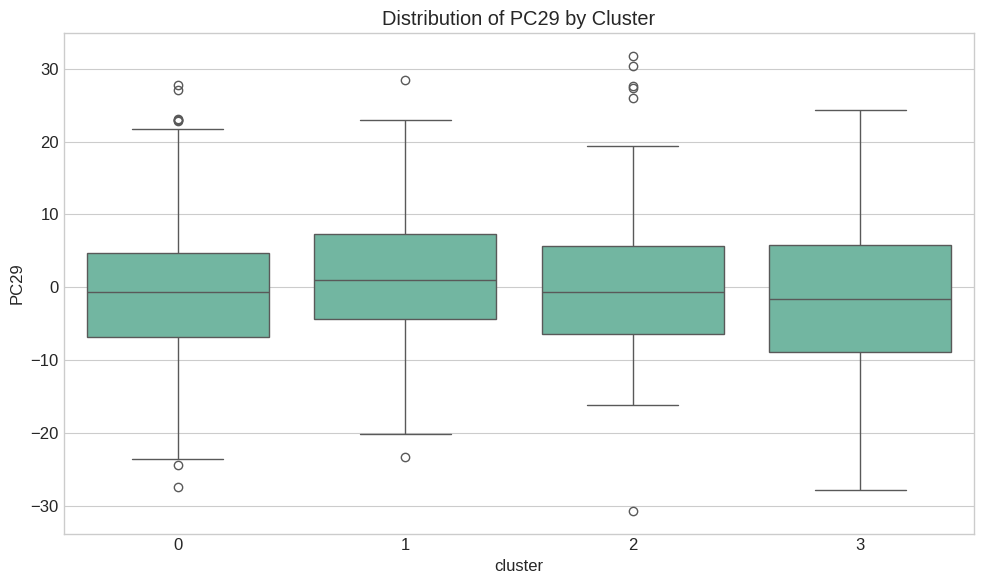


=== Cluster Narrative Summaries ===

Cluster 0 (598 samples, 49.3% of data):
Distinguished by: PC2 (lower), PC1 (lower), PC4, PC3, PC5 (lower)
ADHD distribution: 0: 29.6%, 1: 70.4%
Sex distribution: 33.9% female

Cluster 1 (345 samples, 28.4% of data):
Distinguished by: PC2, PC1 (higher), PC3 (lower), PC4, PC5 (higher)
ADHD distribution: 0: 33.9%, 1: 66.1%
Sex distribution: 34.5% female

Cluster 2 (174 samples, 14.3% of data):
Distinguished by: PC1 (lower), PC2 (higher), PC3 (higher), PC4 (lower), PC5 (higher)
ADHD distribution: 0: 33.3%, 1: 66.7%
Sex distribution: 34.5% female

Cluster 3 (96 samples, 7.9% of data):
Distinguished by: PC1 (higher), PC2 (higher), PC3 (higher), PC4, PC5 (lower)
ADHD distribution: 0: 31.2%, 1: 68.8%
Sex distribution: 35.4% female

=== Interpretation in Original Feature Space ===

Representative samples for Cluster 0:
Subject IDs: ['52s1ZW91cuyZ' 'oM6q8ZwYF4Hv' 'TExdbXbj29qJ' '3zDD5TmAAjsW'
 'fxW28SwnU34E']

Mean values for key continuous features:
  EHQ_E

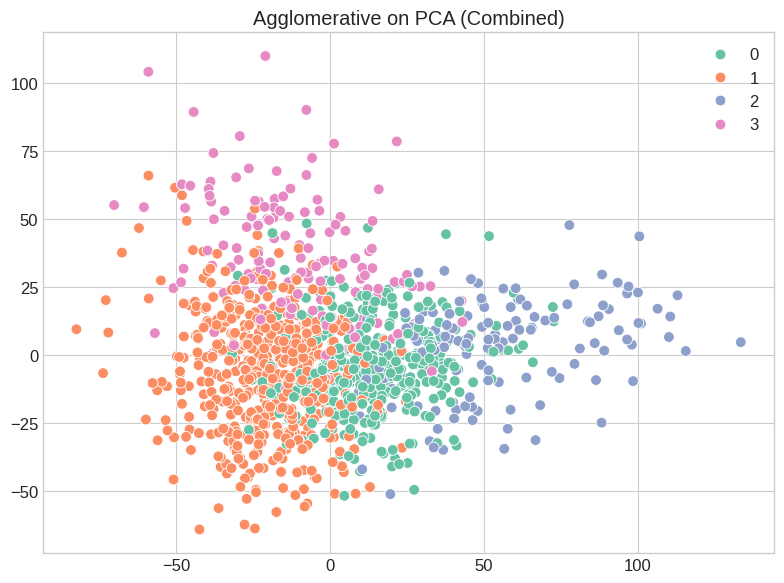

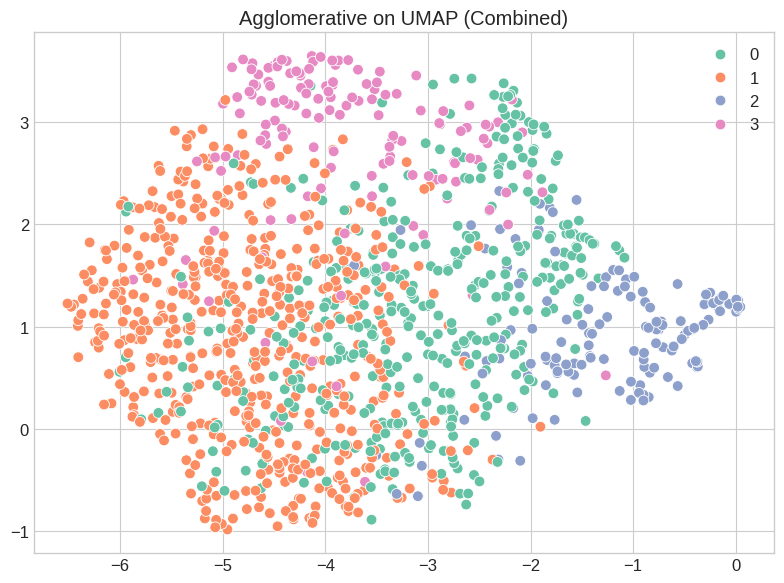

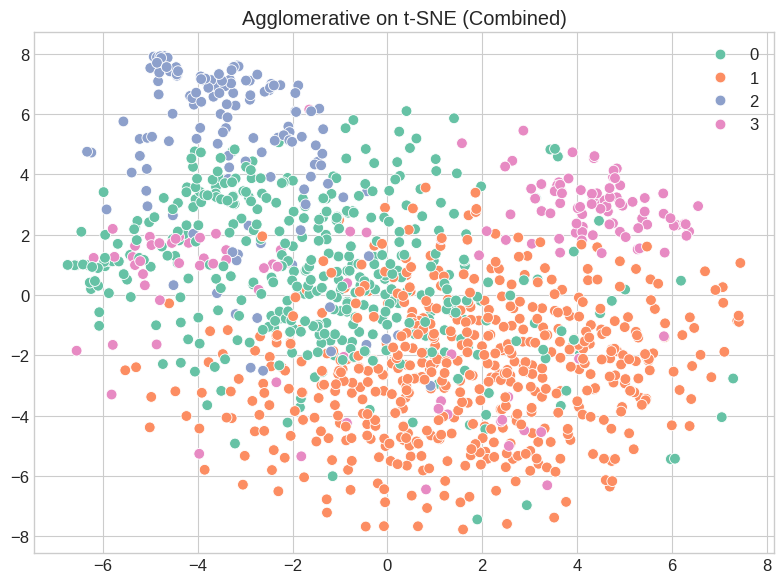

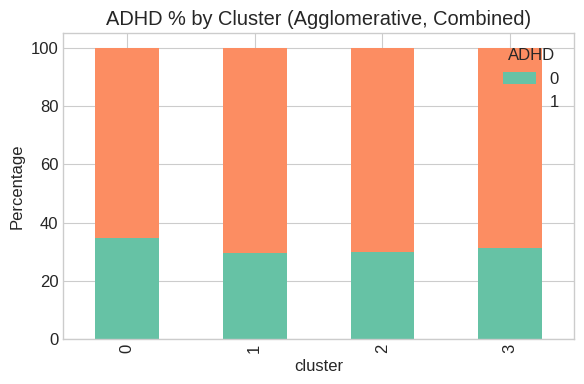


=== Detailed Cluster Analysis for Agglomerative (Combined) ===
=== Statistical Profiles of Clusters ===

Cluster 0: 402 samples (33.1%)

Cluster 1: 533 samples (43.9%)

Cluster 2: 137 samples (11.3%)

Cluster 3: 141 samples (11.6%)

=== SHAP-based Feature Importance ===


<Figure size 1200x800 with 0 Axes>

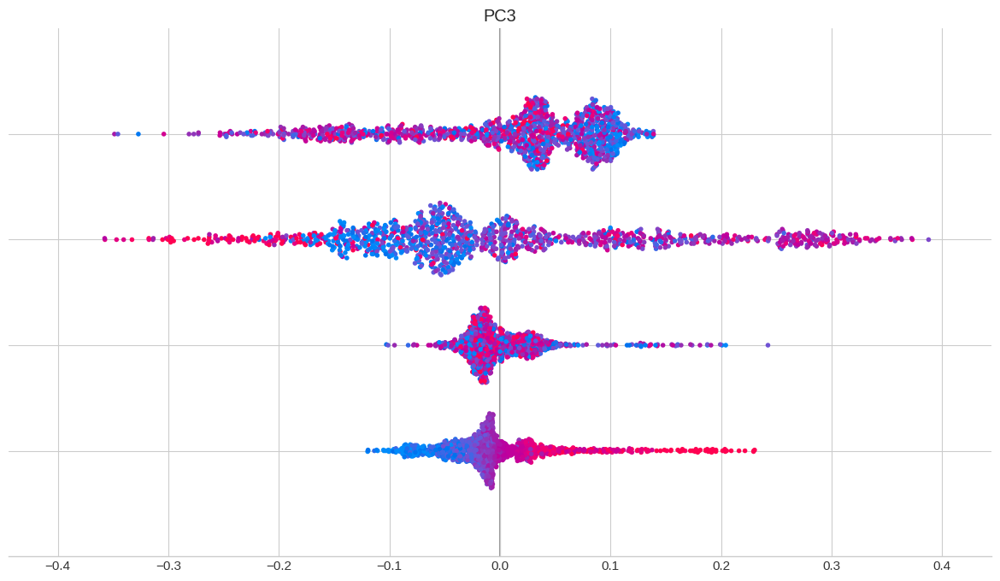


Top discriminating features for Cluster 0:
  - PC1: 0.0128
  - PC2: 0.0100
  - PC3: 0.0066
  - PC4: 0.0034

Top discriminating features for Cluster 1:
  - PC3: 0.0118
  - PC1: 0.0107
  - PC2: 0.0104
  - PC4: 0.0026

Top discriminating features for Cluster 2:
  - PC1: 0.0112
  - PC2: 0.0093
  - PC3: 0.0039
  - PC4: 0.0035

Top discriminating features for Cluster 3:
  - PC2: 0.0115
  - PC1: 0.0086
  - PC4: 0.0030
  - PC3: 0.0029

=== ADHD Outcome Distribution by Cluster ===
ADHD_Outcome          0          1
cluster                           
0             34.577114  65.422886
1             29.643527  70.356473
2             29.927007  70.072993
3             31.205674  68.794326

Chi-square test for ADHD distribution: chi2=2.78, p=0.4271

=== Sex Distribution by Cluster ===
Percentage female by cluster:
cluster
0    33.582090
1    34.709193
2    35.766423
3    33.333333
Name: Sex_F, dtype: float64

=== Key Feature Distributions by Cluster ===


<Figure size 1200x600 with 0 Axes>

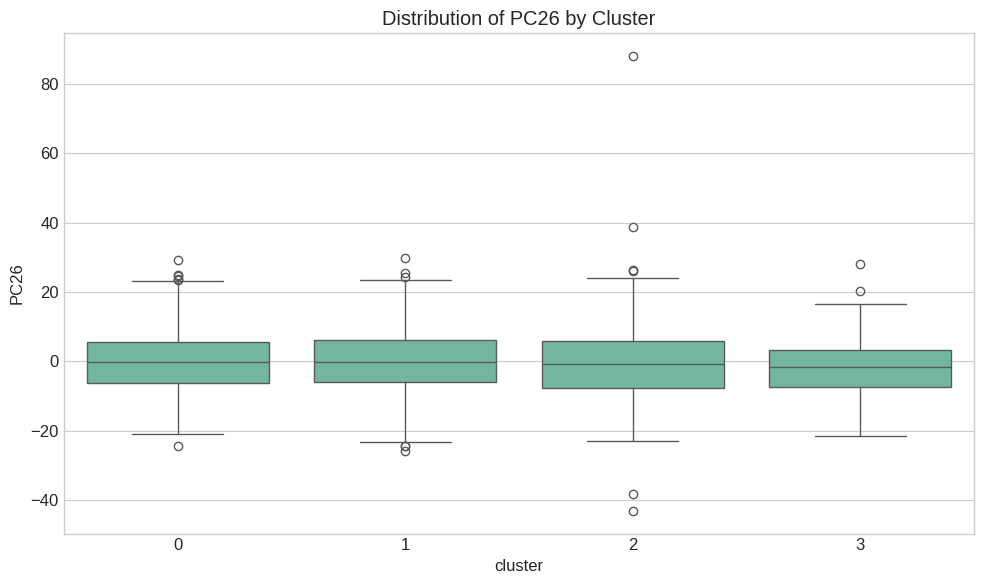

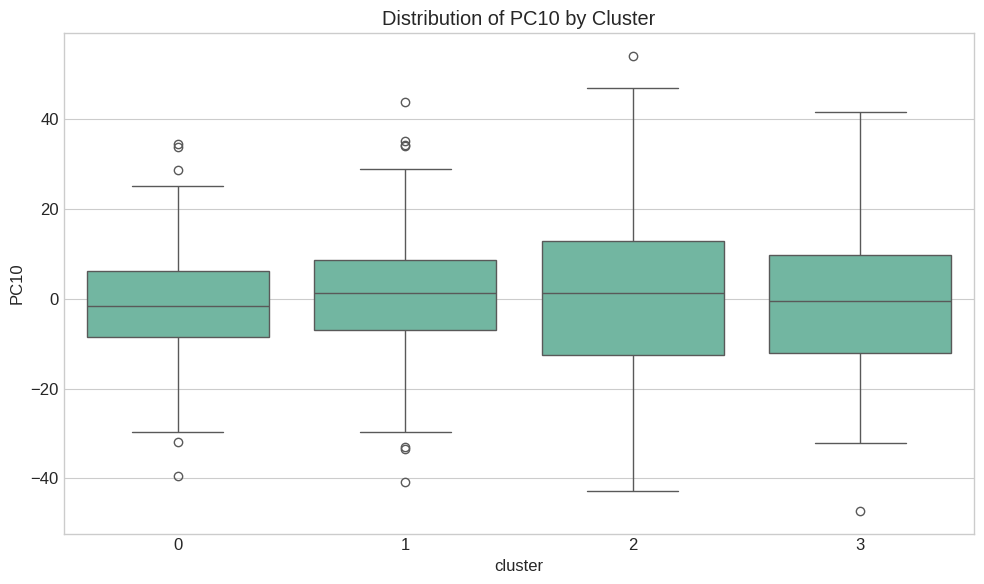

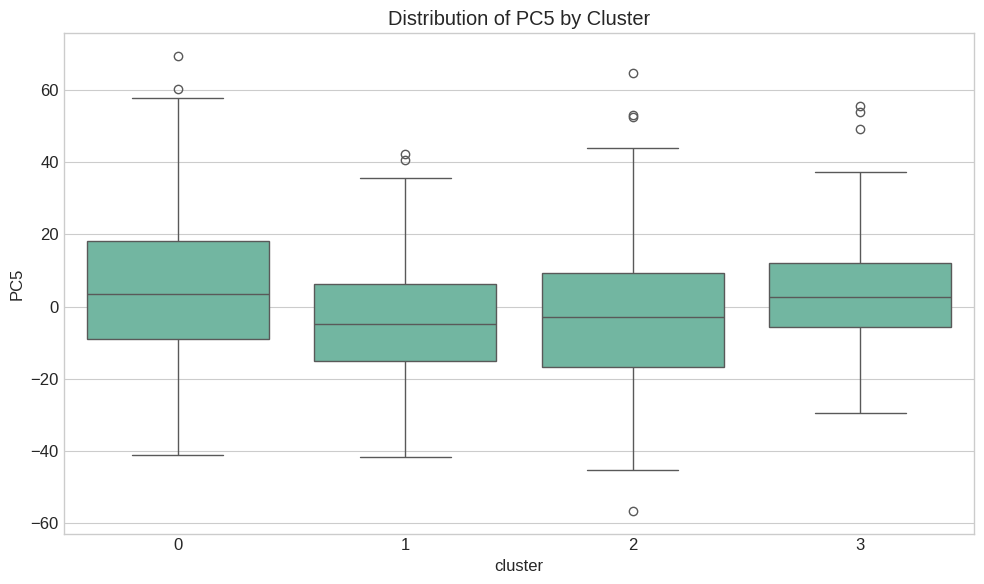

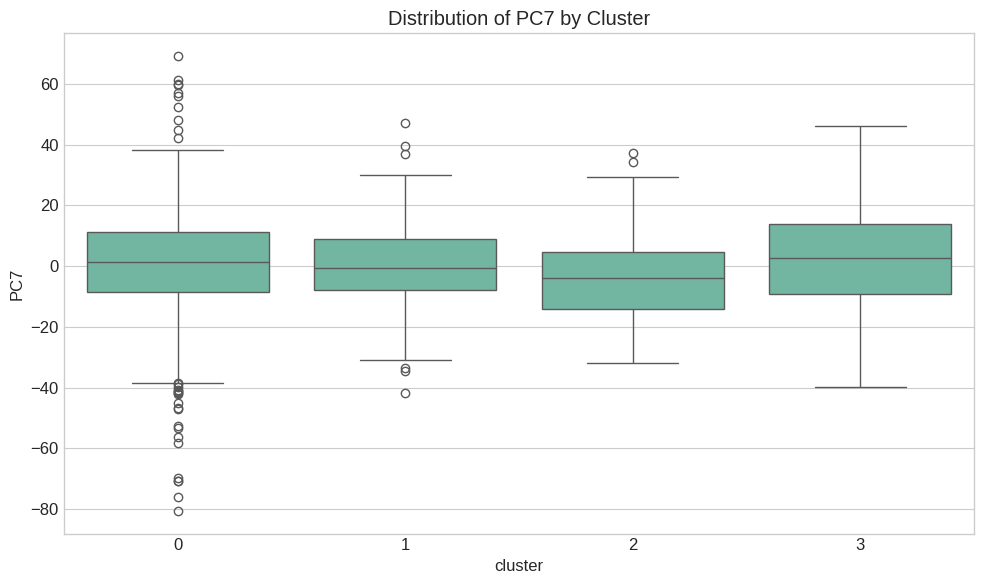

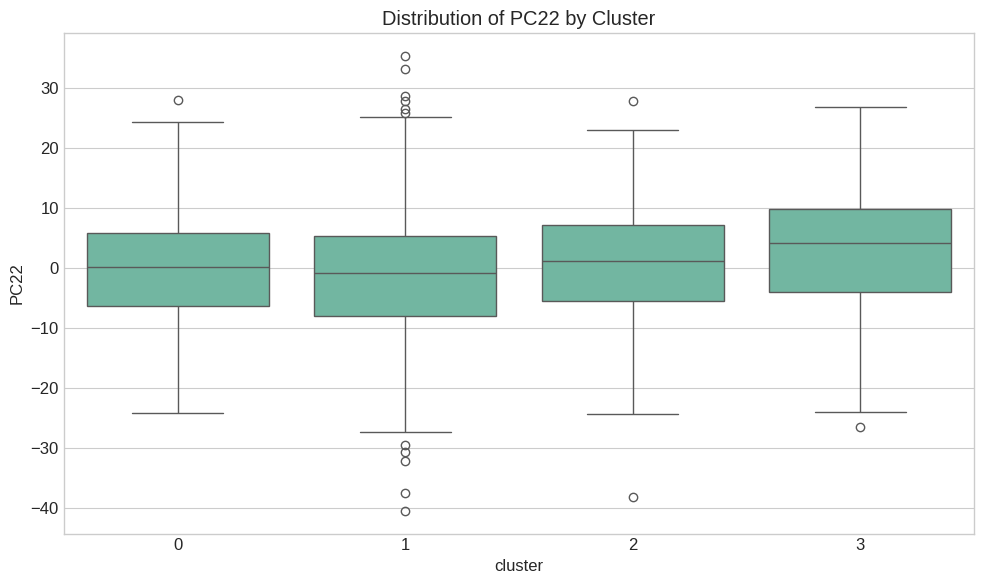


=== Cluster Narrative Summaries ===

Cluster 0 (402 samples, 33.1% of data):
Distinguished by: PC1 (higher), PC2 (lower), PC3 (lower), PC4 (higher), PC5 (higher)
ADHD distribution: 0: 34.6%, 1: 65.4%
Sex distribution: 33.6% female

Cluster 1 (533 samples, 43.9% of data):
Distinguished by: PC3 (higher), PC1 (lower), PC2 (lower), PC4, PC5 (lower)
ADHD distribution: 0: 29.6%, 1: 70.4%
Sex distribution: 34.7% female

Cluster 2 (137 samples, 11.3% of data):
Distinguished by: PC1 (higher), PC2 (higher), PC3 (higher), PC4, PC7 (lower)
ADHD distribution: 0: 29.9%, 1: 70.1%
Sex distribution: 35.8% female

Cluster 3 (141 samples, 11.6% of data):
Distinguished by: PC2 (higher), PC1 (lower), PC4 (lower), PC3, PC5 (higher)
ADHD distribution: 0: 31.2%, 1: 68.8%
Sex distribution: 33.3% female

=== Interpretation in Original Feature Space ===

Representative samples for Cluster 0:
Subject IDs: ['oM6q8ZwYF4Hv' 'ymIvXfO1Q2g8' 'dV3APoDHAwWf' 'fxW28SwnU34E'
 'UxzkcTTukkSI']

Mean values for key continuou

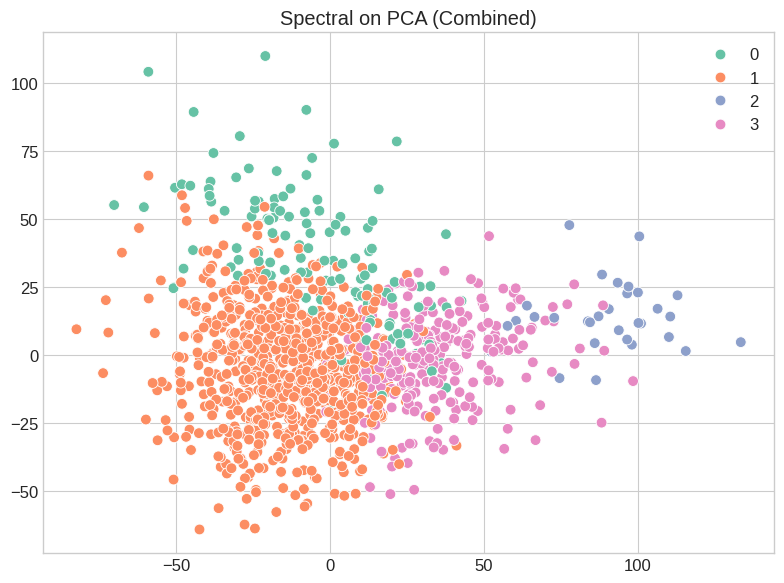

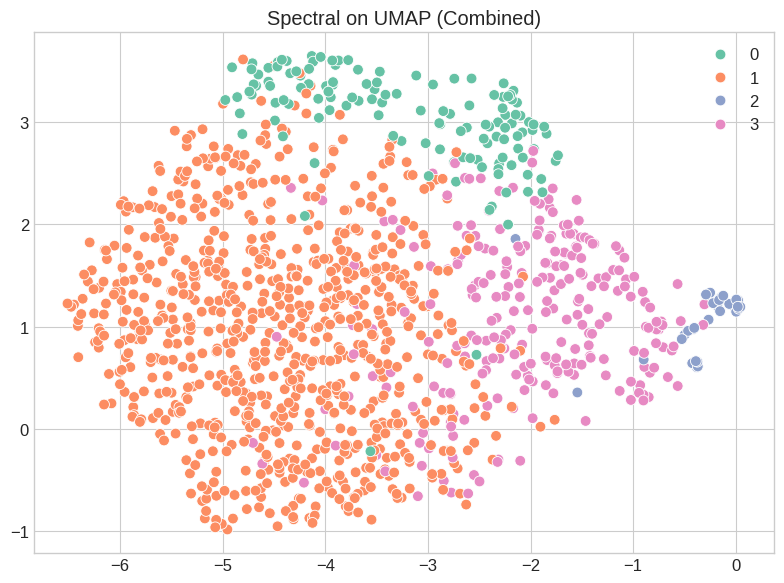

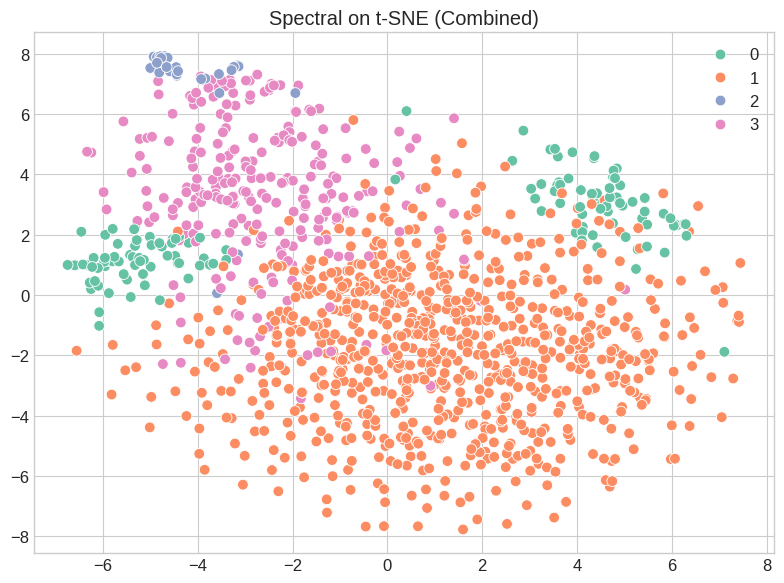

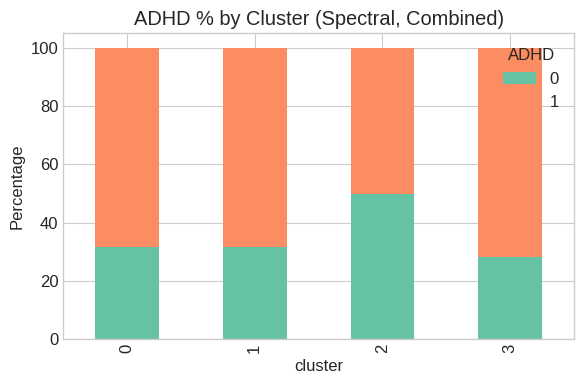


=== Detailed Cluster Analysis for Spectral (Combined) ===
=== Statistical Profiles of Clusters ===

Cluster 0: 132 samples (10.9%)

Cluster 1: 794 samples (65.5%)

Cluster 2: 32 samples (2.6%)

Cluster 3: 255 samples (21.0%)

=== SHAP-based Feature Importance ===


<Figure size 1200x800 with 0 Axes>

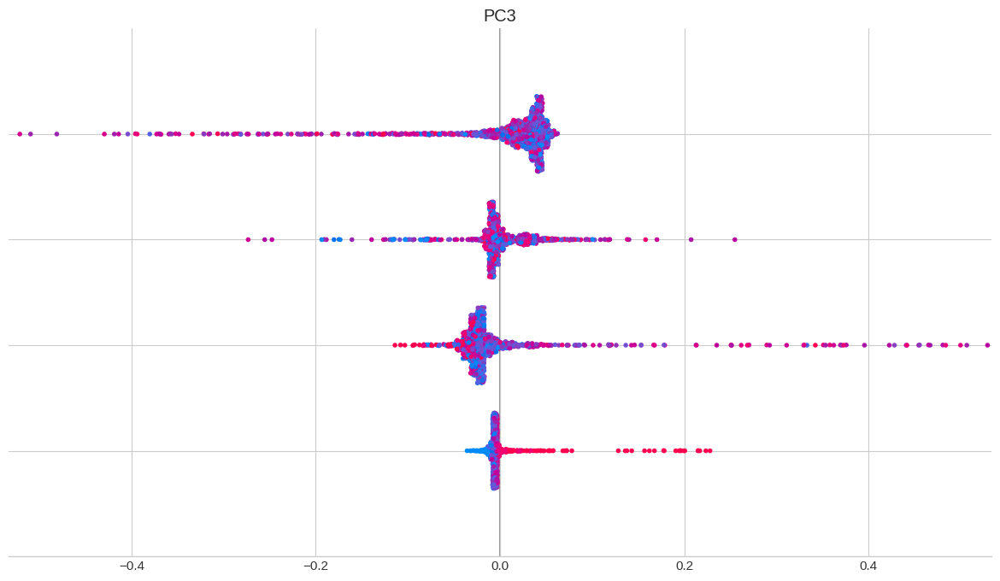


Top discriminating features for Cluster 0:
  - PC4: 0.0153
  - PC2: 0.0140
  - PC1: 0.0027
  - PC3: 0.0017

Top discriminating features for Cluster 1:
  - PC4: 0.0145
  - PC2: 0.0145
  - PC1: 0.0029
  - PC3: 0.0012

Top discriminating features for Cluster 2:
  - PC2: 0.0075
  - PC4: 0.0058
  - PC1: 0.0030
  - PC3: 0.0007

Top discriminating features for Cluster 3:
  - PC2: 0.0075
  - PC4: 0.0054
  - PC1: 0.0024
  - PC3: 0.0007

=== ADHD Outcome Distribution by Cluster ===
ADHD_Outcome          0          1
cluster                           
0             31.818182  68.181818
1             31.738035  68.261965
2             50.000000  50.000000
3             28.235294  71.764706

Chi-square test for ADHD distribution: chi2=6.36, p=0.0952

=== Sex Distribution by Cluster ===
Percentage female by cluster:
cluster
0    27.272727
1    35.390428
2    40.625000
3    33.725490
Name: Sex_F, dtype: float64

=== Key Feature Distributions by Cluster ===


<Figure size 1200x600 with 0 Axes>

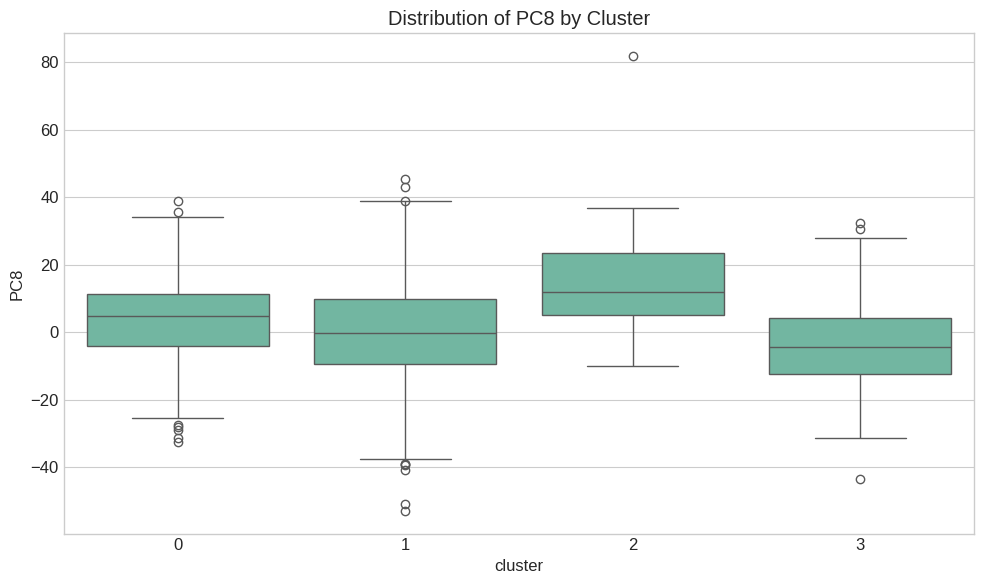

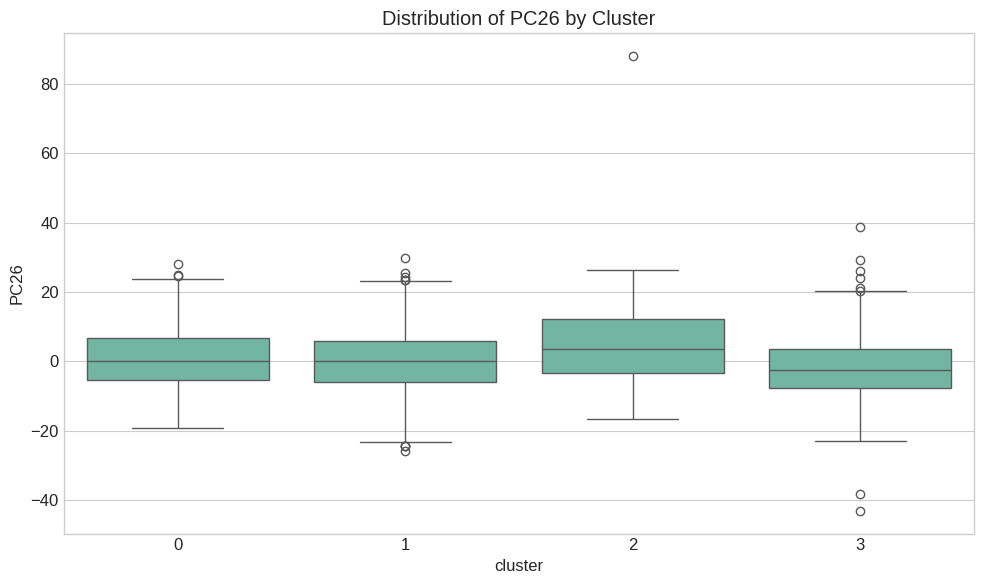

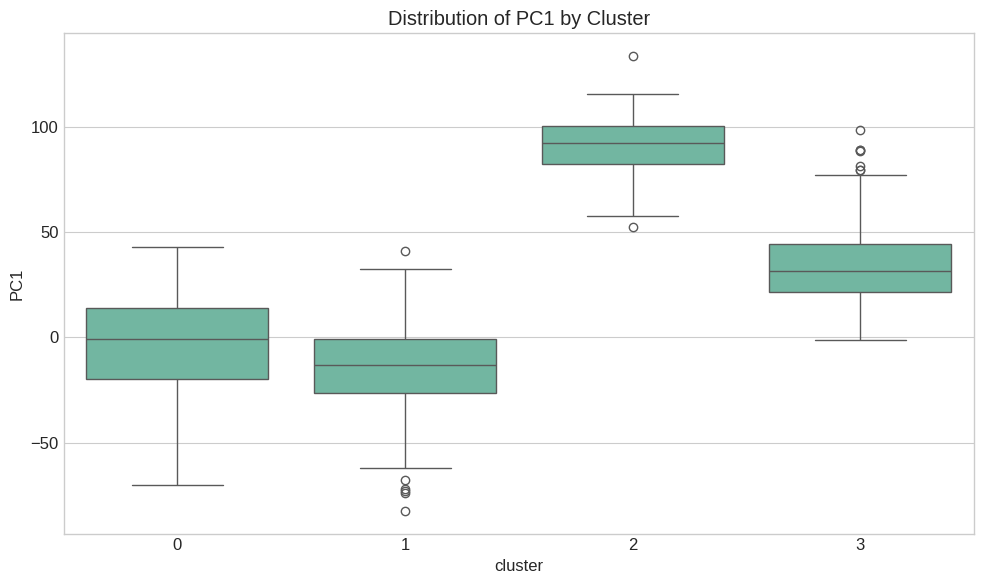

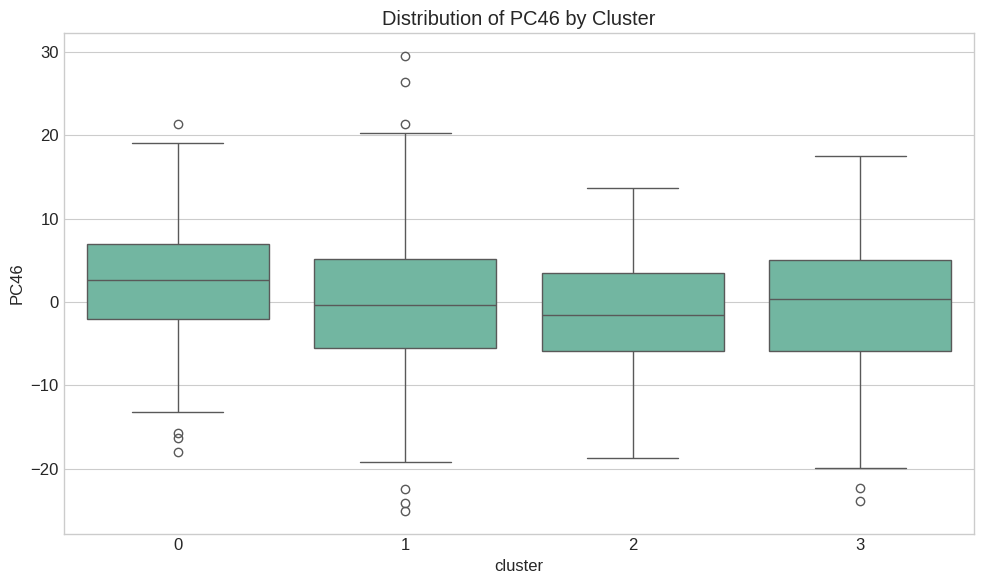

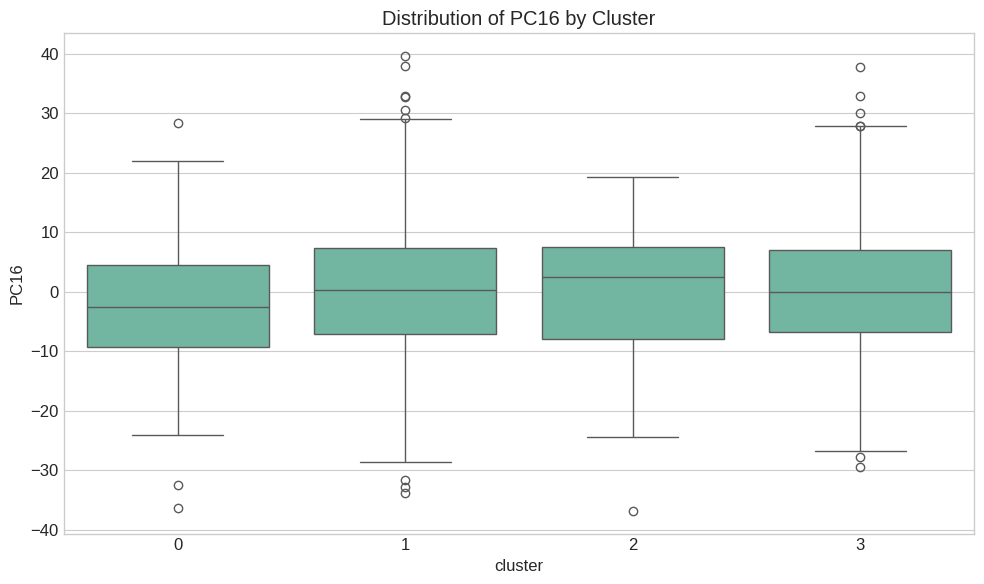


=== Cluster Narrative Summaries ===

Cluster 0 (132 samples, 10.9% of data):
Distinguished by: PC4 (lower), PC2 (higher), PC1, PC3 (lower), PC5 (higher)
ADHD distribution: 0: 31.8%, 1: 68.2%
Sex distribution: 27.3% female

Cluster 1 (794 samples, 65.5% of data):
Distinguished by: PC4, PC2 (lower), PC1 (lower), PC3, PC5 (lower)
ADHD distribution: 0: 31.7%, 1: 68.3%
Sex distribution: 35.4% female

Cluster 2 (32 samples, 2.6% of data):
Distinguished by: PC2 (higher), PC4, PC1 (higher), PC3 (higher), PC5 (lower)
ADHD distribution: 0: 50.0%, 1: 50.0%
Sex distribution: 40.6% female

Cluster 3 (255 samples, 21.0% of data):
Distinguished by: PC2, PC4 (higher), PC1 (higher), PC3, PC5 (higher)
ADHD distribution: 0: 28.2%, 1: 71.8%
Sex distribution: 33.7% female

=== Interpretation in Original Feature Space ===

Representative samples for Cluster 0:
Subject IDs: ['BFgVj9r4WODJ' 'ULwVuksArq96' 'Jf2u0UWFo6pK' 'r44YD9eIqJ9u'
 'oagxk3X4AsPx']

Mean values for key continuous features:
  EHQ_EHQ_Total

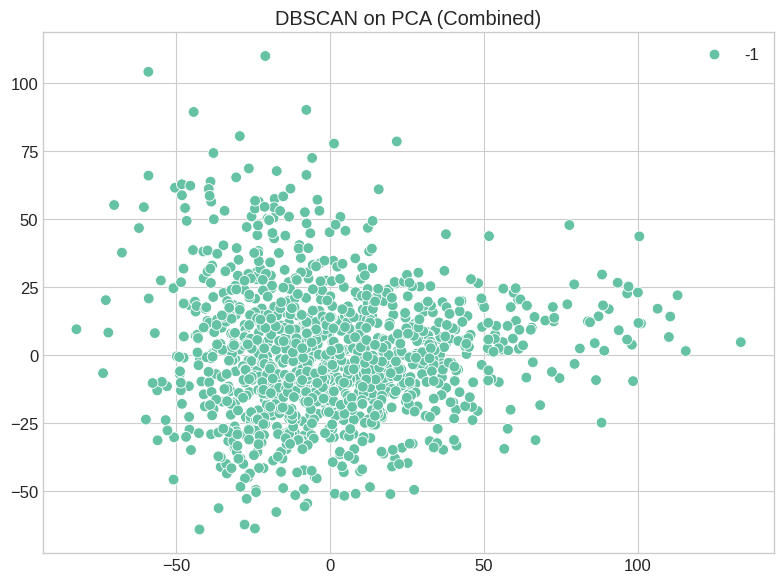

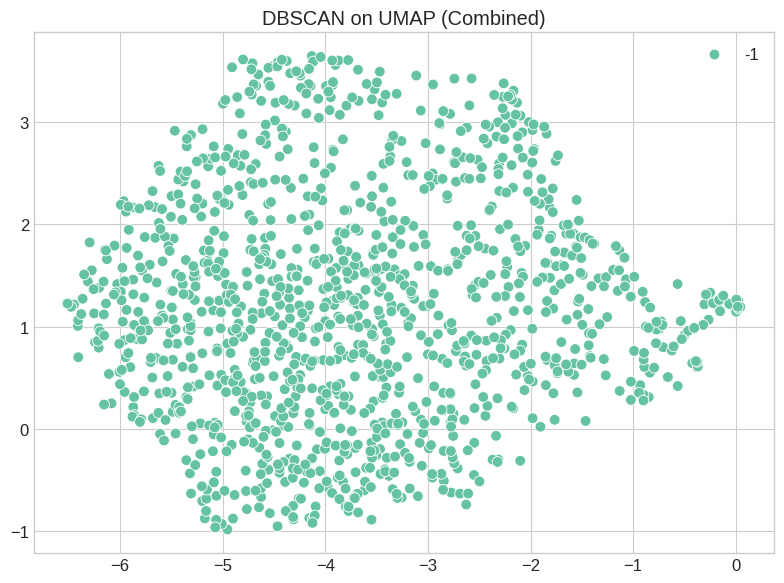

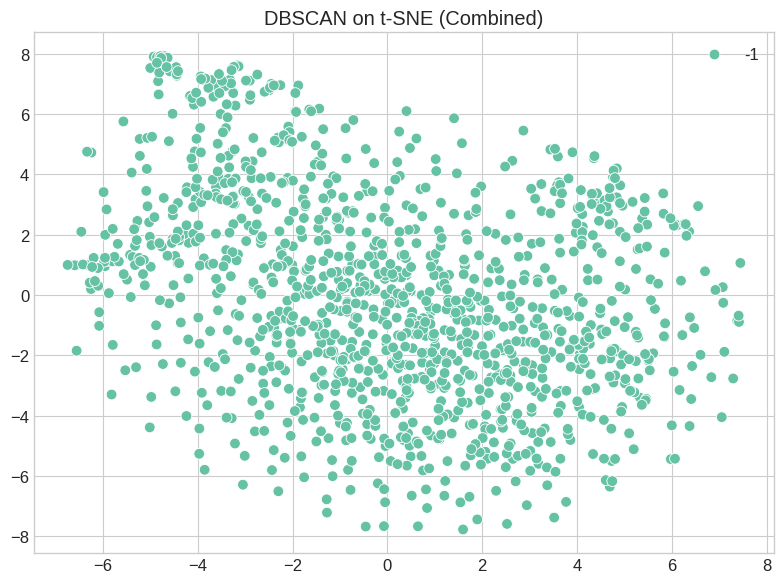

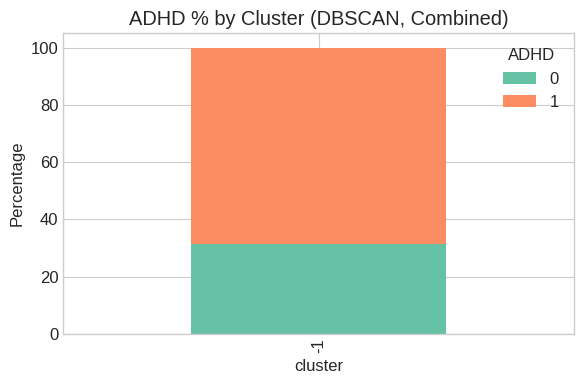


=== Detailed Cluster Analysis for DBSCAN (Combined) ===
=== Statistical Profiles of Clusters ===

=== ADHD Outcome Distribution by Cluster ===
ADHD_Outcome          0          1
cluster                           
-1            31.492168  68.507832

Chi-square test for ADHD distribution: chi2=0.00, p=1.0000

=== Sex Distribution by Cluster ===
Percentage female by cluster:
cluster
-1    34.295136
Name: Sex_F, dtype: float64

=== Cluster Narrative Summaries ===

=== Cohort: Male (n=797) ===
-> PCA variance retained: 38.44%

--- Algorithm: KMeans ---
KMeans: silhouette=0.057, ARI=0.904, clusters=[(np.int32(0), np.int64(67)), (np.int32(1), np.int64(291)), (np.int32(2), np.int64(114)), (np.int32(3), np.int64(325))]


<Figure size 1200x600 with 0 Axes>

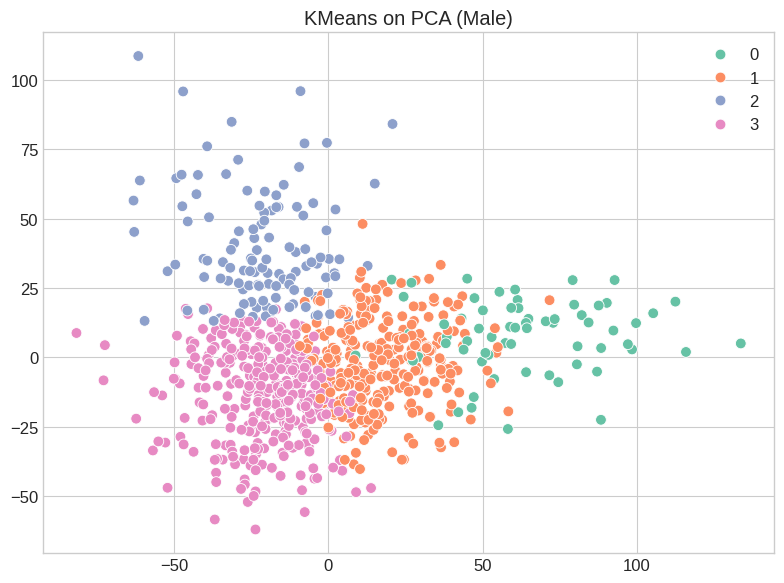

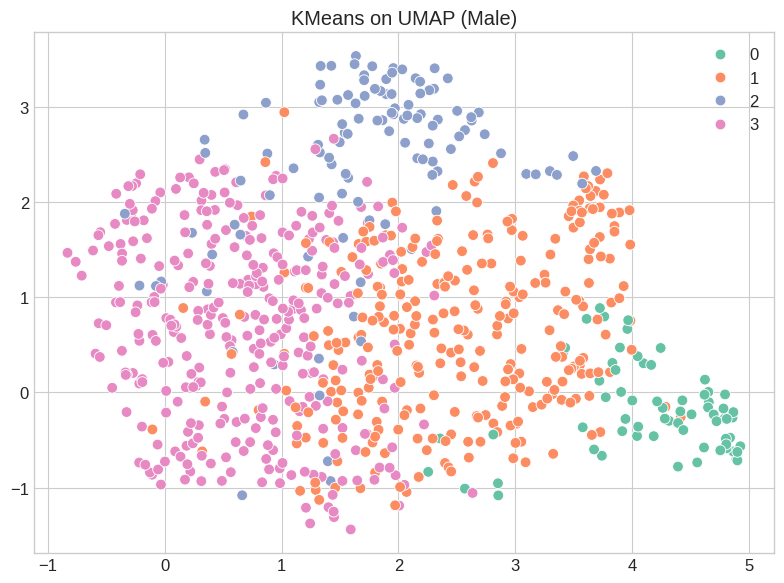

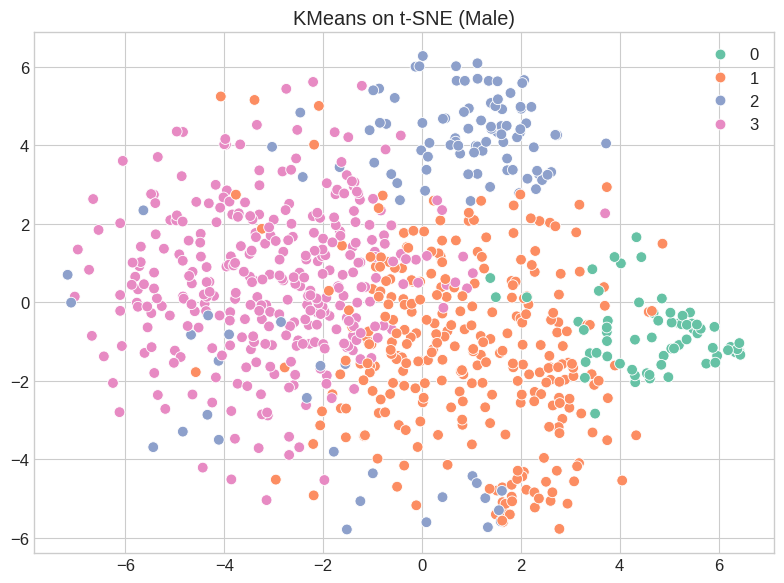

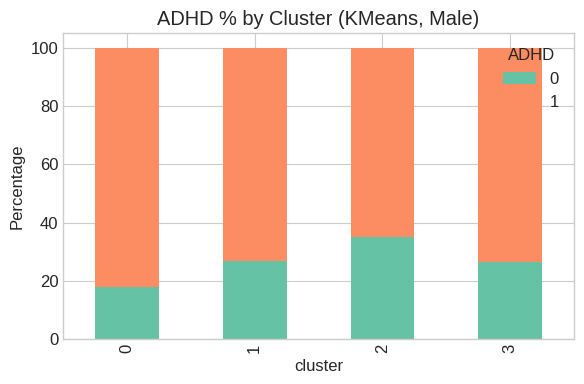


=== Detailed Cluster Analysis for KMeans (Male) ===
=== Statistical Profiles of Clusters ===

Cluster 0: 67 samples (8.4%)

Cluster 1: 291 samples (36.5%)

Cluster 2: 114 samples (14.3%)

Cluster 3: 325 samples (40.8%)

=== SHAP-based Feature Importance ===


<Figure size 1200x800 with 0 Axes>

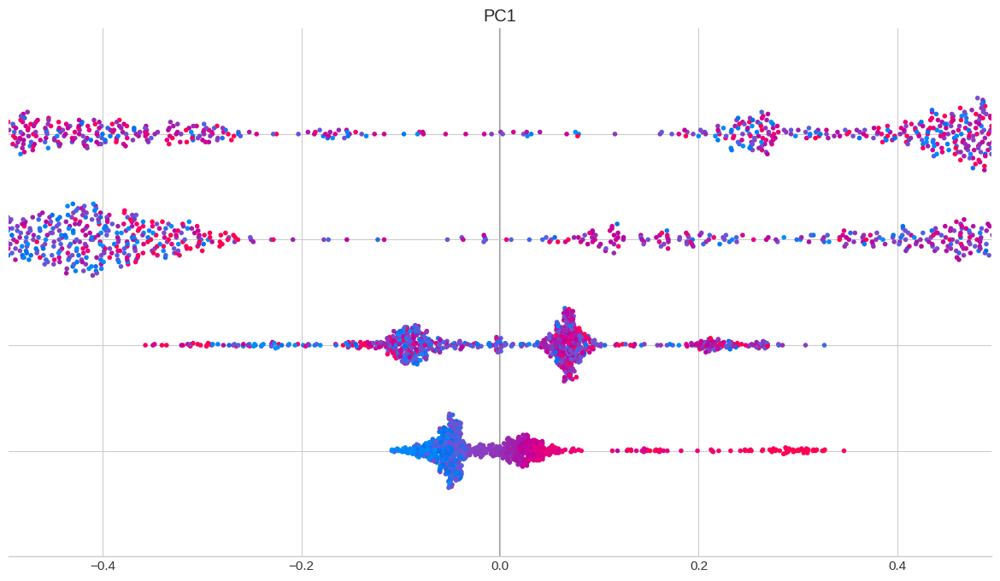


Top discriminating features for Cluster 0:
  - PC2: 0.0131
  - PC4: 0.0097
  - PC1: 0.0037
  - PC3: 0.0030

Top discriminating features for Cluster 1:
  - PC2: 0.0137
  - PC4: 0.0112
  - PC1: 0.0036
  - PC3: 0.0031

Top discriminating features for Cluster 2:
  - PC2: 0.0126
  - PC4: 0.0102
  - PC3: 0.0045
  - PC1: 0.0023

Top discriminating features for Cluster 3:
  - PC2: 0.0158
  - PC4: 0.0100
  - PC1: 0.0076
  - PC3: 0.0037

=== ADHD Outcome Distribution by Cluster ===
ADHD_Outcome          0          1
cluster                           
0             17.910448  82.089552
1             26.804124  73.195876
2             35.087719  64.912281
3             26.461538  73.538462

Chi-square test for ADHD distribution: chi2=6.63, p=0.0848

=== Sex Distribution by Cluster ===
Percentage female by cluster:
cluster
0    0.0
1    0.0
2    0.0
3    0.0
Name: Sex_F, dtype: float64

=== Key Feature Distributions by Cluster ===


<Figure size 1200x600 with 0 Axes>

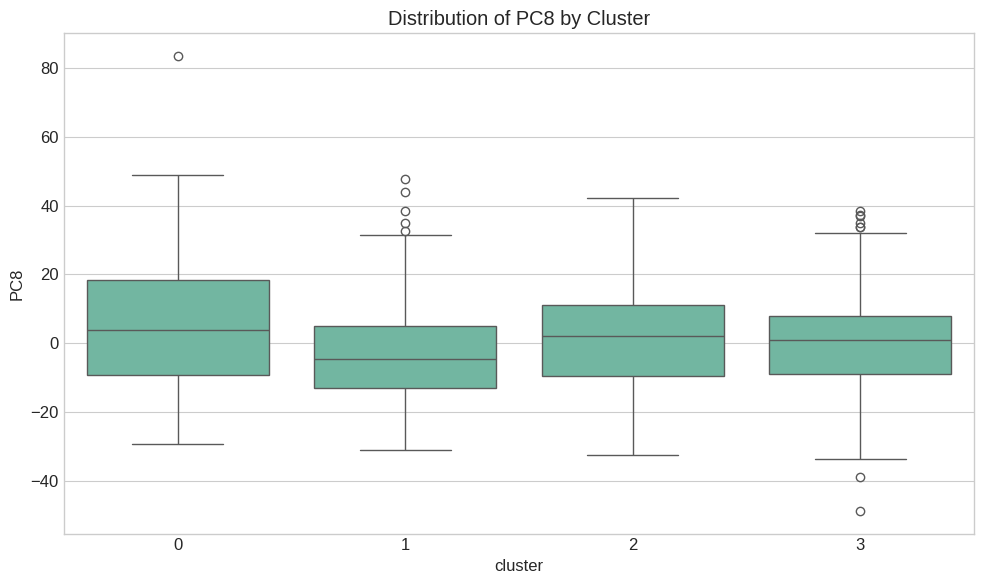

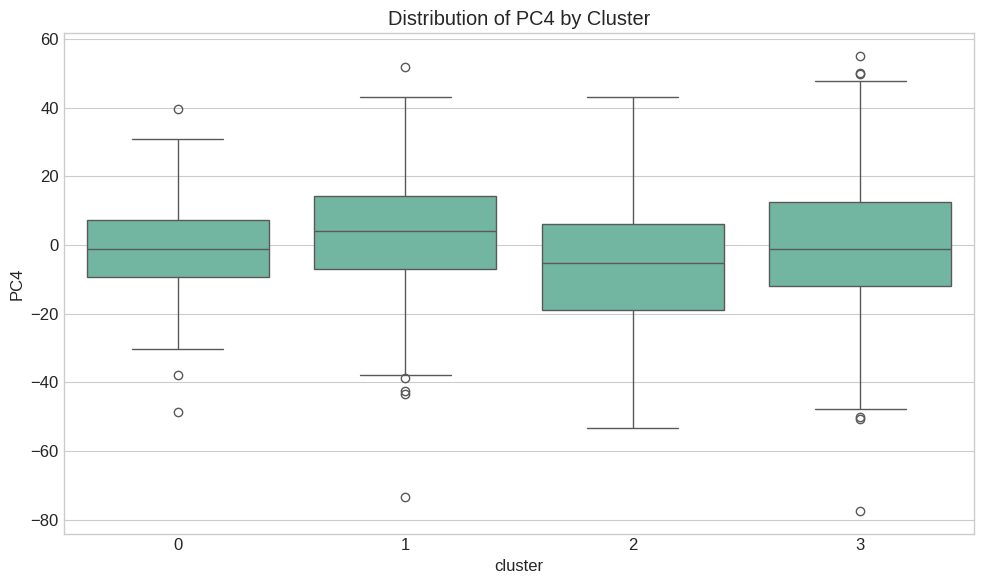

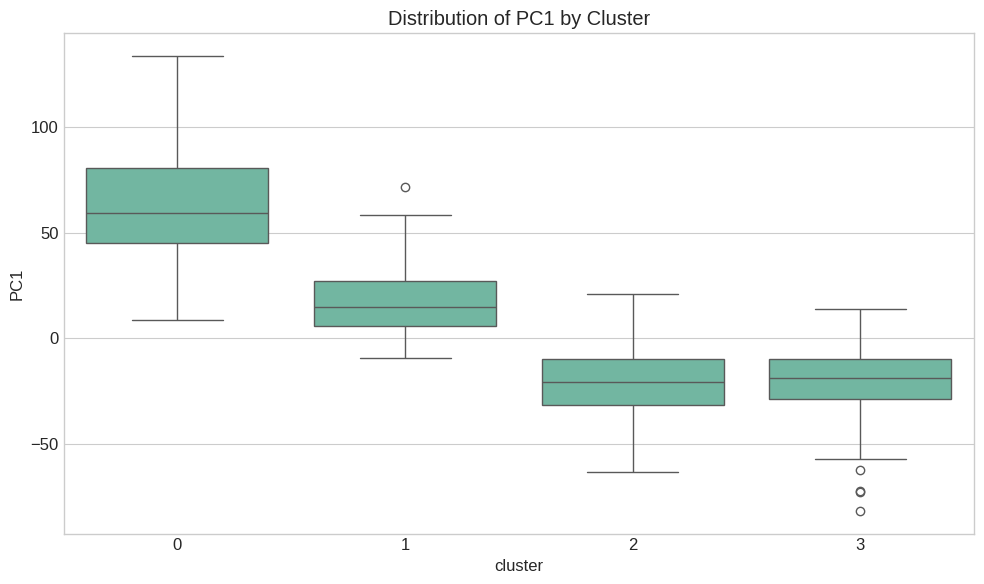

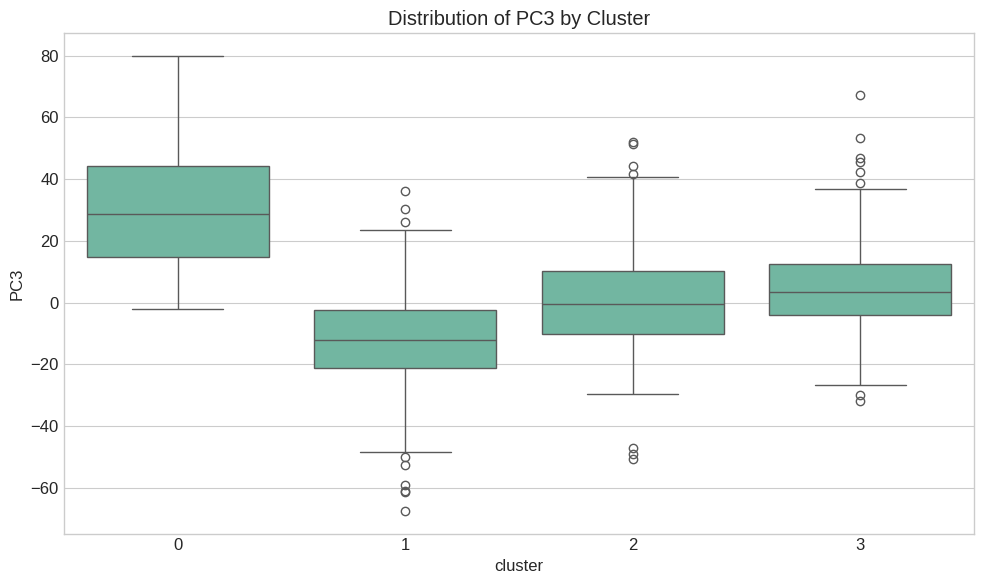

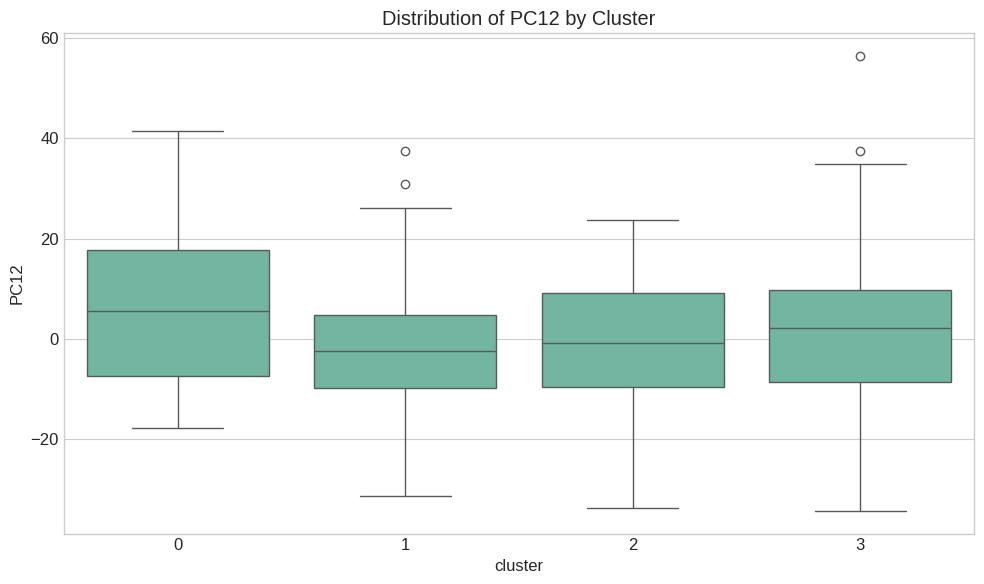


=== Cluster Narrative Summaries ===

Cluster 0 (67 samples, 8.4% of data):
Distinguished by: PC2 (higher), PC4, PC1 (higher), PC3 (higher), PC6 (lower)
ADHD distribution: 0: 17.9%, 1: 82.1%
Sex distribution: 0.0% female

Cluster 1 (291 samples, 36.5% of data):
Distinguished by: PC2, PC4 (higher), PC1 (higher), PC3 (lower), PC8 (lower)
ADHD distribution: 0: 26.8%, 1: 73.2%
Sex distribution: 0.0% female

Cluster 2 (114 samples, 14.3% of data):
Distinguished by: PC2 (higher), PC4 (lower), PC3, PC1 (lower), PC6 (higher)
ADHD distribution: 0: 35.1%, 1: 64.9%
Sex distribution: 0.0% female

Cluster 3 (325 samples, 40.8% of data):
Distinguished by: PC2 (lower), PC4, PC1 (lower), PC3 (higher), PC6 (lower)
ADHD distribution: 0: 26.5%, 1: 73.5%
Sex distribution: 0.0% female

=== Interpretation in Original Feature Space ===

Representative samples for Cluster 0:
Subject IDs: ['lgIc57sAqLTP' 'tYLjXtSTzh7s' 'T4CaImRntWnB' 'l9qN2z7fmuNR'
 'Wg8uWfarMR8q']

Mean values for key continuous features:
  E

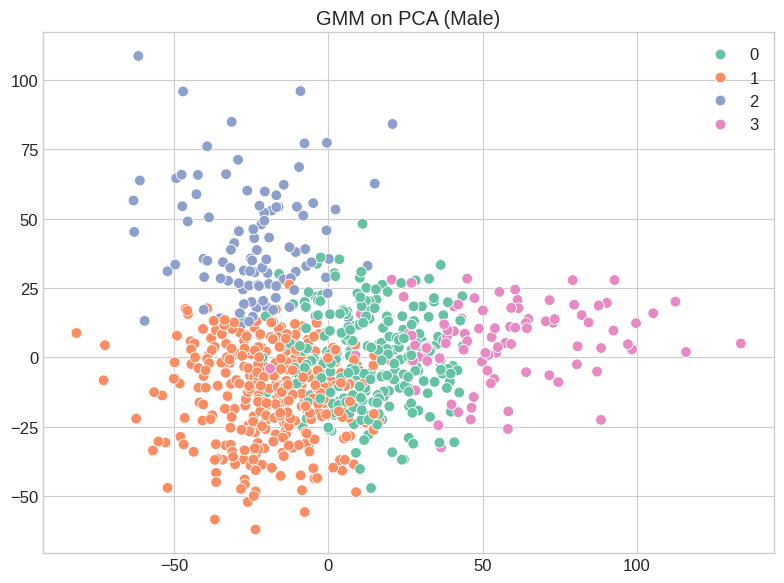

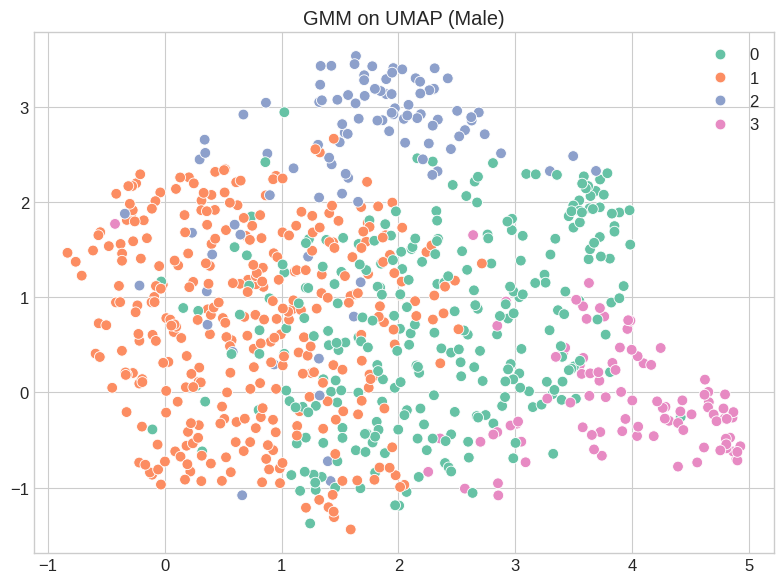

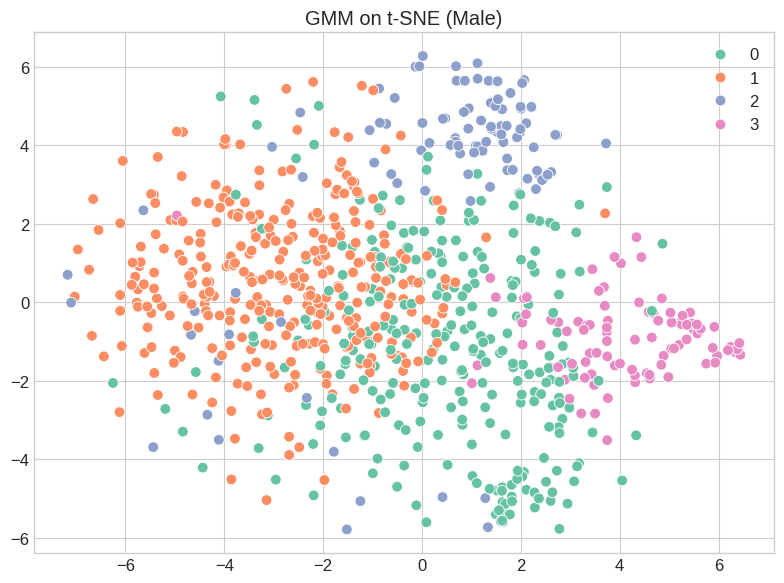

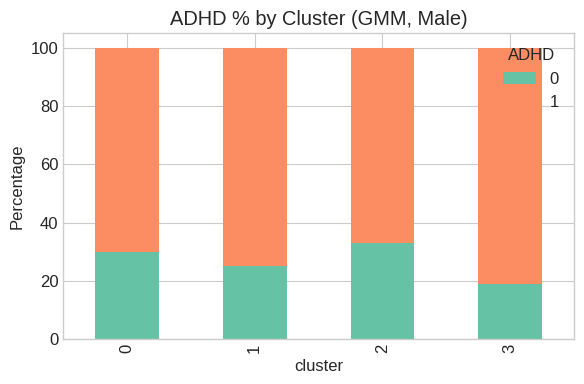


=== Detailed Cluster Analysis for GMM (Male) ===
=== Statistical Profiles of Clusters ===

Cluster 0: 276 samples (34.6%)

Cluster 1: 326 samples (40.9%)

Cluster 2: 100 samples (12.5%)

Cluster 3: 95 samples (11.9%)

=== SHAP-based Feature Importance ===


<Figure size 1200x800 with 0 Axes>

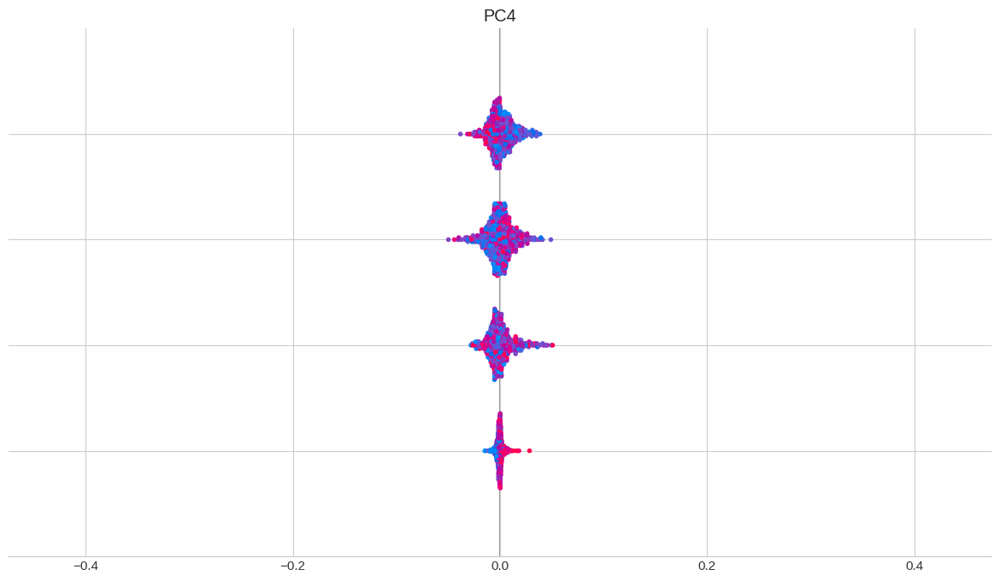


Top discriminating features for Cluster 0:
  - PC1: 0.0125
  - PC2: 0.0102
  - PC4: 0.0054
  - PC3: 0.0029

Top discriminating features for Cluster 1:
  - PC1: 0.0130
  - PC2: 0.0105
  - PC4: 0.0060
  - PC3: 0.0029

Top discriminating features for Cluster 2:
  - PC1: 0.0102
  - PC2: 0.0090
  - PC3: 0.0041
  - PC4: 0.0030

Top discriminating features for Cluster 3:
  - PC4: 0.0132
  - PC1: 0.0120
  - PC2: 0.0084
  - PC3: 0.0038

=== ADHD Outcome Distribution by Cluster ===
ADHD_Outcome          0          1
cluster                           
0             30.072464  69.927536
1             25.153374  74.846626
2             33.000000  67.000000
3             18.947368  81.052632

Chi-square test for ADHD distribution: chi2=6.82, p=0.0779

=== Sex Distribution by Cluster ===
Percentage female by cluster:
cluster
0    0.0
1    0.0
2    0.0
3    0.0
Name: Sex_F, dtype: float64

=== Key Feature Distributions by Cluster ===


<Figure size 1200x600 with 0 Axes>

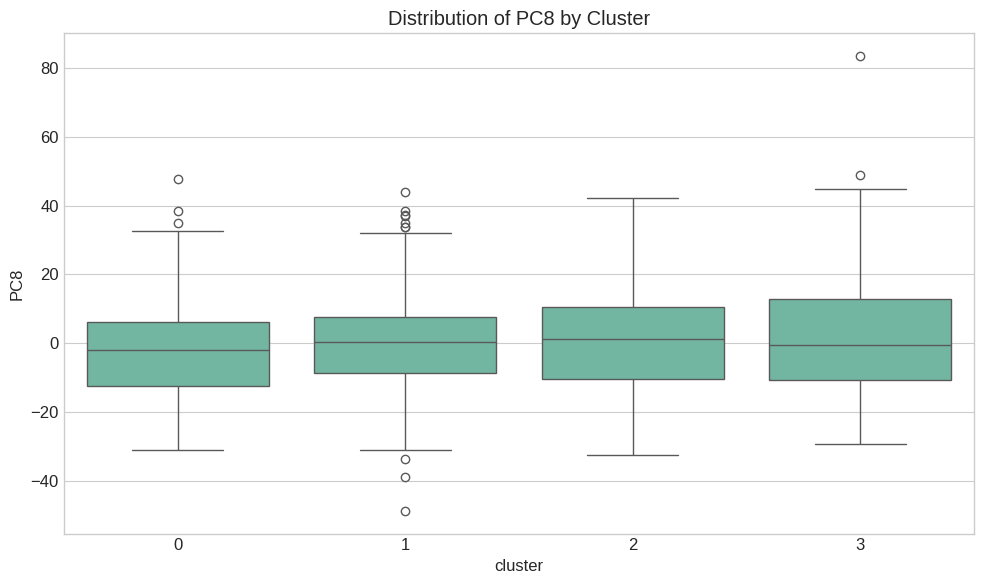

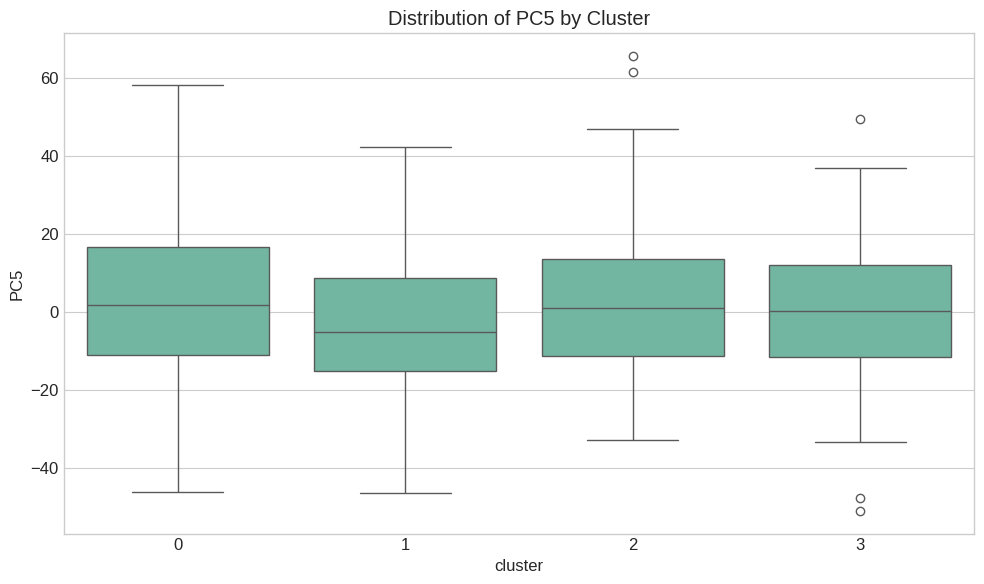

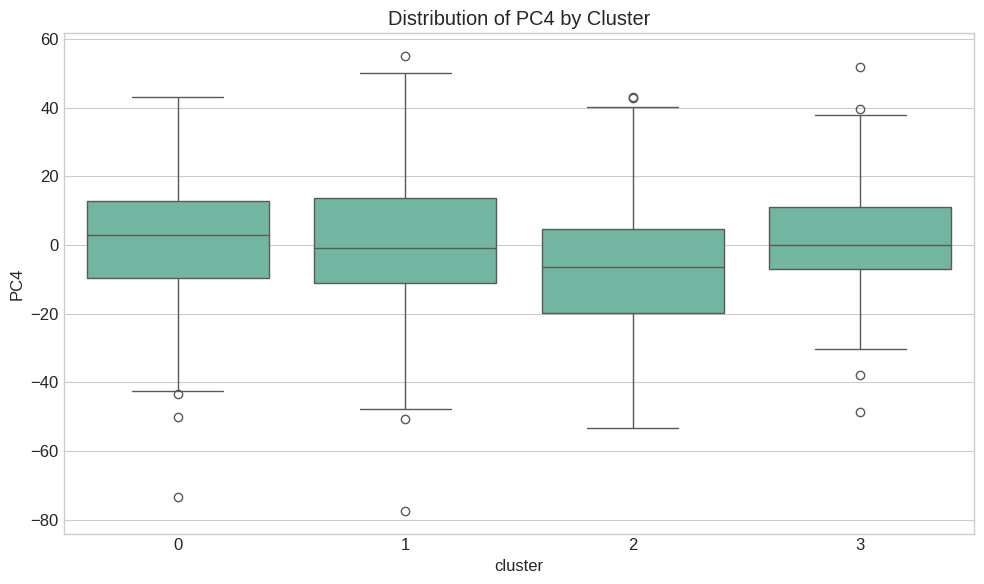

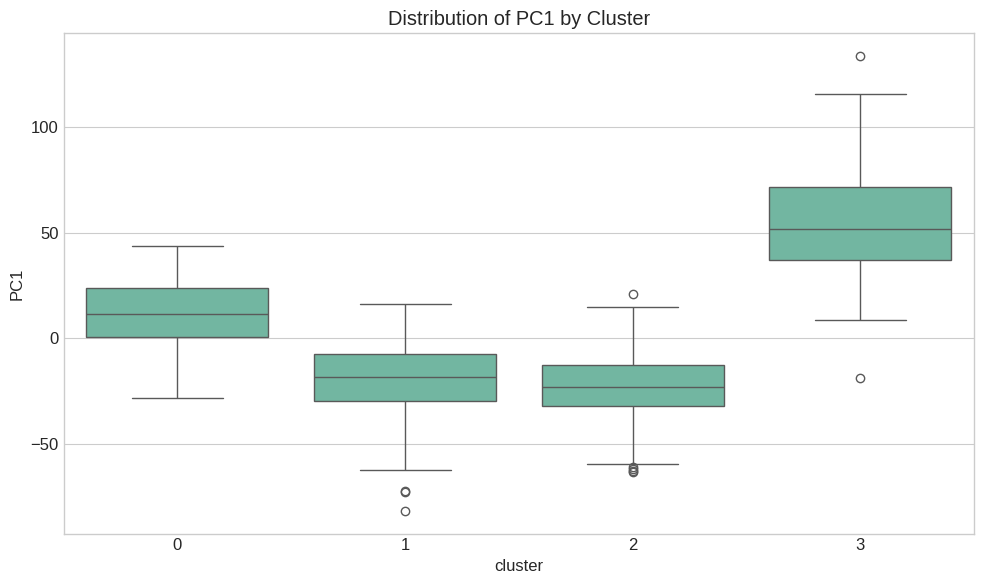

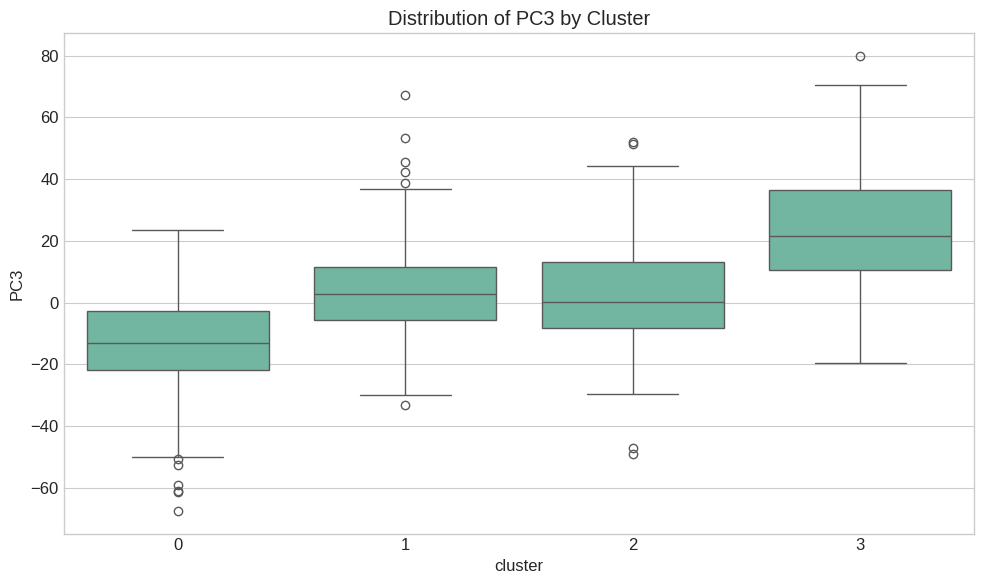


=== Cluster Narrative Summaries ===

Cluster 0 (276 samples, 34.6% of data):
Distinguished by: PC1 (higher), PC2, PC4, PC3 (lower), PC5 (higher)
ADHD distribution: 0: 30.1%, 1: 69.9%
Sex distribution: 0.0% female

Cluster 1 (326 samples, 40.9% of data):
Distinguished by: PC1 (lower), PC2 (lower), PC4, PC3 (higher), PC5 (lower)
ADHD distribution: 0: 25.2%, 1: 74.8%
Sex distribution: 0.0% female

Cluster 2 (100 samples, 12.5% of data):
Distinguished by: PC1 (lower), PC2 (higher), PC3, PC4 (lower), PC6 (higher)
ADHD distribution: 0: 33.0%, 1: 67.0%
Sex distribution: 0.0% female

Cluster 3 (95 samples, 11.9% of data):
Distinguished by: PC4, PC1 (higher), PC2 (higher), PC3 (higher), PC6 (lower)
ADHD distribution: 0: 18.9%, 1: 81.1%
Sex distribution: 0.0% female

=== Interpretation in Original Feature Space ===

Representative samples for Cluster 0:
Subject IDs: ['oM6q8ZwYF4Hv' 'fxW28SwnU34E' 'UxzkcTTukkSI' 'dV3APoDHAwWf'
 'WEnkO4VdipnB']

Mean values for key continuous features:
  EHQ_EHQ_

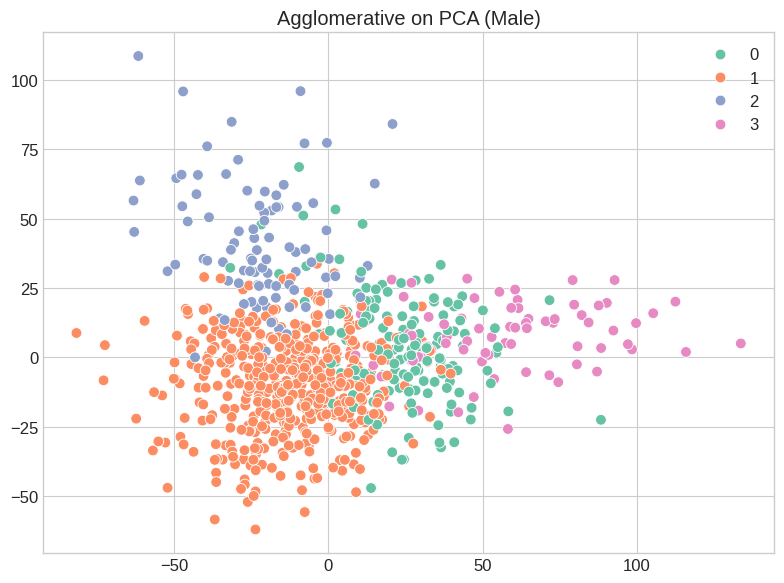

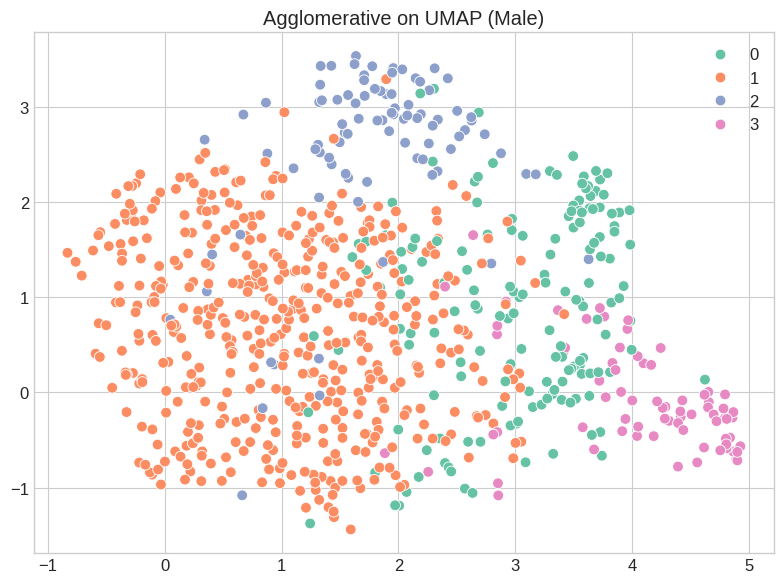

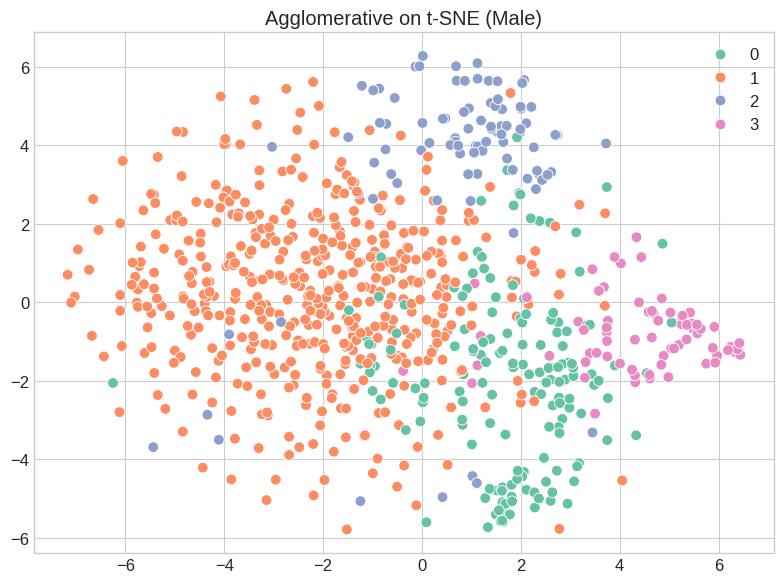

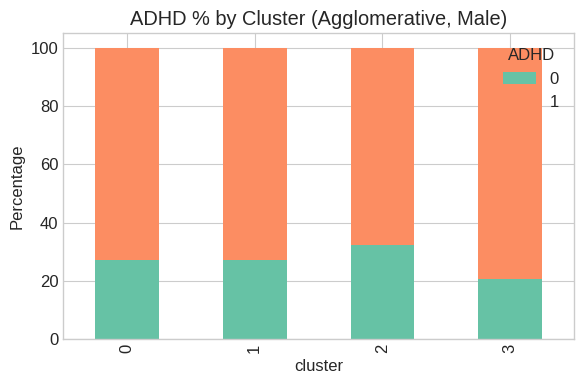


=== Detailed Cluster Analysis for Agglomerative (Male) ===
=== Statistical Profiles of Clusters ===

Cluster 0: 158 samples (19.8%)

Cluster 1: 476 samples (59.7%)

Cluster 2: 90 samples (11.3%)

Cluster 3: 73 samples (9.2%)

=== SHAP-based Feature Importance ===


<Figure size 1200x800 with 0 Axes>

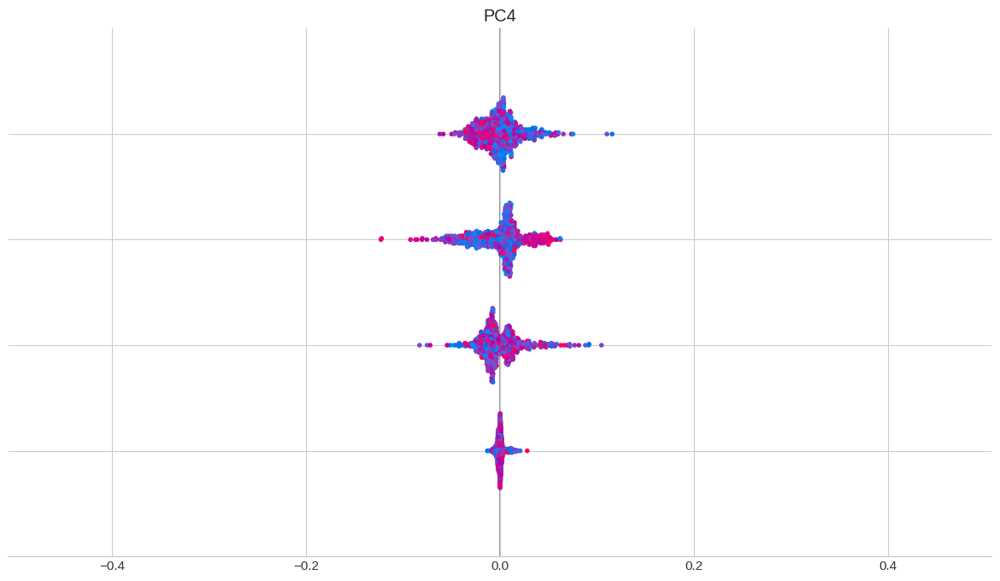


Top discriminating features for Cluster 0:
  - PC1: 0.0145
  - PC2: 0.0127
  - PC4: 0.0055
  - PC3: 0.0027

Top discriminating features for Cluster 1:
  - PC4: 0.0134
  - PC2: 0.0132
  - PC1: 0.0111
  - PC3: 0.0026

Top discriminating features for Cluster 2:
  - PC2: 0.0093
  - PC1: 0.0057
  - PC3: 0.0033
  - PC4: 0.0026

Top discriminating features for Cluster 3:
  - PC2: 0.0117
  - PC1: 0.0093
  - PC4: 0.0082
  - PC3: 0.0032

=== ADHD Outcome Distribution by Cluster ===
ADHD_Outcome          0          1
cluster                           
0             27.215190  72.784810
1             27.100840  72.899160
2             32.222222  67.777778
3             20.547945  79.452055

Chi-square test for ADHD distribution: chi2=2.78, p=0.4264

=== Sex Distribution by Cluster ===
Percentage female by cluster:
cluster
0    0.0
1    0.0
2    0.0
3    0.0
Name: Sex_F, dtype: float64

=== Key Feature Distributions by Cluster ===


<Figure size 1200x600 with 0 Axes>

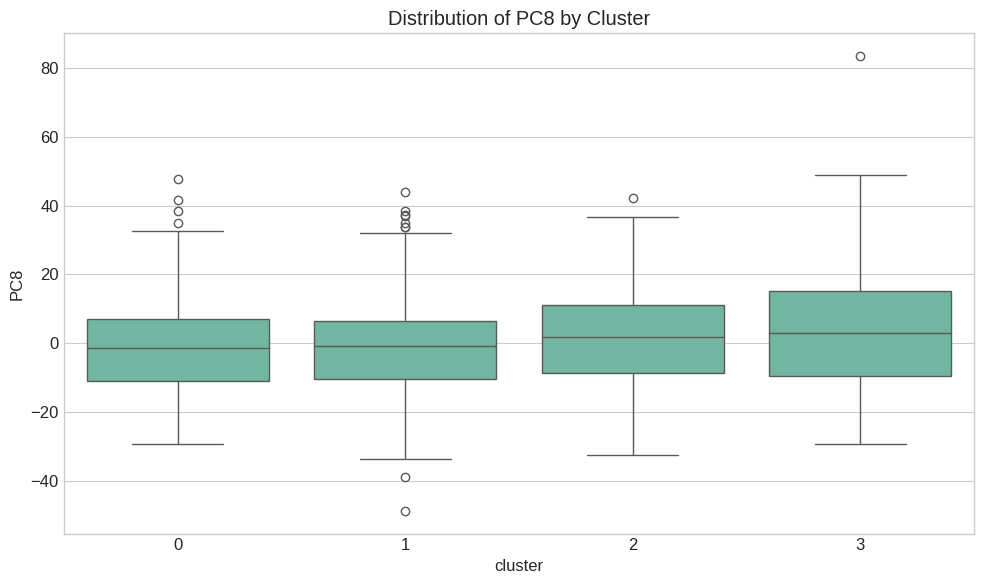

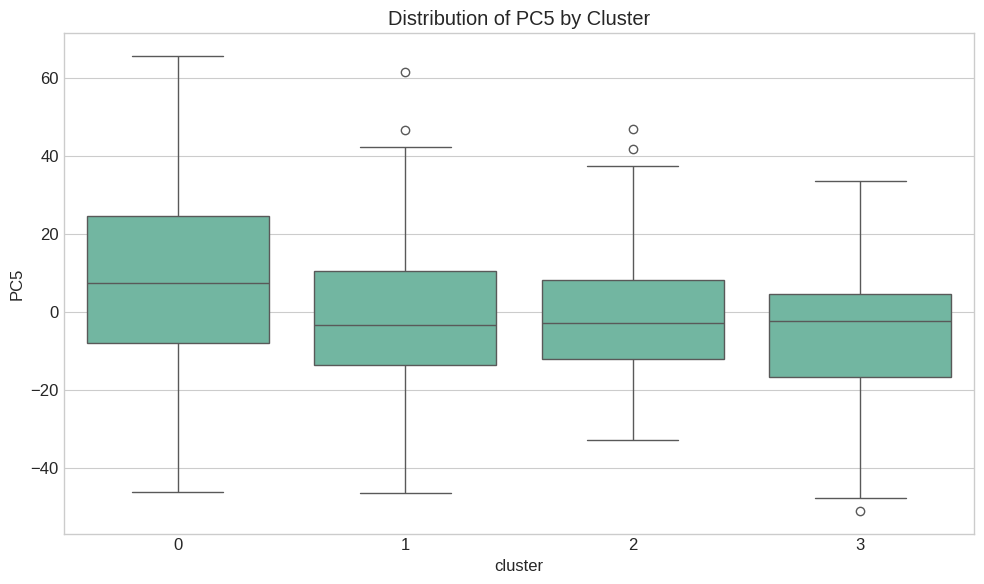

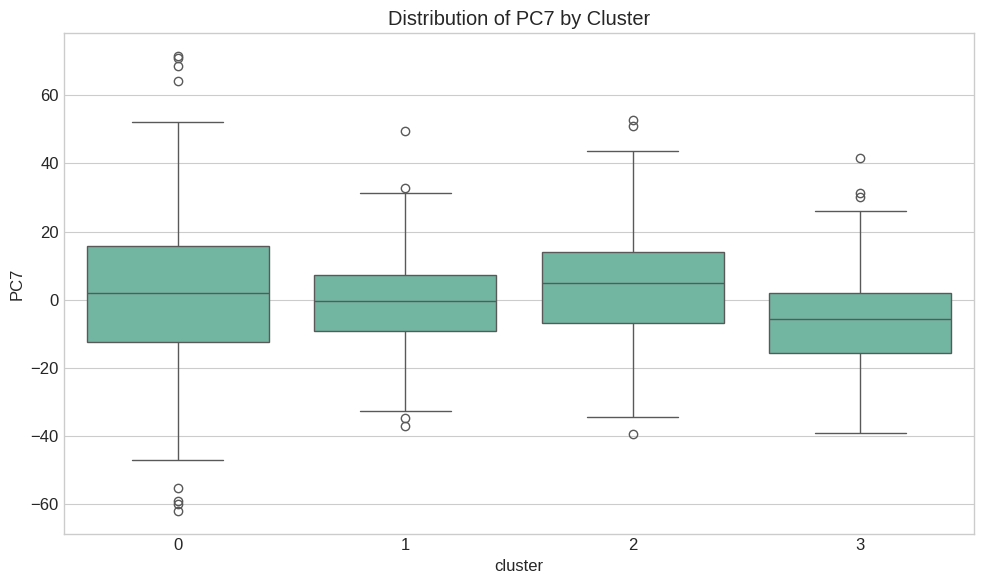

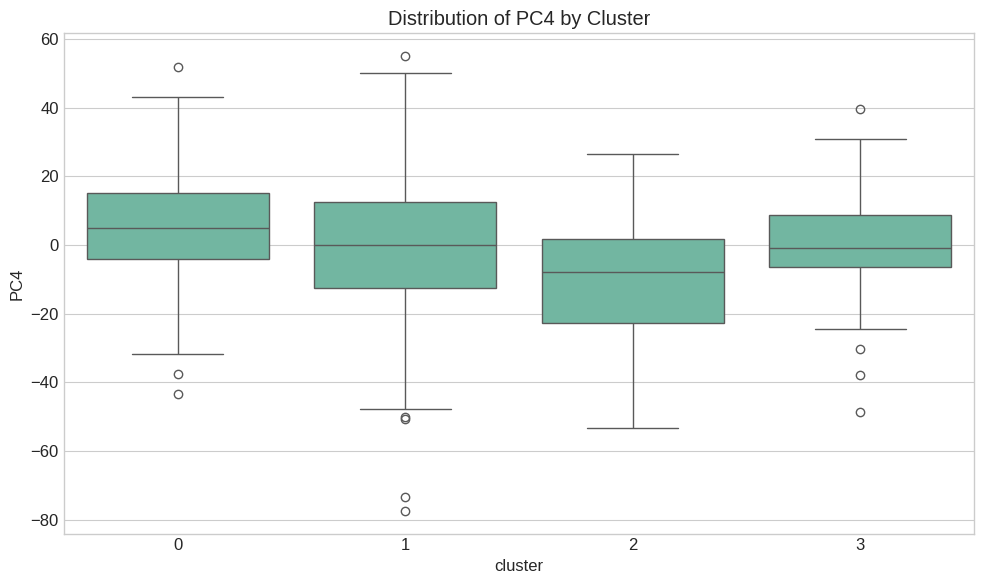

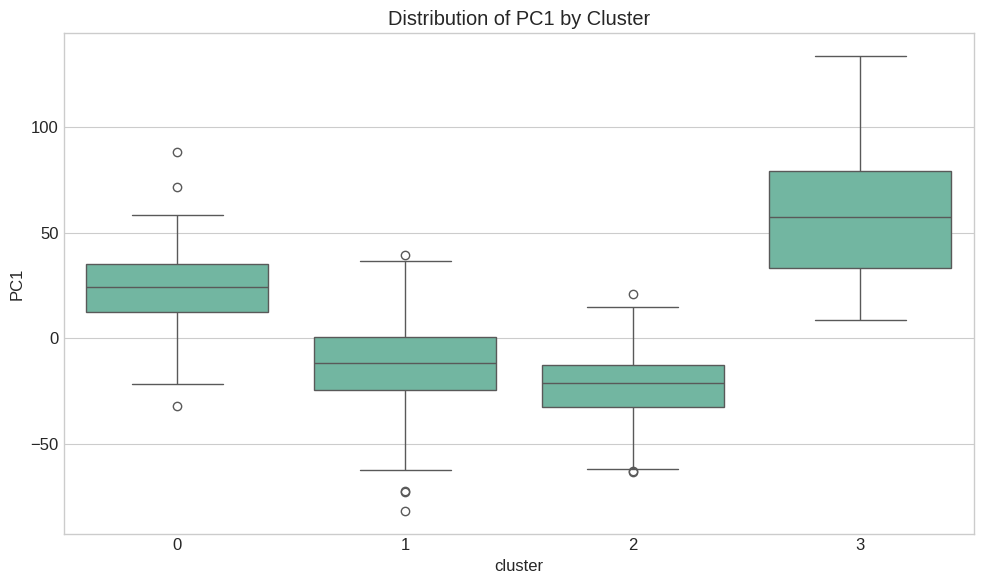


=== Cluster Narrative Summaries ===

Cluster 0 (158 samples, 19.8% of data):
Distinguished by: PC1 (higher), PC2, PC4 (higher), PC3 (lower), PC5 (higher)
ADHD distribution: 0: 27.2%, 1: 72.8%
Sex distribution: 0.0% female

Cluster 1 (476 samples, 59.7% of data):
Distinguished by: PC4, PC2 (lower), PC1 (lower), PC3
ADHD distribution: 0: 27.1%, 1: 72.9%
Sex distribution: 0.0% female

Cluster 2 (90 samples, 11.3% of data):
Distinguished by: PC2 (higher), PC1 (lower), PC3, PC4 (lower), PC6 (higher)
ADHD distribution: 0: 32.2%, 1: 67.8%
Sex distribution: 0.0% female

Cluster 3 (73 samples, 9.2% of data):
Distinguished by: PC2 (higher), PC1 (higher), PC4, PC3 (higher), PC5 (lower)
ADHD distribution: 0: 20.5%, 1: 79.5%
Sex distribution: 0.0% female

=== Interpretation in Original Feature Space ===

Representative samples for Cluster 0:
Subject IDs: ['UxzkcTTukkSI' 'PYWvAQ6NAbeU' 'W348GZELW1P8' 'ZJWMGY93fLcC'
 '5D934HaQKbxA']

Mean values for key continuous features:
  EHQ_EHQ_Total: 52.00 (o

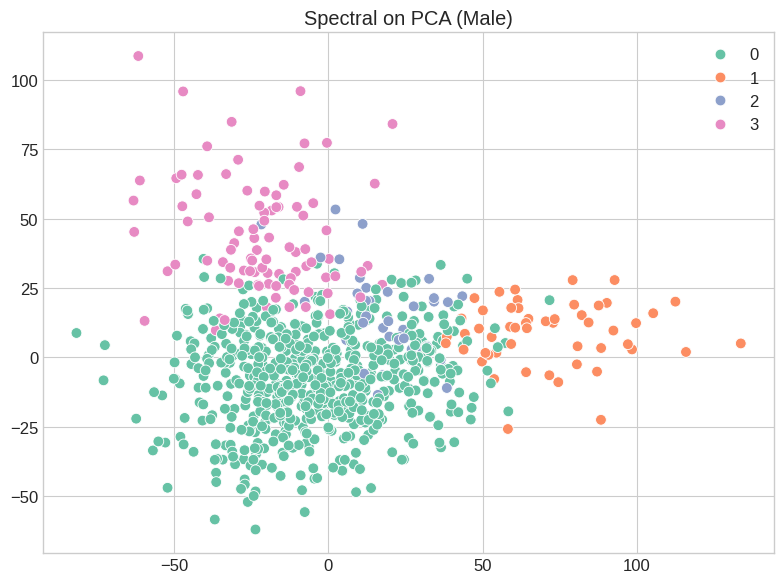

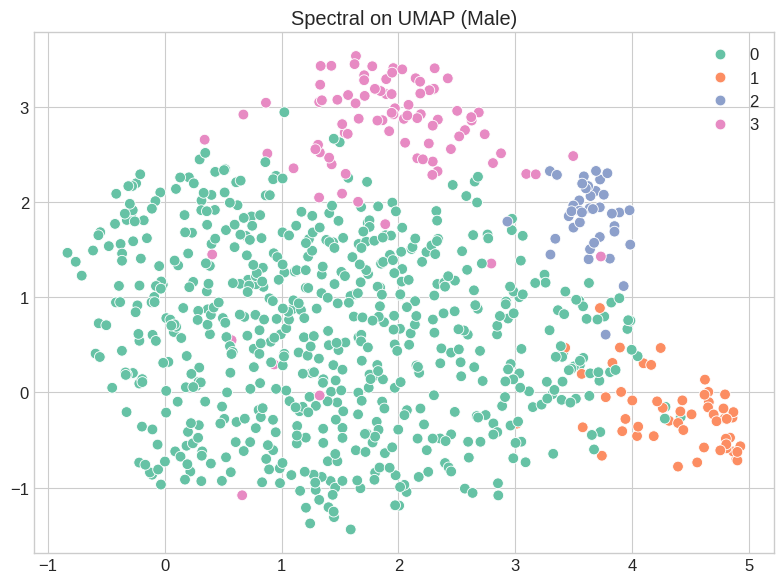

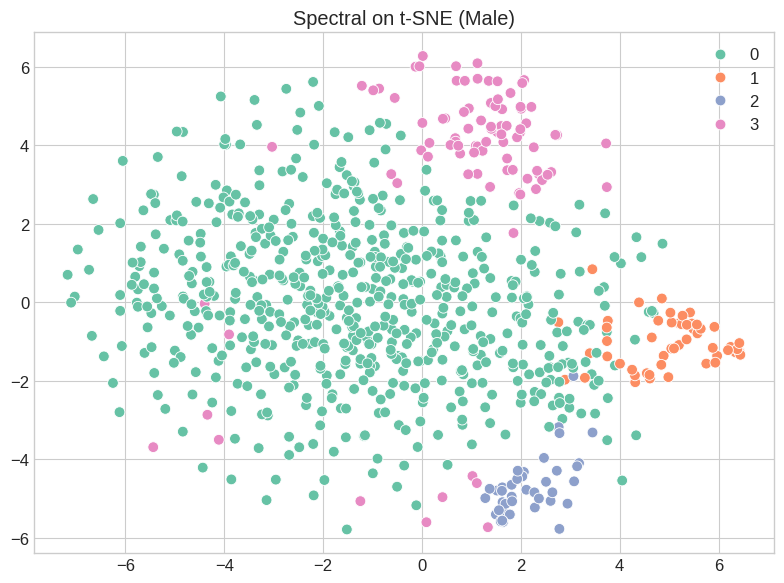

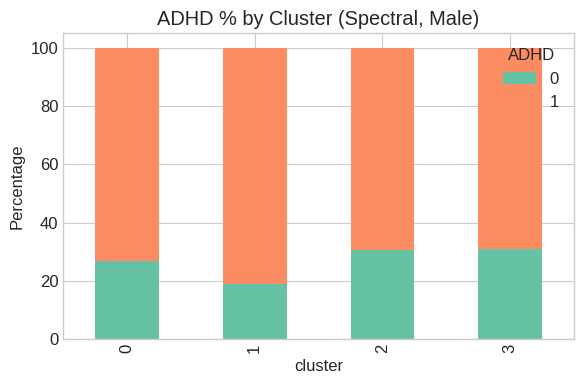


=== Detailed Cluster Analysis for Spectral (Male) ===
=== Statistical Profiles of Clusters ===

Cluster 0: 615 samples (77.2%)

Cluster 1: 53 samples (6.6%)

Cluster 2: 39 samples (4.9%)

Cluster 3: 90 samples (11.3%)

=== SHAP-based Feature Importance ===


<Figure size 1200x800 with 0 Axes>

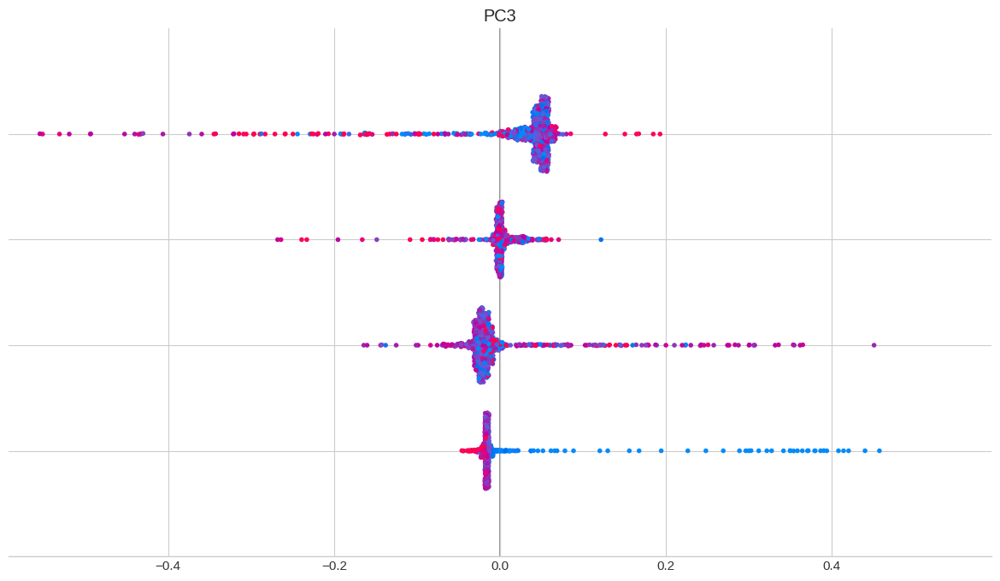


Top discriminating features for Cluster 0:
  - PC1: 0.0047
  - PC4: 0.0024
  - PC2: 0.0016
  - PC3: 0.0014

Top discriminating features for Cluster 1:
  - PC1: 0.0049
  - PC4: 0.0025
  - PC3: 0.0016
  - PC2: 0.0014

Top discriminating features for Cluster 2:
  - PC1: 0.0067
  - PC4: 0.0038
  - PC2: 0.0021
  - PC3: 0.0018

Top discriminating features for Cluster 3:
  - PC1: 0.0066
  - PC4: 0.0033
  - PC2: 0.0033
  - PC3: 0.0015

=== ADHD Outcome Distribution by Cluster ===
ADHD_Outcome          0          1
cluster                           
0             26.991870  73.008130
1             18.867925  81.132075
2             30.769231  69.230769
3             31.111111  68.888889

Chi-square test for ADHD distribution: chi2=2.82, p=0.4202

=== Sex Distribution by Cluster ===
Percentage female by cluster:
cluster
0    0.0
1    0.0
2    0.0
3    0.0
Name: Sex_F, dtype: float64

=== Key Feature Distributions by Cluster ===


<Figure size 1200x600 with 0 Axes>

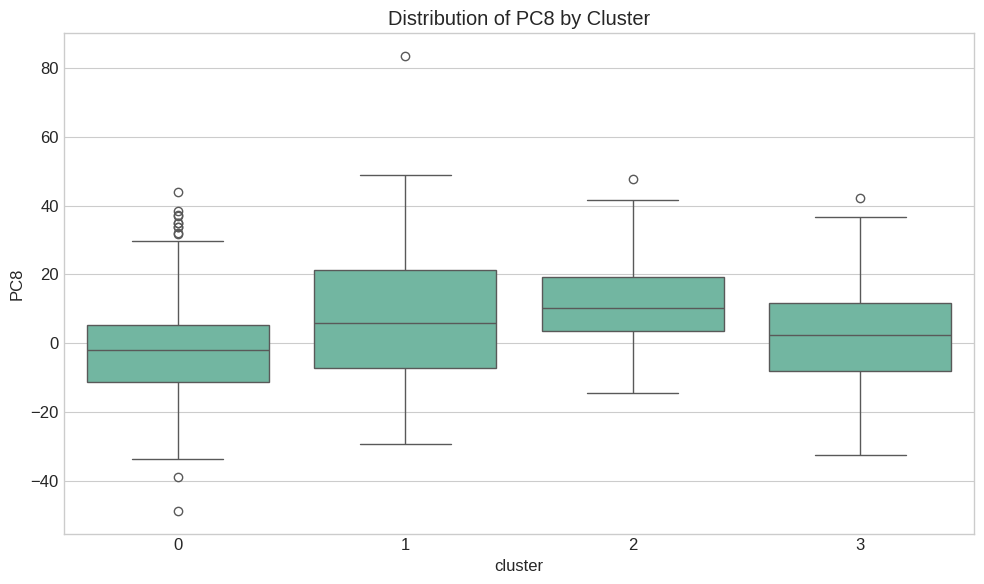

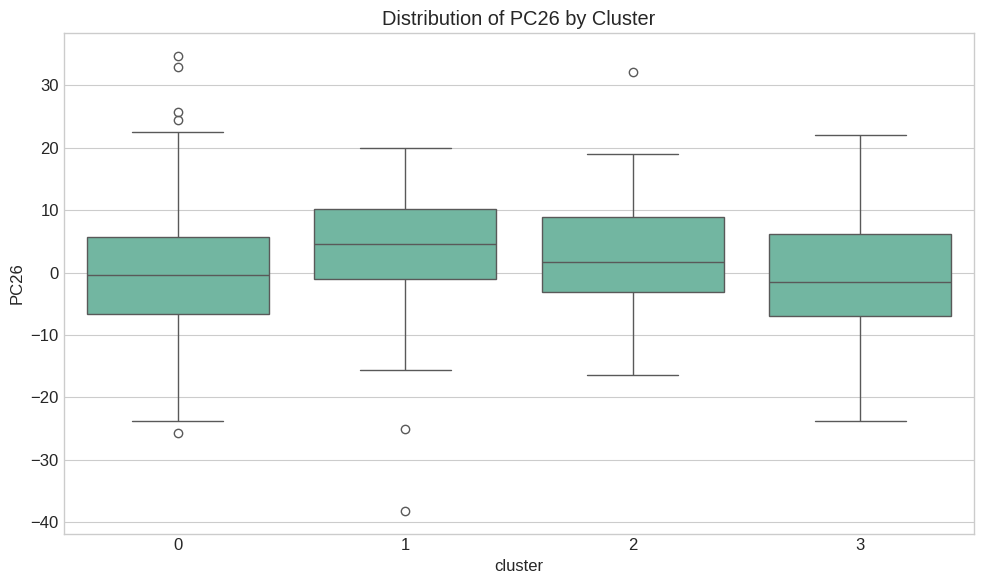

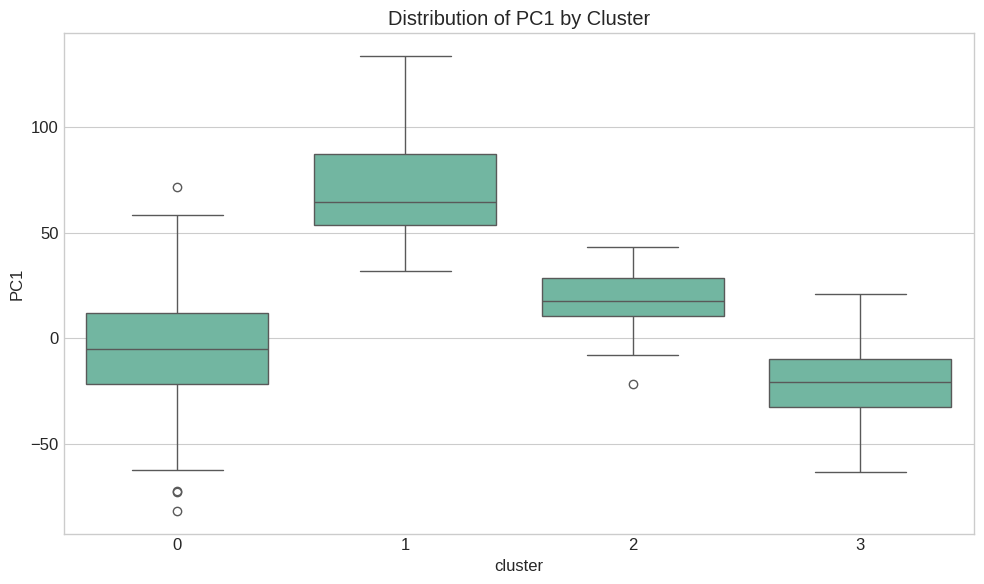

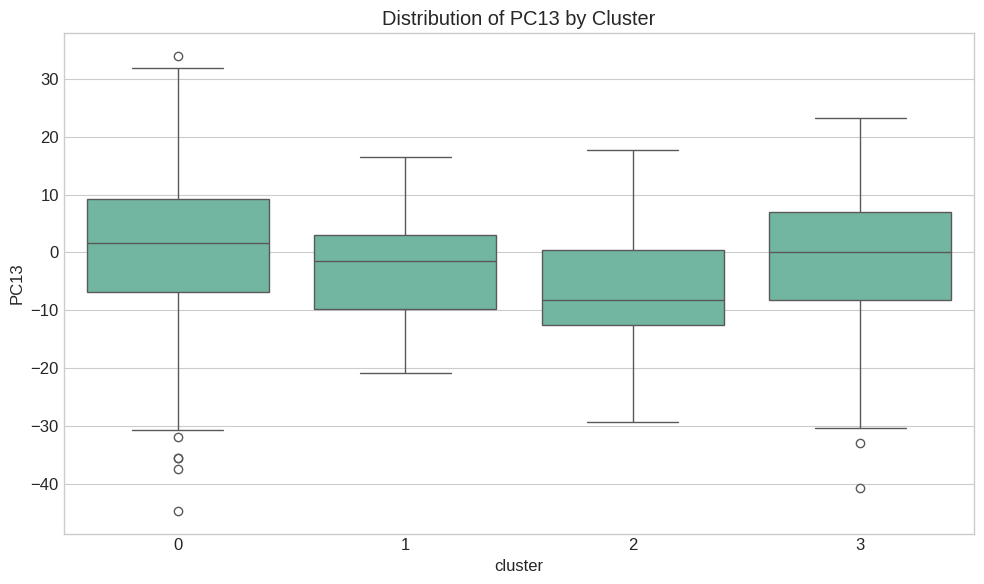

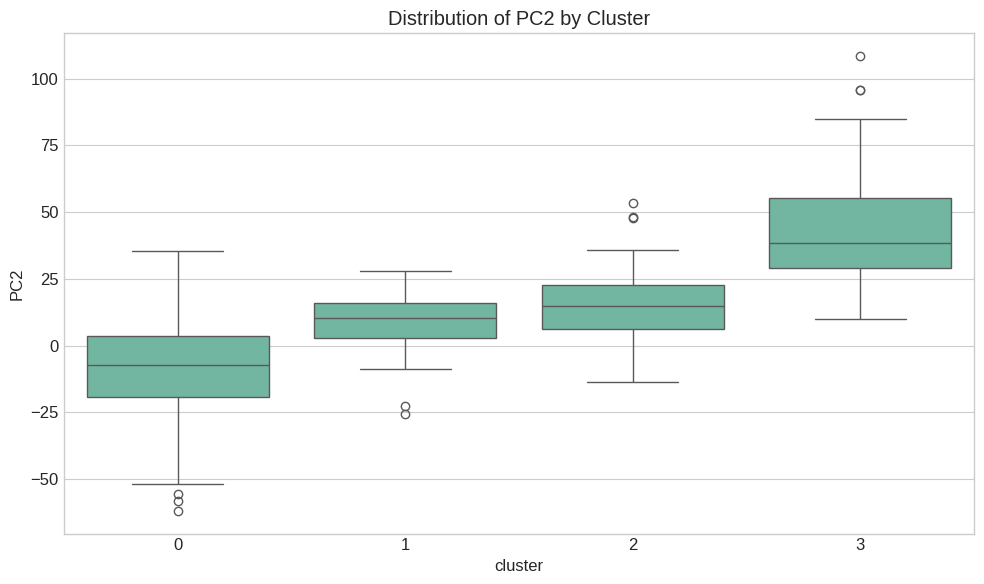


=== Cluster Narrative Summaries ===

Cluster 0 (615 samples, 77.2% of data):
Distinguished by: PC1 (lower), PC4, PC2 (lower), PC3, PC8 (lower)
ADHD distribution: 0: 27.0%, 1: 73.0%
Sex distribution: 0.0% female

Cluster 1 (53 samples, 6.6% of data):
Distinguished by: PC1 (higher), PC4, PC3 (higher), PC2 (higher), PC6 (lower)
ADHD distribution: 0: 18.9%, 1: 81.1%
Sex distribution: 0.0% female

Cluster 2 (39 samples, 4.9% of data):
Distinguished by: PC1 (higher), PC4 (higher), PC2 (higher), PC3 (lower), PC5 (higher)
ADHD distribution: 0: 30.8%, 1: 69.2%
Sex distribution: 0.0% female

Cluster 3 (90 samples, 11.3% of data):
Distinguished by: PC1 (lower), PC4 (lower), PC2 (higher), PC3, PC6 (higher)
ADHD distribution: 0: 31.1%, 1: 68.9%
Sex distribution: 0.0% female

=== Interpretation in Original Feature Space ===

Representative samples for Cluster 0:
Subject IDs: ['fxW28SwnU34E' 'oM6q8ZwYF4Hv' 'TExdbXbj29qJ' '3ccP8yu5w5Yo'
 'yPqk7RmP36lu']

Mean values for key continuous features:
  EHQ

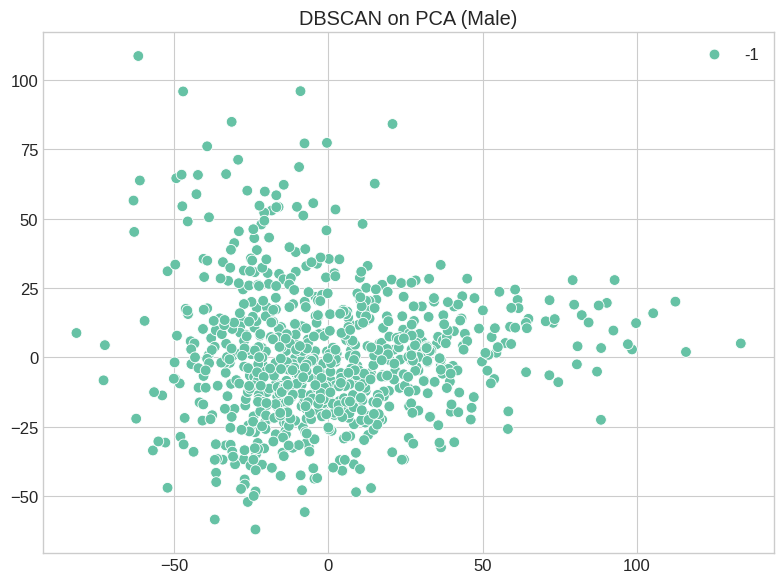

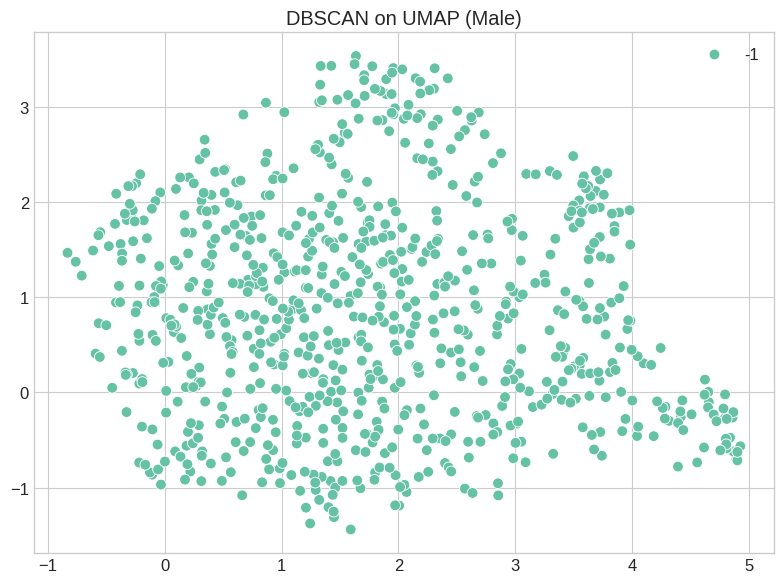

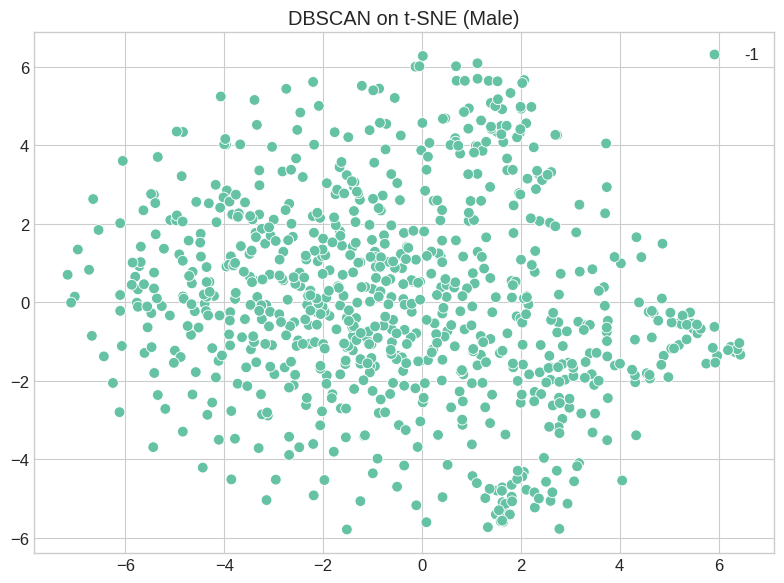

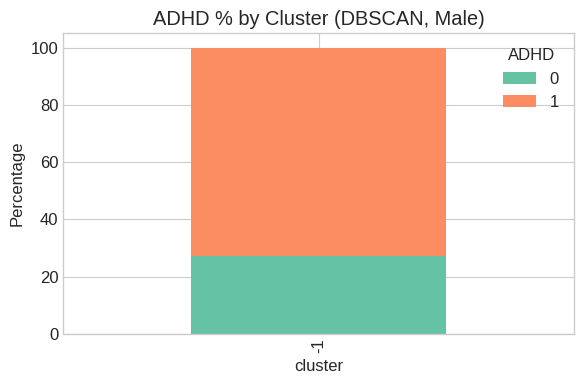


=== Detailed Cluster Analysis for DBSCAN (Male) ===
=== Statistical Profiles of Clusters ===

=== ADHD Outcome Distribution by Cluster ===
ADHD_Outcome          0          1
cluster                           
-1            27.101631  72.898369

Chi-square test for ADHD distribution: chi2=0.00, p=1.0000

=== Sex Distribution by Cluster ===
Percentage female by cluster:
cluster
-1    0.0
Name: Sex_F, dtype: float64

=== Cluster Narrative Summaries ===

=== Cohort: Female (n=416) ===
-> PCA variance retained: 43.51%

--- Algorithm: KMeans ---
KMeans: silhouette=0.045, ARI=0.736, clusters=[(np.int32(0), np.int64(28)), (np.int32(1), np.int64(146)), (np.int32(2), np.int64(89)), (np.int32(3), np.int64(153))]


<Figure size 1200x600 with 0 Axes>

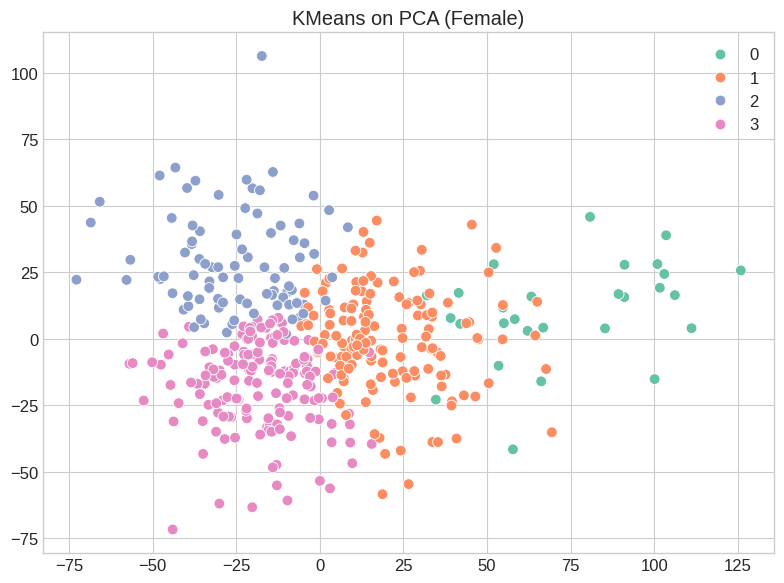

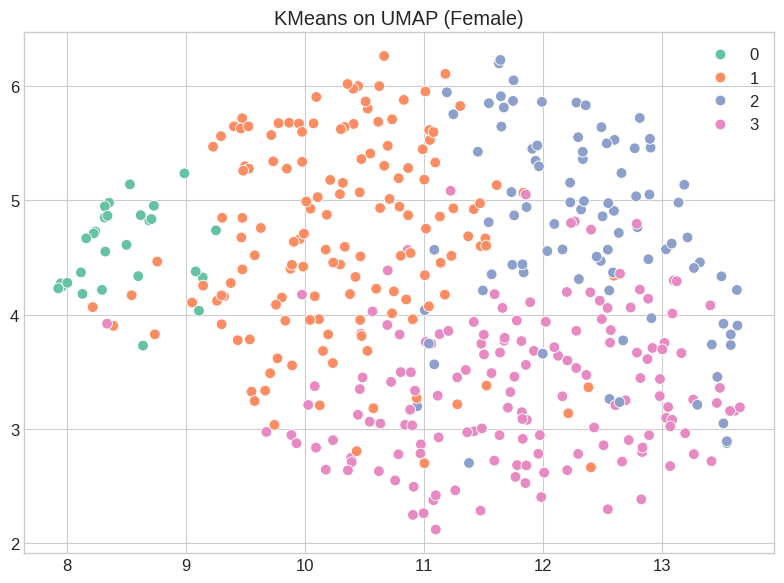

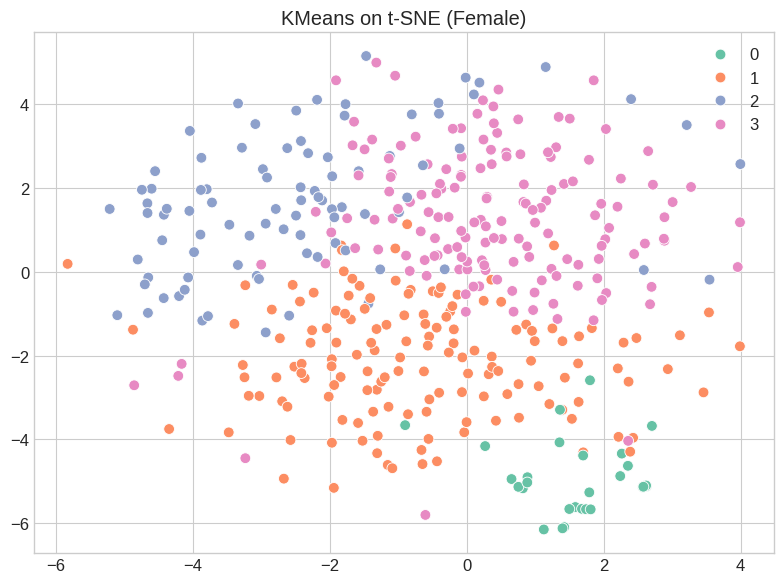

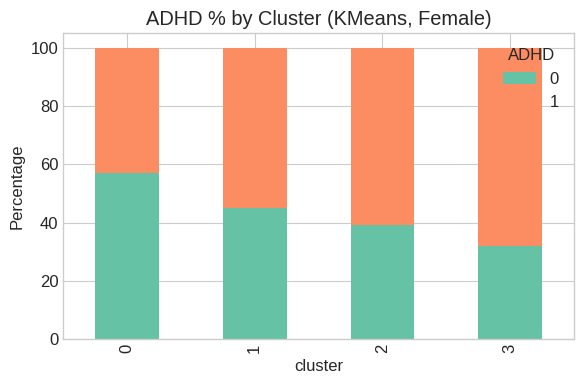


=== Detailed Cluster Analysis for KMeans (Female) ===
=== Statistical Profiles of Clusters ===

Cluster 0: 28 samples (6.7%)

Cluster 1: 146 samples (35.1%)

Cluster 2: 89 samples (21.4%)

Cluster 3: 153 samples (36.8%)

=== SHAP-based Feature Importance ===


<Figure size 1200x800 with 0 Axes>

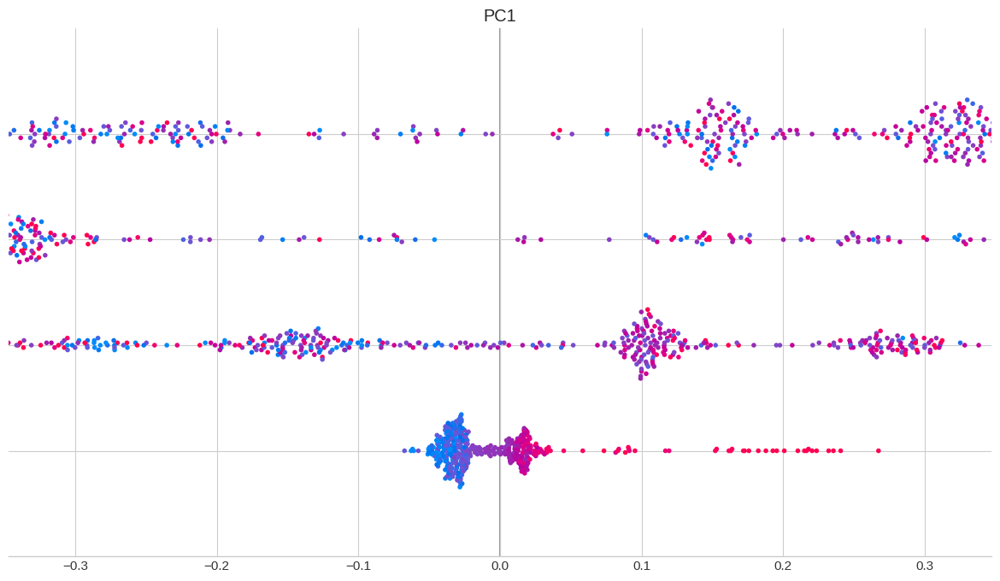


Top discriminating features for Cluster 0:
  - PC2: 0.0117
  - PC4: 0.0077
  - PC3: 0.0047
  - PC1: 0.0025

Top discriminating features for Cluster 1:
  - PC4: 0.0126
  - PC2: 0.0080
  - PC3: 0.0067
  - PC1: 0.0020

Top discriminating features for Cluster 2:
  - PC2: 0.0126
  - PC1: 0.0123
  - PC3: 0.0092
  - PC4: 0.0081

Top discriminating features for Cluster 3:
  - PC2: 0.0117
  - PC4: 0.0101
  - PC3: 0.0059
  - PC1: 0.0030

=== ADHD Outcome Distribution by Cluster ===
ADHD_Outcome          0          1
cluster                           
0             57.142857  42.857143
1             45.205479  54.794521
2             39.325843  60.674157
3             32.026144  67.973856

Chi-square test for ADHD distribution: chi2=9.15, p=0.0273

=== Sex Distribution by Cluster ===
Percentage female by cluster:
cluster
0    100.0
1    100.0
2    100.0
3    100.0
Name: Sex_F, dtype: float64

=== Key Feature Distributions by Cluster ===


<Figure size 1200x600 with 0 Axes>

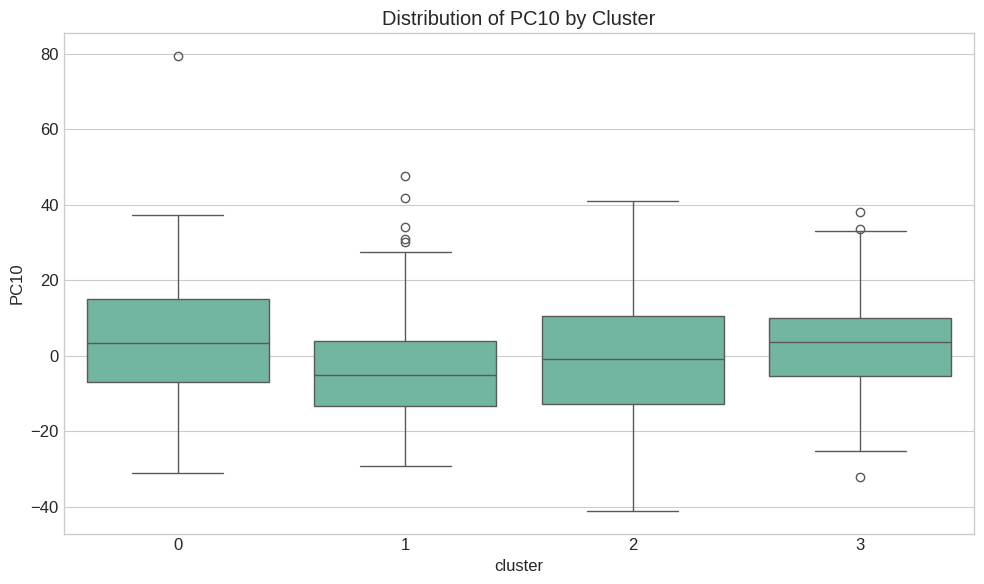

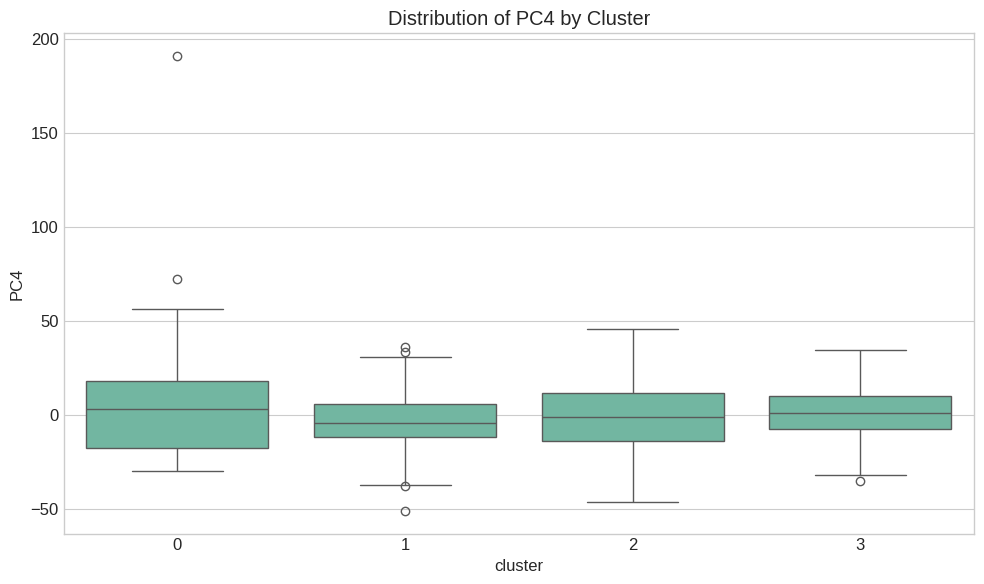

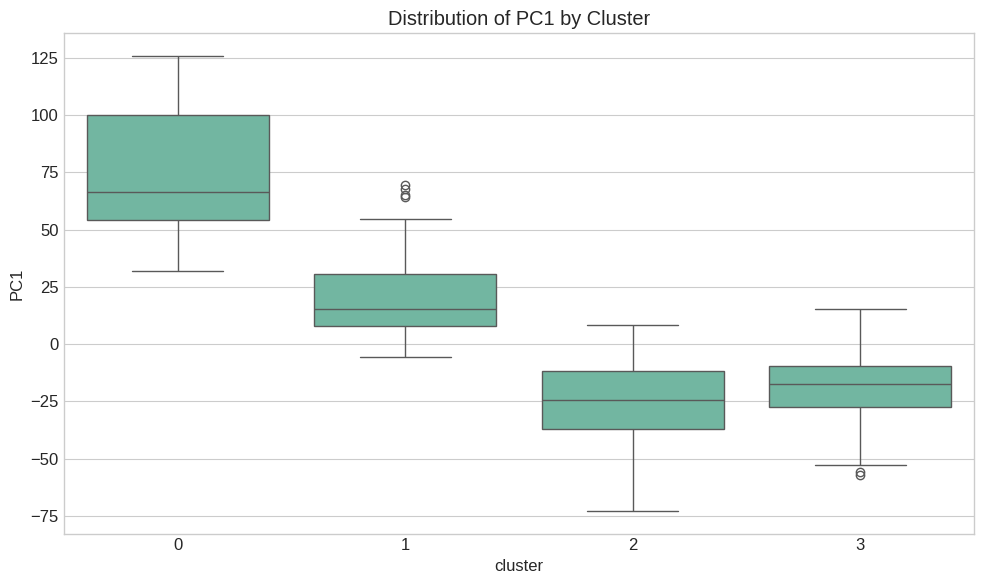

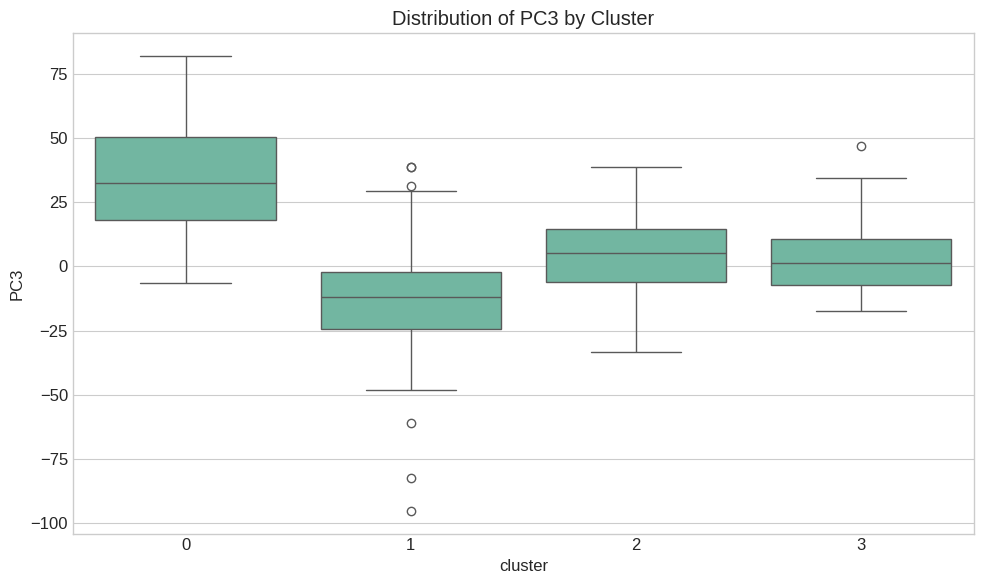

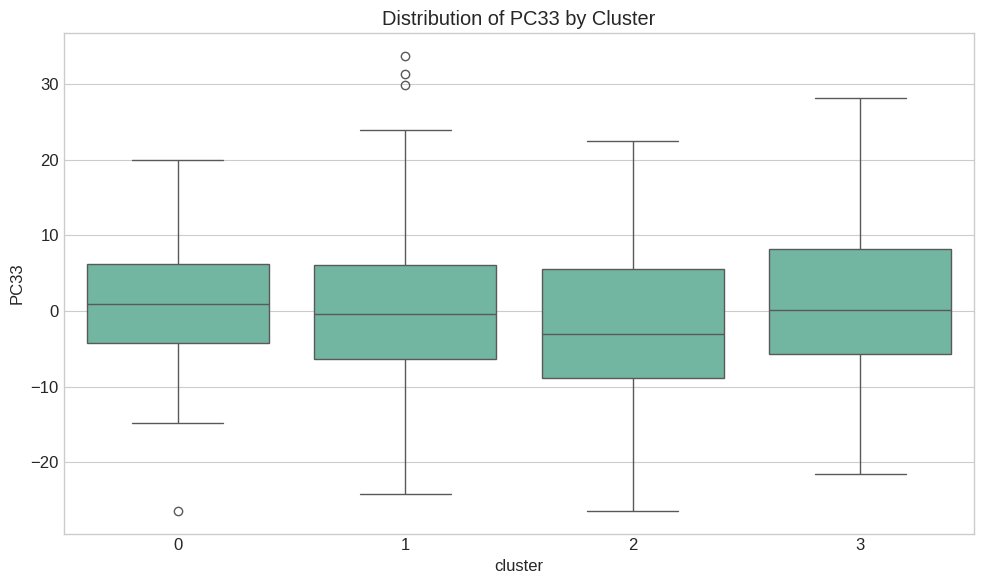


=== Cluster Narrative Summaries ===

Cluster 0 (28 samples, 6.7% of data):
Distinguished by: PC2 (higher), PC4, PC3 (higher), PC1 (higher)
ADHD distribution: 0: 57.1%, 1: 42.9%
Sex distribution: 100.0% female

Cluster 1 (146 samples, 35.1% of data):
Distinguished by: PC4 (lower), PC2, PC3 (lower), PC1 (higher), PC10 (lower)
ADHD distribution: 0: 45.2%, 1: 54.8%
Sex distribution: 100.0% female

Cluster 2 (89 samples, 21.4% of data):
Distinguished by: PC2 (higher), PC1 (lower), PC3 (higher), PC4, PC18 (higher)
ADHD distribution: 0: 39.3%, 1: 60.7%
Sex distribution: 100.0% female

Cluster 3 (153 samples, 36.8% of data):
Distinguished by: PC2 (lower), PC4, PC3 (higher), PC1 (lower), PC10 (higher)
ADHD distribution: 0: 32.0%, 1: 68.0%
Sex distribution: 100.0% female

=== Interpretation in Original Feature Space ===

Representative samples for Cluster 0:
Subject IDs: ['zwjJWCRzKhDz' '4SJ1OB710KjM' 'psUujiWvKE2O' 'yi9J1NNo3V6P'
 '19UWbNvLYCjm']

Mean values for key continuous features:
  EHQ

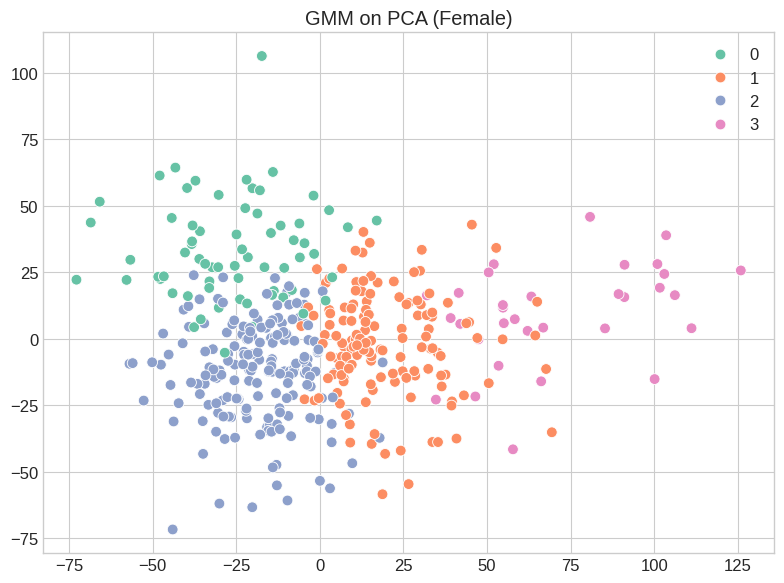

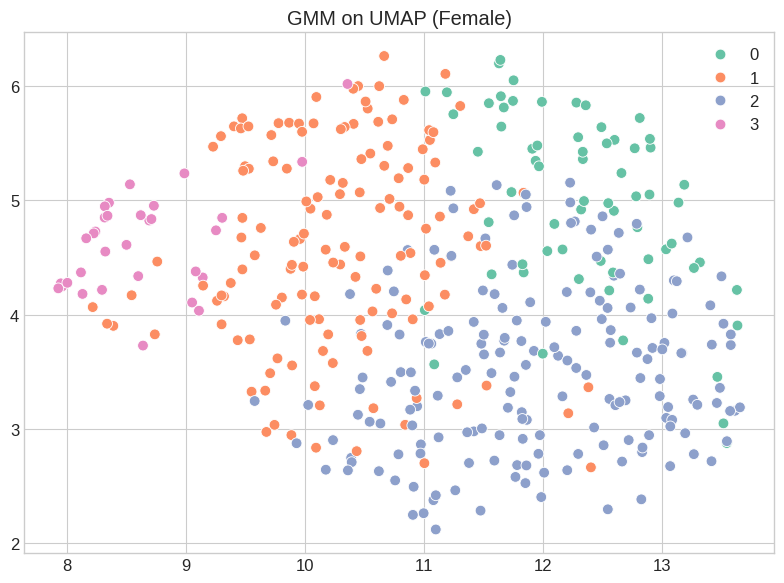

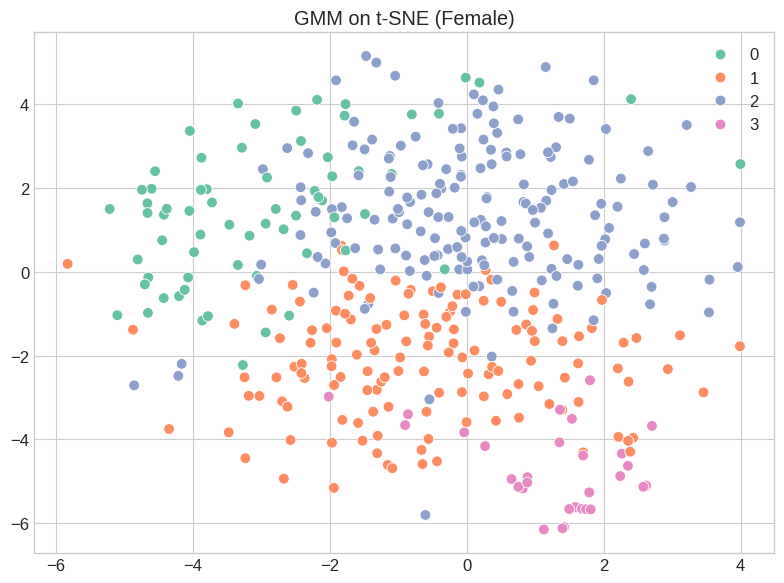

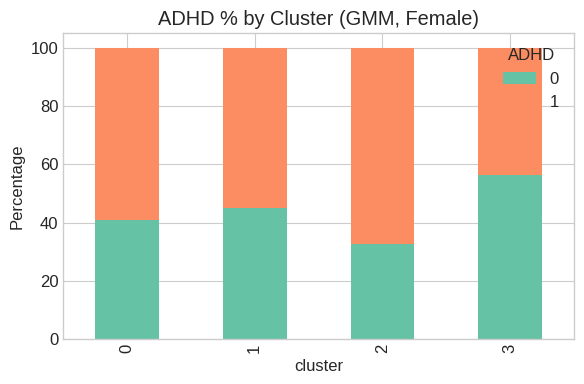


=== Detailed Cluster Analysis for GMM (Female) ===
=== Statistical Profiles of Clusters ===

Cluster 0: 66 samples (15.9%)

Cluster 1: 140 samples (33.7%)

Cluster 2: 178 samples (42.8%)

Cluster 3: 32 samples (7.7%)

=== SHAP-based Feature Importance ===


<Figure size 1200x800 with 0 Axes>

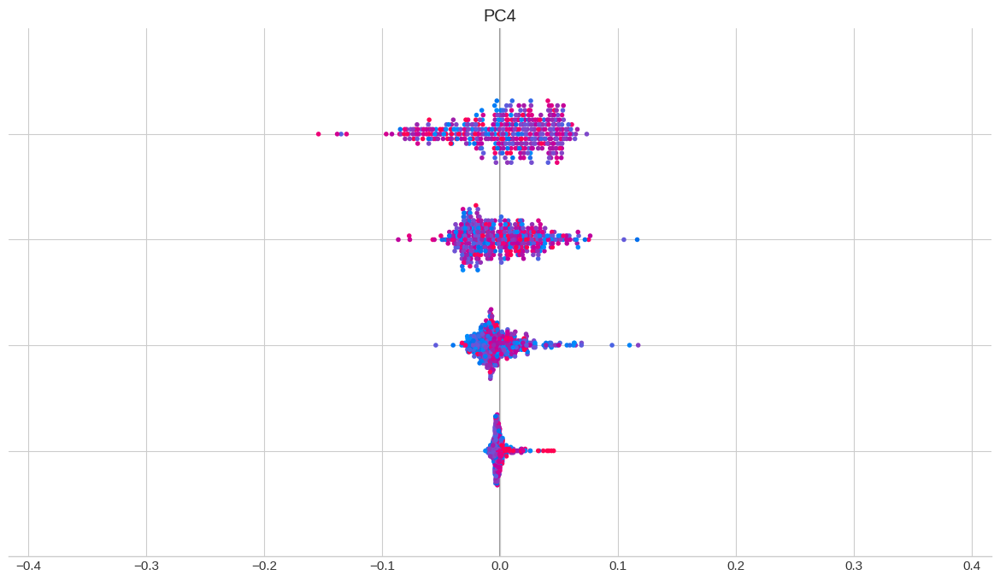


Top discriminating features for Cluster 0:
  - PC2: 0.0124
  - PC3: 0.0092
  - PC1: 0.0038
  - PC4: 0.0025

Top discriminating features for Cluster 1:
  - PC3: 0.0118
  - PC2: 0.0080
  - PC1: 0.0050
  - PC4: 0.0024

Top discriminating features for Cluster 2:
  - PC2: 0.0124
  - PC4: 0.0120
  - PC3: 0.0094
  - PC1: 0.0052

Top discriminating features for Cluster 3:
  - PC2: 0.0133
  - PC3: 0.0099
  - PC1: 0.0047
  - PC4: 0.0040

=== ADHD Outcome Distribution by Cluster ===
ADHD_Outcome          0          1
cluster                           
0             40.909091  59.090909
1             45.000000  55.000000
2             32.584270  67.415730
3             56.250000  43.750000

Chi-square test for ADHD distribution: chi2=9.09, p=0.0282

=== Sex Distribution by Cluster ===
Percentage female by cluster:
cluster
0    100.0
1    100.0
2    100.0
3    100.0
Name: Sex_F, dtype: float64

=== Key Feature Distributions by Cluster ===


<Figure size 1200x600 with 0 Axes>

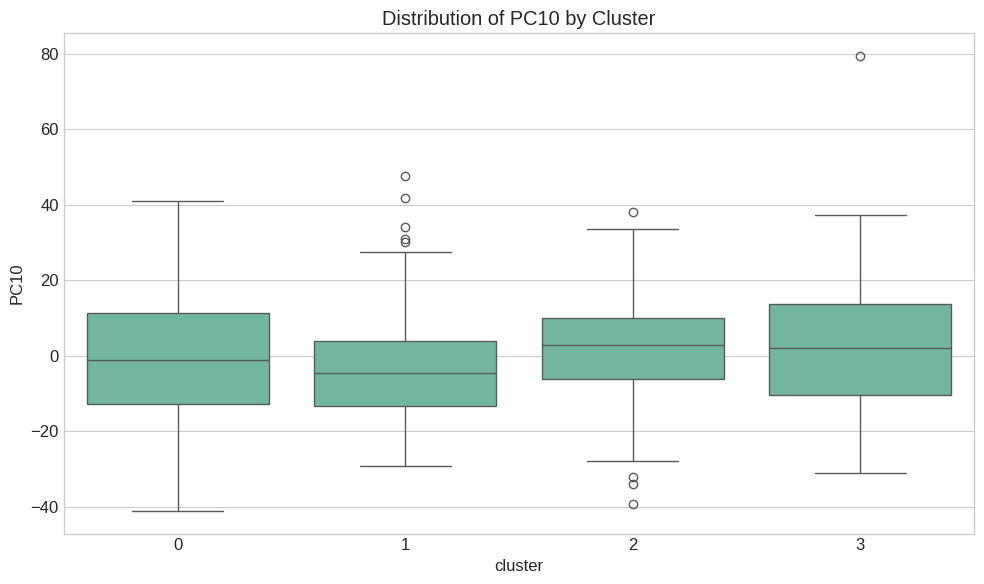

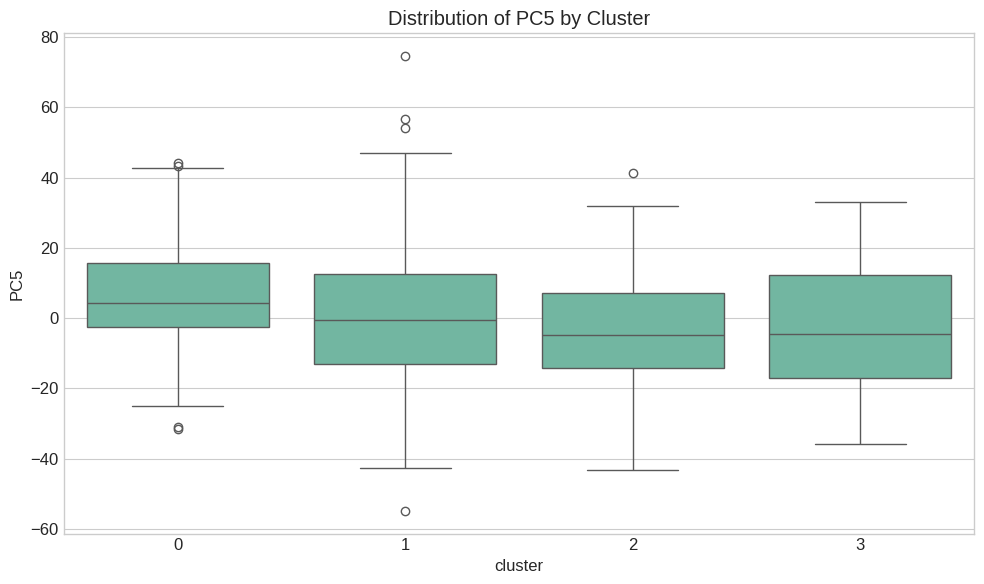

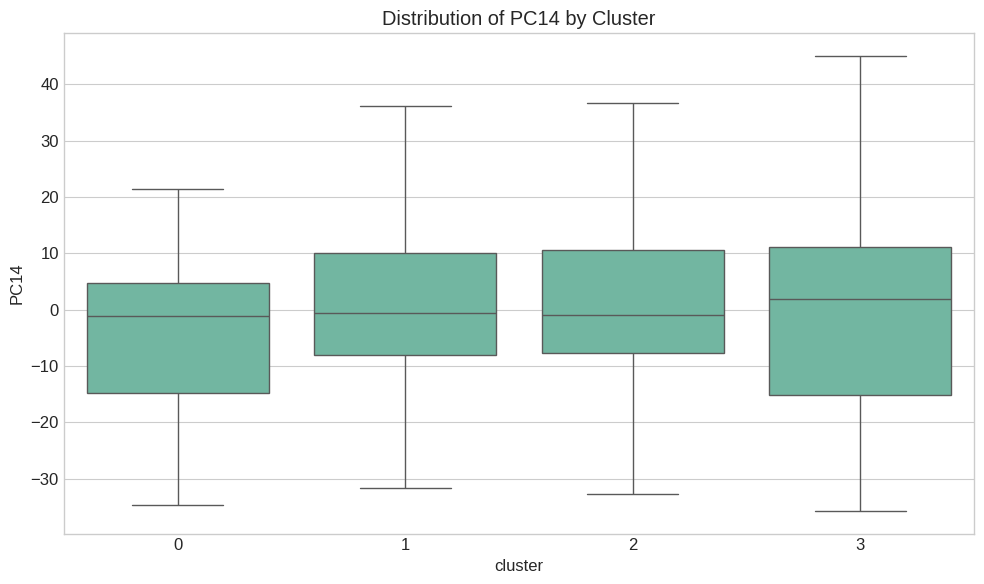

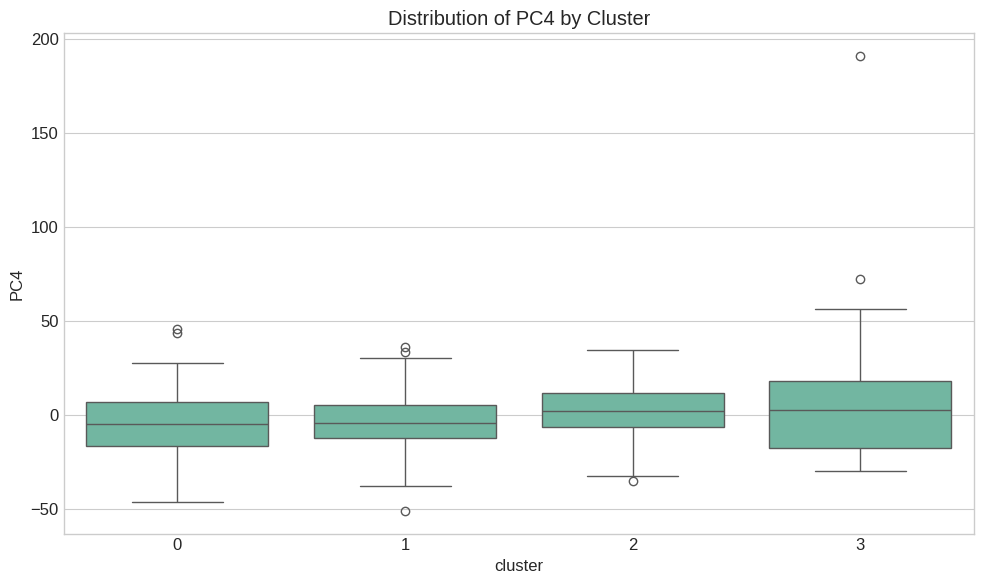

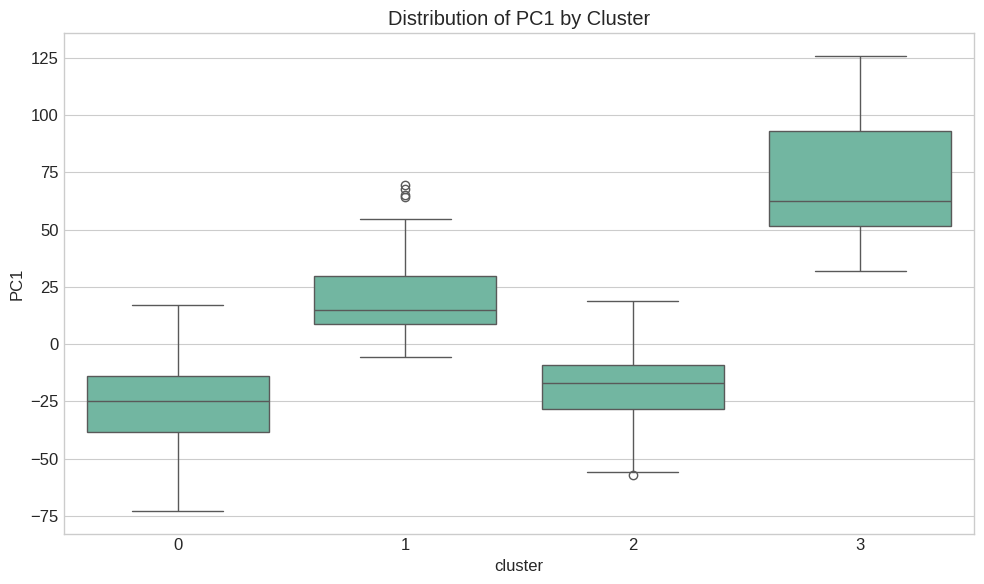


=== Cluster Narrative Summaries ===

Cluster 0 (66 samples, 15.9% of data):
Distinguished by: PC2 (higher), PC3 (higher), PC1 (lower), PC4, PC5 (higher)
ADHD distribution: 0: 40.9%, 1: 59.1%
Sex distribution: 100.0% female

Cluster 1 (140 samples, 33.7% of data):
Distinguished by: PC3 (lower), PC2, PC1 (higher), PC4 (lower), PC10 (lower)
ADHD distribution: 0: 45.0%, 1: 55.0%
Sex distribution: 100.0% female

Cluster 2 (178 samples, 42.8% of data):
Distinguished by: PC2 (lower), PC4, PC3, PC1 (lower), PC5 (lower)
ADHD distribution: 0: 32.6%, 1: 67.4%
Sex distribution: 100.0% female

Cluster 3 (32 samples, 7.7% of data):
Distinguished by: PC2 (higher), PC3 (higher), PC1 (higher), PC4, PC27 (lower)
ADHD distribution: 0: 56.2%, 1: 43.8%
Sex distribution: 100.0% female

=== Interpretation in Original Feature Space ===

Representative samples for Cluster 0:
Subject IDs: ['l6zmYt3wZdcK' 'Ybqkn2vL7OHv' 'vtBv6rK9TEsO' 'ClepIPT0jAAa'
 'b3bu8IP0hrly']

Mean values for key continuous features:
  E

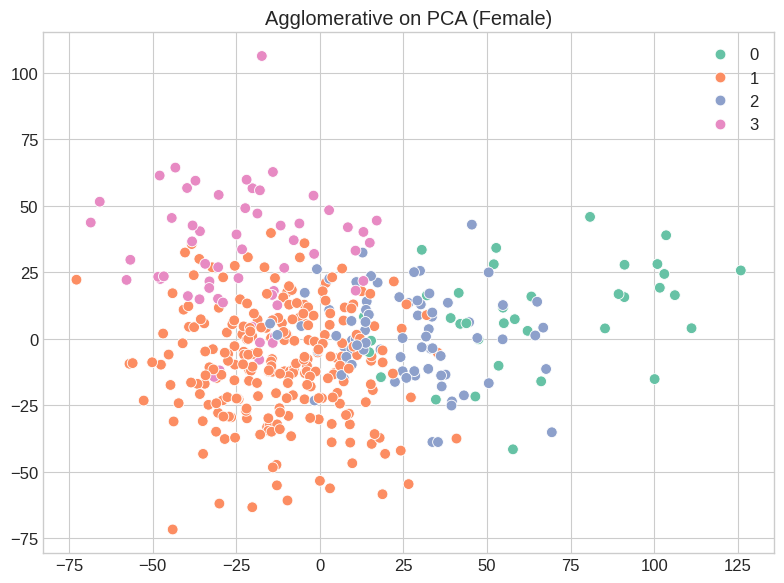

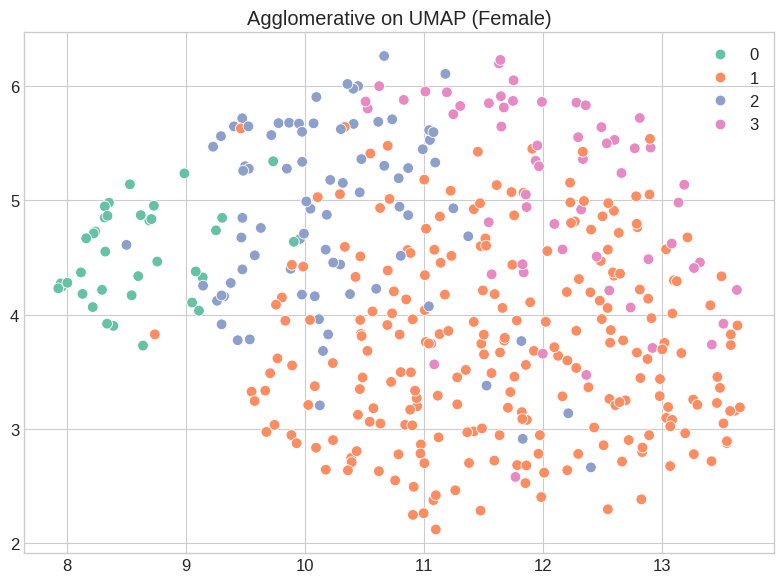

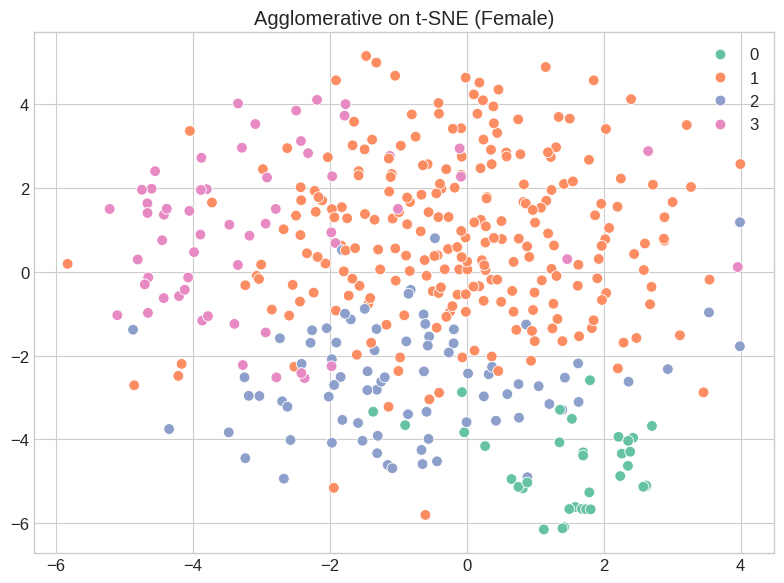

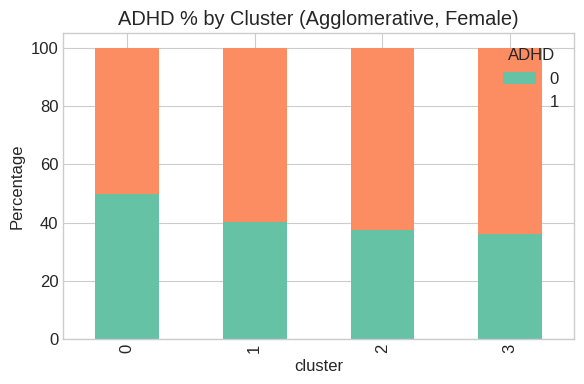


=== Detailed Cluster Analysis for Agglomerative (Female) ===
=== Statistical Profiles of Clusters ===

Cluster 0: 36 samples (8.7%)

Cluster 1: 242 samples (58.2%)

Cluster 2: 80 samples (19.2%)

Cluster 3: 58 samples (13.9%)

=== SHAP-based Feature Importance ===


<Figure size 1200x800 with 0 Axes>

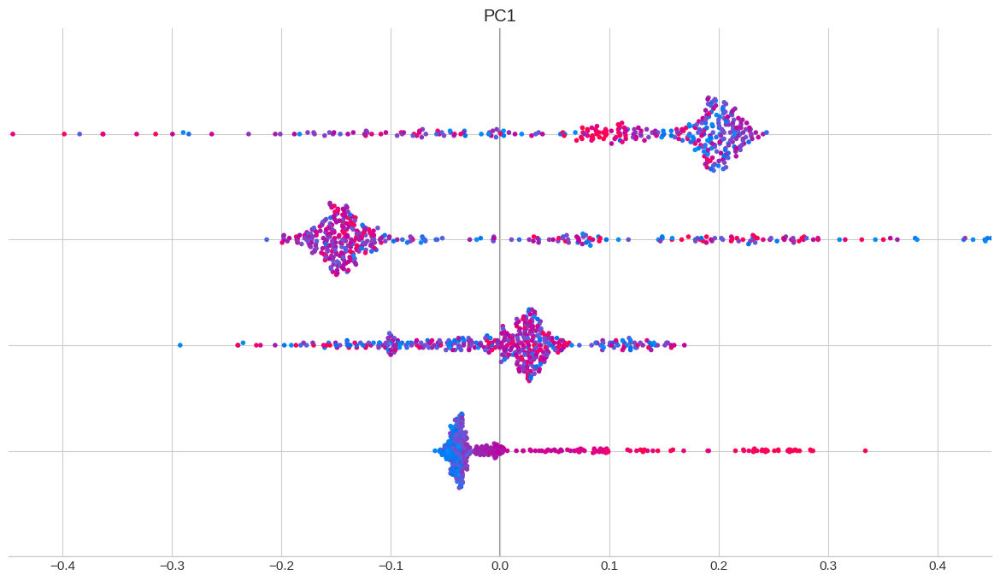


Top discriminating features for Cluster 0:
  - PC2: 0.0092
  - PC3: 0.0053
  - PC4: 0.0036
  - PC1: 0.0021

Top discriminating features for Cluster 1:
  - PC2: 0.0089
  - PC3: 0.0047
  - PC4: 0.0040
  - PC1: 0.0024

Top discriminating features for Cluster 2:
  - PC1: 0.0147
  - PC2: 0.0124
  - PC3: 0.0095
  - PC4: 0.0032

Top discriminating features for Cluster 3:
  - PC1: 0.0127
  - PC2: 0.0113
  - PC3: 0.0068
  - PC4: 0.0048

=== ADHD Outcome Distribution by Cluster ===
ADHD_Outcome          0          1
cluster                           
0             50.000000  50.000000
1             40.082645  59.917355
2             37.500000  62.500000
3             36.206897  63.793103

Chi-square test for ADHD distribution: chi2=2.06, p=0.5607

=== Sex Distribution by Cluster ===
Percentage female by cluster:
cluster
0    100.0
1    100.0
2    100.0
3    100.0
Name: Sex_F, dtype: float64

=== Key Feature Distributions by Cluster ===


<Figure size 1200x600 with 0 Axes>

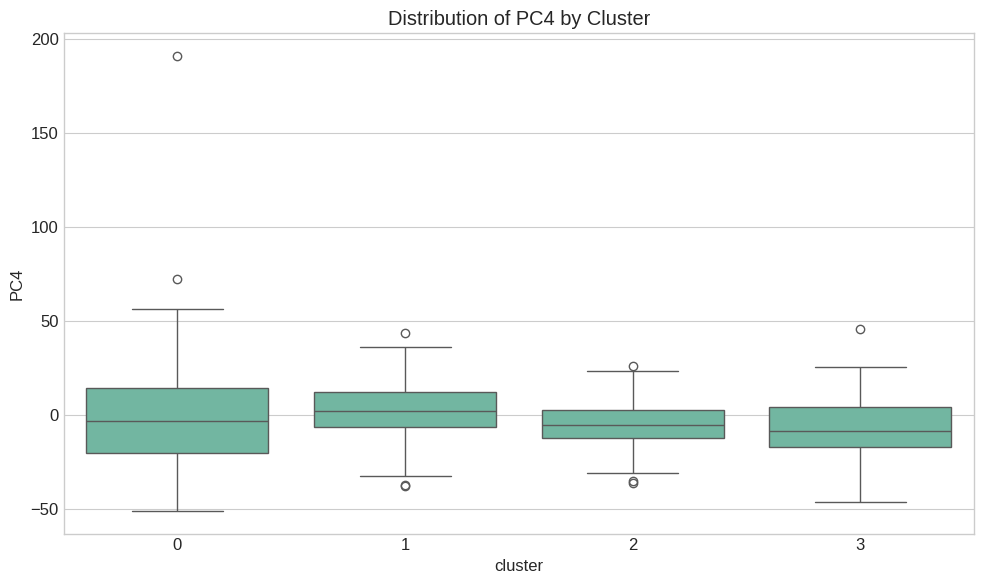

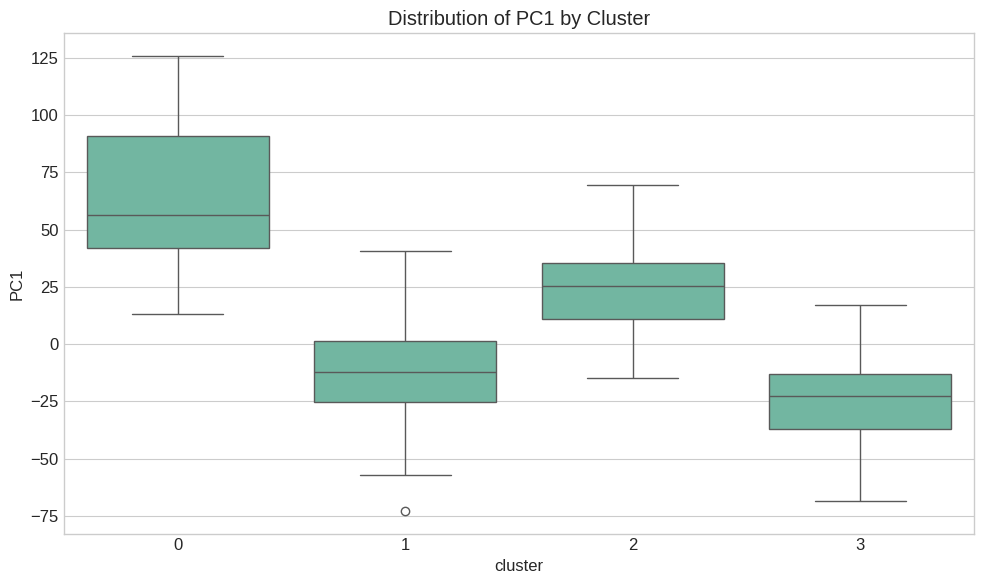

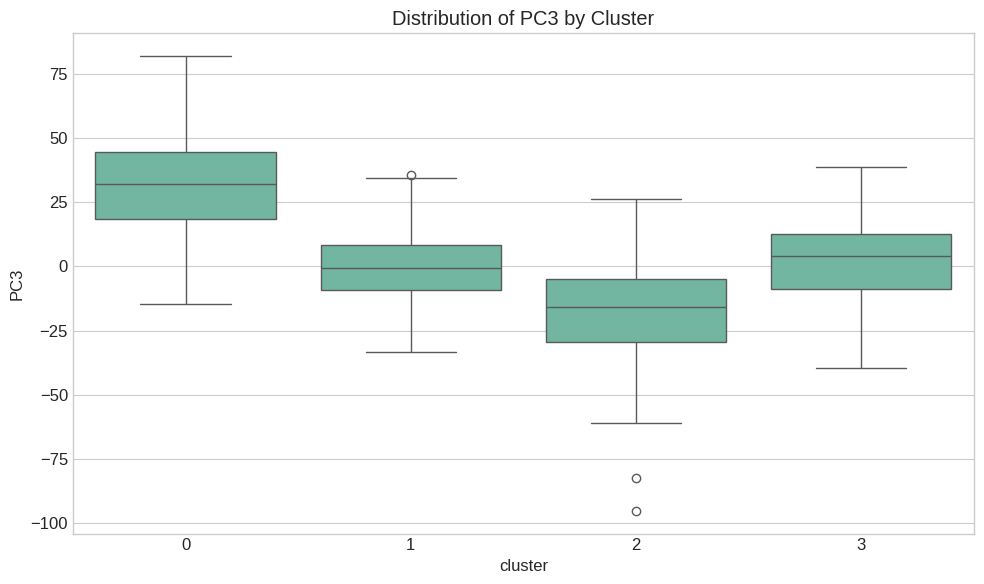

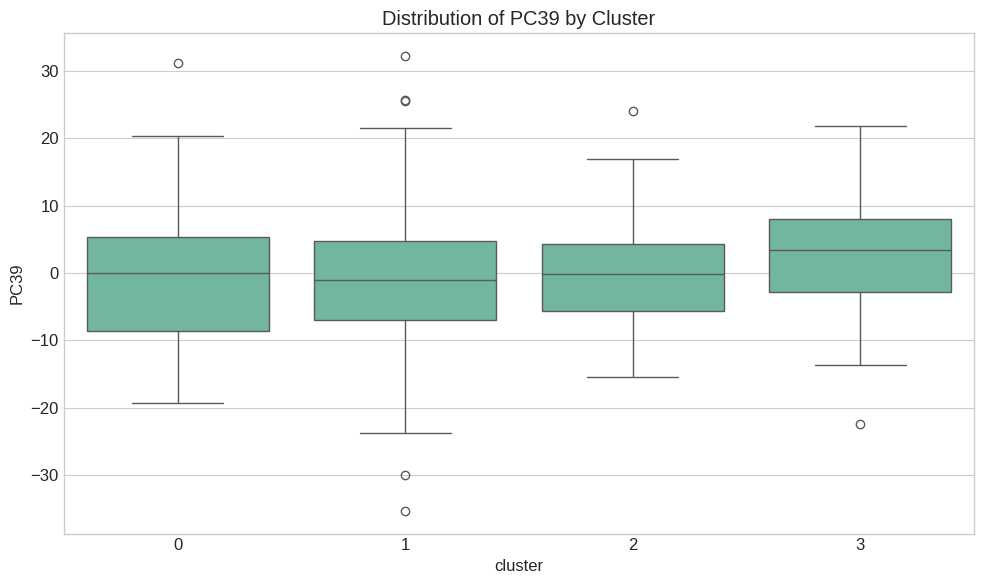

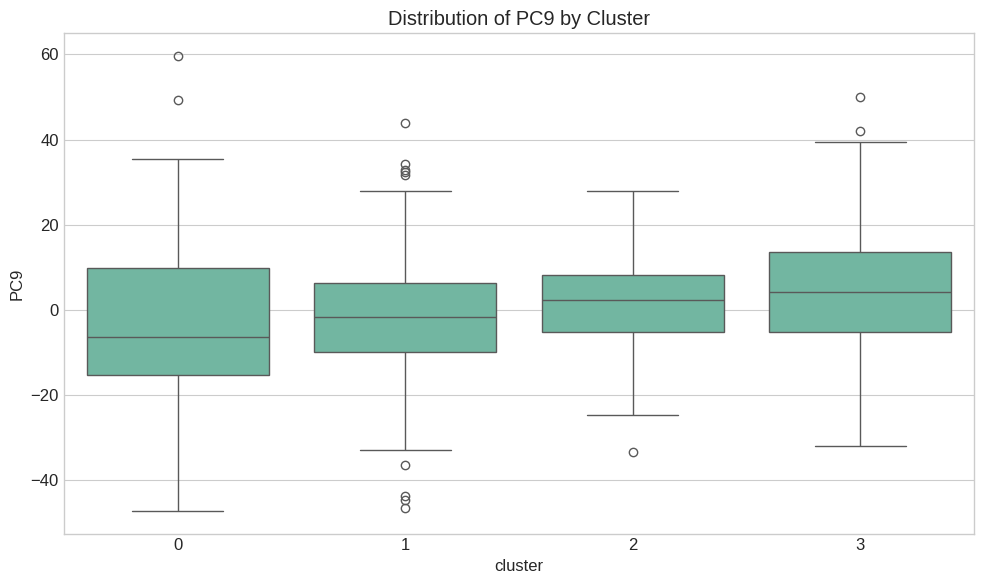


=== Cluster Narrative Summaries ===

Cluster 0 (36 samples, 8.7% of data):
Distinguished by: PC2 (higher), PC3 (higher), PC4, PC1 (higher)
ADHD distribution: 0: 50.0%, 1: 50.0%
Sex distribution: 100.0% female

Cluster 1 (242 samples, 58.2% of data):
Distinguished by: PC2 (lower), PC3, PC4 (higher), PC1 (lower)
ADHD distribution: 0: 40.1%, 1: 59.9%
Sex distribution: 100.0% female

Cluster 2 (80 samples, 19.2% of data):
Distinguished by: PC1 (higher), PC2, PC3 (lower), PC4 (lower), PC6 (higher)
ADHD distribution: 0: 37.5%, 1: 62.5%
Sex distribution: 100.0% female

Cluster 3 (58 samples, 13.9% of data):
Distinguished by: PC1 (lower), PC2 (higher), PC3, PC4 (lower), PC6 (lower)
ADHD distribution: 0: 36.2%, 1: 63.8%
Sex distribution: 100.0% female

=== Interpretation in Original Feature Space ===

Representative samples for Cluster 0:
Subject IDs: ['zwjJWCRzKhDz' 'psUujiWvKE2O' '4SJ1OB710KjM' 'yi9J1NNo3V6P'
 '0Hthz5IFXhpw']

Mean values for key continuous features:
  EHQ_EHQ_Total: 89.79 (

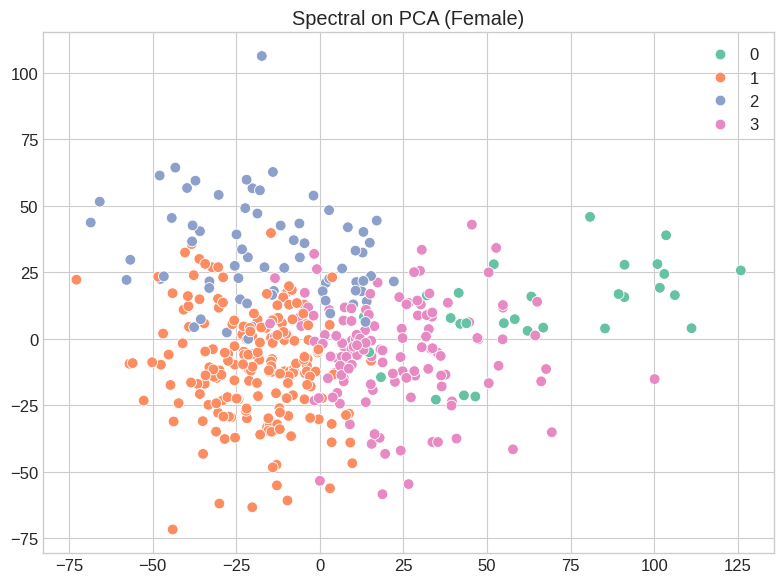

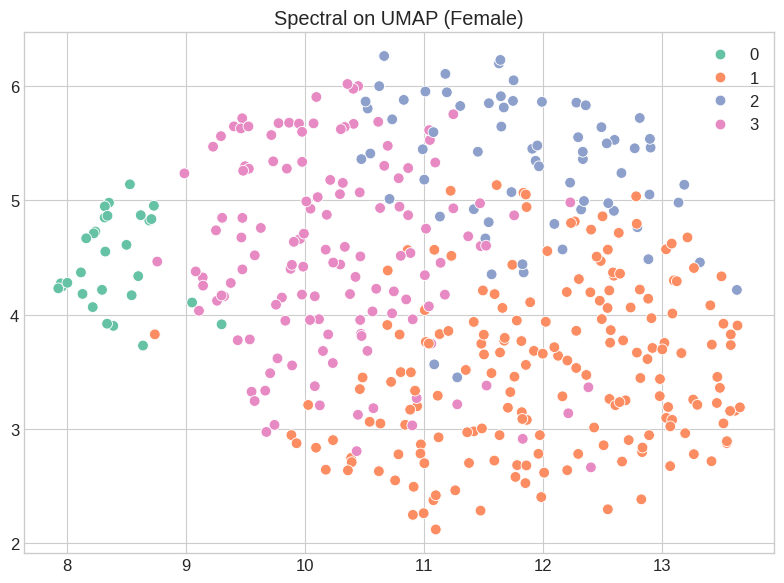

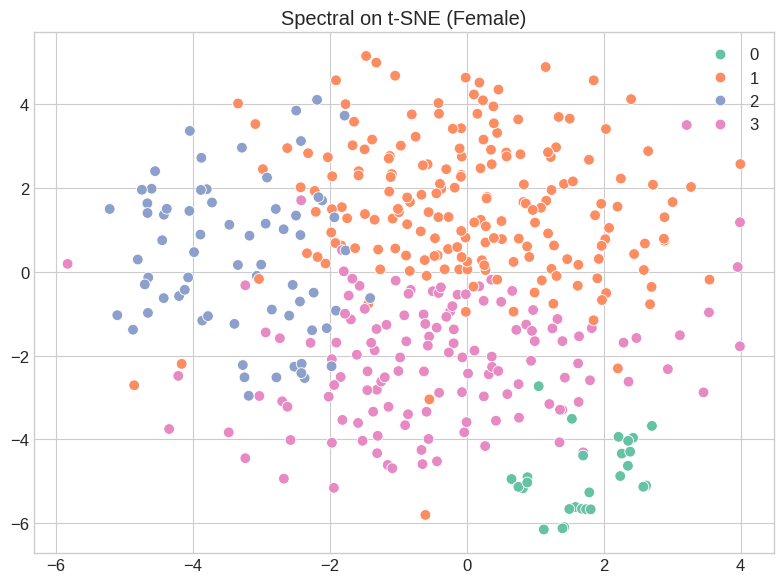

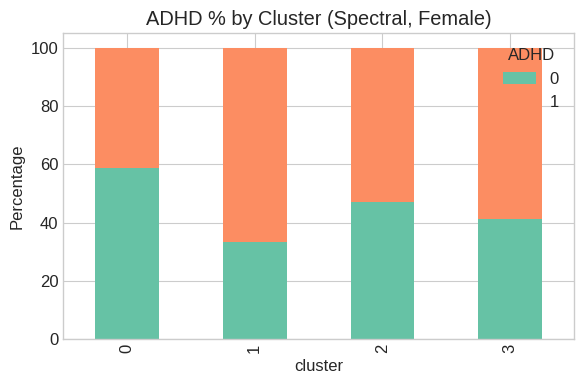


=== Detailed Cluster Analysis for Spectral (Female) ===
=== Statistical Profiles of Clusters ===

Cluster 0: 29 samples (7.0%)

Cluster 1: 186 samples (44.7%)

Cluster 2: 68 samples (16.3%)

Cluster 3: 133 samples (32.0%)

=== SHAP-based Feature Importance ===


<Figure size 1200x800 with 0 Axes>

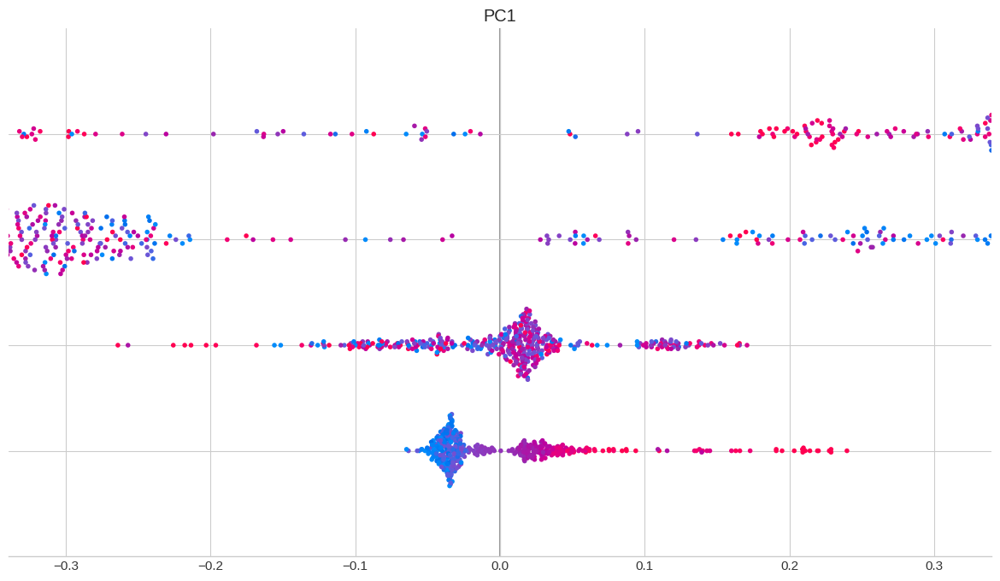


Top discriminating features for Cluster 0:
  - PC2: 0.0084
  - PC4: 0.0069
  - PC3: 0.0041
  - PC1: 0.0019

Top discriminating features for Cluster 1:
  - PC2: 0.0115
  - PC4: 0.0081
  - PC3: 0.0042
  - PC1: 0.0021

Top discriminating features for Cluster 2:
  - PC1: 0.0130
  - PC4: 0.0113
  - PC2: 0.0095
  - PC3: 0.0051

Top discriminating features for Cluster 3:
  - PC4: 0.0134
  - PC2: 0.0101
  - PC1: 0.0050
  - PC3: 0.0050

=== ADHD Outcome Distribution by Cluster ===
ADHD_Outcome          0          1
cluster                           
0             58.620690  41.379310
1             33.333333  66.666667
2             47.058824  52.941176
3             41.353383  58.646617

Chi-square test for ADHD distribution: chi2=9.15, p=0.0273

=== Sex Distribution by Cluster ===
Percentage female by cluster:
cluster
0    100.0
1    100.0
2    100.0
3    100.0
Name: Sex_F, dtype: float64

=== Key Feature Distributions by Cluster ===


<Figure size 1200x600 with 0 Axes>

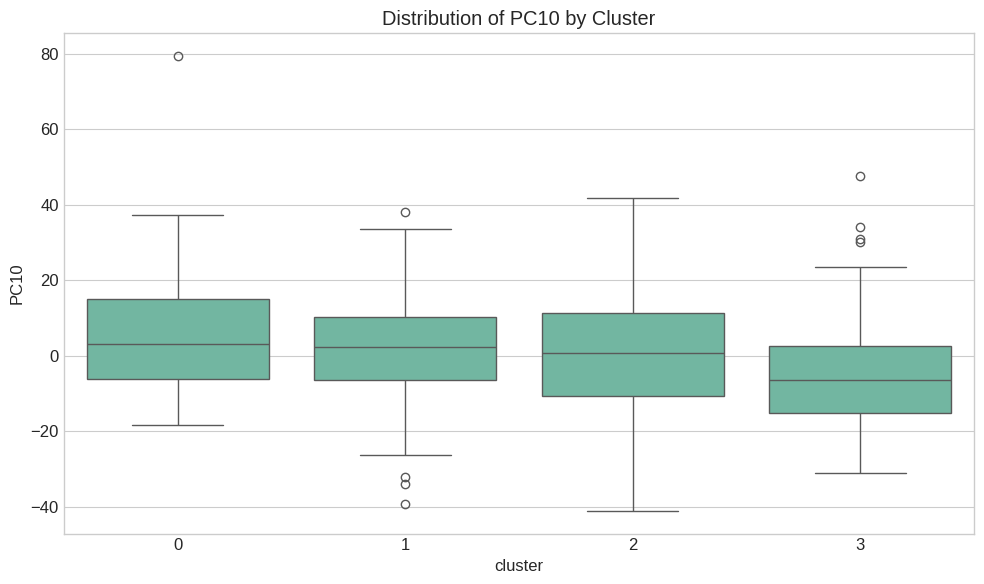

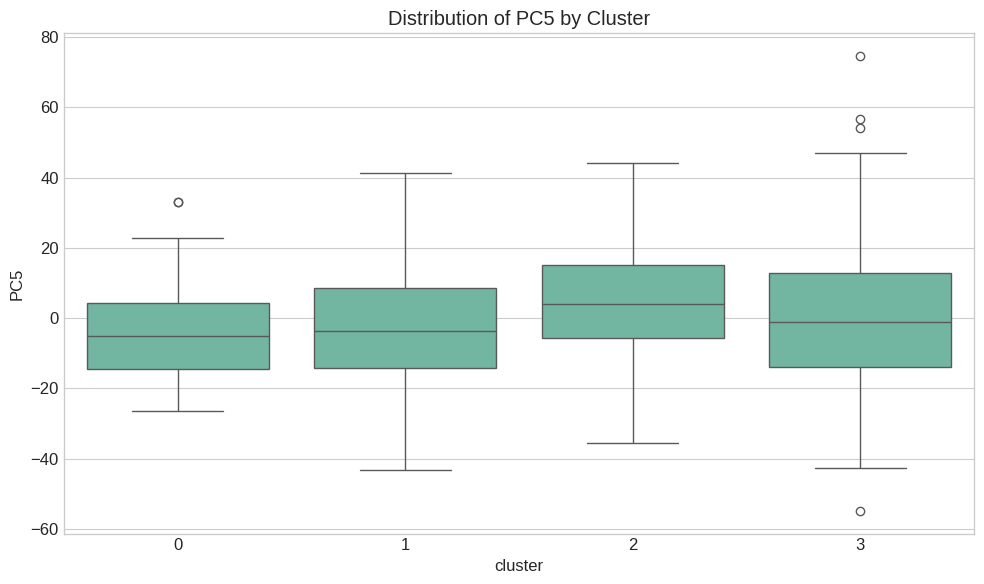

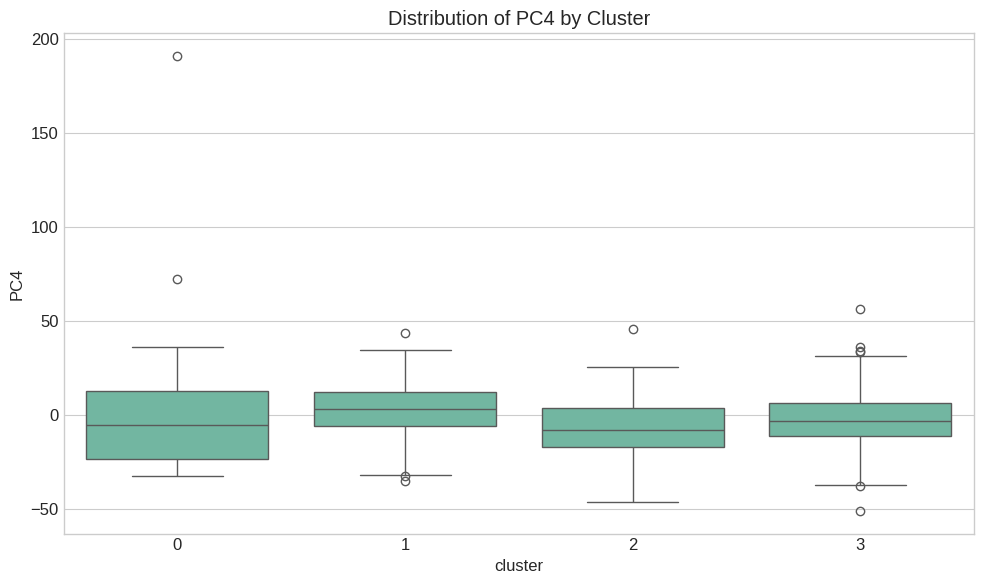

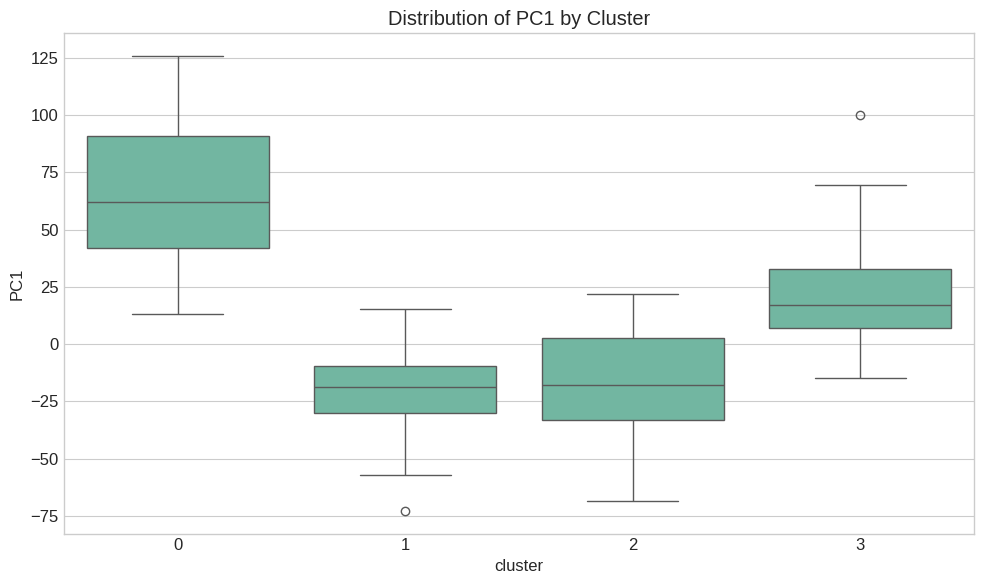

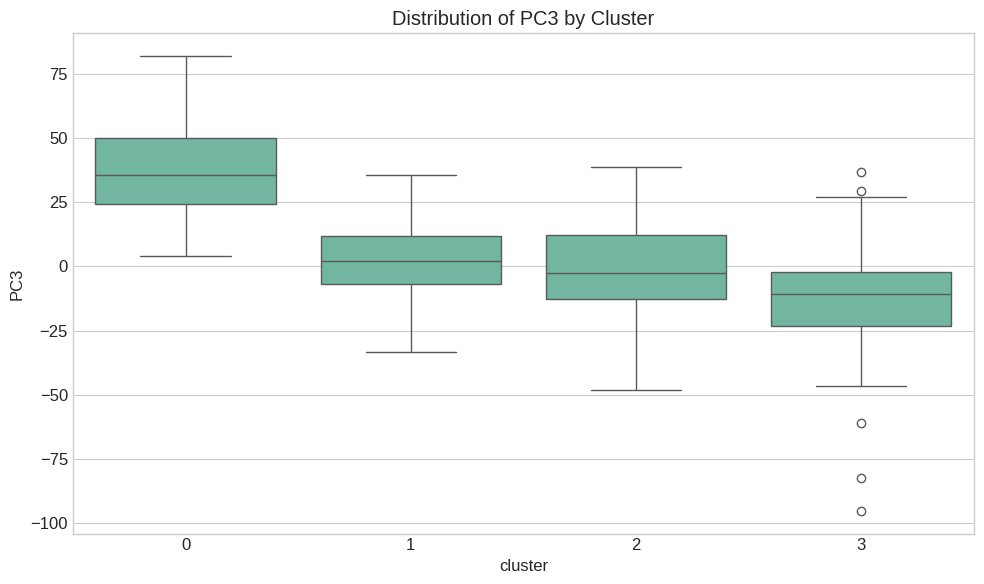


=== Cluster Narrative Summaries ===

Cluster 0 (29 samples, 7.0% of data):
Distinguished by: PC2 (higher), PC4, PC3 (higher), PC1 (higher)
ADHD distribution: 0: 58.6%, 1: 41.4%
Sex distribution: 100.0% female

Cluster 1 (186 samples, 44.7% of data):
Distinguished by: PC2 (lower), PC4 (higher), PC3 (higher), PC1 (lower)
ADHD distribution: 0: 33.3%, 1: 66.7%
Sex distribution: 100.0% female

Cluster 2 (68 samples, 16.3% of data):
Distinguished by: PC1 (lower), PC4 (lower), PC2 (higher), PC3, PC5 (higher)
ADHD distribution: 0: 47.1%, 1: 52.9%
Sex distribution: 100.0% female

Cluster 3 (133 samples, 32.0% of data):
Distinguished by: PC4, PC2 (lower), PC1 (higher), PC3 (lower), PC6 (higher)
ADHD distribution: 0: 41.4%, 1: 58.6%
Sex distribution: 100.0% female

=== Interpretation in Original Feature Space ===

Representative samples for Cluster 0:
Subject IDs: ['zwjJWCRzKhDz' 'yi9J1NNo3V6P' '4SJ1OB710KjM' 'psUujiWvKE2O'
 '9Pqib6cW1oAr']

Mean values for key continuous features:
  EHQ_EHQ_Tot

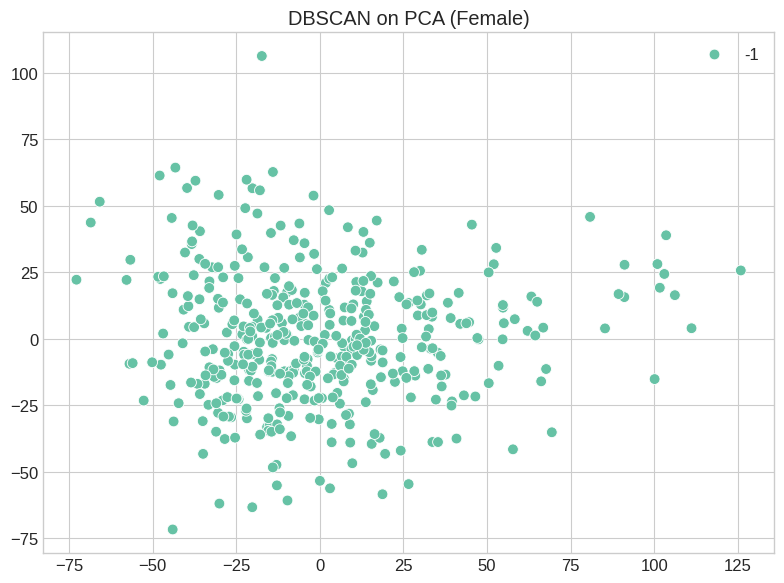

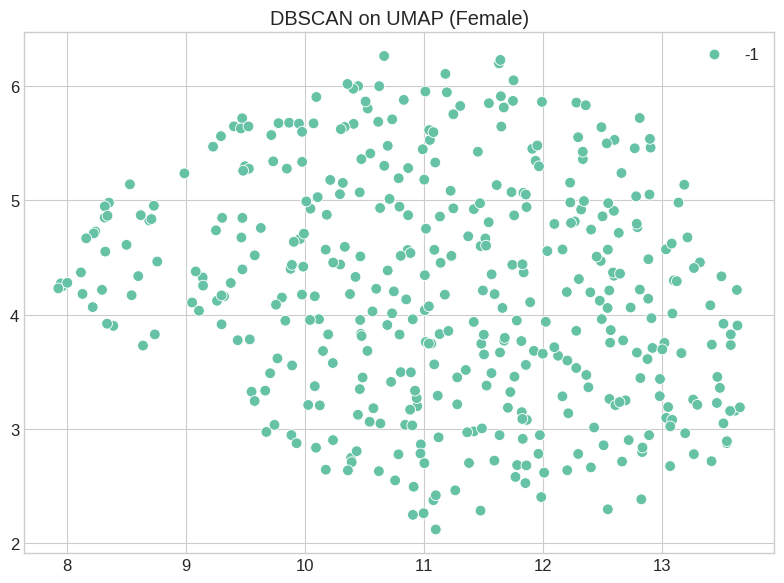

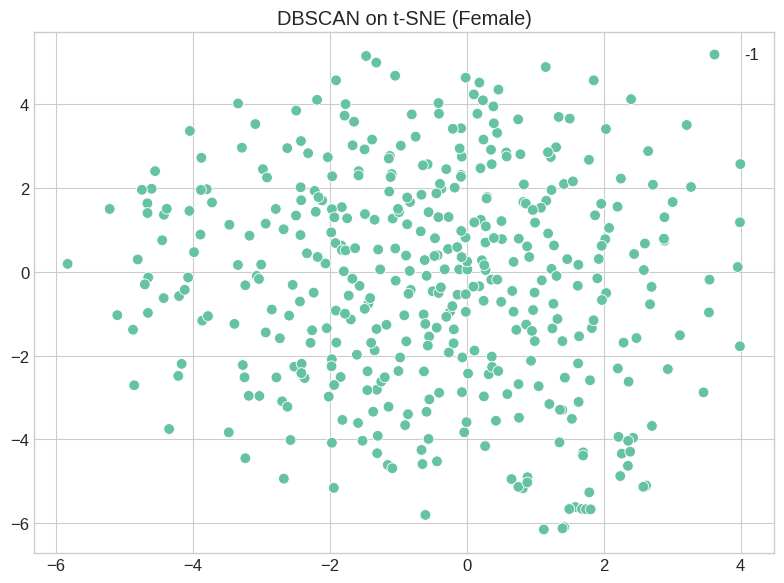

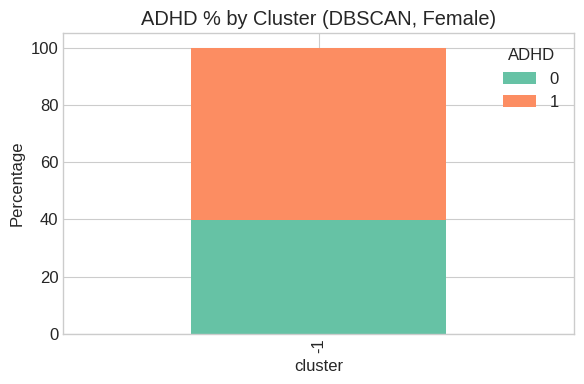


=== Detailed Cluster Analysis for DBSCAN (Female) ===
=== Statistical Profiles of Clusters ===

=== ADHD Outcome Distribution by Cluster ===
ADHD_Outcome          0          1
cluster                           
-1            39.903846  60.096154

Chi-square test for ADHD distribution: chi2=0.00, p=1.0000

=== Sex Distribution by Cluster ===
Percentage female by cluster:
cluster
-1    100.0
Name: Sex_F, dtype: float64

=== Cluster Narrative Summaries ===

=== Summary Performance ===
       Group      Algorithm  Avg_Silhouette   Avg_ARI
8       Male       Spectral        0.097560  0.988708
5       Male         KMeans        0.057331  0.903633
7       Male  Agglomerative        0.055129  1.000000
6       Male            GMM        0.045744  0.565075
9       Male         DBSCAN             NaN  1.000000
13    Female       Spectral        0.049542  0.994940
12    Female  Agglomerative        0.046170  1.000000
10    Female         KMeans        0.045312  0.736182
11    Female            GM

<Figure size 1200x600 with 0 Axes>

In [56]:
%%time
summary, cluster_explanations = run_pipeline(
        func_path = "/root/.cache/kagglehub/competitions/widsdatathon2025/TRAIN_NEW/TRAIN_FUNCTIONAL_CONNECTOME_MATRICES_new_36P_Pearson.csv",
        cat_path = "/root/.cache/kagglehub/competitions/widsdatathon2025/TRAIN_NEW/TRAIN_CATEGORICAL_METADATA_new.xlsx",
        quant_path = "/root/.cache/kagglehub/competitions/widsdatathon2025/TRAIN_NEW/TRAIN_QUANTITATIVE_METADATA_new.xlsx",
        target_path = "/root/.cache/kagglehub/competitions/widsdatathon2025/TRAIN_NEW/TRAINING_SOLUTIONS.xlsx",
        k=4, B=100
)



In [57]:
best_clustering = summarize_best_clustering(summary, cluster_explanations)


=== Best Clustering for Combined: Spectral ===
Performance: Avg_Silhouette=0.072, Avg_ARI=0.988

Cluster Summary:

Cluster 0 (132 samples, 10.9%):
  Key features:
    - PC4 (importance: 0.0153)
    - PC2 (importance: 0.0140)
    - PC1 (importance: 0.0027)
  ADHD distribution:
    - 0: 31.8%
    - 1: 68.2%
  Sex distribution: 27.3% female

Cluster 1 (794 samples, 65.5%):
  Key features:
    - PC4 (importance: 0.0145)
    - PC2 (importance: 0.0145)
    - PC1 (importance: 0.0029)
  ADHD distribution:
    - 0: 31.7%
    - 1: 68.3%
  Sex distribution: 35.4% female

Cluster 2 (32 samples, 2.6%):
  Key features:
    - PC2 (importance: 0.0075)
    - PC4 (importance: 0.0058)
    - PC1 (importance: 0.0030)
  ADHD distribution:
    - 0: 50.0%
    - 1: 50.0%
  Sex distribution: 40.6% female

Cluster 3 (255 samples, 21.0%):
  Key features:
    - PC2 (importance: 0.0075)
    - PC4 (importance: 0.0054)
    - PC1 (importance: 0.0024)
  ADHD distribution:
    - 0: 28.2%
    - 1: 71.8%
  Sex distributi

'sample_patients' completed in 0.0012 seconds.

'sample_patients' completed in 0.0008 seconds.

'sample_patients' completed in 0.0007 seconds.

'sample_patients' completed in 0.0006 seconds.

Visualizing Male with ADHD...
'visualize_connectome' completed in 0.5759 seconds.

'visualize_connectome' completed in 0.4118 seconds.

'visualize_connectome' completed in 0.4321 seconds.

'visualize_connectome' completed in 0.4157 seconds.

'visualize_connectome' completed in 0.4235 seconds.

'visualize_connectome' completed in 0.4192 seconds.

'visualize_connectome' completed in 0.4020 seconds.

'visualize_connectome' completed in 0.4110 seconds.

'visualize_connectome' completed in 0.4568 seconds.

'visualize_connectome' completed in 0.4357 seconds.

'visualize_group_connectomes' completed in 4.8406 seconds.

Saved visualization to connectome_visualizations/male_with_adhd.png
'save_group_visualizations' completed in 4.6359 seconds.

Visualizing Male without ADHD...
'visualize_connectome' comple

  0%|          | 0/10 [00:00<?, ?it/s]

'visualize_connectome' completed in 0.4614 seconds.



 10%|█         | 1/10 [00:00<00:06,  1.43it/s]

'compute_network_metrics' completed in 0.2365 seconds.

'visualize_connectome' completed in 0.4507 seconds.



 20%|██        | 2/10 [00:01<00:06,  1.26it/s]

'compute_network_metrics' completed in 0.4091 seconds.

'visualize_connectome' completed in 0.4463 seconds.



 30%|███       | 3/10 [00:02<00:05,  1.24it/s]

'compute_network_metrics' completed in 0.3717 seconds.

'visualize_connectome' completed in 0.4489 seconds.



 40%|████      | 4/10 [00:03<00:04,  1.29it/s]

'compute_network_metrics' completed in 0.2754 seconds.

'visualize_connectome' completed in 0.4635 seconds.



 50%|█████     | 5/10 [00:03<00:03,  1.30it/s]

'compute_network_metrics' completed in 0.2875 seconds.

'visualize_connectome' completed in 0.4326 seconds.



 60%|██████    | 6/10 [00:04<00:03,  1.31it/s]

'compute_network_metrics' completed in 0.3289 seconds.

'visualize_connectome' completed in 0.4398 seconds.



 70%|███████   | 7/10 [00:05<00:02,  1.32it/s]

'compute_network_metrics' completed in 0.2999 seconds.

'visualize_connectome' completed in 0.4571 seconds.

'compute_network_metrics' completed in 0.2092 seconds.



 80%|████████  | 8/10 [00:06<00:01,  1.37it/s]

'visualize_connectome' completed in 0.4518 seconds.



 90%|█████████ | 9/10 [00:07<00:00,  1.19it/s]

'compute_network_metrics' completed in 0.6216 seconds.

'visualize_connectome' completed in 0.6480 seconds.



100%|██████████| 10/10 [00:08<00:00,  1.19it/s]


'compute_network_metrics' completed in 0.6499 seconds.

Analyzing Male without ADHD...


  0%|          | 0/10 [00:00<?, ?it/s]

'visualize_connectome' completed in 0.7064 seconds.



 10%|█         | 1/10 [00:01<00:10,  1.15s/it]

'compute_network_metrics' completed in 0.4383 seconds.

'visualize_connectome' completed in 0.4574 seconds.



 20%|██        | 2/10 [00:01<00:07,  1.03it/s]

'compute_network_metrics' completed in 0.3913 seconds.

'visualize_connectome' completed in 0.4488 seconds.



 30%|███       | 3/10 [00:02<00:06,  1.13it/s]

'compute_network_metrics' completed in 0.3255 seconds.

'visualize_connectome' completed in 0.4368 seconds.



 40%|████      | 4/10 [00:03<00:04,  1.24it/s]

'compute_network_metrics' completed in 0.2569 seconds.

'visualize_connectome' completed in 0.4357 seconds.



 50%|█████     | 5/10 [00:04<00:03,  1.31it/s]

'compute_network_metrics' completed in 0.2454 seconds.

'visualize_connectome' completed in 0.4367 seconds.



 60%|██████    | 6/10 [00:04<00:02,  1.36it/s]

'compute_network_metrics' completed in 0.2357 seconds.

'visualize_connectome' completed in 0.4597 seconds.



 70%|███████   | 7/10 [00:05<00:02,  1.34it/s]

'compute_network_metrics' completed in 0.3058 seconds.

'visualize_connectome' completed in 0.4560 seconds.



 80%|████████  | 8/10 [00:06<00:01,  1.35it/s]

'compute_network_metrics' completed in 0.2845 seconds.

'visualize_connectome' completed in 0.4558 seconds.



 90%|█████████ | 9/10 [00:07<00:00,  1.30it/s]

'compute_network_metrics' completed in 0.3783 seconds.

'visualize_connectome' completed in 1.3944 seconds.



100%|██████████| 10/10 [00:08<00:00,  1.14it/s]


'compute_network_metrics' completed in 0.2412 seconds.

Analyzing Female with ADHD...


  0%|          | 0/10 [00:00<?, ?it/s]

'visualize_connectome' completed in 0.4248 seconds.



 10%|█         | 1/10 [00:00<00:06,  1.50it/s]

'compute_network_metrics' completed in 0.2428 seconds.

'visualize_connectome' completed in 0.4598 seconds.



 20%|██        | 2/10 [00:01<00:05,  1.40it/s]

'compute_network_metrics' completed in 0.2884 seconds.

'visualize_connectome' completed in 0.4298 seconds.



 30%|███       | 3/10 [00:02<00:04,  1.40it/s]

'compute_network_metrics' completed in 0.2771 seconds.

'visualize_connectome' completed in 0.5885 seconds.



 40%|████      | 4/10 [00:03<00:05,  1.09it/s]

'compute_network_metrics' completed in 0.6488 seconds.

'visualize_connectome' completed in 0.5936 seconds.



 50%|█████     | 5/10 [00:04<00:04,  1.09it/s]

'compute_network_metrics' completed in 0.3200 seconds.

'visualize_connectome' completed in 0.6807 seconds.



 60%|██████    | 6/10 [00:05<00:03,  1.05it/s]

'compute_network_metrics' completed in 0.3341 seconds.

'visualize_connectome' completed in 0.4515 seconds.



 70%|███████   | 7/10 [00:06<00:02,  1.15it/s]

'compute_network_metrics' completed in 0.2570 seconds.

'visualize_connectome' completed in 0.4548 seconds.



 80%|████████  | 8/10 [00:06<00:01,  1.22it/s]

'compute_network_metrics' completed in 0.2451 seconds.

'visualize_connectome' completed in 0.4438 seconds.



 90%|█████████ | 9/10 [00:07<00:00,  1.28it/s]

'compute_network_metrics' completed in 0.2475 seconds.

'visualize_connectome' completed in 0.4293 seconds.



100%|██████████| 10/10 [00:08<00:00,  1.24it/s]


'compute_network_metrics' completed in 0.2401 seconds.

Analyzing Female without ADHD...


  0%|          | 0/10 [00:00<?, ?it/s]

'visualize_connectome' completed in 0.4679 seconds.



 10%|█         | 1/10 [00:00<00:06,  1.33it/s]

'compute_network_metrics' completed in 0.2838 seconds.

'visualize_connectome' completed in 0.4415 seconds.



 20%|██        | 2/10 [00:01<00:05,  1.39it/s]

'compute_network_metrics' completed in 0.2529 seconds.



 30%|███       | 3/10 [00:02<00:04,  1.48it/s]

'visualize_connectome' completed in 0.4289 seconds.

'compute_network_metrics' completed in 0.1987 seconds.

'visualize_connectome' completed in 0.4594 seconds.



 40%|████      | 4/10 [00:02<00:04,  1.38it/s]

'compute_network_metrics' completed in 0.3319 seconds.

'visualize_connectome' completed in 0.4327 seconds.



 50%|█████     | 5/10 [00:03<00:03,  1.41it/s]

'compute_network_metrics' completed in 0.2511 seconds.



 60%|██████    | 6/10 [00:04<00:02,  1.52it/s]

'visualize_connectome' completed in 0.4376 seconds.

'compute_network_metrics' completed in 0.1139 seconds.

'visualize_connectome' completed in 0.4647 seconds.



 70%|███████   | 7/10 [00:04<00:02,  1.45it/s]

'compute_network_metrics' completed in 0.2918 seconds.

'visualize_connectome' completed in 0.4659 seconds.



 80%|████████  | 8/10 [00:05<00:01,  1.38it/s]

'compute_network_metrics' completed in 0.3352 seconds.

'visualize_connectome' completed in 0.4408 seconds.



 90%|█████████ | 9/10 [00:06<00:00,  1.40it/s]

'compute_network_metrics' completed in 0.2411 seconds.

'visualize_connectome' completed in 0.4590 seconds.



100%|██████████| 10/10 [00:07<00:00,  1.38it/s]

'compute_network_metrics' completed in 0.4114 seconds.

Groups available for comparison: ['Male with ADHD' 'Male without ADHD' 'Female with ADHD'
 'Female without ADHD']
Shape of metrics dataframe after dropping NaN: (40, 7)
Metrics to plot: ['density', 'avg_degree', 'avg_clustering', 'avg_shortest_path', 'modularity']


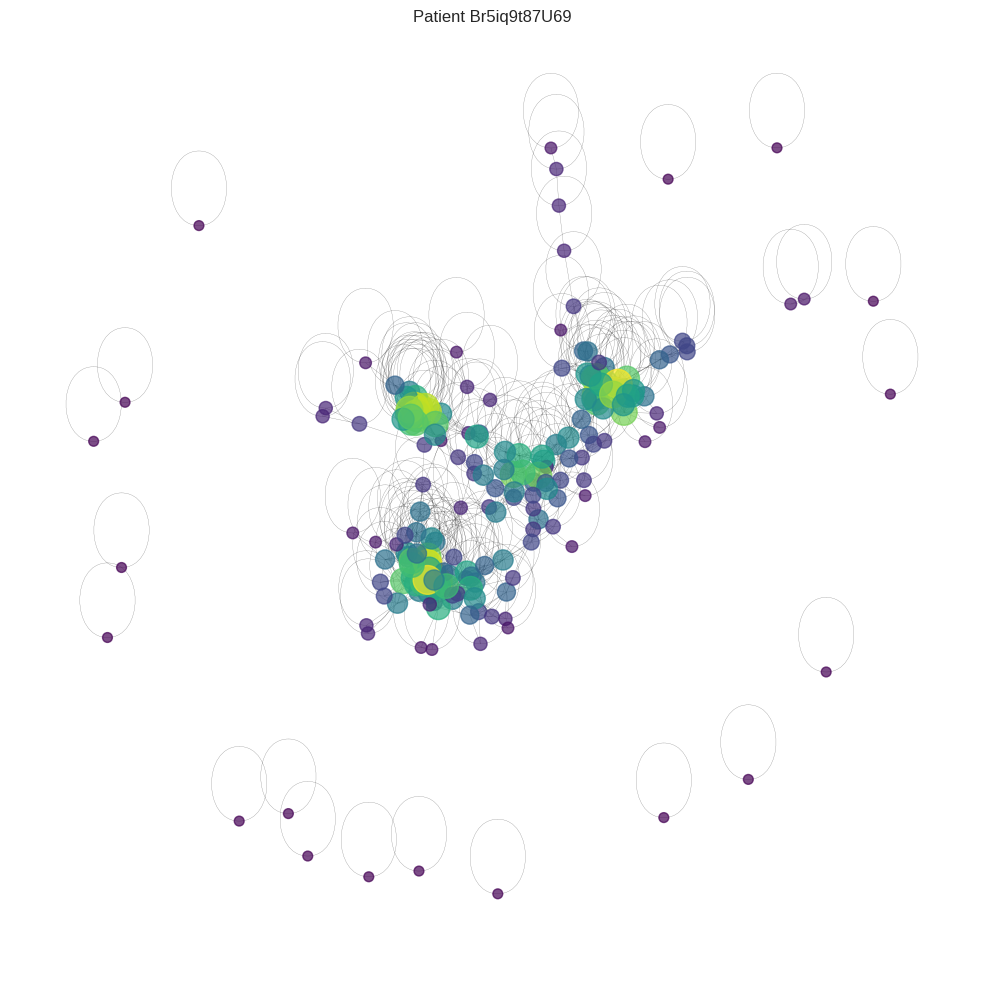

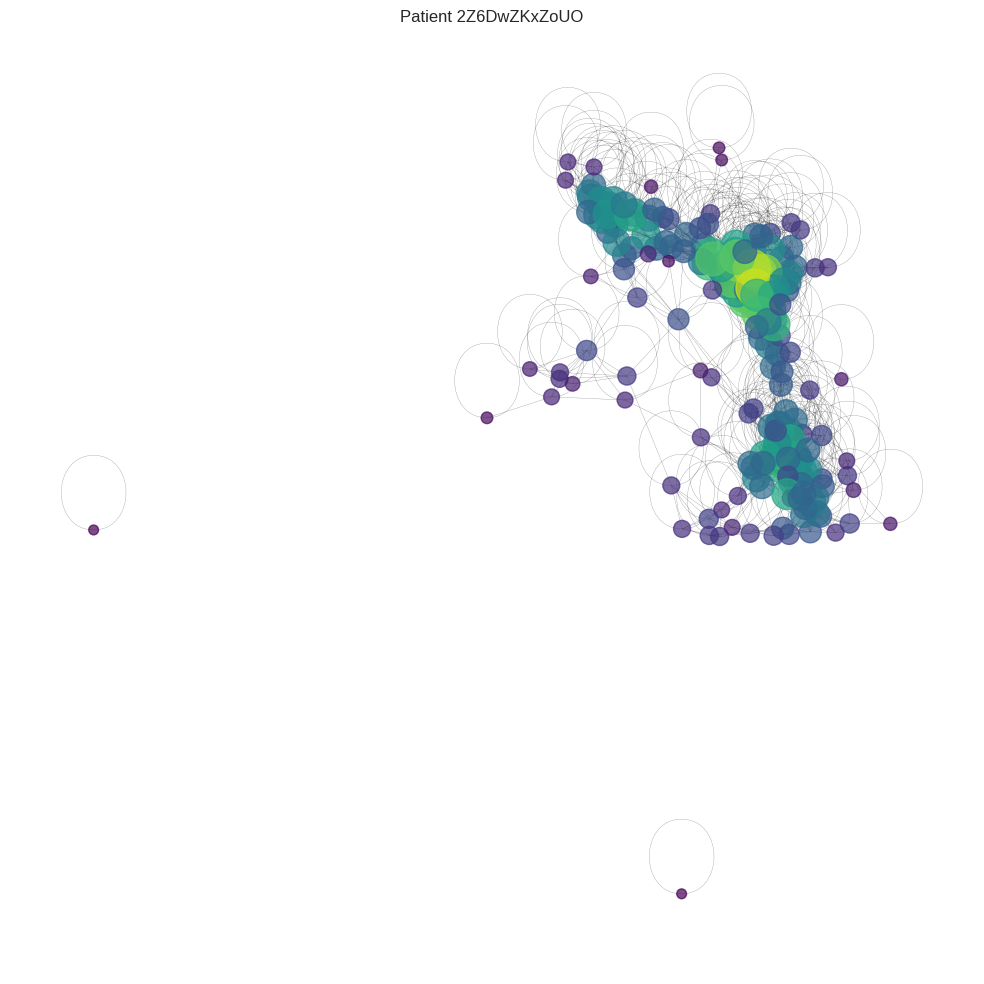

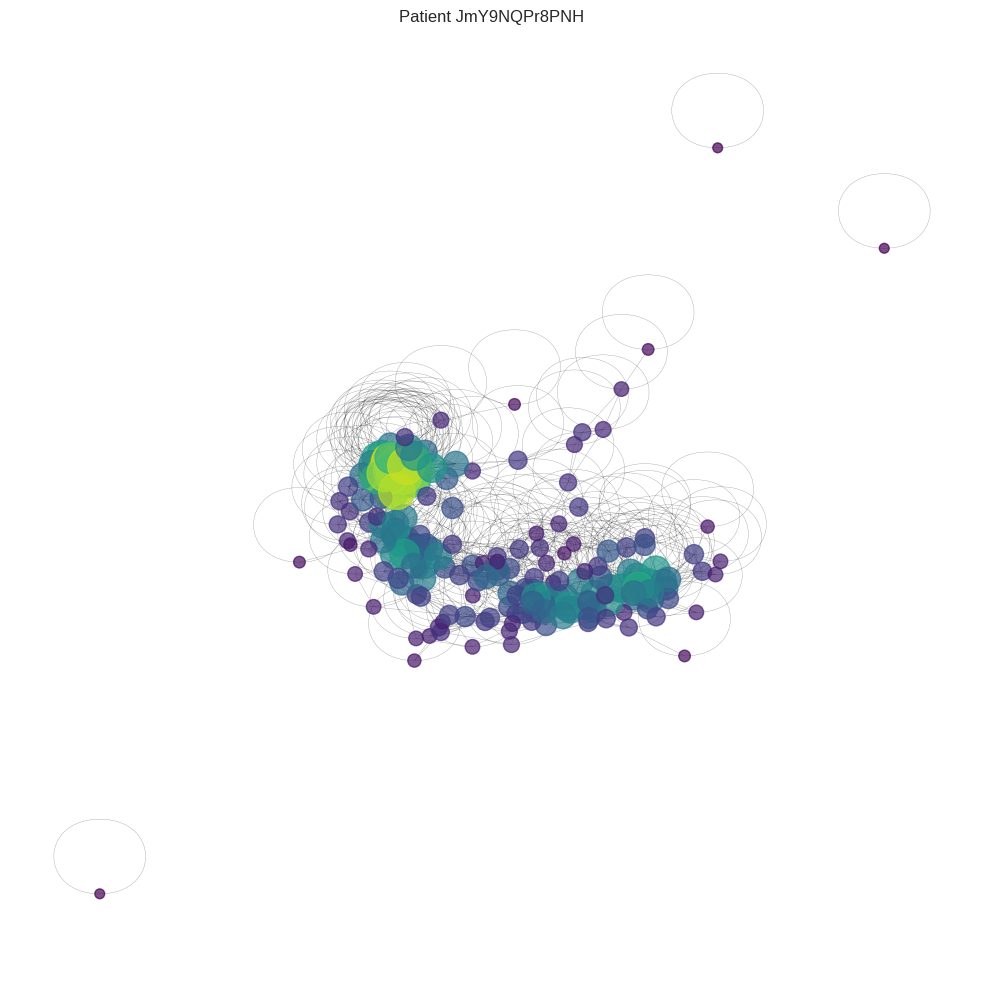

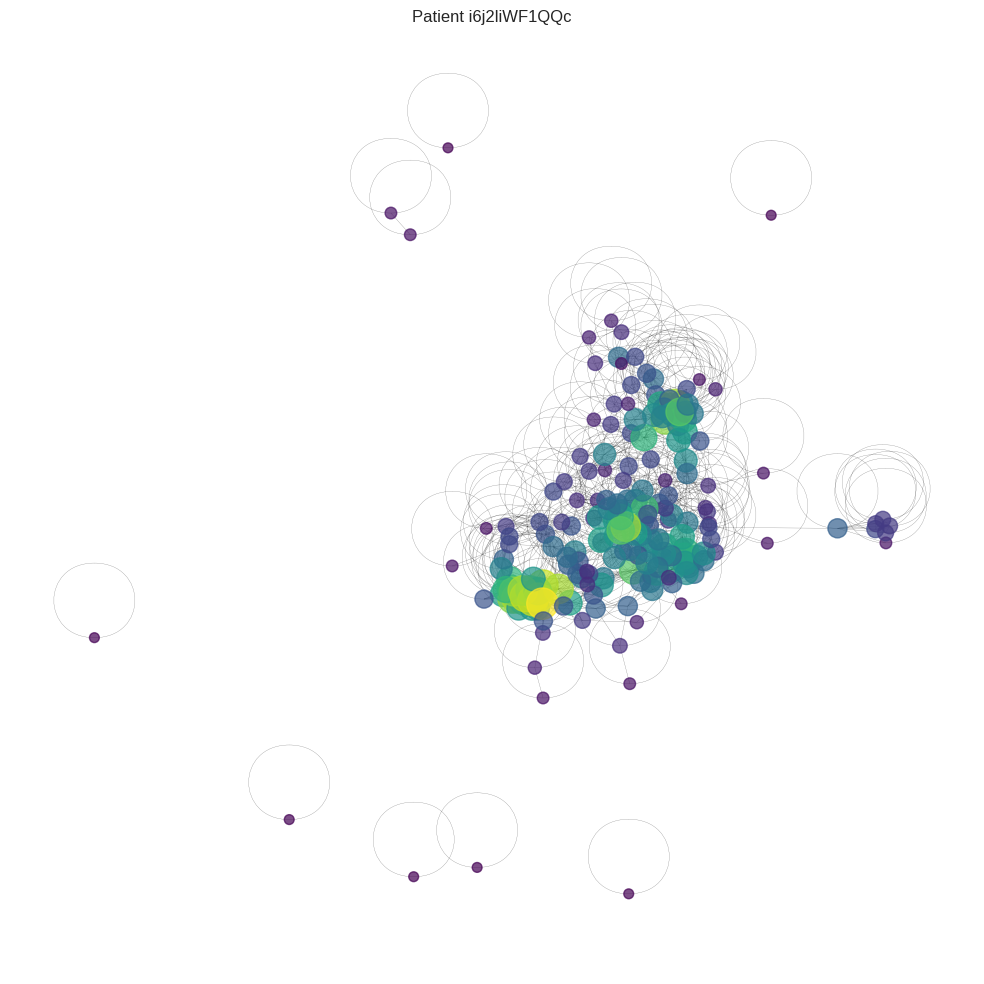

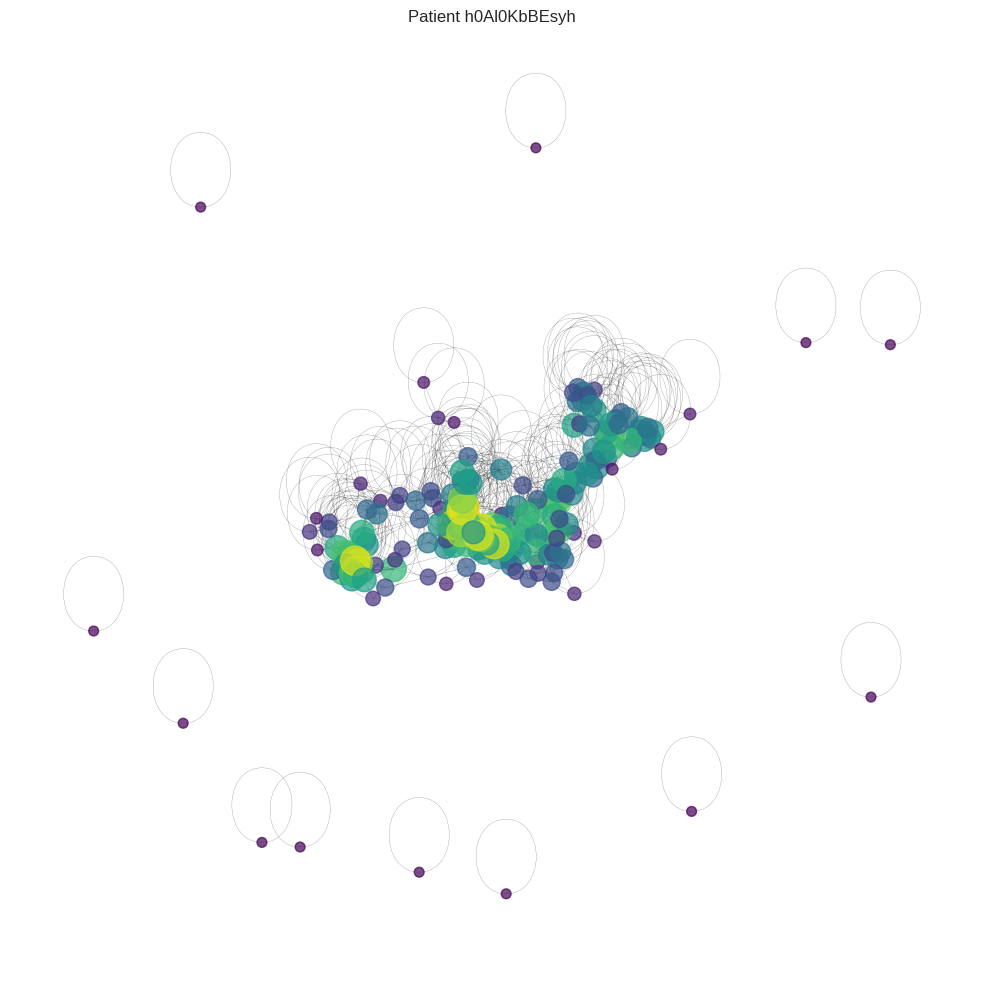

...

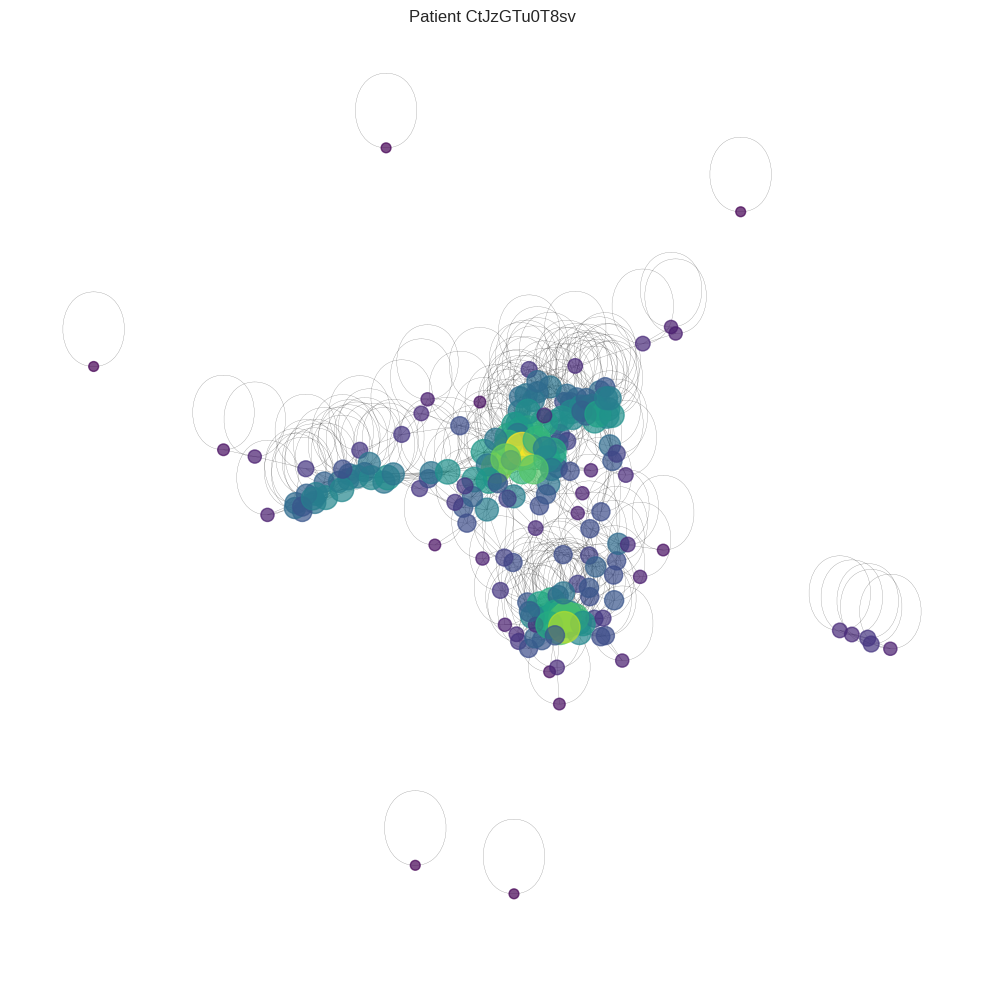

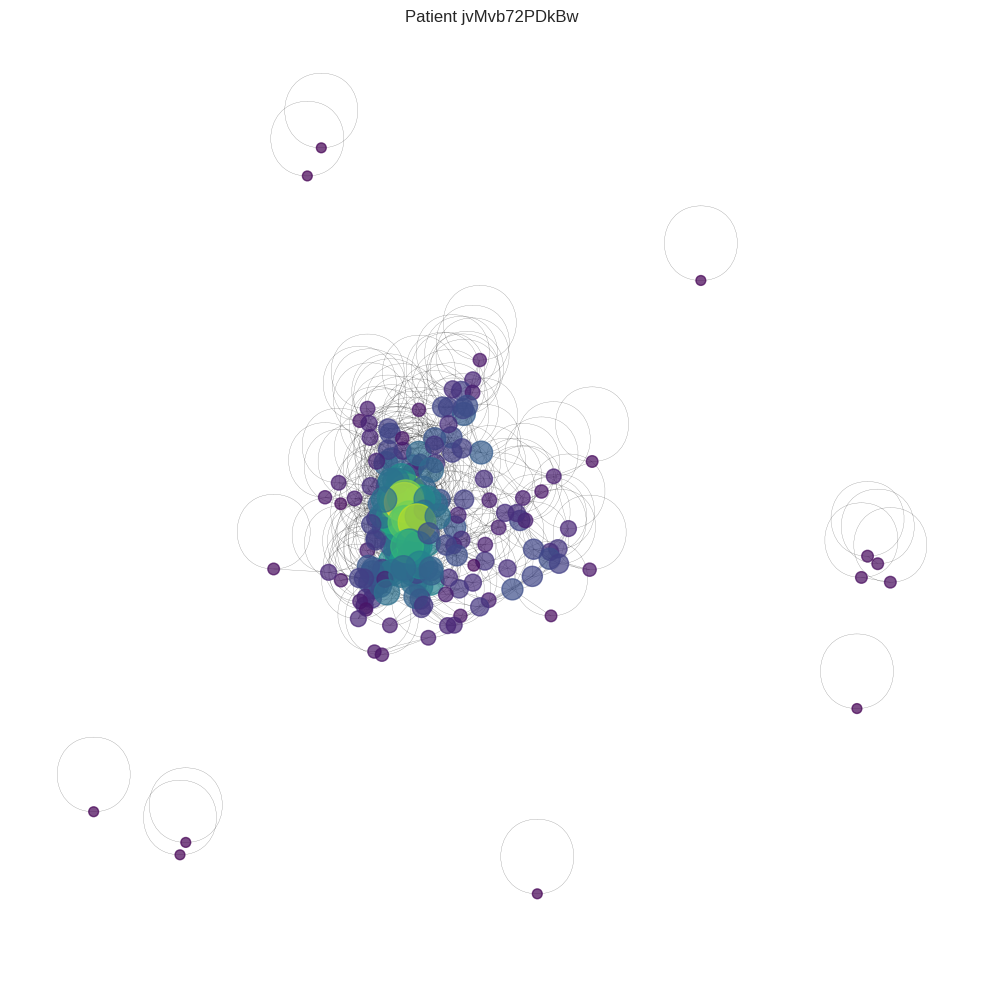

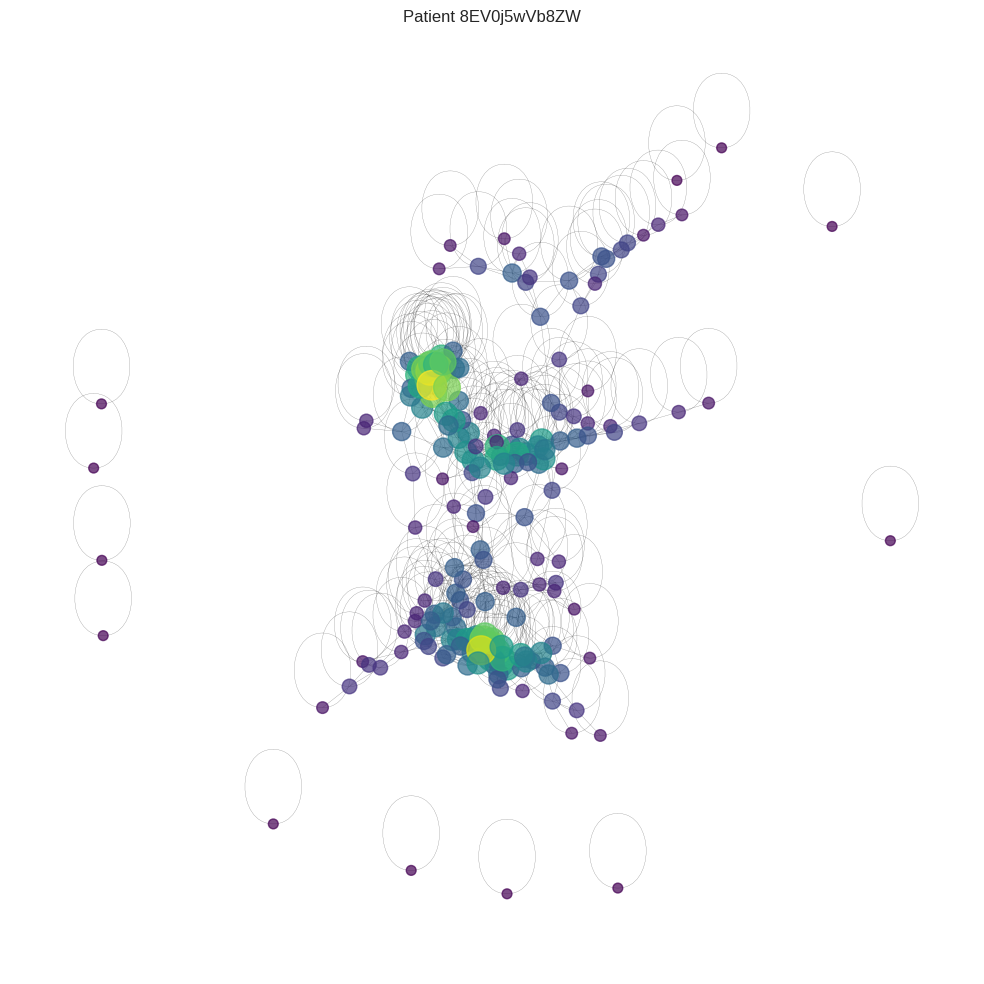

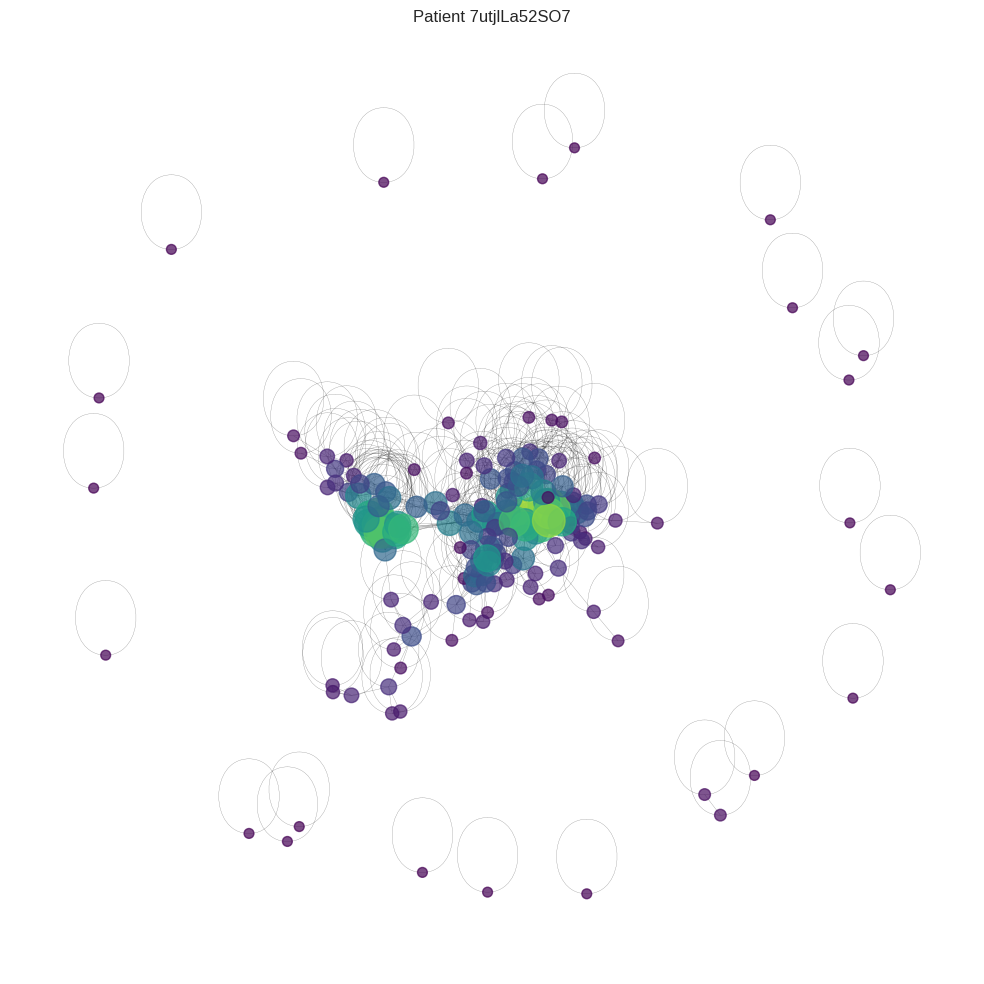

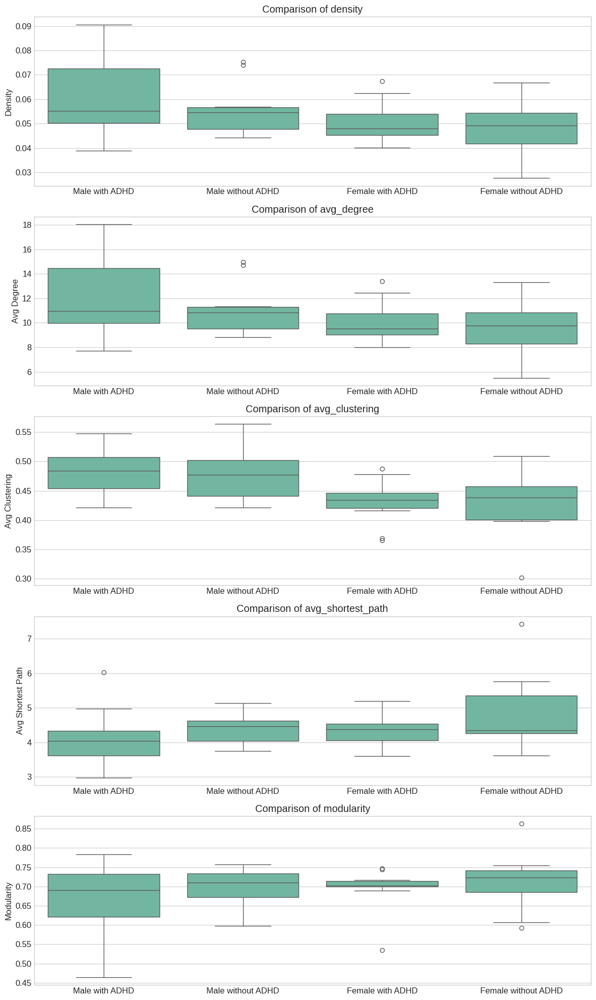

Analysis complete!


In [58]:
@log_and_time
def visualize_connectome(patient_id, connectome_df, threshold=0.5, n=200, title=None, ax=None, show_colorbar=True):
    """
    Visualize the brain connectome as a network graph

    Parameters:
    -----------
    patient_id : str or int
        The patient identifier
    connectome_df : pandas.DataFrame
        DataFrame containing connectome data with patient IDs as index
    threshold : float, default=0.5
        Threshold for connection strength
    n : int, default=200
        Size of the square matrix (number of nodes)
    title : str, optional
        Title for the plot
    ax : matplotlib.axes.Axes, optional
        Axes to draw the plot on. If None, creates a new figure.
    show_colorbar : bool, default=True
        Whether to show the colorbar

    Returns:
    --------
    G : networkx.Graph
        The graph object of the connectome
    """
    if patient_id not in connectome_df.index:
        print(f"Patient ID {patient_id} not found.")
        return None

    flat_data = connectome_df.loc[patient_id].values
    matrix = np.zeros((n, n))
    upper_tri_indices = np.triu_indices(n, k=1)
    matrix[upper_tri_indices] = flat_data
    matrix = matrix + matrix.T
    np.fill_diagonal(matrix, 1)

    thresholded_matrix = matrix.copy()
    thresholded_matrix[thresholded_matrix < threshold] = 0
    G = nx.from_numpy_array(thresholded_matrix)
    if ax is None:
        fig, ax = plt.subplots(figsize=(10, 10))
        standalone = True
    else:
        standalone = False

    pos = nx.spring_layout(G, seed=42)

    degrees = dict(G.degree())
    node_sizes = [v * 20 + 10 for v in degrees.values()]

    nodes = nx.draw_networkx_nodes(G, pos, node_size=node_sizes, alpha=0.7,
                                   node_color=list(degrees.values()),
                                   cmap=plt.cm.viridis, ax=ax)
    nx.draw_networkx_edges(G, pos, width=0.2, alpha=0.5, ax=ax)

    if title:
        ax.set_title(title, fontsize=12)
    else:
        ax.set_title(f"Patient {patient_id}", fontsize=12)
    ax.axis("off")

    if show_colorbar:
        sm = plt.cm.ScalarMappable(cmap=plt.cm.viridis,
                                  norm=plt.Normalize(vmin=min(degrees.values()), vmax=max(degrees.values())))
        sm.set_array([])
        cbar = plt.colorbar(sm, ax=ax, shrink=0.7)
        cbar.set_label('Node Degree', fontsize=10)

    if standalone:
        plt.tight_layout()

    return G

@log_and_time
def sample_patients(data_df, category_col, category_value, n_samples=10):
    filtered_df = data_df[data_df[category_col] == category_value]

    if len(filtered_df) < n_samples:
        print(f"Warning: Only {len(filtered_df)} patients available for {category_col}={category_value}. Taking all.")
        return filtered_df['participant_id'].tolist()

    return random.sample(filtered_df['participant_id'].tolist(), n_samples)

@log_and_time
def visualize_group_connectomes(group_name, patient_ids, connectome_df, n_cols=5, figsize=(20, 15), threshold=0.5):
    """
    Visualize connectomes for a group of patients in a grid

    Parameters:
    -----------
    group_name : str
        Name of the group for the overall title
    patient_ids : list
        List of patient IDs to visualize
    connectome_df : pandas.DataFrame
        DataFrame containing connectome data
    n_cols : int, default=5
        Number of columns in the grid
    figsize : tuple, default=(20, 15)
        Figure size
    threshold : float, default=0.5
        Threshold for connection strength

    Returns:
    --------
    matplotlib.figure.Figure
        The figure object
    """
    n_patients = len(patient_ids)
    n_rows = (n_patients + n_cols - 1) // n_cols

    fig = plt.figure(figsize=figsize)
    gs = GridSpec(n_rows, n_cols, figure=fig)

    for i, patient_id in enumerate(patient_ids):
        row, col = i // n_cols, i % n_cols
        ax = fig.add_subplot(gs[row, col])
        show_colorbar = (col == n_cols - 1)
        visualize_connectome(patient_id, connectome_df, threshold=threshold,
                            title=f"Patient {patient_id}", ax=ax, show_colorbar=show_colorbar)

    plt.suptitle(f"{group_name} (n={n_patients})", fontsize=16)
    plt.tight_layout(rect=[0, 0, 1, 0.98])

    return fig

@log_and_time
def save_group_visualizations(output_dir, filename_prefix, fig):
    """
    Save group visualization to file

    Parameters:
    -----------
    output_dir : str
        Directory to save the file
    filename_prefix : str
        Prefix for the filename
    fig : matplotlib.figure.Figure
        Figure to save
    """
    os.makedirs(output_dir, exist_ok=True)
    filename = os.path.join(output_dir, f"{filename_prefix}.png")
    fig.savefig(filename, dpi=300, bbox_inches='tight')
    print(f"Saved visualization to {filename}")

@log_and_time
def compute_network_metrics(G):
    """
    Compute network metrics for a graph safely with error handling

    Parameters:
    -----------
    G : networkx.Graph
        The graph to analyze

    Returns:
    --------
    dict
        Dictionary of network metrics
    """
    metrics = {}

    try:
        metrics['density'] = nx.density(G)
        metrics['avg_degree'] = float(np.mean(list(dict(G.degree()).values())))
        if G.number_of_nodes() > 0:
            metrics['avg_clustering'] = nx.average_clustering(G)
        else:
            metrics['avg_clustering'] = np.nan

        if nx.is_connected(G):
            metrics['avg_shortest_path'] = nx.average_shortest_path_length(G)
        else:
            largest_cc = max(nx.connected_components(G), key=len)
            if len(largest_cc) > 1:
                largest_cc_graph = G.subgraph(largest_cc)
                metrics['avg_shortest_path'] = nx.average_shortest_path_length(largest_cc_graph)
            else:
                metrics['avg_shortest_path'] = np.nan
        try:
            communities = nx.community.greedy_modularity_communities(G)
            metrics['modularity'] = nx.community.modularity(G, communities)
        except Exception as e:
            print(f"Error calculating modularity: {e}")
            metrics['modularity'] = np.nan

    except Exception as e:
        print(f"Error computing network metrics: {e}")
        for metric in ['avg_clustering', 'avg_shortest_path', 'density', 'avg_degree', 'modularity']:
            if metric not in metrics:
                metrics[metric] = np.nan

    return metrics

def analyze_connectomes(patient_groups, connectome_df, threshold=0.5):
    """
    Analyze connectomes for different patient groups

    Parameters:
    -----------
    patient_groups : dict
        Dictionary with group names as keys and lists of patient IDs as values
    connectome_df : pandas.DataFrame
        DataFrame containing connectome data
    threshold : float, default=0.5
        Threshold for connection strength

    Returns:
    --------
    pandas.DataFrame
        DataFrame with network metrics for each patient
    """
    results = []

    for group_name, patient_ids in patient_groups.items():
        print(f"Analyzing {group_name}...")
        for patient_id in tqdm(patient_ids):
            try:
                if patient_id in connectome_df.index:
                    G = visualize_connectome(patient_id, connectome_df, threshold=threshold, title=None, ax=None, show_colorbar=False)
                    if G is not None:
                        metrics = compute_network_metrics(G)
                        metrics['patient_id'] = patient_id
                        metrics['group'] = group_name
                        results.append(metrics)
                else:
                    print(f"  Warning: Patient ID {patient_id} not found in connectome data")
            except Exception as e:
                print(f"  Error analyzing patient {patient_id}: {e}")

    if not results:
        print("Warning: No valid results found for any patients")
        return pd.DataFrame(columns=['patient_id', 'group', 'avg_clustering', 'avg_shortest_path',
                                     'density', 'avg_degree', 'modularity'])

    return pd.DataFrame(results)

def compare_group_metrics(metrics_df, output_dir=None):
    """
    Compare and visualize network metrics between groups

    Parameters:
    -----------
    metrics_df : pandas.DataFrame
        DataFrame with network metrics for each patient
    output_dir : str, optional
        Directory to save the plots
    """
    if metrics_df.empty:
        print("Warning: No metrics data available for comparison.")
        fig, ax = plt.subplots(figsize=(8, 6))
        ax.text(0.5, 0.5, "No data available for comparison",
                ha='center', va='center', fontsize=14)
        return fig

    groups = metrics_df['group'].unique()
    print(f"Groups available for comparison: {groups}")

    metrics_df = metrics_df.dropna()
    print(f"Shape of metrics dataframe after dropping NaN: {metrics_df.shape}")

    if metrics_df.empty:
        print("Warning: No non-NaN metrics data available for comparison.")
        fig, ax = plt.subplots(figsize=(8, 6))
        ax.text(0.5, 0.5, "No valid data available for comparison",
                ha='center', va='center', fontsize=14)
        return fig

    metrics_to_plot = [col for col in metrics_df.columns if col not in ['patient_id', 'group']]
    print(f"Metrics to plot: {metrics_to_plot}")

    fig, axes = plt.subplots(len(metrics_to_plot), 1, figsize=(12, 4*len(metrics_to_plot)))

    if len(metrics_to_plot) == 1:
        axes = [axes]

    for i, metric in enumerate(metrics_to_plot):
        ax = axes[i]

        metric_data = metrics_df[['group', metric]].dropna()

        if metric_data.empty:
            ax.text(0.5, 0.5, f"No data available for {metric}",
                    ha='center', va='center', fontsize=12)
        else:
            try:
                sns.boxplot(x='group', y=metric, data=metric_data, ax=ax)
                ax.set_title(f"Comparison of {metric}")
                ax.set_xlabel('')
                ax.set_ylabel(metric.replace('_', ' ').title())
            except Exception as e:
                print(f"Error plotting {metric}: {e}")
                ax.text(0.5, 0.5, f"Error plotting {metric}: {str(e)}",
                        ha='center', va='center', fontsize=10, wrap=True)

    plt.tight_layout()

    if output_dir:
        os.makedirs(output_dir, exist_ok=True)
        plt.savefig(os.path.join(output_dir, "group_metrics_comparison.png"), dpi=300, bbox_inches='tight')

    return fig

random.seed(42)
output_dir = "connectome_visualizations"

male_adhd_ids = sample_patients(male_df, 'ADHD_Outcome', 1, n_samples=10)
male_no_adhd_ids = sample_patients(male_df, 'ADHD_Outcome', 0, n_samples=10)
female_adhd_ids = sample_patients(female_df, 'ADHD_Outcome', 1, n_samples=10)
female_no_adhd_ids = sample_patients(female_df, 'ADHD_Outcome', 0, n_samples=10)

patient_groups = {
    'Male with ADHD': male_adhd_ids,
    'Male without ADHD': male_no_adhd_ids,
    'Female with ADHD': female_adhd_ids,
    'Female without ADHD': female_no_adhd_ids
}

for group_name, patient_ids in patient_groups.items():
    print(f"Visualizing {group_name}...")
    fig = visualize_group_connectomes(group_name, patient_ids, train_data_functional_connectome)
    save_group_visualizations(output_dir, group_name.replace(' ', '_').lower(), fig)
    plt.close(fig)

metrics_df = analyze_connectomes(patient_groups, train_data_functional_connectome)

metrics_fig = compare_group_metrics(metrics_df, output_dir)
plt.show()

metrics_df.to_csv(os.path.join(output_dir, "network_metrics.csv"), index=False)

print("Analysis complete!")

# References

[Used as an example reference to understand - Unsupervised Learning on Iris](https://www.kaggle.com/code/efeergun96/unsupervised-learning-on-iris)